In [2]:
import numpy as np
import scanpy as sc
import pandas as pd
import seaborn as sns
from inmoose.pycombat import pycombat_seq
#from combat.pycombat import pycombat

In [9]:
pip install inmoose

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.3/7.3 MB 14.1 MB/s eta 0:00:0000:0100:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Obtaining dependency information for fastcluster from https://files.pythonhosted.org/packages/87/15/af8c4a2a9329c9f117e49efd16c0e13ee1b3e4ef16be27d35005fbc36b6f/fastcluster-1.2.6-cp39-cp39-manylinux_2_5_x86_64.manylinux1_x86_64.manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 193.7/193.7 kB 52.6 MB/s eta 0:00:00
  Created wheel for inmoose: filename=inmoose-0.7.2-cp39-cp39-linux_x86_64.whl size=4425852 sha256=c26a290d4ec5e465cc6364e7cf18f40a991f67cc4636c56840c8a930bbbeda3f
  Stored in directory: /home/emma/.cache/pip/wheels/84/af/42/3fed49b4b74de0338a317b15d8d58373e653b573d6e5e9351d
Successfully built inmoose
Note: you may need to restart the kernel to use updated packages.


In [2]:
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata

AnnData object with n_obs × n_vars = 77492 × 6770
    obs: 'channel', 'barcode', 'timepoint', 'timepoint_fine', 'product', 'generic', 'nTisa', 'nAxi', 'CAR', 'n_genes_by_counts', 'total_counts', 'response', 'cdr3_TRA', 'cdr3_TRB', 'batch_id', 'organization', 'n_genes', 'total_counts_mt', 'pct_counts_mt', 'doublet_scores', 'predicted_doublets', 'n_counts', 'leiden_0.9', 'cell_type'
    var: 'feature_types', 'gene_ids-0', 'genome-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'gene_ids-1', 'genome-0-1', 'genome-1-1', 'genome-2-1', 'genome-3-1', 'genome-4-1', 'genome-5-1', 'genome-6-1', 'genome-7-1', 'genome-8-1', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'log1p'

In [3]:
adata_raw = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_raw.h5ad')
adata_raw

AnnData object with n_obs × n_vars = 77492 × 6770
    obs: 'channel', 'barcode', 'timepoint', 'timepoint_fine', 'product', 'generic', 'nTisa', 'nAxi', 'CAR', 'n_genes_by_counts', 'total_counts', 'response', 'cdr3_TRA', 'cdr3_TRB', 'batch_id', 'organization', 'n_genes', 'total_counts_mt', 'pct_counts_mt', 'doublet_scores', 'predicted_doublets'
    var: 'feature_types', 'gene_ids-0', 'genome-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'gene_ids-1', 'genome-0-1', 'genome-1-1', 'genome-2-1', 'genome-3-1', 'genome-4-1', 'genome-5-1', 'genome-6-1', 'genome-7-1', 'genome-8-1', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [18]:
import pandas as pd
import numpy as np
from inmoose.pycombat import pycombat_seq  # Adjust based on actual usage
import anndata as ad

# Step 1: Copy the raw AnnData object
adata_combat = adata_raw.copy()

# Step 2: Convert the sparse matrix to a dense NumPy array with float64 dtype
log1p_array = adata_combat.X.toarray().T.astype(np.float64)

# Optional: If the dataset is large and memory is a concern, consider using sparse formats or alternative methods

# Step 3: Prepare batch labels as a pandas Categorical
batch_labels = pd.Categorical(adata_raw.obs['channel'])

# Step 4: Verify data orientation
assert log1p_array.shape[0] == adata_combat.var_names.shape[0], "Mismatch in number of genes."
assert log1p_array.shape[1] == adata_combat.obs_names.shape[0], "Mismatch in number of samples."

# Step 5: Run ComBat correction
try:
    corrected_array = pycombat_seq(
        counts=log1p_array,
        batch=batch_labels
        # You can add other parameters here if necessary
    )
except TypeError as e:
    print(f"TypeError encountered: {e}")
    # Additional debugging steps can be added here

# Step 6: Assign the corrected data back to AnnData object
adata_combat.X = corrected_array.T  # Ensure shapes align

# Step 7: Save the corrected AnnData object
adata_combat.write_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_raw_combat.h5ad')


In [19]:
adata_combat[:20, :20].X

ArrayView([[0., 0., 0., 0., 0., 0., 1., 0., 6., 1., 0., 0., 0., 0., 0.,
            0., 0., 0., 0., 0.],
           [0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0.,
            0., 0., 0., 0., 0.],
           [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
            0., 0., 0., 0., 0.],
           [0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0.,
            0., 0., 0., 0., 0.],
           [0., 0., 0., 0., 0., 0., 3., 0., 0., 0., 0., 0., 0., 0., 0.,
            0., 0., 0., 1., 0.],
           [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
            0., 0., 0., 0., 0.],
           [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
            0., 0., 0., 0., 0.],
           [0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0.,
            0., 0., 2., 0., 0.],
           [0., 0., 0., 0., 0., 0., 3., 0., 1., 1., 0., 0., 0., 0., 0.,
            0., 0., 0., 0., 0.],
           [0., 1., 0., 0., 0., 0., 1., 0., 0., 0., 0.,

In [3]:
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_raw_combat.h5ad')
sc.pp.normalize_total(adata_combat, target_sum=1e4)
sc.pp.log1p(adata_combat)
adata_combat.write_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat_log.h5ad')
sc.pp.regress_out(adata_combat, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(adata_combat, max_value=10, zero_center=True)
sc.tl.pca(adata_combat, svd_solver='arpack')
sc.pp.neighbors(adata_combat)
sc.tl.umap(adata_combat)
sc.tl.leiden(adata_combat, resolution=0.9, key_added='leiden_0.9')
adata_combat.write_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat_umap.h5ad')


2024-09-16 08:10:16.037697: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-09-16 08:10:16.660557: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib/cuda/include:/usr/lib/cuda/lib64:
2024-09-16 08:10:16.660662: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib/cuda/include:/usr/lib/cuda/lib64:
2024-09-16 08:10:16.660670: W tensorflow/com

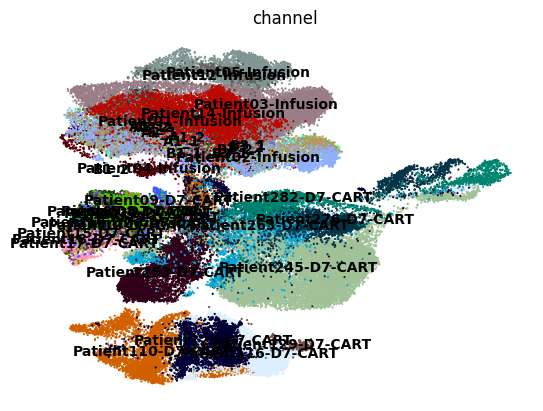

In [7]:
sc.pl.umap(adata_combat, color=['channel'], size=10, legend_loc='on data', ncols=1, frameon=False)

In [4]:
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
sc.pp.regress_out(adata_combat, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(adata_combat, max_value=10, zero_center=True)
sc.tl.pca(adata_combat, svd_solver='arpack')
sc.pp.neighbors(adata_combat)
sc.tl.umap(adata_combat)
sc.tl.leiden(adata_combat, resolution=0.9, key_added='leiden_0.9')
adata_combat.write_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat_log_umap.h5ad')

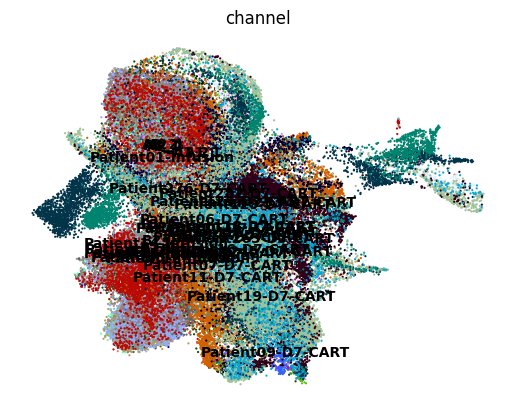

In [5]:
sc.pl.umap(adata_combat, color=['channel'], size=10, legend_loc='on data', ncols=1, frameon=False)

In [12]:
adata_log = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
sc.pp.regress_out(adata_log, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(adata_log, max_value=10, zero_center=True)
sc.tl.pca(adata_log, svd_solver='arpack')
sc.pp.neighbors(adata_log)
sc.tl.umap(adata_log)
sc.tl.leiden(adata_log, resolution=0.9, key_added='leiden_0.9')
adata_log.write_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log_umap.h5ad')

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/uma

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


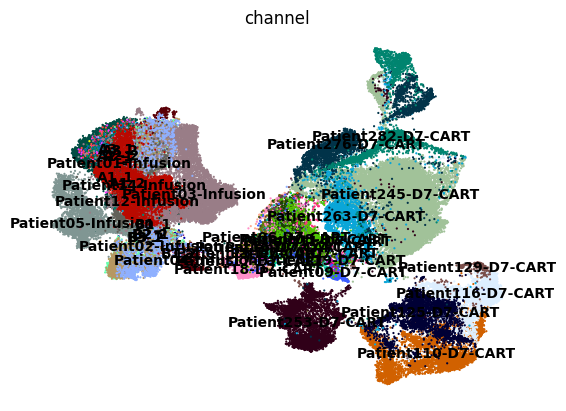

In [13]:
sc.pl.umap(adata_log, color=['channel'], size=10, legend_loc='on data', ncols=1, frameon=False)

In [3]:
adata_harmony = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_harmony_genovis.h5ad')
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat_log.h5ad')

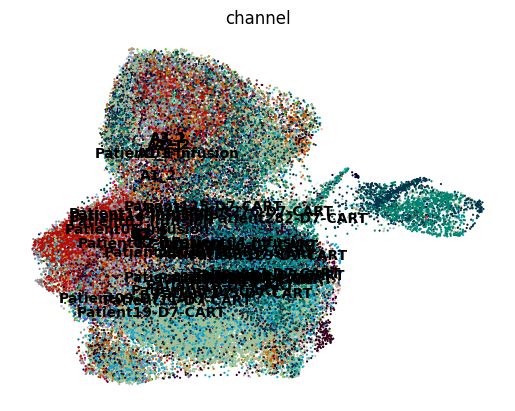

In [11]:
sc.pl.umap(adata_harmony, color=['channel'], size=10, legend_loc='on data', ncols=1, frameon=False)

In [10]:
adata.obs['leiden_0.9'] = adata_harmony.obs['leiden_0.9']
adata.obs['barcode'] = adata_harmony.obs['barcode']
adata.obs['response'] = adata_harmony.obs['response']
adata.obs['cell_type'] = adata_harmony.obs['cell_type']
adata.write_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat_log.h5ad')

In [6]:
adata.obs['cell_type'].value_counts()

cell_type
CD8    46936
CD4    30556
Name: count, dtype: int64

In [7]:
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()
adata_CD4[adata_CD4.obs['response'] == 'CR'].obs['barcode'].value_counts()

barcode
Patient110-D7-CART    4472
Patient125-D7-CART    1163
Patient116-D7-CART    1052
Patient253-D7-CART     821
Axi-R-08               547
Axi-N-16               289
Axi-R-11               238
Axi-R-15                85
Axi-R-19                58
Axi-R-17                20
Patient129-D7-CART      15
Name: count, dtype: int64

In [8]:
adata_CD4[adata_CD4.obs['response'] == 'NR'].obs['barcode'].value_counts()

barcode
Patient245-D7-CART    6701
Axi-N-07              1183
Patient263-D7-CART    1139
Patient282-D7-CART     836
Patient276-D7-CART     424
Axi-N-09               219
Axi-N-06               175
Axi-N-18               113
Axi-N-10               110
Name: count, dtype: int64

In [6]:
adata_CD4[adata_CD4.obs['response'] == 'Infusion'].obs['barcode'].value_counts()

barcode
Axi-R-01    2452
Axi-R-03    2170
Axi-N-09    1636
Axi-N-14    1260
Axi-P-05     947
Axi-R-02     671
Axi-N-10     488
Axi-R-08     429
Axi-N-07     283
Axi-N-16     243
Axi-R-19     122
Axi-R-04     100
Axi-R-12      74
Axi-N-18      55
Axi-R-15      55
Axi-R-17      22
Axi-R-13      20
Axi-R-11       6
Name: count, dtype: int64

In [10]:
# Check if all genes are in the dataset
genes = [
    "PECAM1", "CD7", "FCER1G", "KLRB1",                             # Immune System and Cell Surface Markers
    "JUND", "ZNF683", "TLE5", "LFNG", "TSC22D3", "MAF",             # Transcription Factors and Gene Regulation
    "MTRNR2L12", "RRM2", "TYMS", "GINS2",                           # Mitochondrial and Cellular Metabolism
    "MATK",                                                         # Signal Transduction and Kinases
    "IFITM3",                                                       # Antiviral Response
    "PLP2", "CLSPN", "MSN", "CTSW"                                         # Cellular Structure and Adhesion
]
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()
missing_genes = [gene for gene in genes if gene not in adata_CD4.var_names]
if missing_genes:
    print(f"The following genes are missing in the dataset: {missing_genes}")
else:
    print("All genes are present in the dataset.")


All genes are present in the dataset.


In [27]:
pip install scikit-bio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.7/2.7 MB 30.3 MB/s eta 0:00:0000:0100:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.7/11.7 MB 43.1 MB/s eta 0:00:0000:0100:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for scikit-bio: filename=scikit_bio-0.6.2-cp39-cp39-linux_x86_64.whl size=2462408 sha256=c00b2580750a8ebd9b3bda75af4f5421b6fccc3c82635124fb13836230e2705d
  Stored in directory: /home/emma/.cache/pip/wheels/77/aa/10/57e5692dc539802da5df5fa39b3b217e7f4d77feccb12f37b9
  Created wheel for biom-format: filename=biom_format-2.1.16-cp39-cp39-linux_x86_64.whl size=11803876 sha256=75bbcb2f97757b3e43d67dd411238a5d94b9ece549c5d3816838a906532b62f1
  Stored in directory: /home/emma/.cache/pip/wheels/f3/d2/c9/0f6e6eb92d2927fdd14885fdf7632342f

In [4]:
import scanpy as sc
import numpy as np
import pandas as pd
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from scipy.spatial.distance import pdist, squareform
from skbio.stats.distance import DistanceMatrix
from skbio.stats.distance import permanova
from scipy.stats import zscore

# Load datasets
adata_log = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')

# Filter for CD4 cells in both datasets
adata_log_CD4 = adata_log[adata_log.obs['cell_type'] == 'CD4'].copy()
adata_combat_CD4 = adata_combat[adata_combat.obs['cell_type'] == 'CD4'].copy()

# Filter for CR and NR response groups in both datasets
adata_log_CR_NR = adata_log_CD4[(adata_log_CD4.obs['response'] == 'CR') | (adata_log_CD4.obs['response'] == 'NR')].copy()
adata_combat_CR_NR = adata_combat_CD4[(adata_combat_CD4.obs['response'] == 'CR') | (adata_combat_CD4.obs['response'] == 'NR')].copy()

# Encode the 'response' labels (CR and NR only)
le = LabelEncoder()
adata_log_CR_NR.obs['Response_Encoded'] = le.fit_transform(adata_log_CR_NR.obs['response'])

# Define gene list
genes = [
    "PECAM1", "CD7", "FCER1G", "KLRK1",                             # Immune System and Cell Surface Markers
    "JUND", "ZNF683", "TLE5", "LFNG", "TSC22D3", "MAF",             # Transcription Factors and Gene Regulation
    "MTRNR2L12", "RRM2", "TYMS", "GINS2",                           # Mitochondrial and Cellular Metabolism
    "MATK",                                                         # Signal Transduction and Kinases
    "IFITM3",                                                       # Antiviral Response
    "PLP2", "CLSPN", "MSN", "CTSW"                                  # Cellular Structure and Adhesion
]

# Prepare to store results
results = []

# Iterate over all single genes
for gene in genes:
    # Prepare a list to store the data for the PERMANOVA analysis
    model_data = []
    patients = adata_log_CR_NR.obs['barcode'].unique()
    
    # Calculate the proportion from the log-transformed data and gene count from the combat-corrected data
    for patient in patients:
        # Data from log-transformed dataset (for calculating proportions)
        patient_data_log = adata_log_CR_NR[adata_log_CR_NR.obs['barcode'] == patient]

        # Data from combat-corrected dataset (for calculating gene counts)
        patient_data_combat = adata_combat_CR_NR[adata_combat_CR_NR.obs['barcode'] == patient]

        # Calculate proportion of cells expressing the gene using log data
        gene_expr_log = patient_data_log[:, gene].X.toarray().flatten() > 0 if issparse(patient_data_log.X) else patient_data_log[:, gene].X > 0
        proportion = np.sum(gene_expr_log) / patient_data_log.shape[0]

        # Calculate gene count using combat-corrected data
        gene_count = np.mean(patient_data_combat[:, gene].X)

        # Append the data for PERMANOVA analysis
        model_data.append({
            'Patient': patient,
            'Response_Encoded': patient_data_log.obs['Response_Encoded'].values[0], 
            'Proportion_Positive': proportion,
            f'{gene}_Count': gene_count
        })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)
    model_df[f'{gene}_Count'] = model_df[f'{gene}_Count'].astype(float)

    # Normalize the variables using Z-scores
    model_df['Proportion_Positive_Z'] = zscore(model_df['Proportion_Positive'])
    model_df[f'{gene}_Count_Z'] = zscore(model_df[f'{gene}_Count'])

       # Calculate the distance matrix for the three normalized variables
    dist_matrix = squareform(pdist(model_df[['Proportion_Positive_Z', f'{gene}_Count_Z']], metric='euclidean'))

    # Prepare unique IDs for each sample
    ids = model_df.index.to_list()

    # Convert the distance matrix into a skbio DistanceMatrix object
    dist_matrix = DistanceMatrix(dist_matrix, ids=ids)

    # Perform PERMANOVA for CR vs NR
    result_CR_NR = permanova(dist_matrix, model_df['Response_Encoded'], permutations=999)

    p_val_CR_NR = result_CR_NR['p-value']
    pseudo_F_CR_NR = result_CR_NR['test statistic']

    if p_val_CR_NR < 0.05:
        results.append({
            'Gene': f'{gene}',
            'Pseudo-F CR vs NR': pseudo_F_CR_NR,
            'P-value CR vs NR': p_val_CR_NR
        })
# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Apply Bonferroni correction
#results_df['Adjusted P-value'] = multipletests(results_df['P-value CR vs NR'], method='bonferroni')[1]
#results_df['Adjusted P-value'] = multipletests(results_df['P-value CR vs NR'], method='fdr_bh')[1]
# Rank the gene pairs
ranked_pairs = results_df.sort_values(by='P-value CR vs NR')

# Export the results to an Excel file
ranked_pairs.to_excel('/home/emma/result/CART/CD4_Figure3_1_gene_permanova_results_CR_NR.xlsx', index=False)

print("Analysis complete. Results exported to '/home/emma/result/CART/CD4_1_gene_permanova_results_CR_NR.xlsx'.")


Analysis complete. Results exported to '/home/emma/result/CART/CD4_1_gene_permanova_results_CR_NR.xlsx'.


In [9]:
import scanpy as sc
import numpy as np
import pandas as pd
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, average_precision_score
from sklearn.model_selection import StratifiedKFold
import xgboost as xgb
from scipy.stats import zscore

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()
# adata_CD4_clusters = adata_CD4[adata_CD4.obs['leiden_0.9'].isin(['3', '6', '10', '11', '12', '13'])].copy()
adata_CR_NR = adata_CD4[(adata_CD4.obs['response'] == 'CR') | (adata_CD4.obs['response'] == 'NR')].copy()
print(adata_CR_NR.obs['response'].shape)

# Encode the 'response' labels (CR and NR only)
le = LabelEncoder()
adata_CR_NR.obs['Response_Encoded'] = le.fit_transform(adata_CR_NR.obs['response'])  # CR = 0, NR = 1

# Define the list of genes to be analyzed
genes = ["JUND"]

# Prepare to store results for evaluation
evaluation_results = []

# Initialize Stratified K-Fold Cross-Validation
n_splits = 5
kf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

# Define XGBoost parameters
xgb_params = {
    'objective': 'binary:logistic',
    'n_estimators': 100,
    'random_state': 42,
    'eval_metric': 'logloss'
}

# Iterate over each gene
for gene in genes:
    print(f"Evaluating gene: {gene}")

    # Filter the data for the CR and NR responses
    patients = adata_CR_NR.obs['barcode'].unique()

    model_data = []
    for patient in patients:
        patient_data = adata_CR_NR[adata_CR_NR.obs['barcode'] == patient]

        # Ensure the data is dense if needed
        gene_expr = patient_data[:, gene].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene].X > 0
        proportion = np.sum(gene_expr) / patient_data.shape[0]
        gene_count = np.mean(patient_data[:, gene].X)

        # Append the data for analysis
        model_data.append({
            'Patient': patient,
            'Response_Encoded': patient_data.obs['Response_Encoded'].values[0],
            'Proportion_Positive': proportion,
            f'{gene}_Count': gene_count
        })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)
    model_df[f'{gene}_Count'] = model_df[f'{gene}_Count'].astype(float)

    # Select the normalized features and the target variable
    X = model_df[['Proportion_Positive', f'{gene}_Count']]
    y = model_df['Response_Encoded']

    # Perform 5-fold cross-validation
    fold_accuracies = []
    fold_precisions = []
    fold_recalls = []
    fold_f1s = []
    fold_auc_roc = []
    fold_auc_pr = []

    for train_index, test_index in kf.split(X, y):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        # Train an XGBoost classifier
        xgb_model = xgb.XGBClassifier(**xgb_params)
        xgb_model.fit(X_train, y_train)

        # Predict on the test set
        y_pred = xgb_model.predict(X_test)
        y_prob = xgb_model.predict_proba(X_test)[:, 1]  # Probability for the positive class

        # Calculate accuracy, precision, recall, F1-score
        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred, average='weighted')
        recall = recall_score(y_test, y_pred, average='weighted')
        f1 = f1_score(y_test, y_pred, average='weighted')

        # Calculate AUC-ROC and AUC-PR
        auc_roc = roc_auc_score(y_test, y_prob)
        auc_pr = average_precision_score(y_test, y_prob)

        # Append fold metrics
        fold_accuracies.append(accuracy)
        fold_precisions.append(precision)
        fold_recalls.append(recall)
        fold_f1s.append(f1)
        fold_auc_roc.append(auc_roc)
        fold_auc_pr.append(auc_pr)

    # Store the average metrics across the 5 folds
    evaluation_results.append({
        'Gene': gene,
        'Accuracy': np.mean(fold_accuracies),
        'Precision': np.mean(fold_precisions),
        'Recall': np.mean(fold_recalls),
        'F1_Score': np.mean(fold_f1s),
        'AUC_ROC': np.mean(fold_auc_roc),
        'AUC_PR': np.mean(fold_auc_pr)
    })

# Convert the evaluation results to a DataFrame
evaluation_df = pd.DataFrame(evaluation_results)

# Save the results to a CSV file
evaluation_df.to_csv('/home/emma/result/CART/CD4_figure3_1_gene_xgboost_evaluation_metrics_CR_NR_5fold.csv', index=False)

print("XGBoost evaluation with 5-fold cross-validation complete. Results exported to '/home/emma/result/CART/CD4_figure3_1_gene_xgboost_evaluation_metrics_CR_NR_5fold.csv'.")


(19660,)
Evaluating gene: JUND
XGBoost evaluation with 5-fold cross-validation complete. Results exported to '/home/emma/result/CART/CD4_figure3_1_gene_xgboost_evaluation_metrics_CR_NR_5fold.csv'.


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, average_precision_score
from sklearn.model_selection import StratifiedKFold
import xgboost as xgb
from scipy.stats import zscore

adata_log = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_log_CD4 = adata_log[adata_log.obs['cell_type'] == 'CD4'].copy()
#adata_log_CD4 = adata_log_CD4[adata_log_CD4.obs['leiden_0.9'].isin(['3', '6', '10', '11', '12', '13'])].copy()
adata_log_CR_NR = adata_log_CD4[(adata_log_CD4.obs['response'] == 'CR') | (adata_log_CD4.obs['response'] == 'NR')].copy()

# Load log-transformed dataset for proportions and gene counts
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_combat_CD4 = adata_combat[adata_combat.obs['cell_type'] == 'CD4'].copy()
#data_combat_CD4 = adata_combat_CD4[adata_combat_CD4.obs['leiden_0.9'].isin(['3', '6', '10', '11', '12', '13'])].copy()
adata_combat_CR_NR = adata_combat_CD4[adata_combat_CD4.obs['response'].isin(['CR', 'NR'])].copy()

# Encode the 'response' labels (CR and NR only)
le = LabelEncoder()
adata_log_CR_NR.obs['Response_Encoded'] = le.fit_transform(adata_log_CR_NR.obs['response'])

# Define the list of genes to be analyzed
genes = ["JUND"]

# Prepare to store results for evaluation
evaluation_results = []

# Initialize Stratified K-Fold Cross-Validation
n_splits = 5
kf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

# Define XGBoost parameters
xgb_params = {
    'objective': 'binary:logistic',
    'n_estimators': 100,
    'random_state': 42,
    'eval_metric': 'logloss'
}

# Iterate over each gene
for gene in genes:
    # Prepare a list to store the data for the PERMANOVA analysis
    model_data = []
    patients = adata_log_CR_NR.obs['barcode'].unique()
    
    # Calculate the proportion from the log-transformed data and gene count from the combat-corrected data
    for patient in patients:
        # Data from log-transformed dataset (for calculating proportions)
        patient_data_log = adata_log_CR_NR[adata_log_CR_NR.obs['barcode'] == patient]

        # Data from combat-corrected dataset (for calculating gene counts)
        patient_data_combat = adata_combat_CR_NR[adata_combat_CR_NR.obs['barcode'] == patient]

        # Calculate proportion of cells expressing the gene using log data
        gene_expr_log = patient_data_log[:, gene].X.toarray().flatten() > 0 if issparse(patient_data_log.X) else patient_data_log[:, gene].X > 0
        proportion = np.sum(gene_expr_log) / patient_data_log.shape[0]

        # Calculate gene count using combat-corrected data
        gene_count = np.mean(patient_data_combat[:, gene].X)

        # Append the data for PERMANOVA analysis
        model_data.append({
            'Patient': patient,
            'Response_Encoded': patient_data_log.obs['Response_Encoded'].values[0], 
            'Proportion_Positive': proportion,
            f'{gene}_Count': gene_count
        })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)
    model_df[f'{gene}_Count'] = model_df[f'{gene}_Count'].astype(float)

    # Select the normalized features and the target variable
    X = model_df[['Proportion_Positive', f'{gene}_Count']]
    y = model_df['Response_Encoded']

    # Perform 5-fold cross-validation
    fold_accuracies = []
    fold_precisions = []
    fold_recalls = []
    fold_f1s = []
    fold_auc_roc = []
    fold_auc_pr = []

    for train_index, test_index in kf.split(X, y):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        # Train an XGBoost classifier
        xgb_model = xgb.XGBClassifier(**xgb_params)
        xgb_model.fit(X_train, y_train)

        # Predict on the test set
        y_pred = xgb_model.predict(X_test)
        y_prob = xgb_model.predict_proba(X_test)[:, 1]  # Probability for the positive class

        # Calculate accuracy, precision, recall, F1-score
        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred, average='weighted')
        recall = recall_score(y_test, y_pred, average='weighted')
        f1 = f1_score(y_test, y_pred, average='weighted')

        # Calculate AUC-ROC and AUC-PR
        auc_roc = roc_auc_score(y_test, y_prob)
        auc_pr = average_precision_score(y_test, y_prob)

        # Append fold metrics
        fold_accuracies.append(accuracy)
        fold_precisions.append(precision)
        fold_recalls.append(recall)
        fold_f1s.append(f1)
        fold_auc_roc.append(auc_roc)
        fold_auc_pr.append(auc_pr)

    # Store the average metrics across the 5 folds
    evaluation_results.append({
        'Gene': gene,
        'Accuracy': np.mean(fold_accuracies),
        'Precision': np.mean(fold_precisions),
        'Recall': np.mean(fold_recalls),
        'F1_Score': np.mean(fold_f1s),
        'AUC_ROC': np.mean(fold_auc_roc),
        'AUC_PR': np.mean(fold_auc_pr)
    })

# Convert the evaluation results to a DataFrame
evaluation_df = pd.DataFrame(evaluation_results)

# Save the results to a CSV file
evaluation_df.to_csv('/home/emma/result/CART/CD4_figure3_1_gene_xgboost_evaluation_metrics_CR_NR_5fold_0930.csv', index=False)

print("XGBoost evaluation with 5-fold cross-validation complete. Results exported to '/home/emma/result/CART/CD4_figure3_1_gene_xgboost_evaluation_metrics_CR_NR_5fold.csv'.")

XGBoost evaluation with 5-fold cross-validation complete. Results exported to '/home/emma/result/CART/CD4_figure3_1_gene_xgboost_evaluation_metrics_CR_NR_5fold.csv'.


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [10]:
import scanpy as sc
import numpy as np
import pandas as pd
import itertools
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from scipy.spatial.distance import pdist, squareform
from skbio.stats.distance import DistanceMatrix
from skbio.stats.distance import permanova
from scipy.stats import zscore
from statsmodels.stats.multitest import multipletests

adata_log = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_log_CD4 = adata_log[adata_log.obs['cell_type'] == 'CD4'].copy()
#adata_log_CD4 = adata_log_CD4[adata_log_CD4.obs['leiden_0.9'].isin(['3', '6', '10', '11', '12', '13'])].copy()
adata_log_CR_NR = adata_log_CD4[(adata_log_CD4.obs['response'] == 'CR') | (adata_log_CD4.obs['response'] == 'NR')].copy()

# Load log-transformed dataset for proportions and gene counts
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_combat_CD4 = adata_combat[adata_combat.obs['cell_type'] == 'CD4'].copy()
#data_combat_CD4 = adata_combat_CD4[adata_combat_CD4.obs['leiden_0.9'].isin(['3', '6', '10', '11', '12', '13'])].copy()
adata_combat_CR_NR = adata_combat_CD4[adata_combat_CD4.obs['response'].isin(['CR', 'NR'])].copy()

# Encode the 'response' labels (CR and NR only)
le = LabelEncoder()
adata_log_CR_NR.obs['Response_Encoded'] = le.fit_transform(adata_log_CR_NR.obs['response'])

# Define gene list
genes = [
    "PECAM1", "CD7", "FCER1G", "KLRK1",
    "JUND", "ZNF683", "TLE5", "LFNG", "TSC22D3", "MAF",
    "MTRNR2L12", "RRM2", "TYMS", "GINS2",
    "MATK",
    "IFITM3",
    "PLP2", "CLSPN", "MSN", "CTSW"
]

# Prepare to store results
results = []

# Iterate over all gene pairs
gene_pairs = itertools.combinations(genes, 2)
for gene1, gene2 in gene_pairs:
    # Prepare a list to store the data for the PERMANOVA analysis
    model_data = []
    patients = adata_log_CR_NR.obs['barcode'].unique()
    # Calculate the proportion of cells expressing both genes for each patient using adata_log
    for patient in patients:
        patient_data_log = adata_log_CR_NR[adata_log_CR_NR.obs['barcode'] == patient]
        patient_data_combat = adata_combat_CR_NR[adata_combat_CR_NR.obs['barcode'] == patient]

        # Ensure the data is dense if needed
        gene1_expr_log = patient_data_log[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data_log.X) else patient_data_log[:, gene1].X > 0
        gene2_expr_log = patient_data_log[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data_log.X) else patient_data_log[:, gene2].X > 0
        both_genes_expr = np.logical_and(gene1_expr_log, gene2_expr_log)
        proportion = np.sum(both_genes_expr) / patient_data_log.shape[0]

        # Calculate the mean gene counts using adata_combat
        gene1_count_combat = np.mean(patient_data_combat[:, gene1].X)
        gene2_count_combat = np.mean(patient_data_combat[:, gene2].X)

        # Append the data for PERMANOVA analysis
        model_data.append({
            'Patient': patient,
            'Response_Encoded': patient_data_log.obs['Response_Encoded'].values[0],
            'Proportion_Positive': proportion,
            f'{gene1}_Count': gene1_count_combat,
            f'{gene2}_Count': gene2_count_combat
        })
        # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)
    model_df[f'{gene1}_Count'] = model_df[f'{gene1}_Count'].astype(float)
    model_df[f'{gene2}_Count'] = model_df[f'{gene2}_Count'].astype(float)
    # Normalize the variables using Z-scores
    model_df['Proportion_Positive_Z'] = zscore(model_df['Proportion_Positive'])
    model_df[f'{gene1}_Count_Z'] = zscore(model_df[f'{gene1}_Count'])
    model_df[f'{gene2}_Count_Z'] = zscore(model_df[f'{gene2}_Count'])

    # Calculate the distance matrix for the three normalized variables
    dist_matrix = squareform(pdist(model_df[['Proportion_Positive_Z', f'{gene1}_Count_Z', f'{gene2}_Count_Z']], metric='euclidean'))

    # Prepare unique IDs for each sample
    ids = model_df.index.to_list()

    # Convert the distance matrix into a skbio DistanceMatrix object
    dist_matrix = DistanceMatrix(dist_matrix, ids=ids)

    # Perform PERMANOVA for CR vs NR
    result_CR_NR = permanova(dist_matrix, model_df['Response_Encoded'], permutations=999)

    p_val_CR_NR = result_CR_NR['p-value']
    pseudo_F_CR_NR = result_CR_NR['test statistic']

    if p_val_CR_NR < 0.05:
        results.append({
            'Gene_Pair': f'{gene1} & {gene2}',
            'Pseudo-F CR vs NR': pseudo_F_CR_NR,
            'P-value CR vs NR': p_val_CR_NR
        })
# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Apply Bonferroni correction
#results_df['Adjusted P-value'] = multipletests(results_df['P-value CR vs NR'], method='bonferroni')[1]
#results_df['Adjusted P-value'] = multipletests(results_df['P-value CR vs NR'], method='fdr_bh')[1]
# Rank the gene pairs
ranked_pairs = results_df.sort_values(by='P-value CR vs NR')

# Export the results to an Excel file
ranked_pairs.to_excel('/home/emma/result/CART/CD4_Figure3_2_genes_permanova_results_CR_NR.xlsx', index=False)

print("Analysis complete. Results exported to '/home/emma/result/CART/CD4_gene_pair_permanova_results_CR_NR.xlsx'.")

Analysis complete. Results exported to '/home/emma/result/CART/CD4_gene_pair_permanova_results_CR_NR.xlsx'.


In [13]:
import scanpy as sc
import numpy as np
import pandas as pd
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, average_precision_score
from sklearn.model_selection import StratifiedKFold
import xgboost as xgb
from scipy.stats import zscore

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()
# adata_CD8_cluster = adata_CD8[adata_CD8.obs['leiden_0.9'].isin(['0', '1', '4', '7', '9', '10', '11', '13', '14'])].copy()
adata_CR_NR = adata_CD4[(adata_CD4.obs['response'] == 'CR') | (adata_CD4.obs['response'] == 'NR')].copy()

# Encode the 'response' labels (CR and NR only)
le = LabelEncoder()
adata_CR_NR.obs['Response_Encoded'] = le.fit_transform(adata_CR_NR.obs['response'])  # CR = 0, NR = 1

# Define the list of gene pairs
gene_pairs = [
    ("JUND", "TLE5"),
    ("FCER1G", "ZNF683"),
    ("JUND", "TSC22D3"),
    ("JUND", "ZNF683")
]

# Prepare to store results for each gene pair
evaluation_results = []

# Define XGBoost parameters
xgb_params = {
    'objective': 'binary:logistic',
    'eval_metric': 'logloss',
    'random_state': 42,
    'n_estimators': 100
}

# Initialize Stratified K-Fold Cross-Validation
n_splits = 5
kf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

# Iterate over all pairs of genes
for gene1, gene2 in gene_pairs:
    print(f"Evaluating gene pair: {gene1} & {gene2}")

    # Prepare data for analysis
    model_data = [] 
    patients = adata_CR_NR.obs['barcode'].unique()
    
    # Calculate the proportion of cells expressing both genes for each patient
    for patient in patients:
        patient_data = adata_CR_NR[adata_CR_NR.obs['barcode'] == patient]
        
        # Ensure the data is dense if needed
        gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
        gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
        both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
        proportion = np.sum(both_genes_expr) / patient_data.shape[0]
        gene1_count = np.mean(patient_data[:, gene1].X)
        gene2_count = np.mean(patient_data[:, gene2].X)

        # Append the data for analysis
        model_data.append({
            'Patient': patient,
            'Response_Encoded': patient_data.obs['Response_Encoded'].values[0],
            'Proportion_Positive': proportion,
            f'{gene1}_Count': gene1_count,
            f'{gene2}_Count': gene2_count
        })
    
    # Convert to DataFrame
    model_df = pd.DataFrame(model_data)
    model_df[f'{gene1}_Count'] = model_df[f'{gene1}_Count'].astype(float)
    model_df[f'{gene2}_Count'] = model_df[f'{gene2}_Count'].astype(float)

    # Normalize the features using zscore
    X = model_df[['Proportion_Positive', f'{gene1}_Count', f'{gene2}_Count']]
    y = model_df['Response_Encoded']

    # Perform 5-fold cross-validation
    fold_accuracies = []
    fold_precisions = []
    fold_recalls = []
    fold_f1s = []
    fold_auc_roc = []
    fold_auc_pr = []

    for train_index, test_index in kf.split(X, y):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        # Train an XGBoost classifier
        xgb_model = xgb.XGBClassifier(**xgb_params)
        xgb_model.fit(X_train, y_train)

        # Predict on the test set
        y_pred = xgb_model.predict(X_test)
        y_prob = xgb_model.predict_proba(X_test)[:, 1]  # Probability for the positive class

        # Calculate accuracy, precision, recall, and F1-score
        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred, average='weighted')
        recall = recall_score(y_test, y_pred, average='weighted')
        f1 = f1_score(y_test, y_pred, average='weighted')

        # Calculate AUC-ROC and AUC-PR
        auc_roc = roc_auc_score(y_test, y_prob)
        auc_pr = average_precision_score(y_test, y_prob)

        # Append fold metrics
        fold_accuracies.append(accuracy)
        fold_precisions.append(precision)
        fold_recalls.append(recall)
        fold_f1s.append(f1)
        fold_auc_roc.append(auc_roc)
        fold_auc_pr.append(auc_pr)

    # Store the average metrics across the 5 folds
    evaluation_results.append({
        'Gene_Pair': f'{gene1} & {gene2}',
        'Accuracy': np.mean(fold_accuracies),
        'Precision': np.mean(fold_precisions),
        'Recall': np.mean(fold_recalls),
        'F1_Score': np.mean(fold_f1s),
        'AUC_ROC': np.mean(fold_auc_roc),
        'AUC_PR': np.mean(fold_auc_pr)
    })

# Convert the evaluation results to a DataFrame
evaluation_df = pd.DataFrame(evaluation_results)

# Save the results to a CSV file
evaluation_df.to_csv('/home/emma/result/CART/CD4_Figure3_2_genes_xgboost_evaluation_metrics_CR_NR_5fold.csv', index=False)

print("XGBoost evaluation with 5-fold cross-validation complete. Results exported to '/home/emma/result/CART/CD4_gene_pairs_xgb_evaluation_metrics_CR_NR_5fold.csv'.")


Evaluating gene pair: JUND & TLE5


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Evaluating gene pair: FCER1G & ZNF683


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Evaluating gene pair: JUND & TSC22D3


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Evaluating gene pair: JUND & ZNF683
XGBoost evaluation with 5-fold cross-validation complete. Results exported to '/home/emma/result/CART/CD4_gene_pairs_xgb_evaluation_metrics_CR_NR_5fold.csv'.


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [3]:
import scanpy as sc
import numpy as np
import pandas as pd
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, average_precision_score
from sklearn.model_selection import StratifiedKFold
import xgboost as xgb
from scipy.stats import zscore

# Load your dataset
adata_log = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_log_CD4 = adata_log[adata_log.obs['cell_type'] == 'CD4'].copy()
#adata_log_CD4 = adata_log_CD4[adata_log_CD4.obs['leiden_0.9'].isin(['3', '6', '10', '11', '12', '13'])].copy()
adata_log_CR_NR = adata_log_CD4[(adata_log_CD4.obs['response'] == 'CR') | (adata_log_CD4.obs['response'] == 'NR')].copy()

# Load log-transformed dataset for proportions and gene counts
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_combat_CD4 = adata_combat[adata_combat.obs['cell_type'] == 'CD4'].copy()
#data_combat_CD4 = adata_combat_CD4[adata_combat_CD4.obs['leiden_0.9'].isin(['3', '6', '10', '11', '12', '13'])].copy()
adata_combat_CR_NR = adata_combat_CD4[adata_combat_CD4.obs['response'].isin(['CR', 'NR'])].copy()

# Encode the 'response' labels (CR and NR only)
# Encode the 'response' labels (CR and NR only)
le = LabelEncoder()
adata_log_CR_NR.obs['Response_Encoded'] = le.fit_transform(adata_log_CR_NR.obs['response'])

# Define the list of gene pairs
gene_pairs = [
    ("JUND", "TLE5"),
    ("FCER1G", "ZNF683"),
    ("JUND", "TSC22D3"),
    ("JUND", "ZNF683")
]

# Prepare to store results for each gene pair
evaluation_results = []

# Define XGBoost parameters
xgb_params = {
    'objective': 'binary:logistic',
    'eval_metric': 'logloss',
    'random_state': 42,
    'n_estimators': 100
}

# Initialize Stratified K-Fold Cross-Validation
n_splits = 5
kf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

# Iterate over all pairs of genes
for gene1, gene2 in gene_pairs:
    # Prepare a list to store the data for the PERMANOVA analysis
    model_data = []
    patients = adata_log_CR_NR.obs['barcode'].unique()
    # Calculate the proportion of cells expressing both genes for each patient using adata_log
    for patient in patients:
        patient_data_log = adata_log_CR_NR[adata_log_CR_NR.obs['barcode'] == patient]
        patient_data_combat = adata_combat_CR_NR[adata_combat_CR_NR.obs['barcode'] == patient]

        # Ensure the data is dense if needed
        gene1_expr_log = patient_data_log[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data_log.X) else patient_data_log[:, gene1].X > 0
        gene2_expr_log = patient_data_log[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data_log.X) else patient_data_log[:, gene2].X > 0
        both_genes_expr = np.logical_and(gene1_expr_log, gene2_expr_log)
        proportion = np.sum(both_genes_expr) / patient_data_log.shape[0]

        # Calculate the mean gene counts using adata_combat
        gene1_count_combat = np.mean(patient_data_combat[:, gene1].X)
        gene2_count_combat = np.mean(patient_data_combat[:, gene2].X)

        # Append the data for PERMANOVA analysis
        model_data.append({
            'Patient': patient,
            'Response_Encoded': patient_data_log.obs['Response_Encoded'].values[0],
            'Proportion_Positive': proportion,
            f'{gene1}_Count': gene1_count_combat,
            f'{gene2}_Count': gene2_count_combat
        })
        # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)
    model_df[f'{gene1}_Count'] = model_df[f'{gene1}_Count'].astype(float)
    model_df[f'{gene2}_Count'] = model_df[f'{gene2}_Count'].astype(float)

    # Normalize the features using zscore
    X = model_df[['Proportion_Positive', f'{gene1}_Count', f'{gene2}_Count']]
    y = model_df['Response_Encoded']

    # Perform 5-fold cross-validation
    fold_accuracies = []
    fold_precisions = []
    fold_recalls = []
    fold_f1s = []
    fold_auc_roc = []
    fold_auc_pr = []

    for train_index, test_index in kf.split(X, y):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        # Train an XGBoost classifier
        xgb_model = xgb.XGBClassifier(**xgb_params)
        xgb_model.fit(X_train, y_train)

        # Predict on the test set
        y_pred = xgb_model.predict(X_test)
        y_prob = xgb_model.predict_proba(X_test)[:, 1]  # Probability for the positive class

        # Calculate accuracy, precision, recall, and F1-score
        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred, average='weighted')
        recall = recall_score(y_test, y_pred, average='weighted')
        f1 = f1_score(y_test, y_pred, average='weighted')

        # Calculate AUC-ROC and AUC-PR
        auc_roc = roc_auc_score(y_test, y_prob)
        auc_pr = average_precision_score(y_test, y_prob)

        # Append fold metrics
        fold_accuracies.append(accuracy)
        fold_precisions.append(precision)
        fold_recalls.append(recall)
        fold_f1s.append(f1)
        fold_auc_roc.append(auc_roc)
        fold_auc_pr.append(auc_pr)

    # Store the average metrics across the 5 folds
    evaluation_results.append({
        'Gene_Pair': f'{gene1} & {gene2}',
        'Accuracy': np.mean(fold_accuracies),
        'Precision': np.mean(fold_precisions),
        'Recall': np.mean(fold_recalls),
        'F1_Score': np.mean(fold_f1s),
        'AUC_ROC': np.mean(fold_auc_roc),
        'AUC_PR': np.mean(fold_auc_pr)
    })

# Convert the evaluation results to a DataFrame
evaluation_df = pd.DataFrame(evaluation_results)

# Save the results to a CSV file
evaluation_df.to_csv('/home/emma/result/CART/CD4_Figure3_2_genes_xgboost_evaluation_metrics_CR_NR_5fold_0930.csv', index=False)

print("XGBoost evaluation with 5-fold cross-validation complete. Results exported to '/home/emma/result/CART/CD4_gene_pairs_xgb_evaluation_metrics_CR_NR_5fold.csv'.")


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/emma/miniconda3/envs/s

XGBoost evaluation with 5-fold cross-validation complete. Results exported to '/home/emma/result/CART/CD4_gene_pairs_xgb_evaluation_metrics_CR_NR_5fold.csv'.


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Gene pairs: JUND & ZNF683


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


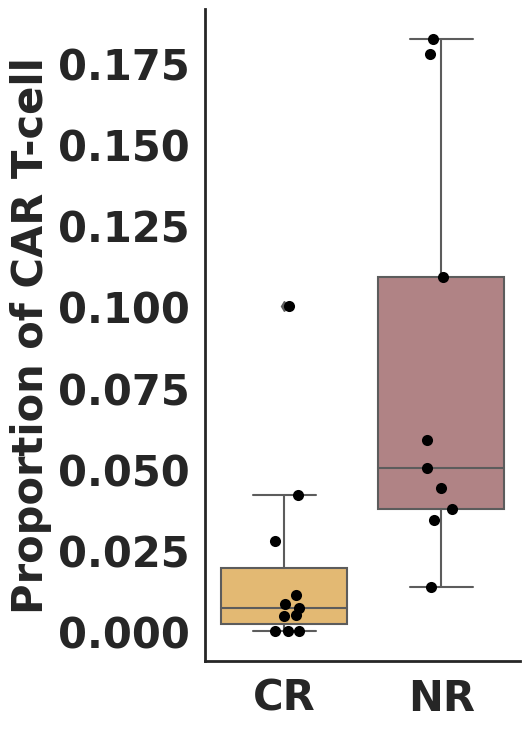

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


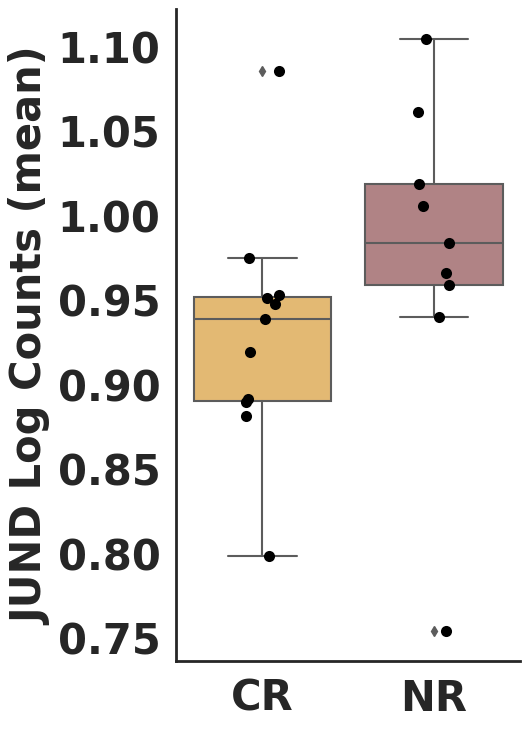

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


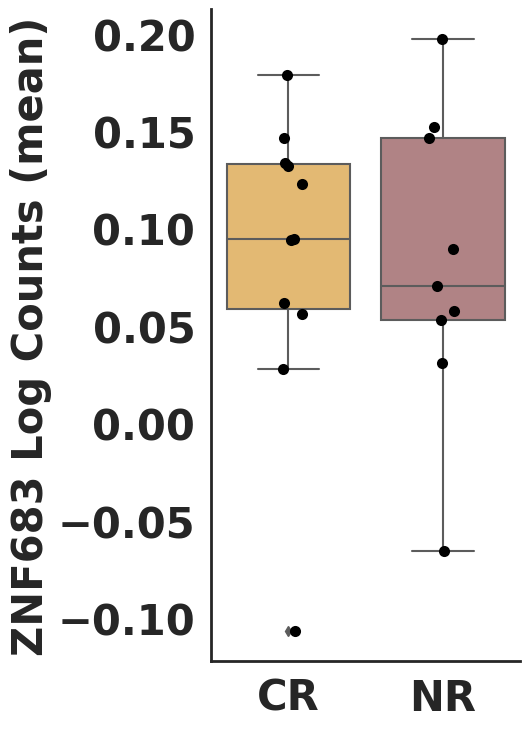

Gene pairs: FCER1G & ZNF683


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


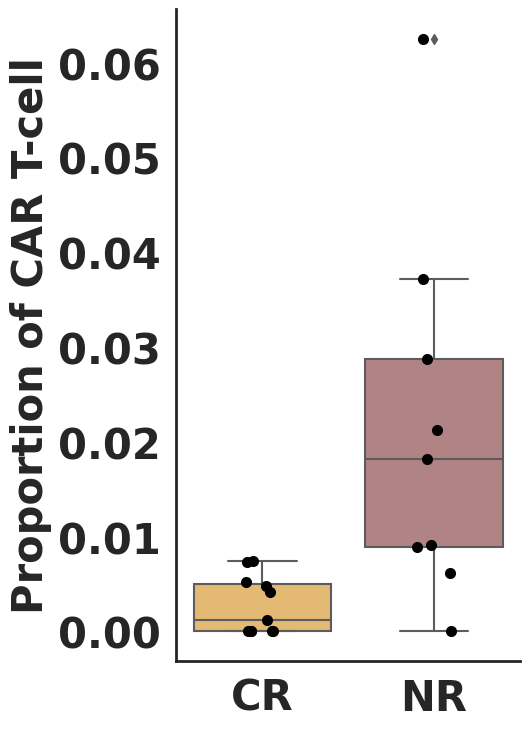

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


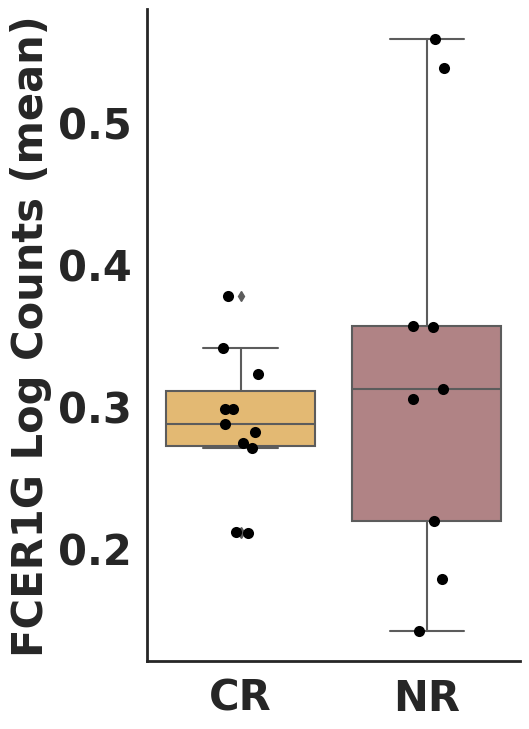

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


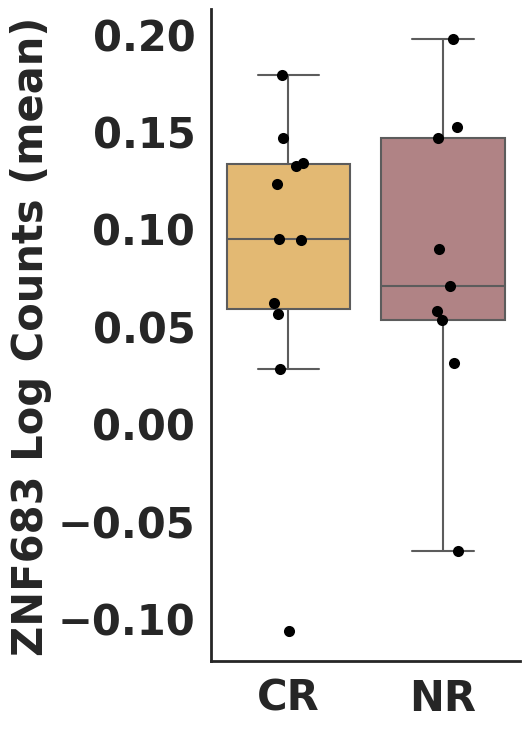

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from scipy.stats import zscore
import matplotlib.pyplot as plt
import seaborn as sns

# Load log-transformed dataset for proportions
adata_log = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_log_CD4 = adata_log[adata_log.obs['cell_type'] == 'CD4'].copy()
adata_log_CR_NR = adata_log_CD4[(adata_log_CD4.obs['response'] == 'CR') | (adata_log_CD4.obs['response'] == 'NR')].copy()

# Load combat-corrected dataset for counts
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_combat_CD4 = adata_combat[adata_combat.obs['cell_type'] == 'CD4'].copy()
adata_combat_CR_NR = adata_combat_CD4[adata_combat_CD4.obs['response'].isin(['CR', 'NR'])].copy()

# Define gene pairs
gene_pairs = [
    ("JUND", "ZNF683"),
    ("FCER1G", "ZNF683"),
]

# Define the color palette
color_palette = ["#F6BD60", "#B77B7E"]

# Set global font and line styles for bold
plt.rcParams['font.weight'] = 'bold'
plt.rcParams['font.size'] = '30'
plt.rcParams['axes.linewidth'] = 2
plt.rcParams['axes.labelweight'] = 'bold'
plt.rcParams['xtick.major.width'] = 2
plt.rcParams['ytick.major.width'] = 2

for gene1, gene2 in gene_pairs:
    # Prepare the data for the gene pair
    print(f'Gene pairs: {gene1} & {gene2}')
    model_data = []
    patients = adata_log_CR_NR.obs['barcode'].unique()

    for patient in patients:
        # Proportions using log-transformed data
        patient_data_log = adata_log_CR_NR[adata_log_CR_NR.obs['barcode'] == patient]
        gene1_expr_log = patient_data_log[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data_log.X) else patient_data_log[:, gene1].X > 0
        gene2_expr_log = patient_data_log[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data_log.X) else patient_data_log[:, gene2].X > 0
        both_genes_expr_log = np.logical_and(gene1_expr_log, gene2_expr_log)
        proportion = np.sum(both_genes_expr_log) / patient_data_log.shape[0]

        # Gene counts using combat-corrected data
        patient_data_combat = adata_combat_CR_NR[adata_combat_CR_NR.obs['barcode'] == patient]
        gene1_count = np.mean(patient_data_combat[:, gene1].X)
        gene2_count = np.mean(patient_data_combat[:, gene2].X)

        # Append the data for analysis
        model_data.append({
            'Patient': patient,
            'Response': patient_data_log.obs['response'].values[0],
            'Proportion_Positive': proportion,
            f'{gene1}_Count': gene1_count,
            f'{gene2}_Count': gene2_count
        })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)
    model_df[f'{gene1}_Count'] = model_df[f'{gene1}_Count'].astype(float)
    model_df[f'{gene2}_Count'] = model_df[f'{gene2}_Count'].astype(float)

    # Visualization - Adjusted version to display tick marks
    sns.set_style("white")

    # 1. Proportion of cells expressing both genes across response groups
    plt.figure(figsize=(6, 8))
    sns.boxplot(x='Response', y='Proportion_Positive', data=model_df, palette=color_palette)
    sns.stripplot(x='Response', y='Proportion_Positive', data=model_df, color='black', size=8, jitter=True)
    plt.xlabel('')  # Ensure the x-axis label is removed
    plt.ylabel('Proportion of CAR T-cell', fontweight='bold')
    plt.tick_params(axis='both', which='both', length=8, width=2, labelsize=20)
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=30)
    sns.despine(top=True, right=True)
    plt.tight_layout()
    plt.show()

    # 2. Gene counts across response groups for gene1
    plt.figure(figsize=(6, 8))
    sns.boxplot(x='Response', y=f'{gene1}_Count', data=model_df, palette=color_palette)
    sns.stripplot(x='Response', y=f'{gene1}_Count', data=model_df, color='black', size=8, jitter=True)
    plt.xlabel('')  # Ensure the x-axis label is removed
    plt.ylabel(f'{gene1} Log Counts (mean)', fontweight='bold')
    plt.tick_params(axis='both', which='both', length=8, width=2, labelsize=20)
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=30)
    sns.despine(top=True, right=True)
    plt.tight_layout()
    plt.show()

    # 3. Gene counts across response groups for gene2
    plt.figure(figsize=(6, 8))
    sns.boxplot(x='Response', y=f'{gene2}_Count', data=model_df, palette=color_palette)
    sns.stripplot(x='Response', y=f'{gene2}_Count', data=model_df, color='black', size=8, jitter=True)
    plt.xlabel('')  # Ensure the x-axis label is removed
    plt.ylabel(f'{gene2} Log Counts (mean)', fontweight='bold')
    plt.tick_params(axis='both', which='both', length=8, width=2, labelsize=20)
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=30)
    sns.despine(top=True, right=True)
    plt.tight_layout()
    plt.show()

Gene: JUND


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


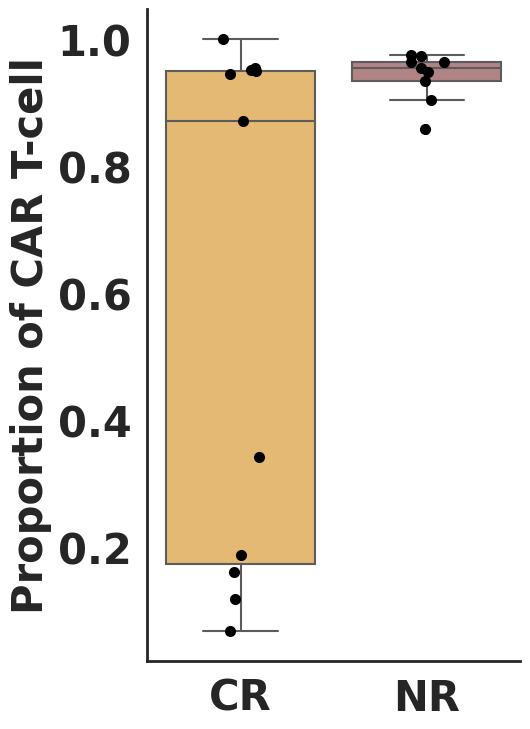

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


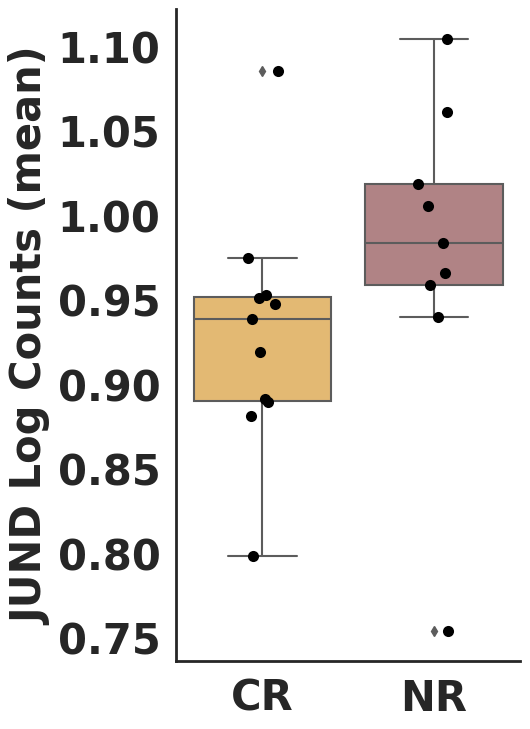

In [6]:
import scanpy as sc
import numpy as np
import pandas as pd
from scipy.sparse import issparse
import matplotlib.pyplot as plt
import seaborn as sns

# Load log-transformed dataset for proportions
adata_log = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_log_CD4 = adata_log[adata_log.obs['cell_type'] == 'CD4'].copy()
adata_log_CR_NR = adata_log_CD4[(adata_log_CD4.obs['response'] == 'CR') | (adata_log_CD4.obs['response'] == 'NR')].copy()

# Load combat-corrected dataset for counts
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_combat_CD4 = adata_combat[adata_combat.obs['cell_type'] == 'CD4'].copy()
adata_combat_CR_NR = adata_combat_CD4[adata_combat_CD4.obs['response'].isin(['CR', 'NR'])].copy()

# Define the gene to analyze
gene = "JUND"

# Define the color palette
color_palette = ["#F6BD60", "#B77B7E"]

# Set global font and line styles for bold
plt.rcParams['font.weight'] = 'bold'
plt.rcParams['font.size'] = 30
plt.rcParams['axes.linewidth'] = 2
plt.rcParams['axes.labelweight'] = 'bold'
plt.rcParams['xtick.major.width'] = 2
plt.rcParams['ytick.major.width'] = 2

# Prepare the data for the gene
print(f'Gene: {gene}')
model_data = []
patients = adata_log_CR_NR.obs['barcode'].unique()

for patient in patients:
    # Proportions using log-transformed data
    patient_data_log = adata_log_CR_NR[adata_log_CR_NR.obs['barcode'] == patient]
    gene_expr_log = patient_data_log[:, gene].X.toarray().flatten() > 0 if issparse(patient_data_log.X) else patient_data_log[:, gene].X > 0
    proportion = np.sum(gene_expr_log) / patient_data_log.shape[0]

    # Gene counts using combat-corrected data
    patient_data_combat = adata_combat_CR_NR[adata_combat_CR_NR.obs['barcode'] == patient]
    gene_count = np.mean(patient_data_combat[:, gene].X)

    # Append the data for analysis
    model_data.append({
        'Patient': patient,
        'Response': patient_data_log.obs['response'].values[0],
        'Proportion_Positive': proportion,
        f'{gene}_Count': gene_count
    })

# Convert the model_data list to a DataFrame
model_df = pd.DataFrame(model_data)
model_df[f'{gene}_Count'] = model_df[f'{gene}_Count'].astype(float)

# Visualization - Adjusted version to display tick marks
sns.set_style("white")

# 1. Proportion of cells expressing JUND across response groups
plt.figure(figsize=(6, 8))
sns.boxplot(x='Response', y='Proportion_Positive', data=model_df, palette=color_palette)
sns.stripplot(x='Response', y='Proportion_Positive', data=model_df, color='black', size=8, jitter=True)
plt.xlabel('')  # Ensure the x-axis label is removed
plt.ylabel('Proportion of CAR T-cell', fontweight='bold')
plt.tick_params(axis='both', which='both', length=8, width=2, labelsize=20)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
sns.despine(top=True, right=True)
plt.tight_layout()
plt.show()

# 2. Gene counts across response groups for JUND
plt.figure(figsize=(6, 8))
sns.boxplot(x='Response', y=f'{gene}_Count', data=model_df, palette=color_palette)
sns.stripplot(x='Response', y=f'{gene}_Count', data=model_df, color='black', size=8, jitter=True)
plt.xlabel('')  # Ensure the x-axis label is removed
plt.ylabel(f'{gene} Log Counts (mean)', fontweight='bold')
plt.tick_params(axis='both', which='both', length=8, width=2, labelsize=20)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
sns.despine(top=True, right=True)
plt.tight_layout()
plt.show()


In [2]:
import scanpy as sc
import numpy as np
import pandas as pd
from scipy.sparse import issparse
from scipy.stats import ranksums

# Load log-transformed dataset for proportions
adata_log = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_log_CD4 = adata_log[adata_log.obs['cell_type'] == 'CD4'].copy()
adata_log_CR_NR = adata_log_CD4[(adata_log_CD4.obs['response'] == 'CR') | (adata_log_CD4.obs['response'] == 'NR')].copy()

# Load combat-corrected dataset for counts
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_combat_CD4 = adata_combat[adata_combat.obs['cell_type'] == 'CD4'].copy()
adata_combat_CR_NR = adata_combat_CD4[adata_combat_CD4.obs['response'].isin(['CR', 'NR'])].copy()

# Define gene pairs
gene_pairs = [
    ("JUND", "ZNF683"),
    ("FCER1G", "ZNF683"),
]

for gene1, gene2 in gene_pairs:
    # Prepare the data for the gene pair
    model_data = []
    patients = adata_log_CR_NR.obs['barcode'].unique()

    for patient in patients:
        # Proportions using log-transformed data
        patient_data_log = adata_log_CR_NR[adata_log_CR_NR.obs['barcode'] == patient]
        gene1_expr_log = patient_data_log[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data_log.X) else patient_data_log[:, gene1].X > 0
        gene2_expr_log = patient_data_log[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data_log.X) else patient_data_log[:, gene2].X > 0
        both_genes_expr_log = np.logical_and(gene1_expr_log, gene2_expr_log)
        proportion = np.sum(both_genes_expr_log) / patient_data_log.shape[0]

        # Gene counts using combat-corrected data
        patient_data_combat = adata_combat_CR_NR[adata_combat_CR_NR.obs['barcode'] == patient]
        gene1_count = np.mean(patient_data_combat[:, gene1].X)
        gene2_count = np.mean(patient_data_combat[:, gene2].X)

        # Append the data for analysis
        model_data.append({
            'Patient': patient,
            'Response': patient_data_log.obs['response'].values[0],
            'Proportion_Positive': proportion,
            f'{gene1}_Count': gene1_count,
            f'{gene2}_Count': gene2_count
        })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)
    model_df[f'{gene1}_Count'] = model_df[f'{gene1}_Count'].astype(float)
    model_df[f'{gene2}_Count'] = model_df[f'{gene2}_Count'].astype(float)

    # Perform Wilcoxon rank-sum test for each variable between CR and NR
    cr_group = model_df[model_df['Response'] == 'CR']
    nr_group = model_df[model_df['Response'] == 'NR']

    # Wilcoxon rank-sum for proportions
    w_proportion, p_proportion = ranksums(cr_group['Proportion_Positive'], nr_group['Proportion_Positive'])
    print(f'\nResults for {gene1} & {gene2}:')
    print(f'Proportion - p-value: {p_proportion:.4f}')

    # Wilcoxon rank-sum for gene1 counts
    w_gene1, p_gene1 = ranksums(cr_group[f'{gene1}_Count'], nr_group[f'{gene1}_Count'])
    print(f'{gene1} Counts - p-value: {p_gene1:.4f}')

    # Wilcoxon rank-sum for gene2 counts
    w_gene2, p_gene2 = ranksums(cr_group[f'{gene2}_Count'], nr_group[f'{gene2}_Count'])
    print(f'{gene2} Counts - p-value: {p_gene2:.4f}')



Results for JUND & ZNF683:
Proportion - p-value: 0.0027
JUND Counts - p-value: 0.0527
ZNF683 Counts - p-value: 0.8494

Results for FCER1G & ZNF683:
Proportion - p-value: 0.0030
FCER1G Counts - p-value: 0.4250
ZNF683 Counts - p-value: 0.8494



Averaged feature importances for gene pair FCER1G & ZNF683:
Proportion    0.739090
FCER1G        0.170797
ZNF683        0.090113
dtype: float32


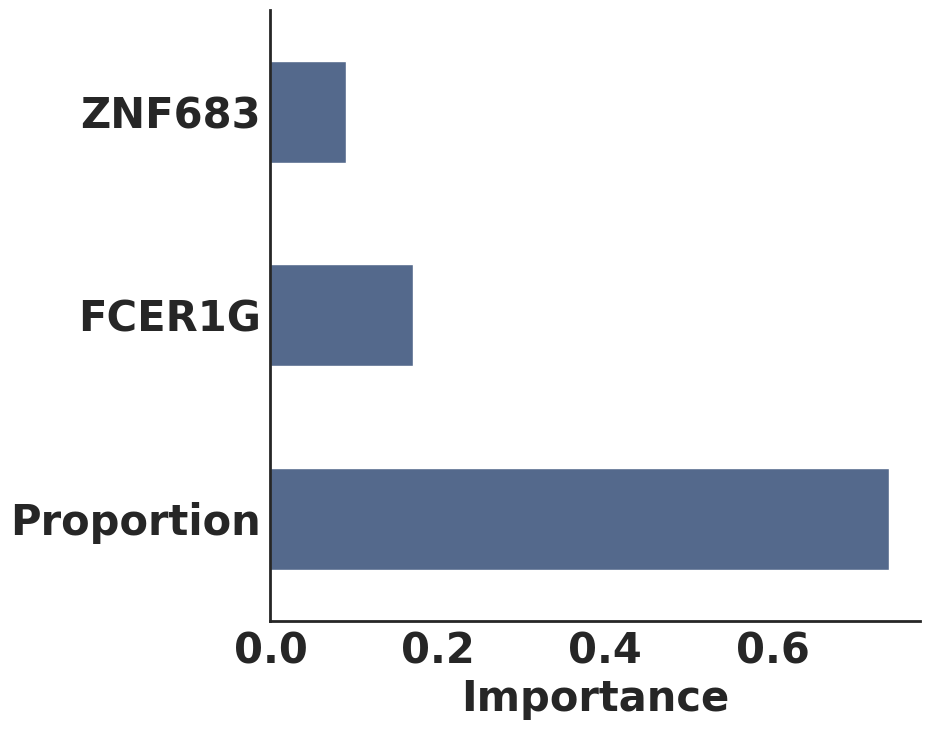


Averaged feature importances for gene pair JUND & ZNF683:
Proportion    0.634873
JUND          0.268744
ZNF683        0.096383
dtype: float32


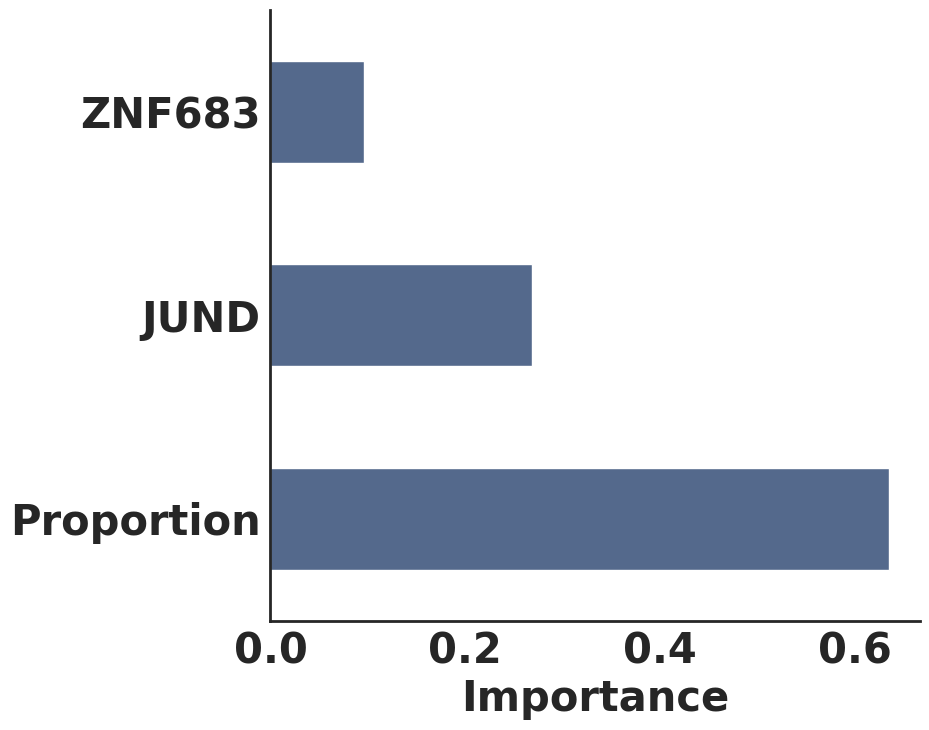

In [3]:
import scanpy as sc
import numpy as np
import pandas as pd
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, average_precision_score
from sklearn.model_selection import StratifiedKFold
import xgboost as xgb
import matplotlib.pyplot as plt
import seaborn as sns

# Load your dataset
adata_log = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_log_CD4 = adata_log[adata_log.obs['cell_type'] == 'CD4'].copy()
adata_log_CR_NR = adata_log_CD4[(adata_log_CD4.obs['response'] == 'CR') | (adata_log_CD4.obs['response'] == 'NR')].copy()

# Load log-transformed dataset for proportions and gene counts
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_combat_CD4 = adata_combat[adata_combat.obs['cell_type'] == 'CD4'].copy()
adata_combat_CR_NR = adata_combat_CD4[adata_combat_CD4.obs['response'].isin(['CR', 'NR'])].copy()

# Encode the 'response' labels (CR and NR only)
le = LabelEncoder()
adata_log_CR_NR.obs['Response_Encoded'] = le.fit_transform(adata_log_CR_NR.obs['response'])  # CR = 0, NR = 1

# Define the list of gene pairs
gene_pairs = [
    ("FCER1G", "ZNF683"),
    ("JUND", "ZNF683")
]

# Define XGBoost parameters
xgb_params = {
    'objective': 'binary:logistic',
    'eval_metric': 'logloss',
    'random_state': 42,
    'n_estimators': 100
}

# Initialize Stratified K-Fold Cross-Validation
n_splits = 5
kf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

# Iterate over all pairs of genes
for gene1, gene2 in gene_pairs:
    model_data = []
    patients = adata_log_CR_NR.obs['barcode'].unique()
    # Calculate the proportion of cells expressing both genes for each patient using adata_log
    for patient in patients:
        patient_data_log = adata_log_CR_NR[adata_log_CR_NR.obs['barcode'] == patient]
        patient_data_combat = adata_combat_CR_NR[adata_combat_CR_NR.obs['barcode'] == patient]

        # Ensure the data is dense if needed
        gene1_expr_log = patient_data_log[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data_log.X) else patient_data_log[:, gene1].X > 0
        gene2_expr_log = patient_data_log[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data_log.X) else patient_data_log[:, gene2].X > 0
        both_genes_expr = np.logical_and(gene1_expr_log, gene2_expr_log)
        proportion = np.sum(both_genes_expr) / patient_data_log.shape[0]

        # Calculate the mean gene counts using adata_combat
        gene1_count_combat = np.mean(patient_data_combat[:, gene1].X)
        gene2_count_combat = np.mean(patient_data_combat[:, gene2].X)

        # Append the data for PERMANOVA analysis
        model_data.append({
            'Patient': patient,
            'Response_Encoded': patient_data_log.obs['Response_Encoded'].values[0],
            'Proportion': proportion,
            f'{gene1}': gene1_count_combat,
            f'{gene2}': gene2_count_combat
        })
    
    # Convert to DataFrame
    model_df = pd.DataFrame(model_data)
    model_df[f'{gene1}'] = model_df[f'{gene1}'].astype(float)
    model_df[f'{gene2}'] = model_df[f'{gene2}'].astype(float)

    # Normalize the features using zscore
    X = model_df[['Proportion', f'{gene1}', f'{gene2}']]
    y = model_df['Response_Encoded']

    # Initialize list to store feature importances
    importances_per_fold = []

    # Perform 5-fold cross-validation
    for train_index, test_index in kf.split(X, y):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        # Train an XGBoost classifier
        xgb_model = xgb.XGBClassifier(**xgb_params)
        xgb_model.fit(X_train, y_train)

        # Store feature importance for this fold
        fold_importances = pd.Series(xgb_model.feature_importances_, index=X.columns)
        importances_per_fold.append(fold_importances)

    # Average feature importances across folds
    avg_importances = pd.concat(importances_per_fold, axis=1).mean(axis=1).sort_values(ascending=False)

    # Print and visualize the averaged feature importances
    print(f"\nAveraged feature importances for gene pair {gene1} & {gene2}:")
    print(avg_importances)

    # Visualization of averaged feature importance
    avg_importances.plot(kind='barh', color='#54698C', figsize=(10, 8))
    plt.xlabel('Importance')
    plt.ylabel('')
    sns.despine(top=True, right=True)
    plt.tight_layout()
    plt.show()


Gene pairs: JUND & ZNF683


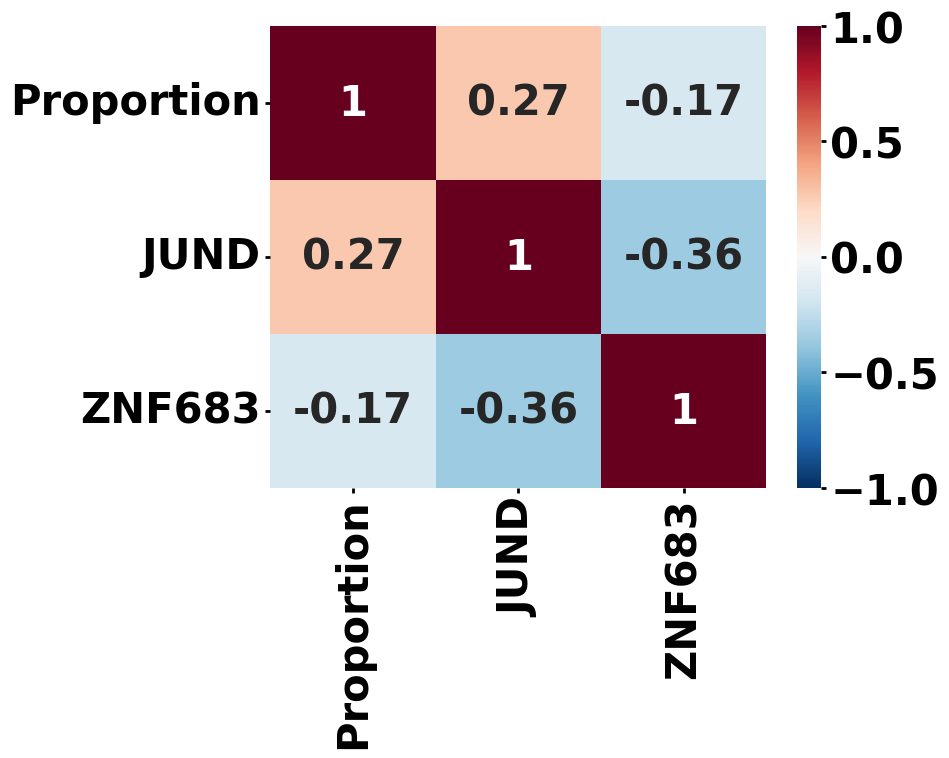

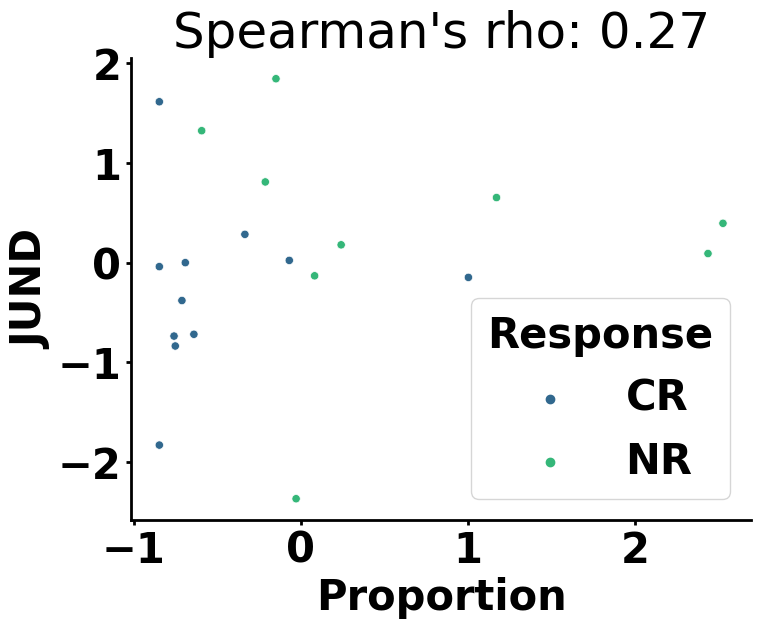

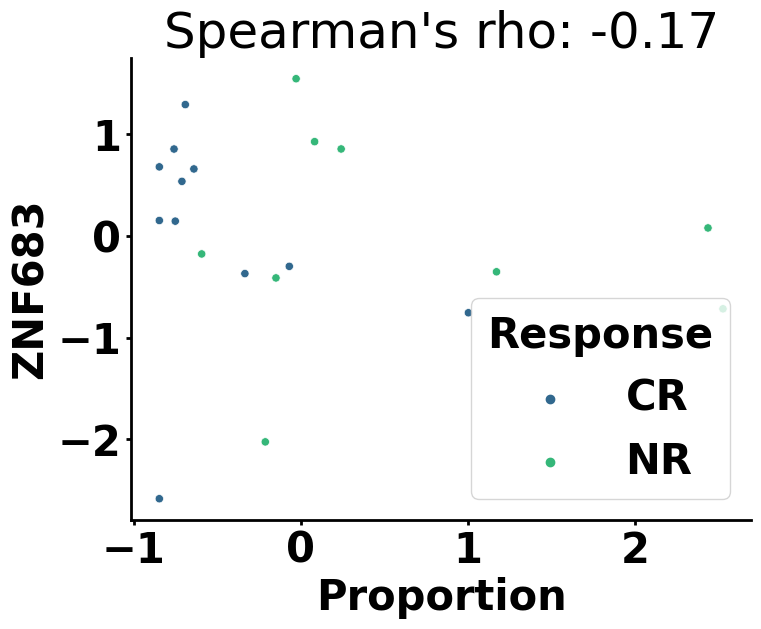

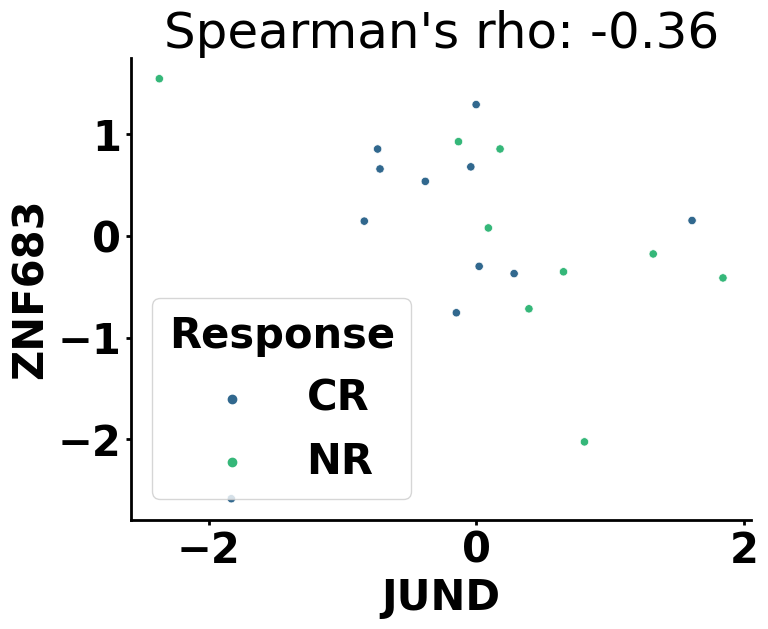

Gene pairs: FCER1G & ZNF683


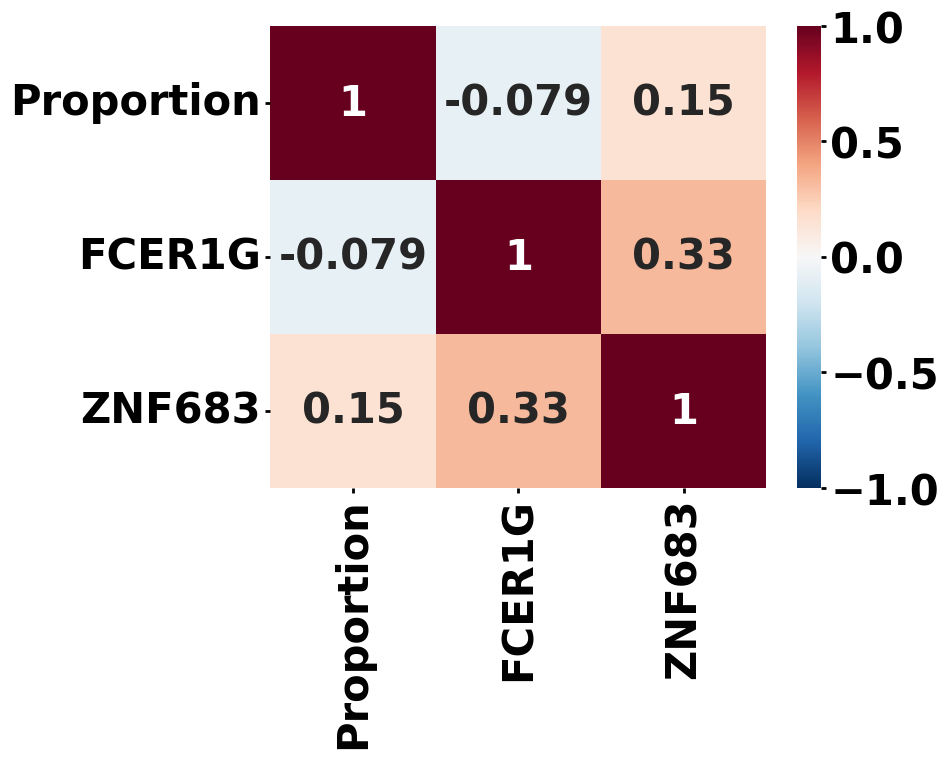

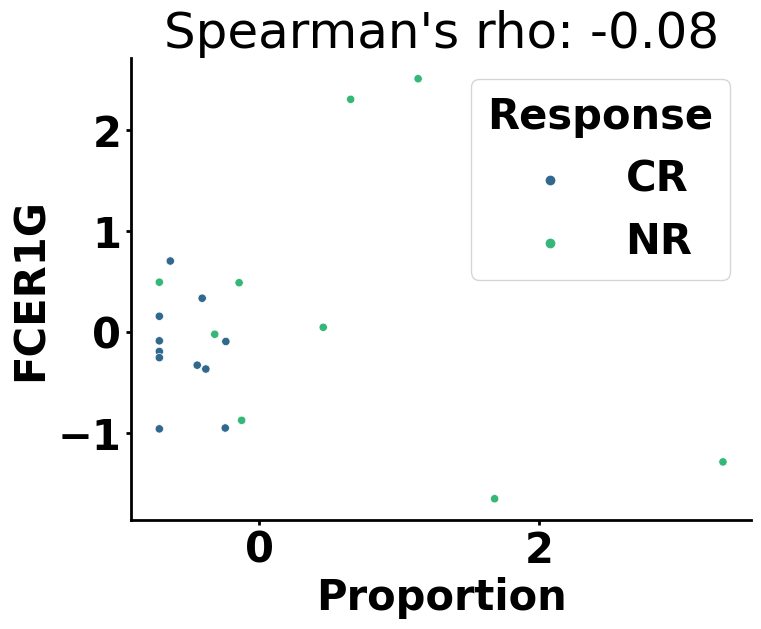

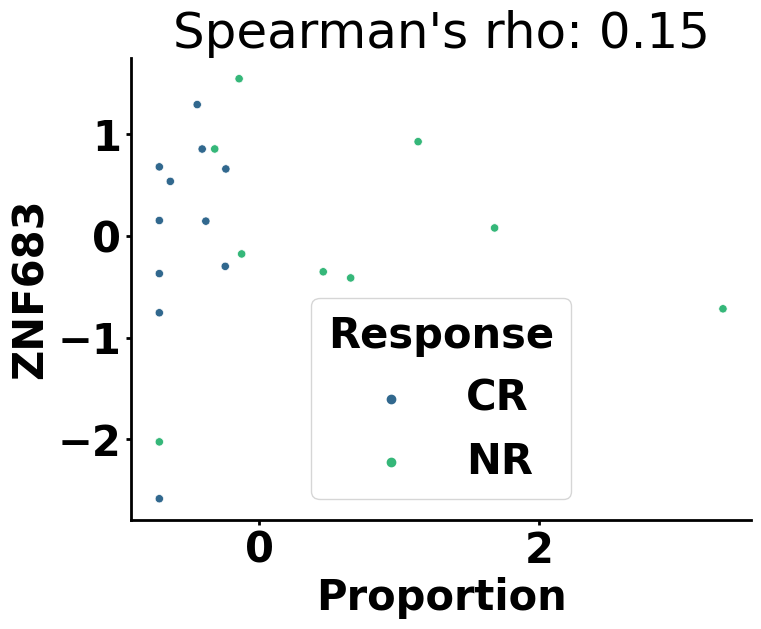

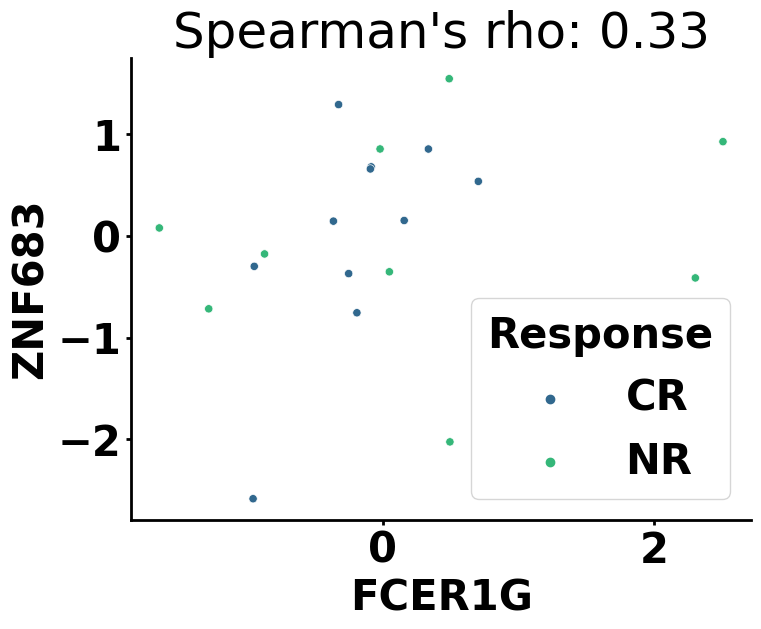

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from scipy.stats import zscore
from scipy.stats import spearmanr, zscore
import matplotlib.pyplot as plt
import seaborn as sns

# Load log-transformed dataset for proportions
adata_log = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_log_CD4 = adata_log[adata_log.obs['cell_type'] == 'CD4'].copy()
adata_log_CR_NR = adata_log_CD4[(adata_log_CD4.obs['response'] == 'CR') | (adata_log_CD4.obs['response'] == 'NR')].copy()

# Load combat-corrected dataset for counts
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_combat_CD4 = adata_combat[adata_combat.obs['cell_type'] == 'CD4'].copy()
adata_combat_CR_NR = adata_combat_CD4[adata_combat_CD4.obs['response'].isin(['CR', 'NR'])].copy()

# Define gene pairs
gene_pairs = [
    ("JUND", "ZNF683"),
    ("FCER1G", "ZNF683"),
]

# Set global font and line styles for bold
plt.rcParams['font.weight'] = 'bold'
plt.rcParams['font.size'] = '30'
plt.rcParams['axes.linewidth'] = 2
plt.rcParams['axes.labelweight'] = 'bold'
plt.rcParams['xtick.major.width'] = 2
plt.rcParams['ytick.major.width'] = 2

for gene1, gene2 in gene_pairs:
    # Prepare the data for the gene pair
    print(f'Gene pairs: {gene1} & {gene2}')
    model_data = []
    patients = adata_log_CR_NR.obs['barcode'].unique()

    for patient in patients:
        # Proportions using log-transformed data
        patient_data_log = adata_log_CR_NR[adata_log_CR_NR.obs['barcode'] == patient]
        gene1_expr_log = patient_data_log[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data_log.X) else patient_data_log[:, gene1].X > 0
        gene2_expr_log = patient_data_log[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data_log.X) else patient_data_log[:, gene2].X > 0
        both_genes_expr_log = np.logical_and(gene1_expr_log, gene2_expr_log)
        proportion = np.sum(both_genes_expr_log) / patient_data_log.shape[0]

        # Gene counts using combat-corrected data
        patient_data_combat = adata_combat_CR_NR[adata_combat_CR_NR.obs['barcode'] == patient]
        gene1_count = np.mean(patient_data_combat[:, gene1].X)
        gene2_count = np.mean(patient_data_combat[:, gene2].X)

        # Append the data for analysis
        model_data.append({
            'Patient': patient,
            'Response': patient_data_log.obs['response'].values[0],
            'Proportion': proportion,
            f'{gene1}': gene1_count,
            f'{gene2}': gene2_count
        })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)
    model_df[f'{gene1}'] = model_df[f'{gene1}'].astype(float)
    model_df[f'{gene2}'] = model_df[f'{gene2}'].astype(float)

        # Normalize the variables using Z-scores
    model_df['Proportion'] = zscore(model_df['Proportion'])
    model_df[f'{gene1}'] = zscore(model_df[f'{gene1}'])
    model_df[f'{gene2}'] = zscore(model_df[f'{gene2}'])

    # 5. Heatmap of Spearman Correlation (using z-score normalized data)
    correlation_matrix = model_df[['Proportion', f'{gene1}', f'{gene2}']].corr(method='spearman')
    plt.figure(figsize=(8, 6))
    sns.heatmap(correlation_matrix, annot=True, cmap='RdBu_r', vmin=-1, vmax=1)
    #sns.despine(top=True, right=True)
    plt.show()
    
    # 6. Scatter plots with Spearman's rho displayed (using z-score normalized data)
    pairs = [
        ('Proportion', f'{gene1}'),
        ('Proportion', f'{gene2}'),
        (f'{gene1}', f'{gene2}')
    ]
    
    for var1, var2 in pairs:
        plt.figure(figsize=(8, 6))
        sns.scatterplot(x=model_df[var1], y=model_df[var2], hue=model_df['Response'], palette='viridis')
        rho, _ = spearmanr(model_df[var1], model_df[var2])
        plt.title(f"Spearman's rho: {rho:.2f}")
        plt.xlabel(var1)
        plt.ylabel(var2)
        sns.despine(top=True, right=True)
        plt.show()  # Make sure to show each scatter plot

In [4]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import mannwhitneyu
from scipy.sparse import issparse

# Load combat-corrected dataset (for visualization)
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')

In [8]:
'CD45RA' in adata_combat.var_names

False

JUND 25% quantile: 0.7975020679226194
ZNF683 25% quantile: -0.10845135570586892
Mann-Whitney U test for IL2RB with JhZh vs JlZl: U-statistic = 46541409.5, p-value = 2.0251102373250457e-05


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


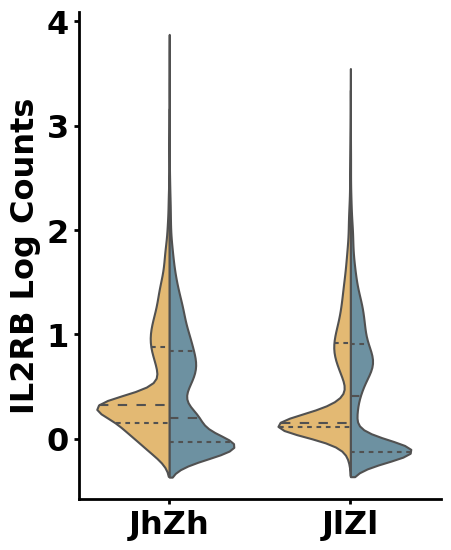

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


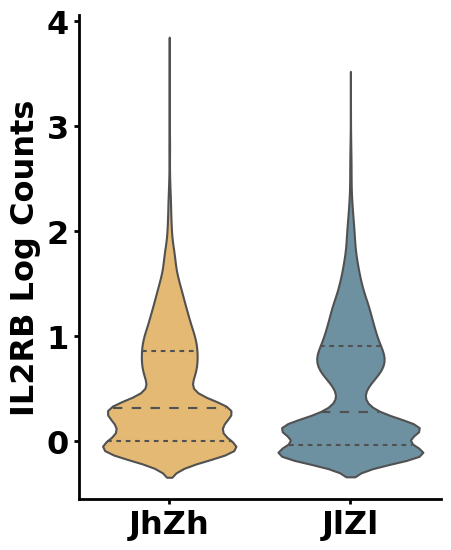

Mann-Whitney U test for IL7R with JhZh vs JlZl: U-statistic = 48106393.5, p-value = 7.850922269102275e-17


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


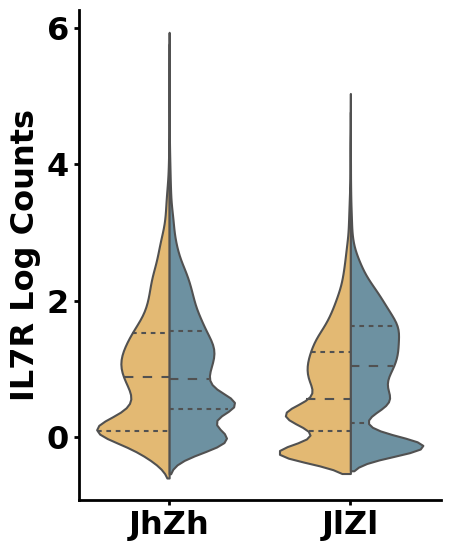

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


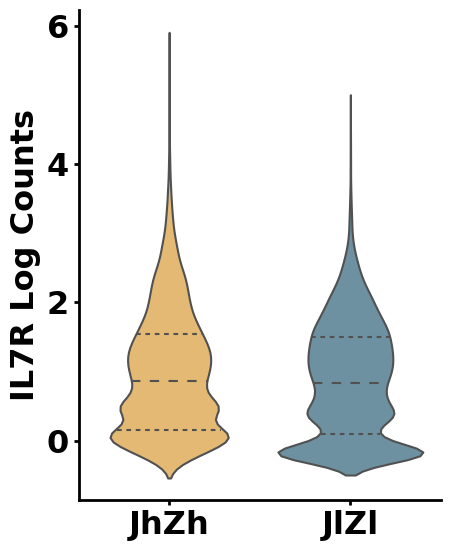

Mann-Whitney U test for CXCR3 with JhZh vs JlZl: U-statistic = 44107742.0, p-value = 0.036244506061008555


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


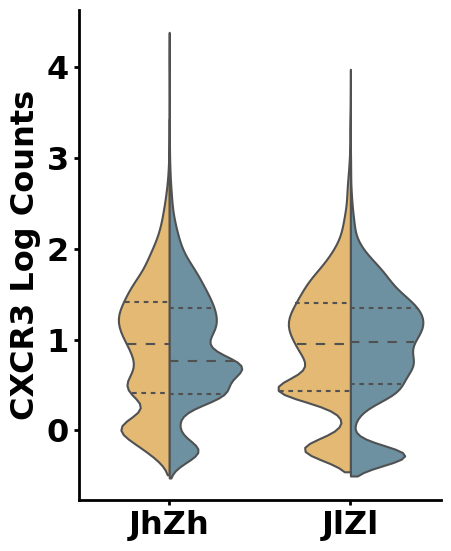

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


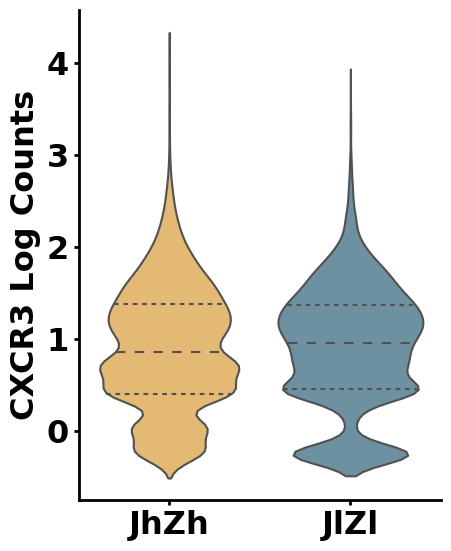

Mann-Whitney U test for CCR7 with JhZh vs JlZl: U-statistic = 56794161.5, p-value = 3.575326030054548e-218


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


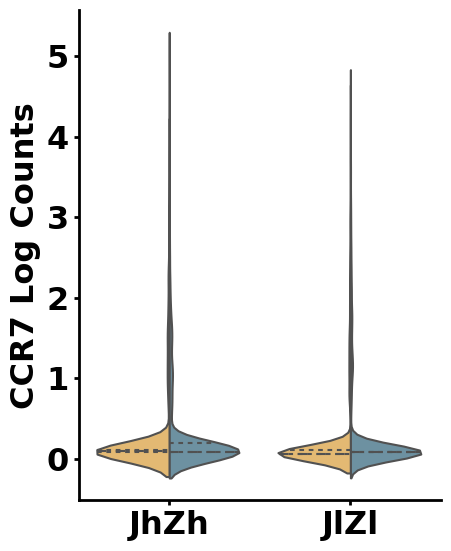

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


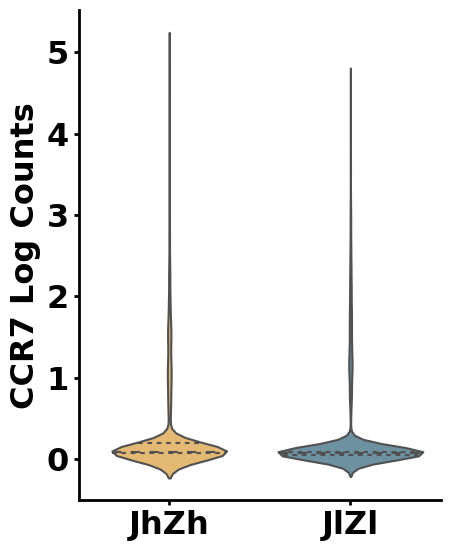

Mann-Whitney U test for CD27 with JhZh vs JlZl: U-statistic = 44474674.0, p-value = 0.2553373005802493


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


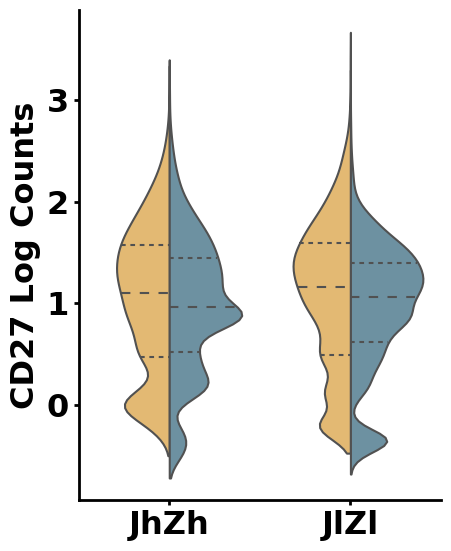

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


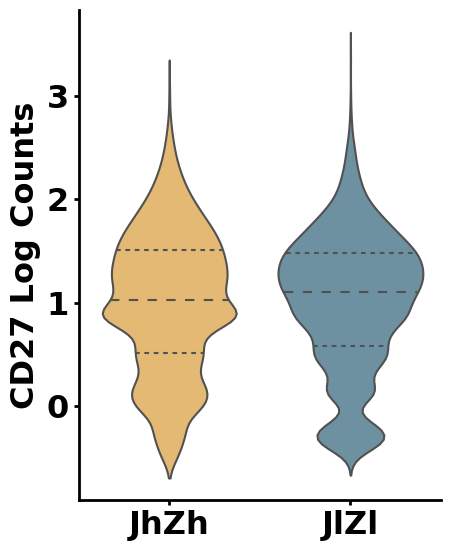

Mann-Whitney U test for CD28 with JhZh vs JlZl: U-statistic = 46125003.5, p-value = 0.0015230888103970716


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


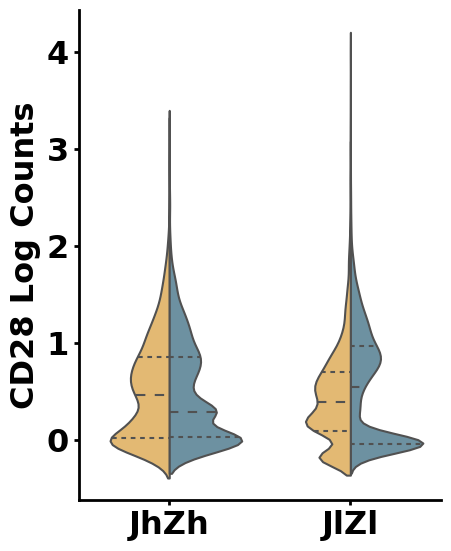

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


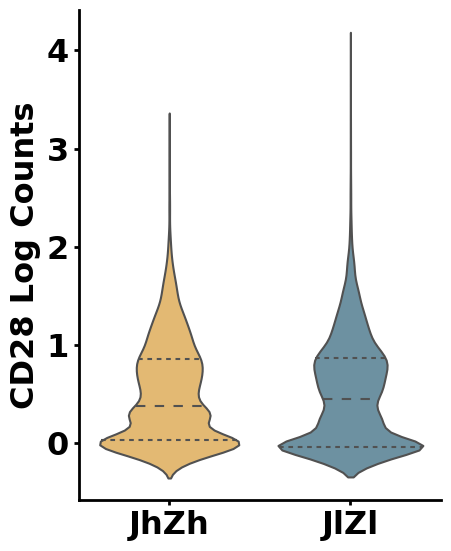

Mann-Whitney U test for TNFRSF4 with JhZh vs JlZl: U-statistic = 51562235.5, p-value = 1.1480454454564627e-68


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


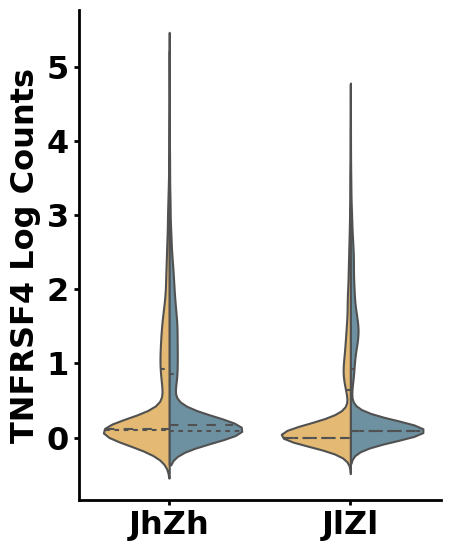

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


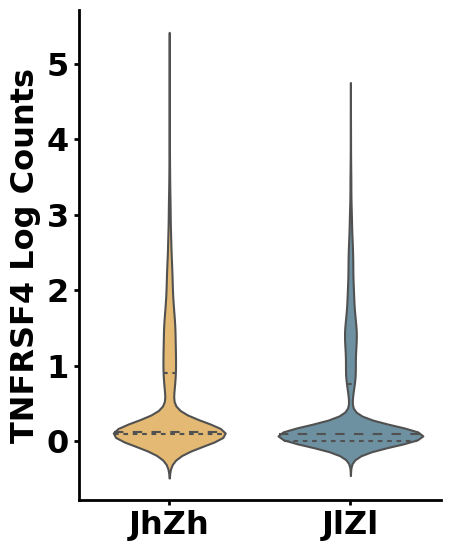

Mann-Whitney U test for TNFRSF9 with JhZh vs JlZl: U-statistic = 43314238.5, p-value = 2.0022484348550175e-05


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


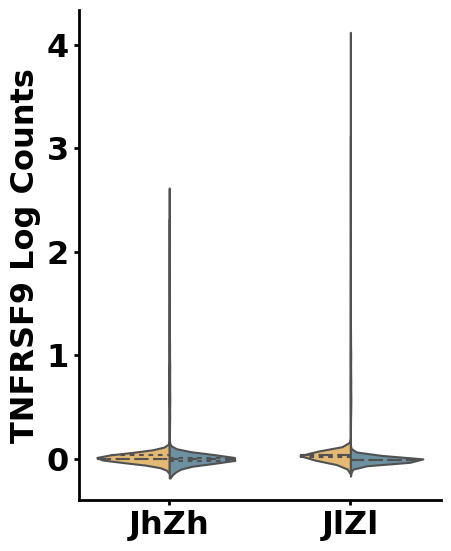

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


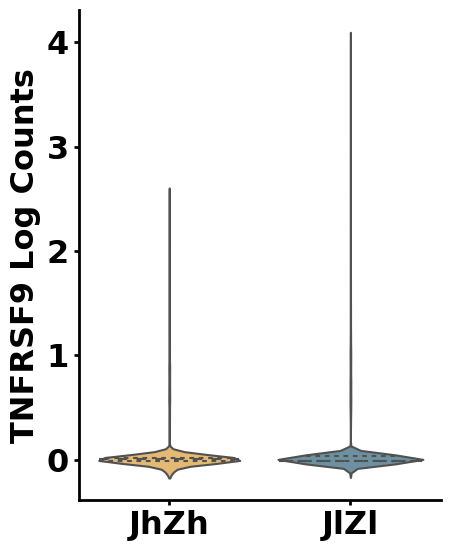

Mann-Whitney U test for ICOS with JhZh vs JlZl: U-statistic = 47025142.0, p-value = 3.1083042060090656e-08


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


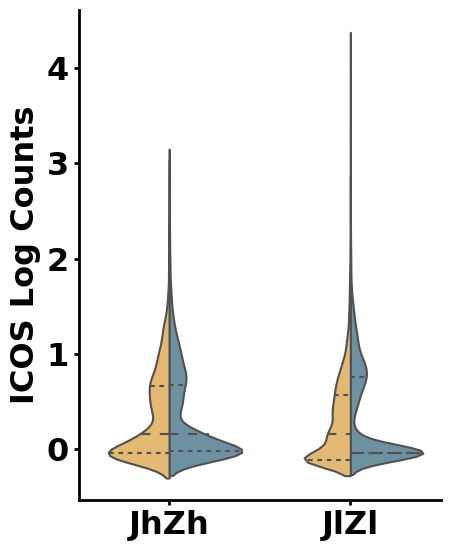

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


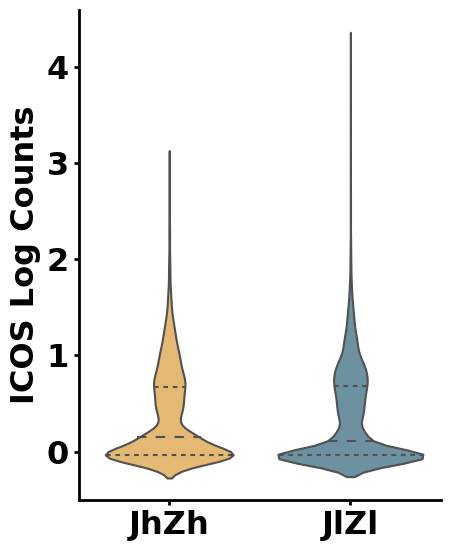

Mann-Whitney U test for ENTPD1 with JhZh vs JlZl: U-statistic = 45592468.5, p-value = 0.06946358453388343


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


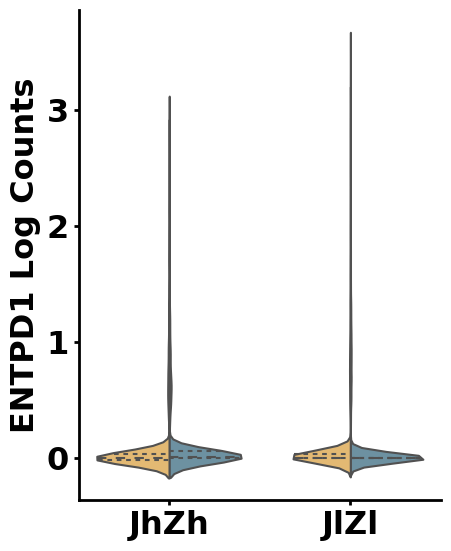

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


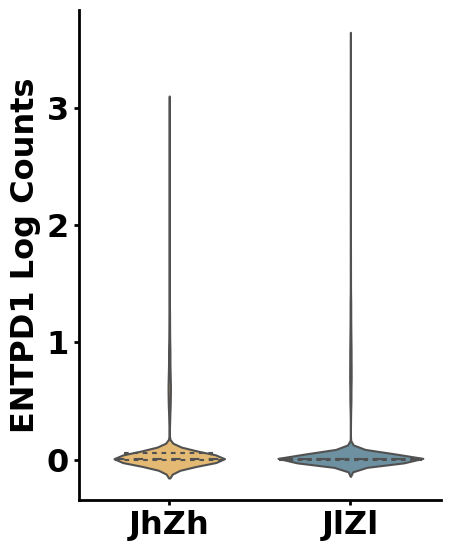

Mann-Whitney U test for CD101 with JhZh vs JlZl: U-statistic = 54794268.0, p-value = 6.397441318728847e-154


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


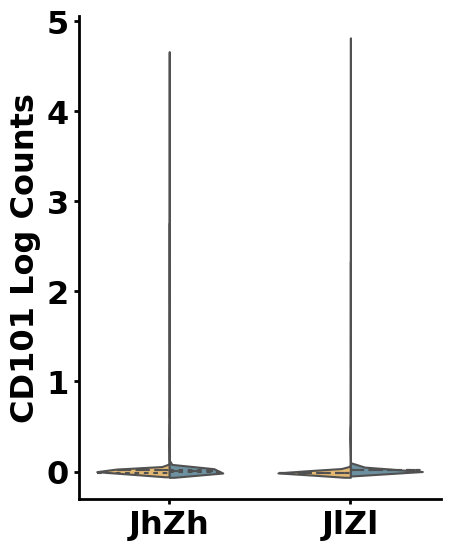

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


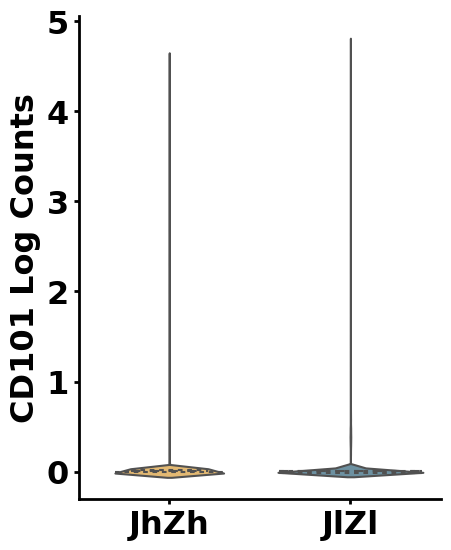

Mann-Whitney U test for CTLA4 with JhZh vs JlZl: U-statistic = 46532523.0, p-value = 2.2763507618513042e-05


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


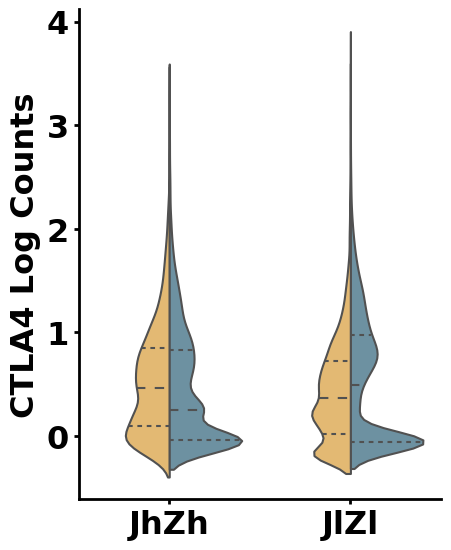

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


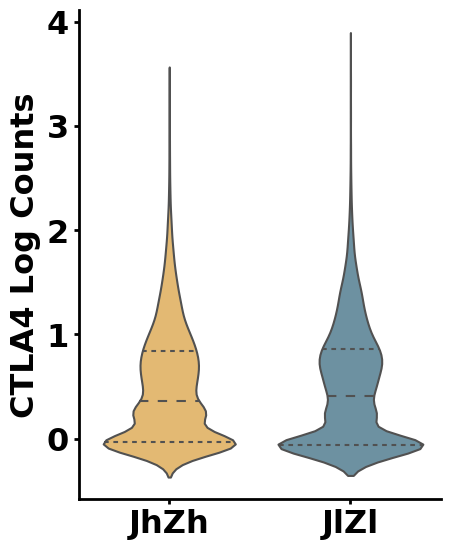

Mann-Whitney U test for LAG3 with JhZh vs JlZl: U-statistic = 43244774.0, p-value = 1.3623560797813077e-05


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


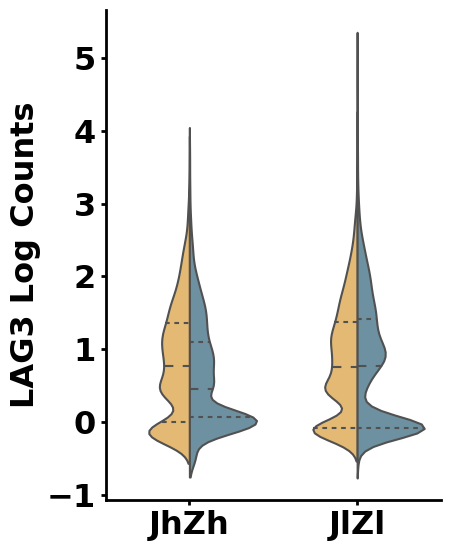

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


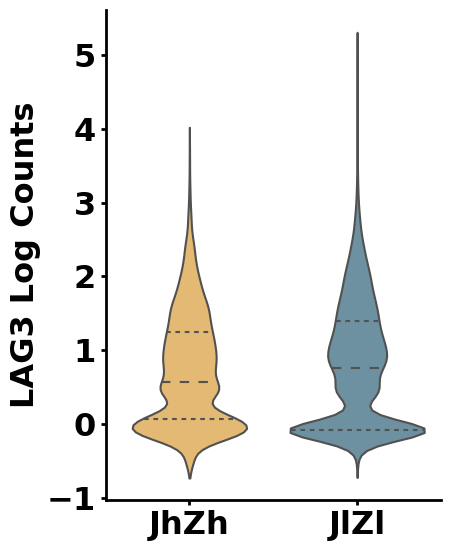

Mann-Whitney U test for CD244 with JhZh vs JlZl: U-statistic = 41188618.0, p-value = 2.2258136155402802e-23


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


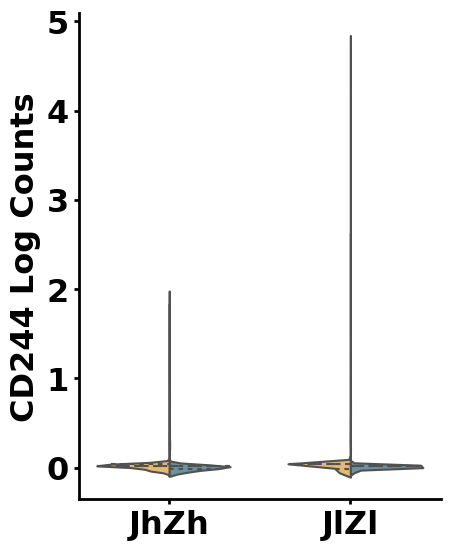

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


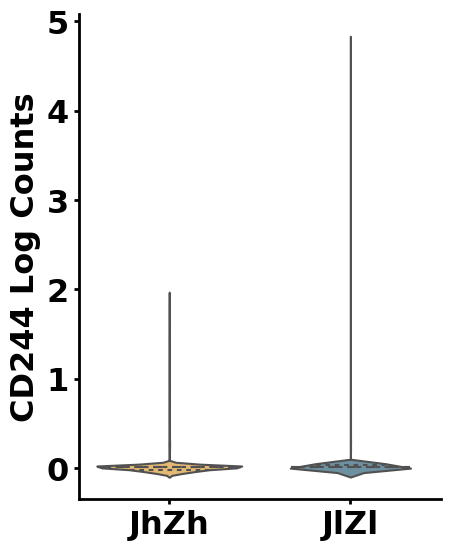

Mann-Whitney U test for BTLA with JhZh vs JlZl: U-statistic = 51308713.5, p-value = 6.029345665845073e-65


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


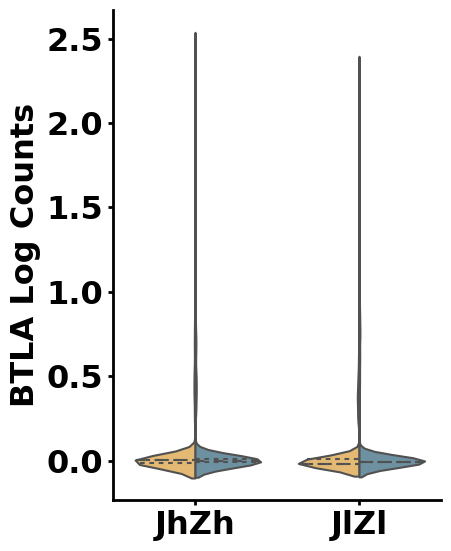

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


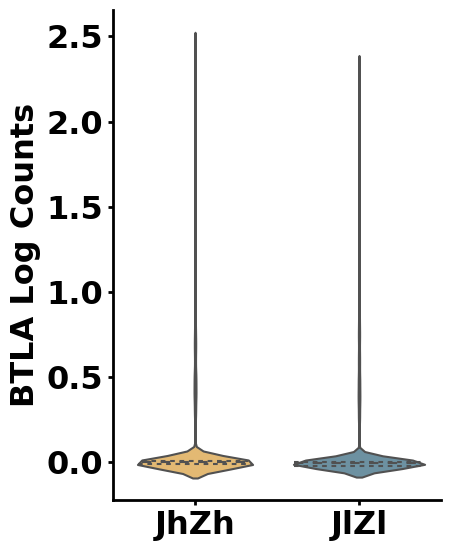

Mann-Whitney U test for CD274 with JhZh vs JlZl: U-statistic = 40666196.0, p-value = 7.702814608410876e-30


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


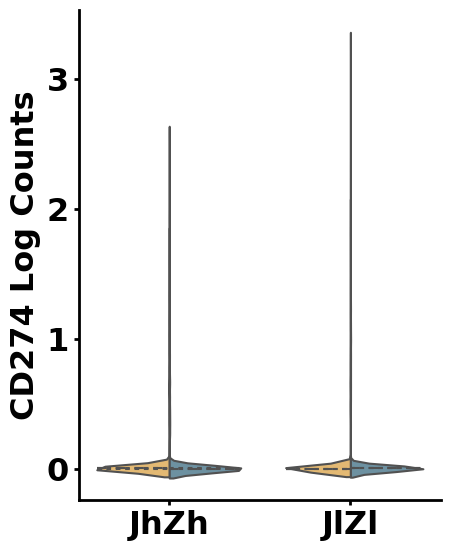

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


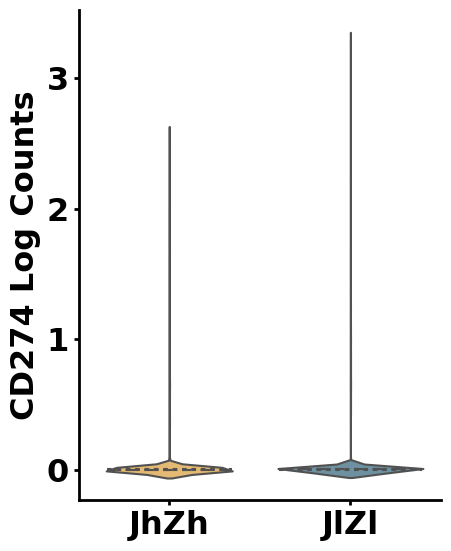

Mann-Whitney U test for PDCD1 with JhZh vs JlZl: U-statistic = 49428696.0, p-value = 3.5500783182196676e-32


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


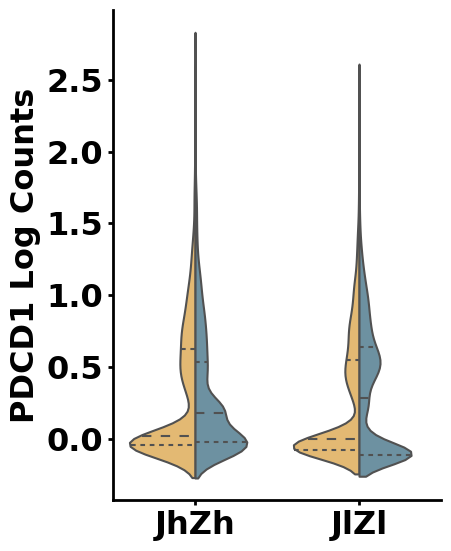

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


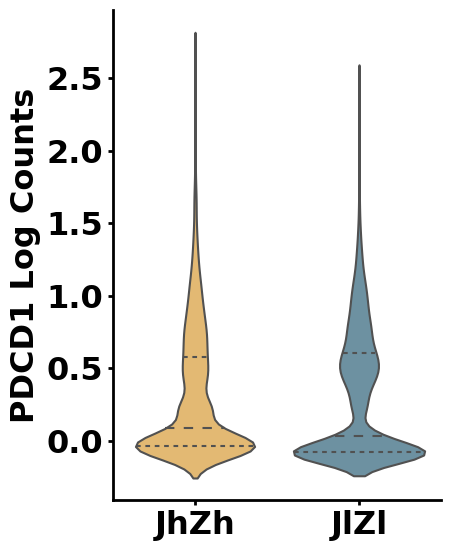

Mann-Whitney U test for HAVCR2 with JhZh vs JlZl: U-statistic = 45750727.0, p-value = 0.02782987961882849


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


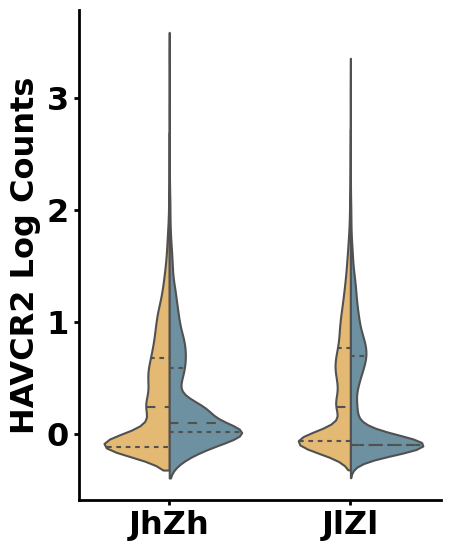

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


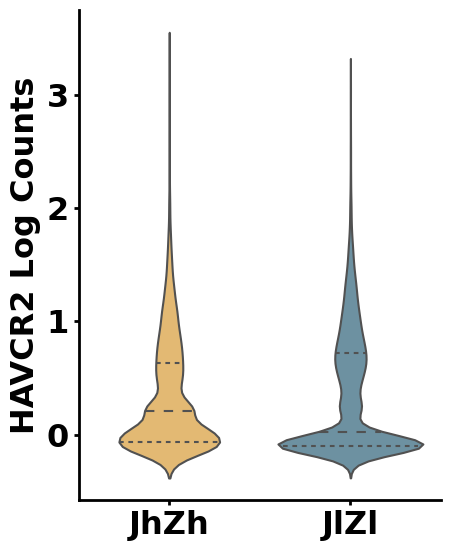

Mann-Whitney U test for TIGIT with JhZh vs JlZl: U-statistic = 44316011.0, p-value = 0.11885149944507012


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


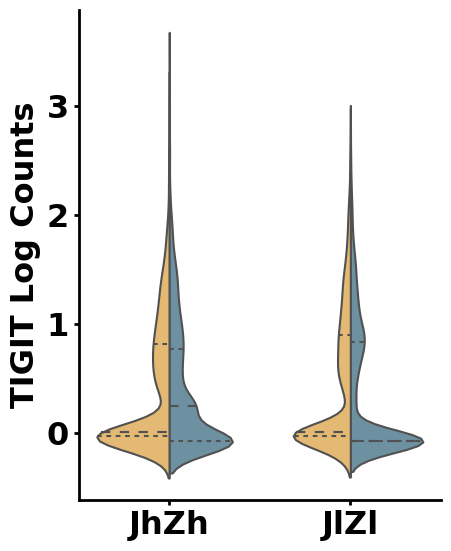

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


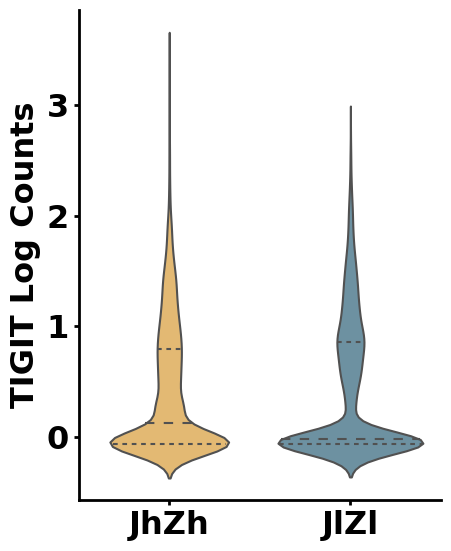

Mann-Whitney U test for IL2RA with JhZh vs JlZl: U-statistic = 49723224.0, p-value = 9.216011034982041e-37


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


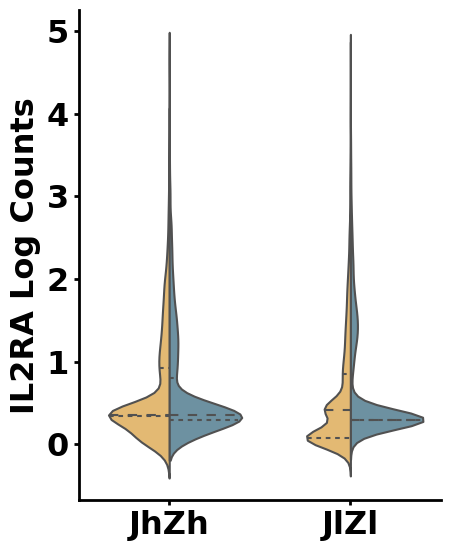

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


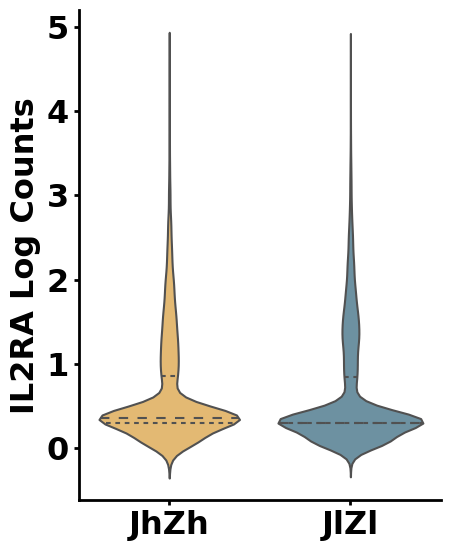

Mann-Whitney U test for CD38 with JhZh vs JlZl: U-statistic = 38039903.5, p-value = 1.7350031543620835e-73


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


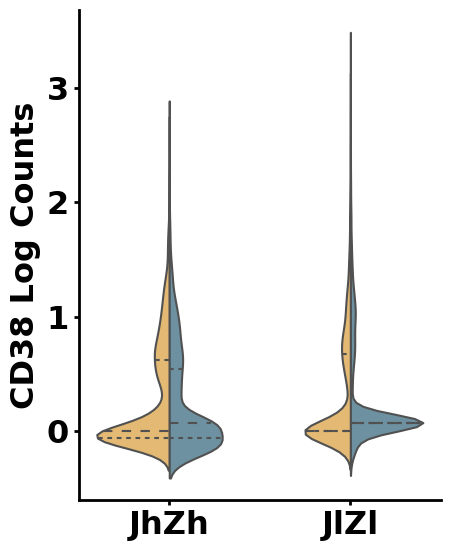

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


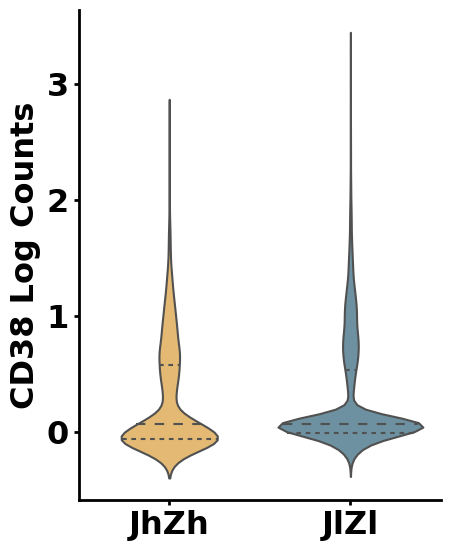

Mann-Whitney U test for MKI67 with JhZh vs JlZl: U-statistic = 44156481.0, p-value = 0.047132544495166885


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


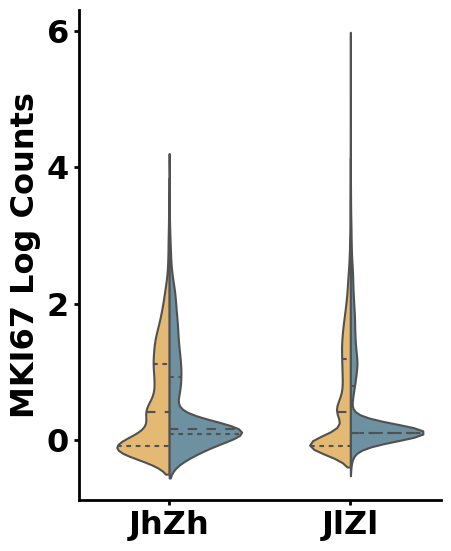

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


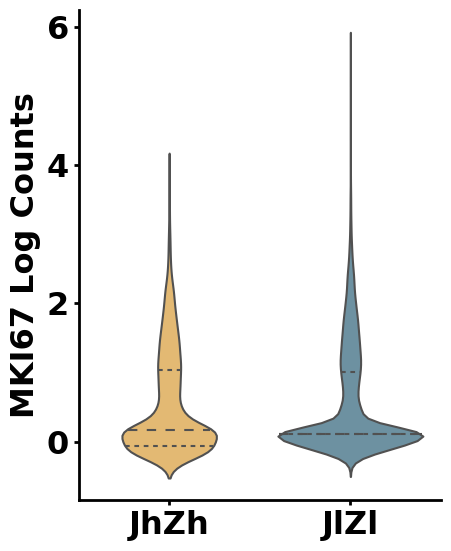

Mann-Whitney U test for PRDM1 with JhZh vs JlZl: U-statistic = 45165337.0, p-value = 0.5046618835959714


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


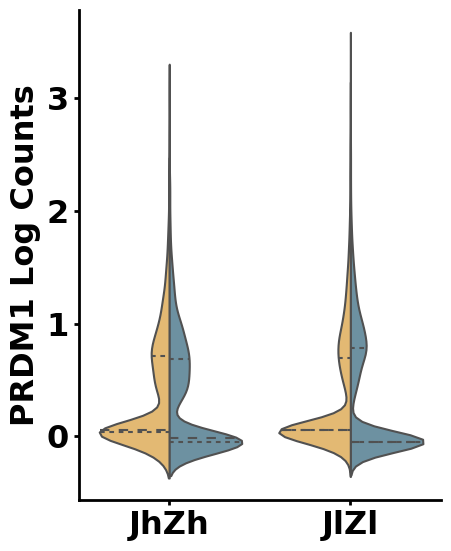

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


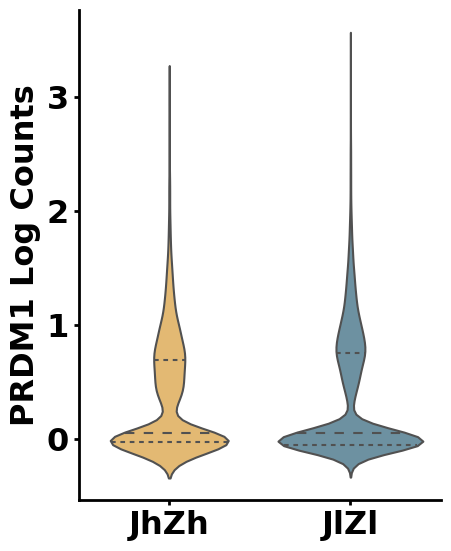

Mann-Whitney U test for EOMES with JhZh vs JlZl: U-statistic = 48057496.5, p-value = 4.7332016676535185e-17


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


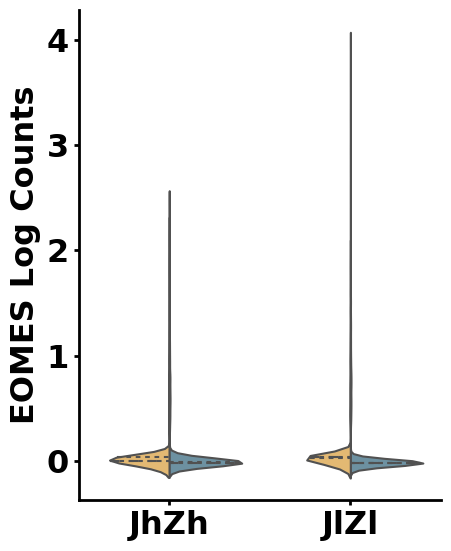

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


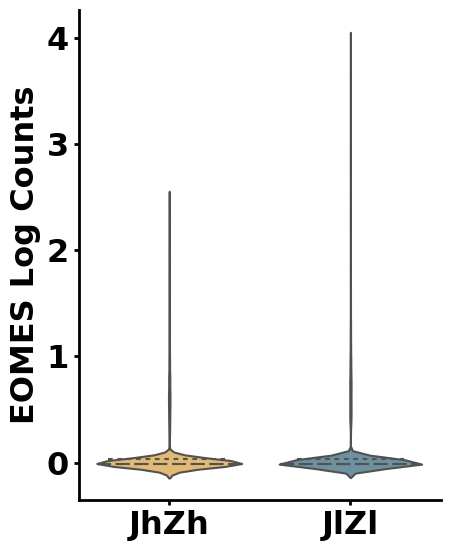

Mann-Whitney U test for IKZF2 with JhZh vs JlZl: U-statistic = 50258533.0, p-value = 9.116573424788492e-46


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


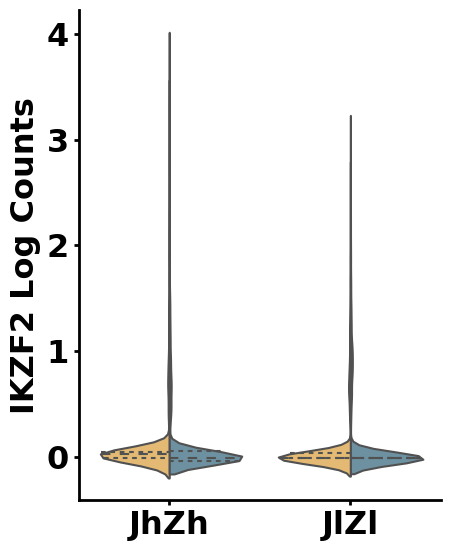

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


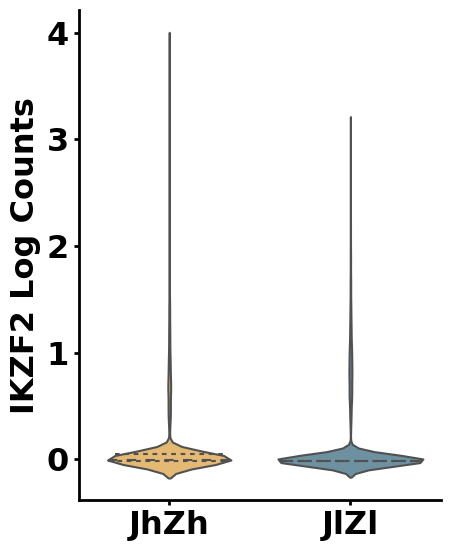

Mann-Whitney U test for TBX21 with JhZh vs JlZl: U-statistic = 45750891.0, p-value = 0.027952152429685833


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


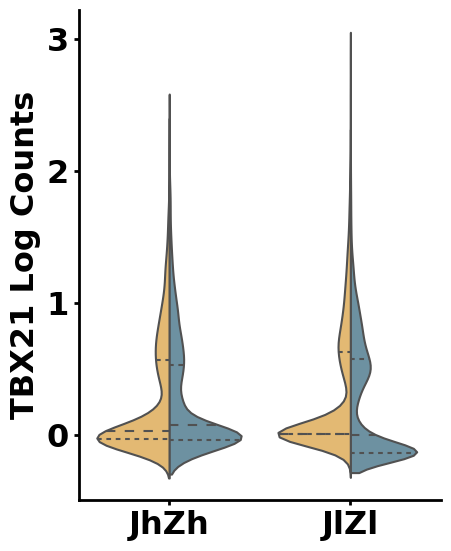

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


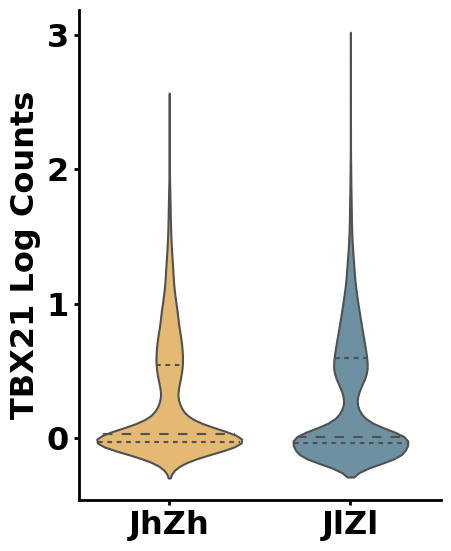

Mann-Whitney U test for B3GAT1 with JhZh vs JlZl: U-statistic = 24777634.5, p-value = 0.0


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


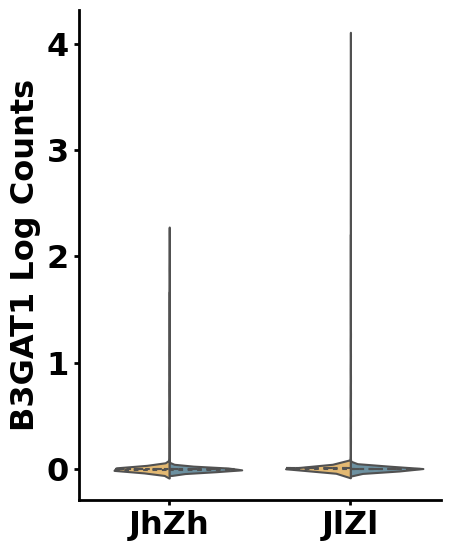

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


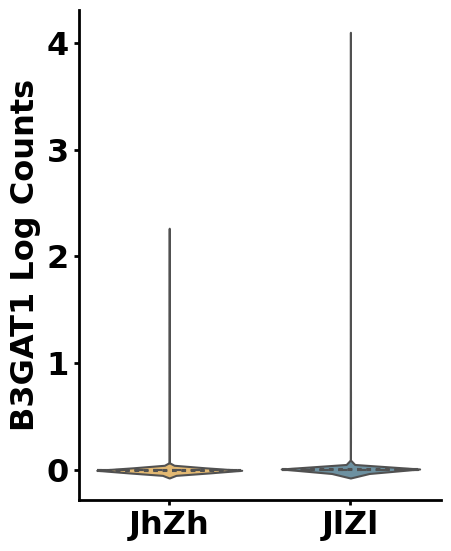

Bonferroni corrected p-value for IL2RB: 0.0005467797640777624
Bonferroni corrected p-value for IL7R: 2.1197490126576144e-15
Bonferroni corrected p-value for CXCR3: 0.978601663647231
Bonferroni corrected p-value for CCR7: 9.653380281147279e-217
Bonferroni corrected p-value for CD27: 1.0
Bonferroni corrected p-value for CD28: 0.04112339788072093
Bonferroni corrected p-value for TNFRSF4: 3.099722702732449e-67
Bonferroni corrected p-value for TNFRSF9: 0.0005406070774108548
Bonferroni corrected p-value for ICOS: 8.392421356224477e-07
Bonferroni corrected p-value for ENTPD1: 1.0
Bonferroni corrected p-value for CD101: 1.7273091560567888e-152
Bonferroni corrected p-value for CTLA4: 0.0006146147056998522
Bonferroni corrected p-value for LAG3: 0.0003678361415409531
Bonferroni corrected p-value for CD244: 6.009696761958756e-22
Bonferroni corrected p-value for BTLA: 1.6279233297781697e-63
Bonferroni corrected p-value for CD274: 2.0797599442709363e-28
Bonferroni corrected p-value for PDCD1: 9.5852

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import mannwhitneyu
from scipy.sparse import issparse

# Load combat-corrected dataset (for visualization)
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_combat_CD4 = adata_combat[adata_combat.obs['cell_type'] == 'CD4'].copy()
adata_combat_CR_NR = adata_combat_CD4[(adata_combat_CD4.obs['response'] == 'CR') | (adata_combat_CD4.obs['response'] == 'NR')].copy()

# Define the gene list for marker comparison
genes = [
    "IL2RB",  # CD122 (IL2Rβ)
    "IL7R",   # CD127 (IL7Rα)
    "CXCR3",  # CD183 (CXCR3)
    "CCR7",   # CD197 (CCR7)
    # Co-stimulatory receptors
    "CD27",   # CD27
    "CD28",   # CD28
    "TNFRSF4",# CD134 (OX40)
    "TNFRSF9",# CD137 (4-1BB)
    "ICOS",   # CD278 (ICOS)
    # Exhaustion markers
    "ENTPD1", # CD39
    "CD101",  # CD101
    "CTLA4",  # CD152 (CTLA4)
    "LAG3",   # CD223 (LAG3)
    "CD244",  # CD244 (2B4)
    "BTLA",   # CD272 (BTLA)
    "CD274",  # CD274 (PD-L1)
    "PDCD1",  # CD279 (PD1)
    "HAVCR2", # CD366 (TIM3)
    "TIGIT",  # TIGIT
    # Activation markers
    "IL2RA",  # CD25 (IL2Rα)
    "CD38",   # CD38 (ADPRC1)
    # Proliferation marker
    "MKI67",  # Ki-67
    # Transcription factors
    "PRDM1",  # Blimp-1
    "EOMES",  # Eomes
    "IKZF2",  # Helios
    "TBX21",  # T-bet
    # Senescence marker
    "B3GAT1"  # CD57
]

# Identify JUND+ and ZNF683+ populations using log-transformed data
primary_gene_1 = "JUND"
primary_gene_2 = "ZNF683"

# Calculate the 25% quantile of both genes' expression
JUND_CR_NR = adata_combat_CR_NR[:, primary_gene_1].X.toarray().flatten() if issparse(adata_combat_CR_NR.X) else adata_combat_CR_NR[:, primary_gene_1].X.flatten()
ZNF683_CR_NR = adata_combat_CR_NR[:, primary_gene_2].X.toarray().flatten() if issparse(adata_combat_CR_NR.X) else adata_combat_CR_NR[:, primary_gene_2].X.flatten()
mask_JUND_positive_25perct = np.quantile(JUND_CR_NR, 0.25)
mask_ZNF683_positive_25perct = np.quantile(ZNF683_CR_NR, 0.25)
print(f"JUND 25% quantile: {mask_JUND_positive_25perct}")
print(f"ZNF683 25% quantile: {mask_ZNF683_positive_25perct}")
mask_JUND_ZNF683_positive = (JUND_CR_NR > mask_JUND_positive_25perct) & (ZNF683_CR_NR > mask_ZNF683_positive_25perct)  # JUND+ZNF683+
adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'] = np.where(mask_JUND_ZNF683_positive, 'JhZh', 'JlZl')
adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'] = adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'].astype('category')

# Convert data to a DataFrame for plotting
df = adata_combat_CR_NR.to_df()
df[f'{primary_gene_1}_{primary_gene_2}_positive'] = adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'].values
df['response'] = adata_combat_CR_NR.obs['response'].values  # add response labels

# Set the order for the x-axis categories to ensure JUND+ZNF683+ appears first
category_order = ['JhZh', 'JlZl']

# Initialize a list to store p-values for Bonferroni correction
p_values = []

# Loop through each gene in the list and compare its expression between JUND+ZNF683+ and JUND-ZNF683- cells
plt.rcParams['font.weight'] = 'bold'
plt.rcParams['font.size'] = 23
plt.rcParams['axes.linewidth'] = 2
plt.rcParams['axes.labelweight'] = 'bold'
plt.rcParams['xtick.major.width'] = 2
plt.rcParams['ytick.major.width'] = 2

for gene in genes:
    if gene in adata_combat_CR_NR.var_names:
        df['value'] = adata_combat_CR_NR[:, adata_combat_CR_NR.var_names == gene].X.toarray().flatten()

        # Separate values for cells expressing JUND+ZNF683+ (J+Z+) and not (J-Z-)
        group_positive = df[df[f'{primary_gene_1}_{primary_gene_2}_positive'] == 'JhZh']['value']
        group_negative = df[df[f'{primary_gene_1}_{primary_gene_2}_positive'] == 'JlZl']['value']

        # Perform Mann-Whitney U test to compare J+Z+ and J-Z-
        stat, p_value = mannwhitneyu(group_positive, group_negative, alternative='two-sided')
        p_values.append(p_value)
        print(f"Mann-Whitney U test for {gene} with JhZh vs JlZl: U-statistic = {stat}, p-value = {p_value}")

        # Create the violin plot using seaborn, split by JUND_ZNF683 expression
        plt.figure(figsize=(5, 6))
        sns.violinplot(data=df, x=f'{primary_gene_1}_{primary_gene_2}_positive', y='value', hue='response', split=True, inner="quart", palette=["#F6BD60", '#6494AA'], order=category_order)
        sns.despine()  # Remove the top and right spines

        # Remove the legend and customize the plot
        plt.legend([], [], frameon=False)
        plt.title(f'')
        plt.xlabel('')
        plt.ylabel(f'{gene} Log Counts')
        plt.tight_layout()

        # Display the plot
        plt.show()

        plt.figure(figsize=(5, 6))
        sns.violinplot(data=df, x=f'{primary_gene_1}_{primary_gene_2}_positive', y='value', inner="quart", palette=["#F6BD60", '#6494AA'], order=category_order)
        #sns.stripplot(data=df, x=f'{primary_gene}_positive', y='value', hue='response', dodge=True, palette=["black"], order=category_order, jitter=True, size=4, alpha=0.5)
        sns.despine()  # Remove the top and right spines

        # Remove the legend
        plt.legend([], [], frameon=False)
        # Customize the plot
        plt.title(f'')
        plt.xlabel('')
        plt.ylabel(f'{gene} Log Counts')
        plt.tight_layout()

        # Save or display the plot
        #plt.savefig(f'/home/emma/result/CART/violinplot_JUND/{primary_gene}_{gene}_violinplot.png')
        plt.show()
    else:
        print(f"{gene} is not present in the variable names. Please check your adata object.")

# Apply Bonferroni correction
bonferroni_corrected_p_values = np.minimum(np.array(p_values) * len(genes), 1.0)

# Print corrected p-values
for gene, corrected_p_value in zip(genes, bonferroni_corrected_p_values):
    print(f"Bonferroni corrected p-value for {gene}: {corrected_p_value}")


Mann-Whitney U test for IL2RB with JhZh vs JlZl: U-statistic = 14966615.0, p-value = 0.4247139932547557


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


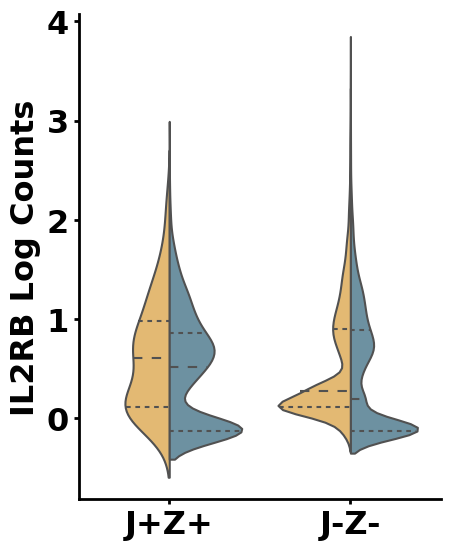

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


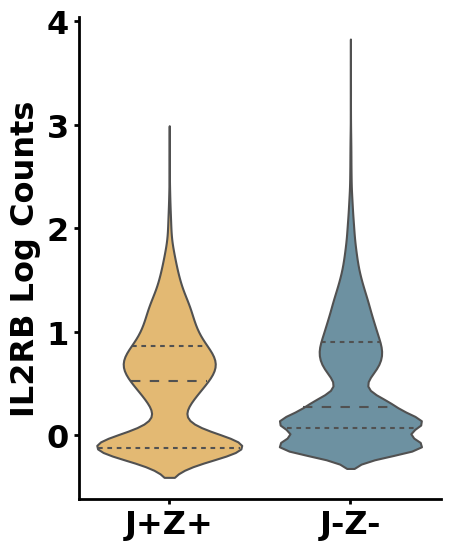

Mann-Whitney U test for IL7R with JhZh vs JlZl: U-statistic = 16173268.5, p-value = 3.784113827481082e-06


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


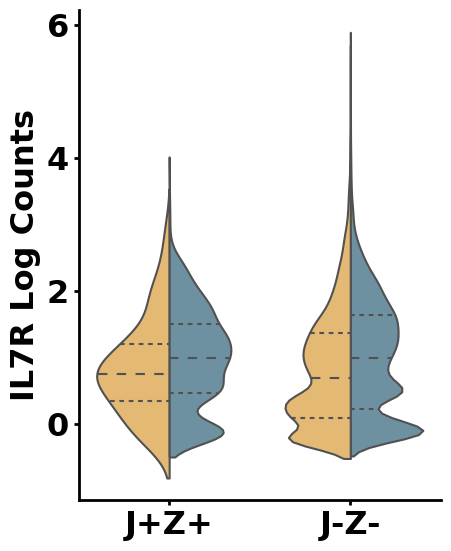

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


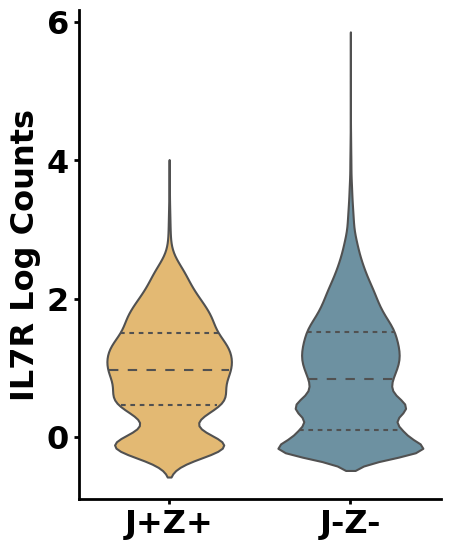

Mann-Whitney U test for CXCR3 with JhZh vs JlZl: U-statistic = 16469941.5, p-value = 2.6286183088921133e-09


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


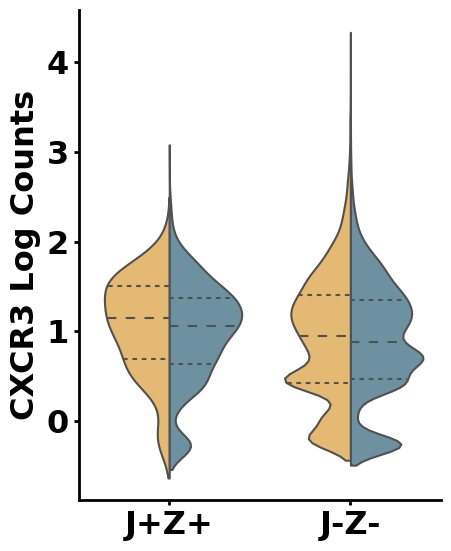

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


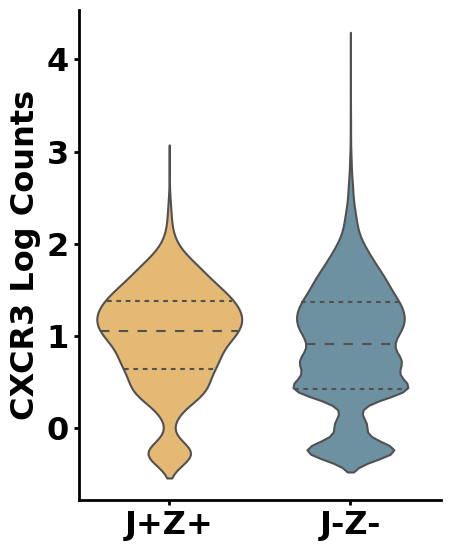

Mann-Whitney U test for CD27 with JhZh vs JlZl: U-statistic = 14579489.0, p-value = 0.011277173927557406


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


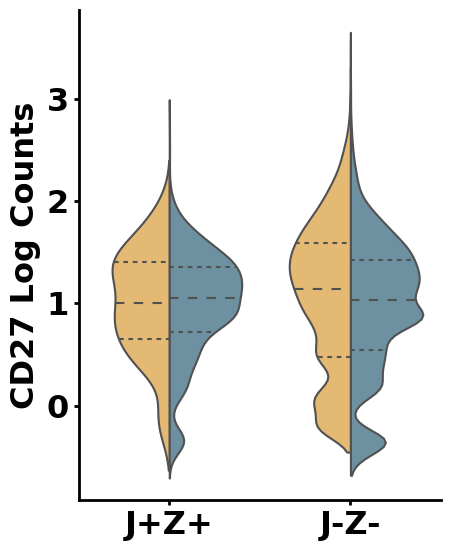

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


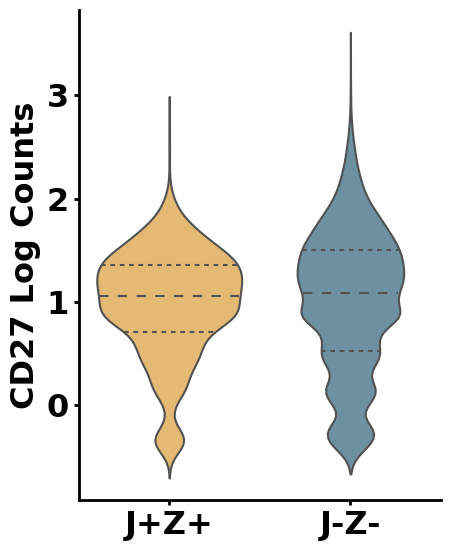

Mann-Whitney U test for CD28 with JhZh vs JlZl: U-statistic = 13985972.0, p-value = 1.9140141166312276e-07


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


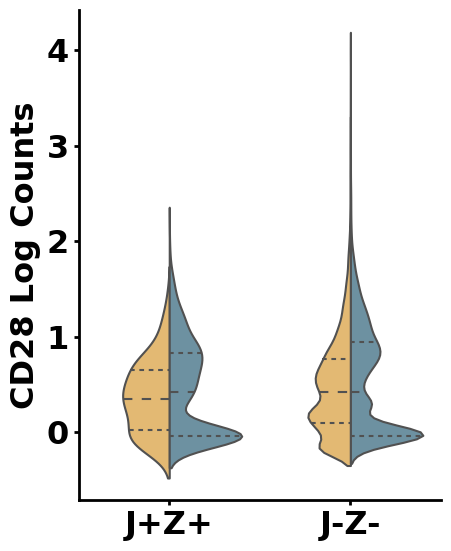

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


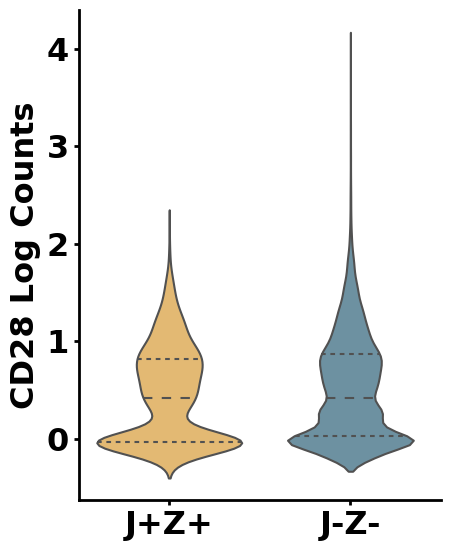

Mann-Whitney U test for ICOS with JhZh vs JlZl: U-statistic = 15615643.5, p-value = 0.03343490825741847


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


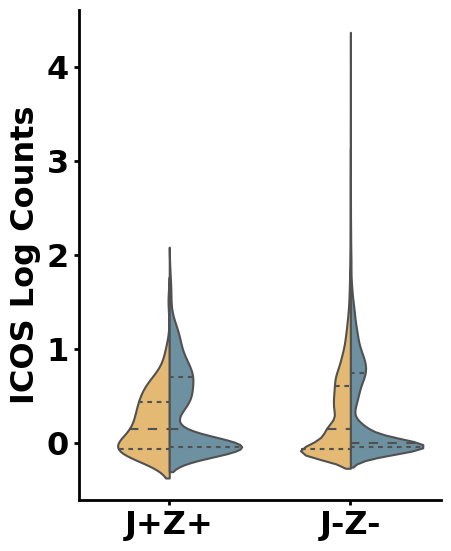

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


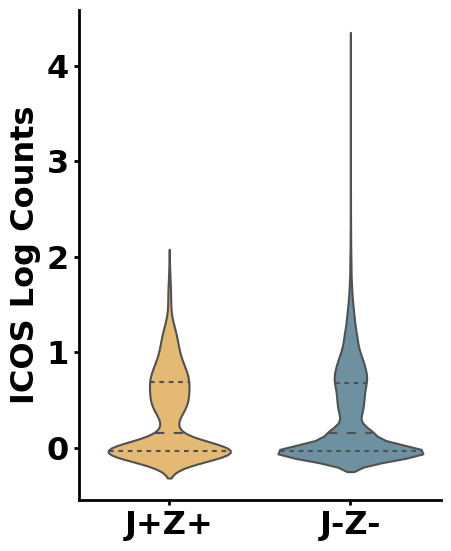

Mann-Whitney U test for CTLA4 with JhZh vs JlZl: U-statistic = 12864486.0, p-value = 1.1300482936284116e-24


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


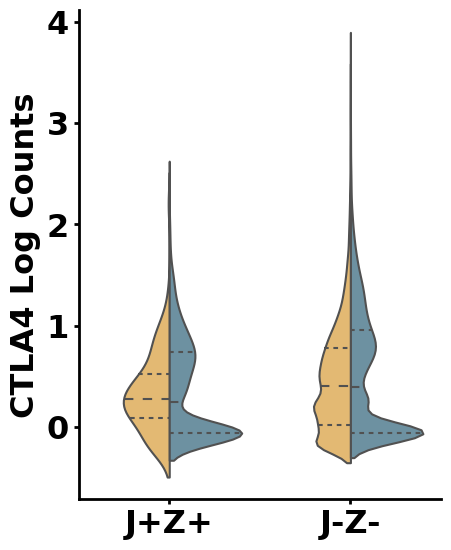

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


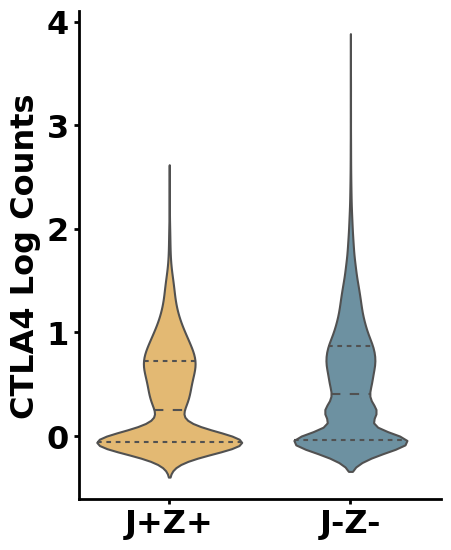

Mann-Whitney U test for LAG3 with JhZh vs JlZl: U-statistic = 14398206.5, p-value = 0.0008006880349186658


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


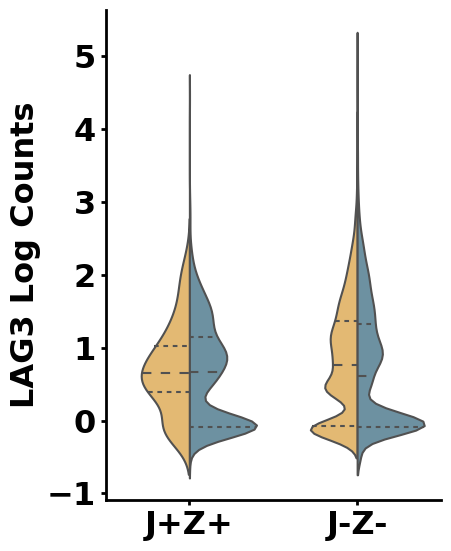

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


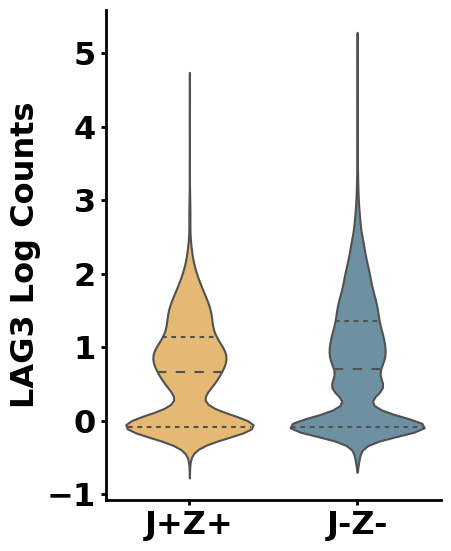

Mann-Whitney U test for PDCD1 with JhZh vs JlZl: U-statistic = 14237930.5, p-value = 4.54238757508489e-05


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


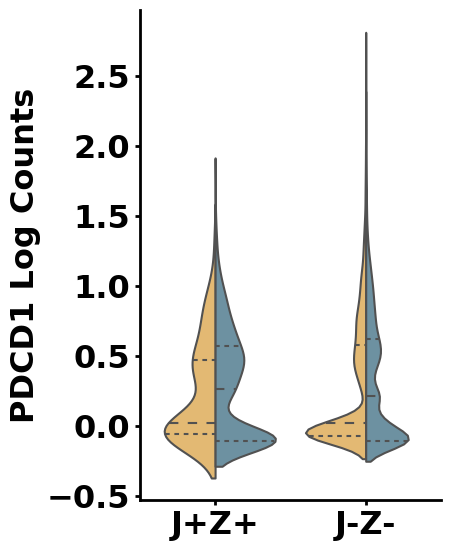

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


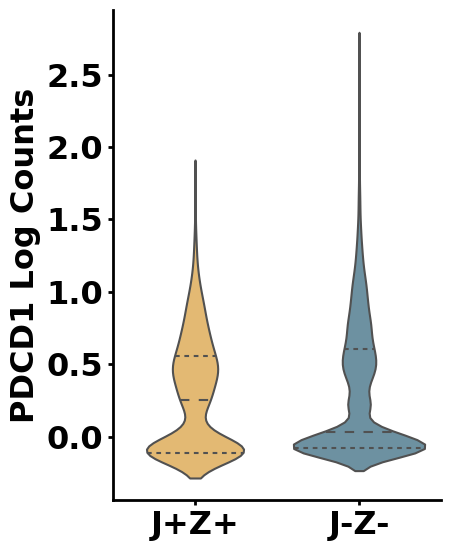

Mann-Whitney U test for HAVCR2 with JhZh vs JlZl: U-statistic = 13684307.0, p-value = 4.562890439005896e-11


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


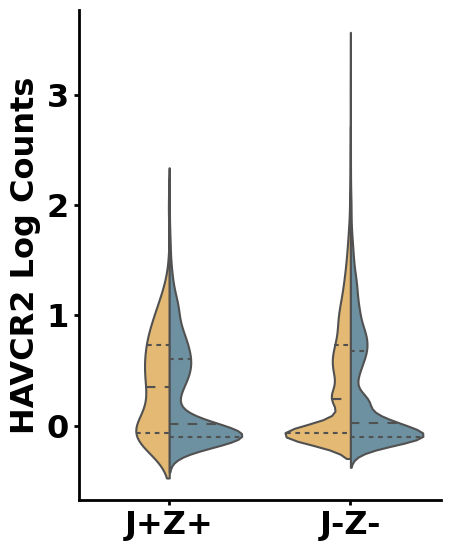

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


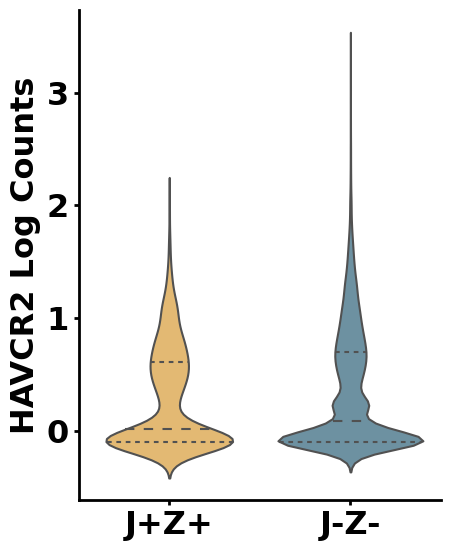

Mann-Whitney U test for TIGIT with JhZh vs JlZl: U-statistic = 13698025.0, p-value = 6.719141314418445e-11


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


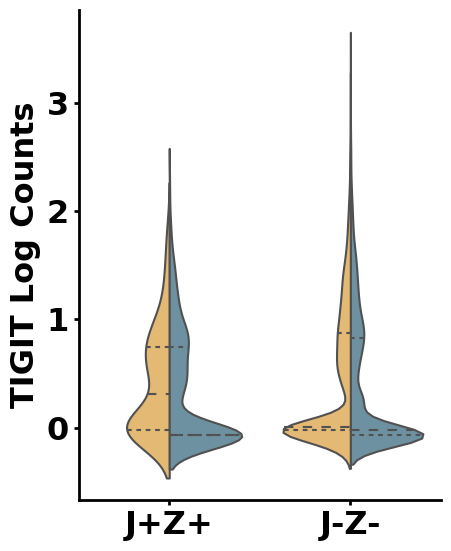

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


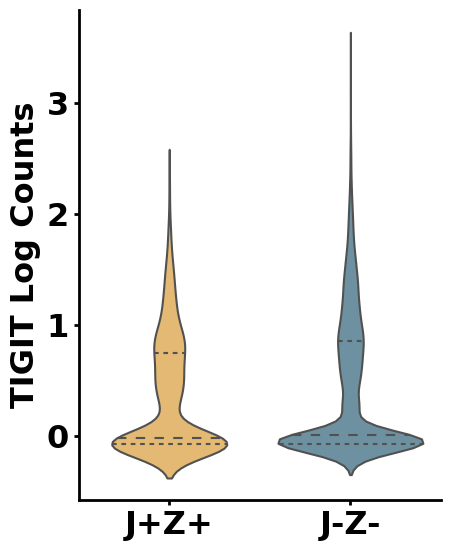

Mann-Whitney U test for IL2RA with JhZh vs JlZl: U-statistic = 13434388.0, p-value = 9.313116562610065e-15


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


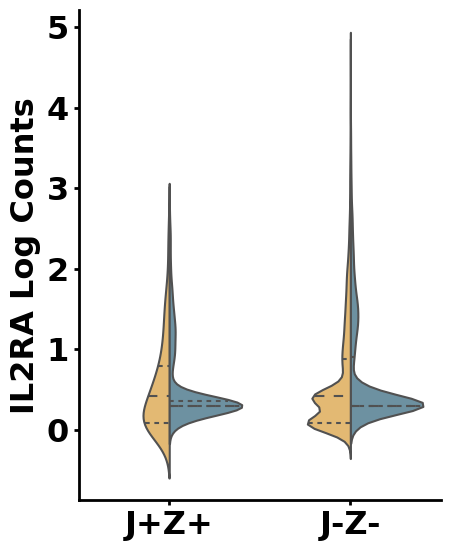

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


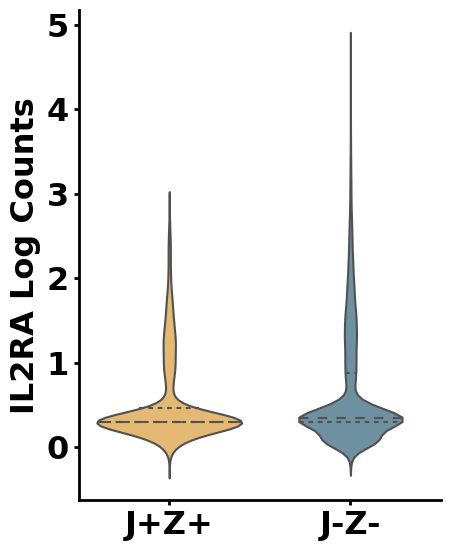

Mann-Whitney U test for CD38 with JhZh vs JlZl: U-statistic = 17351512.0, p-value = 1.0926502486920145e-23


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


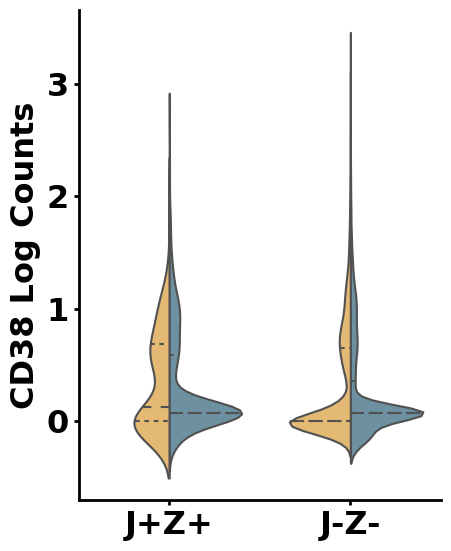

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


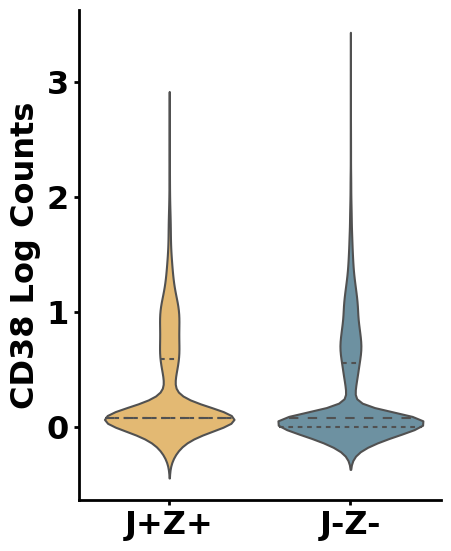

Mann-Whitney U test for MKI67 with JhZh vs JlZl: U-statistic = 16853514.5, p-value = 9.514376954076946e-15


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


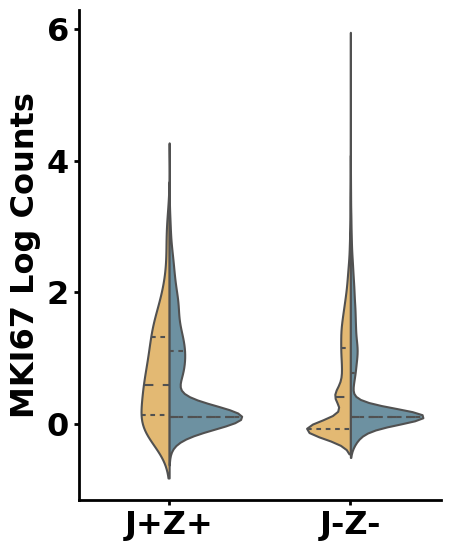

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


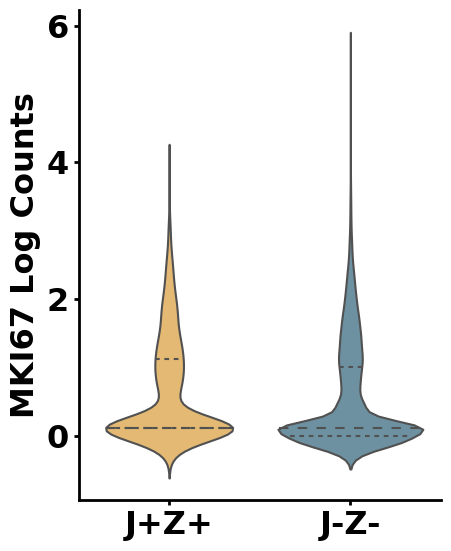

Mann-Whitney U test for PRDM1 with JhZh vs JlZl: U-statistic = 12861811.5, p-value = 6.375902427721274e-25


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


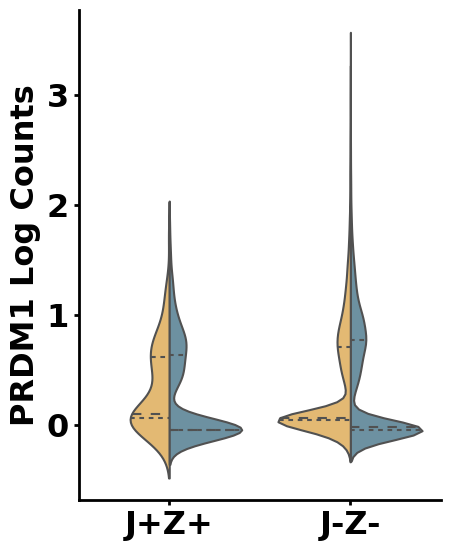

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


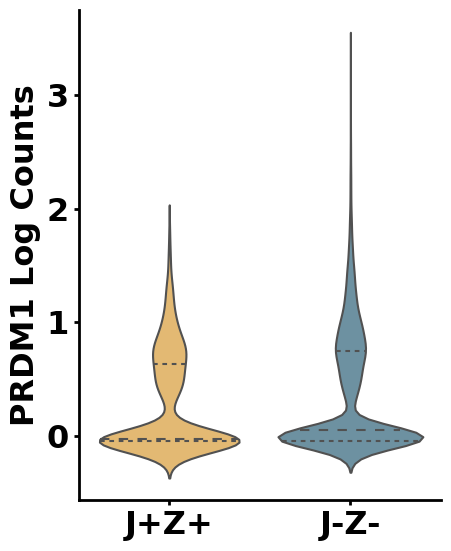

Mann-Whitney U test for TBX21 with JhZh vs JlZl: U-statistic = 15291764.5, p-value = 0.5052772385748177


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


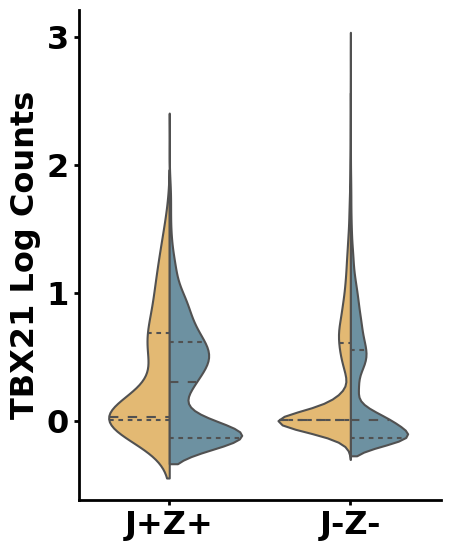

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


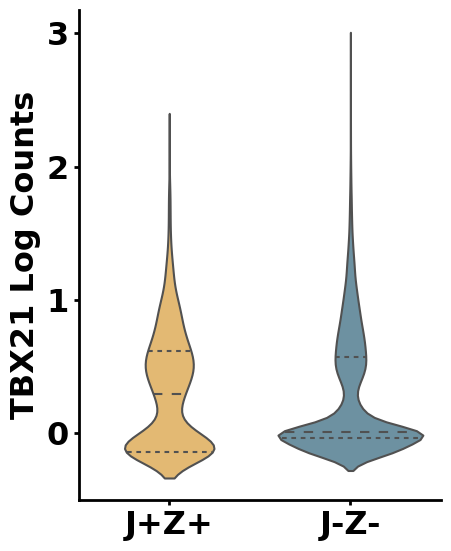

Mann-Whitney U test for B3GAT1 with JhZh vs JlZl: U-statistic = 15432240.0, p-value = 0.18408180659200868


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


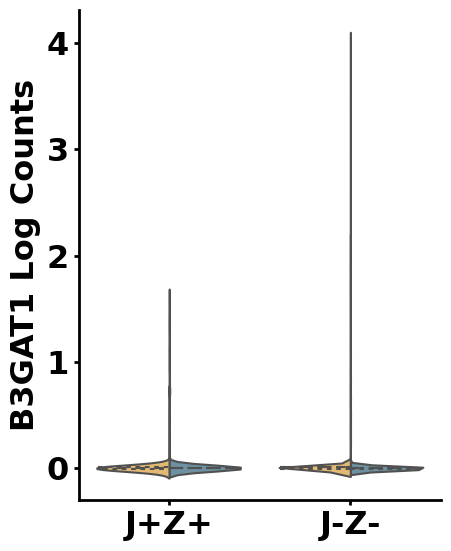

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


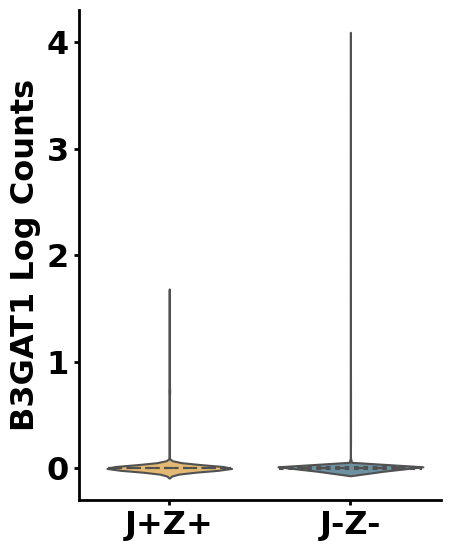

Bonferroni corrected p-value for IL2RB: 1.0
Bonferroni corrected p-value for IL7R: 6.432993506717839e-05
Bonferroni corrected p-value for CXCR3: 4.468651125116592e-08
Bonferroni corrected p-value for CD27: 0.19171195676847588
Bonferroni corrected p-value for CD28: 3.253823998273087e-06
Bonferroni corrected p-value for ICOS: 0.568393440376114
Bonferroni corrected p-value for CTLA4: 1.9210820991682998e-23
Bonferroni corrected p-value for LAG3: 0.013611696593617318
Bonferroni corrected p-value for PDCD1: 0.0007722058877644314
Bonferroni corrected p-value for HAVCR2: 7.756913746310023e-10
Bonferroni corrected p-value for TIGIT: 1.1422540234511356e-09
Bonferroni corrected p-value for IL2RA: 1.5832298156437112e-13
Bonferroni corrected p-value for CD38: 1.8575054227764246e-22
Bonferroni corrected p-value for MKI67: 1.617444082193081e-13
Bonferroni corrected p-value for PRDM1: 1.0839034127126166e-23
Bonferroni corrected p-value for TBX21: 1.0
Bonferroni corrected p-value for B3GAT1: 1.0


In [3]:
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import mannwhitneyu
from scipy.sparse import issparse

# -----------------------------------
# Step 1: Load and Preprocess Data
# -----------------------------------

# Load log-transformed dataset
adata_log = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_log_CD4 = adata_log[adata_log.obs['cell_type'] == 'CD4'].copy()
adata_log_CR_NR = adata_log_CD4[adata_log_CD4.obs['response'].isin(['CR', 'NR'])].copy()

# Load combat-corrected dataset for counts
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_combat_CD4 = adata_combat[adata_combat.obs['cell_type'] == 'CD4'].copy()
adata_combat_CR_NR = adata_combat_CD4[adata_combat_CD4.obs['response'].isin(['CR', 'NR'])].copy()

# -----------------------------------
# Step 2: Define JhZh and JlZl Populations
# -----------------------------------

# Define primary genes for population classification
primary_gene_1 = "JUND"
primary_gene_2 = "ZNF683"

# Extract expression data for primary genes from adata_log_CR_NR
JUND_log = adata_log_CR_NR[:, primary_gene_1].X.toarray().flatten() if issparse(adata_log_CR_NR.X) else adata_log_CR_NR[:, primary_gene_1].X.flatten()
ZNF689_log = adata_log_CR_NR[:, primary_gene_2].X.toarray().flatten() if issparse(adata_log_CR_NR.X) else adata_log_CR_NR[:, primary_gene_2].X.flatten()

# Define positive as expression >0
mask_JUND_positive = JUND_log > 0
mask_ZNF689_positive = ZNF689_log > 0
mask_JhZh = mask_JUND_positive & mask_ZNF689_positive

# Assign 'JhZh' or 'JlZl' based on mask to adata_combat_CR_NR
adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'] = np.where(mask_JhZh, 'J+Z+', 'J-Z-')
adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'] = adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'].astype('category')

# -----------------------------------
# Step 3: Define Gene List for Comparison
# -----------------------------------

genes = [
    "IL2RB",  # CD122 (IL2Rβ)
    "IL7R",   # CD127 (IL7Rα)
    "CXCR3",  # CD183 (CXCR3)
    "CD27",   # CD27
    "CD28",   # CD28
    "ICOS",   # CD278 (ICOS)
    "CTLA4",  # CD152 (CTLA4)
    "LAG3",   # CD223 (LAG3)
    "PDCD1",  # CD279 (PD1)
    "HAVCR2", # CD366 (TIM3)
    "TIGIT",  # TIGIT
    "IL2RA",  # CD25 (IL2Rα)
    "CD38",   # CD38 (ADPRC1)
    "MKI67",  # Ki-67
    "PRDM1",  # Blimp-1
    "TBX21",  # T-bet
    "B3GAT1"  # CD57
]

# -----------------------------------
# Step 4: Prepare Data for Comparison
# -----------------------------------
# Convert data to a DataFrame for plotting
df = adata_combat_CR_NR.to_df()
df[f'{primary_gene_1}_{primary_gene_2}_positive'] = adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'].values
df['response'] = adata_combat_CR_NR.obs['response'].values  # add response labels

# Set the order for the x-axis categories to ensure JUND+ZNF683+ appears first
category_order = ['J+Z+', 'J-Z-']

# Initialize a list to store p-values for Bonferroni correction
p_values = []
# -----------------------------------
# Step 5: Configure Plot Settings
# -----------------------------------
# Loop through each gene in the list and compare its expression between JUND+ZNF683+ and JUND-ZNF683- cells
plt.rcParams['font.weight'] = 'bold'
plt.rcParams['font.size'] = 23
plt.rcParams['axes.linewidth'] = 2
plt.rcParams['axes.labelweight'] = 'bold'
plt.rcParams['xtick.major.width'] = 2
plt.rcParams['ytick.major.width'] = 2

# -----------------------------------
# Step 6: Compare Gene Expressions and Plot
# -----------------------------------

for gene in genes:
    if gene in adata_combat_CR_NR.var_names:
        df['value'] = adata_combat_CR_NR[:, adata_combat_CR_NR.var_names == gene].X.toarray().flatten()

        # Separate values for cells expressing JUND+ZNF683+ (J+Z+) and not (J-Z-)
        group_positive = df[df[f'{primary_gene_1}_{primary_gene_2}_positive'] == 'J+Z+']['value']
        group_negative = df[df[f'{primary_gene_1}_{primary_gene_2}_positive'] == 'J-Z-']['value']

        # Perform Mann-Whitney U test to compare J+Z+ and J-Z-
        stat, p_value = mannwhitneyu(group_positive, group_negative, alternative='two-sided')
        p_values.append(p_value)
        print(f"Mann-Whitney U test for {gene} with JhZh vs JlZl: U-statistic = {stat}, p-value = {p_value}")

        # Create the violin plot using seaborn with hue for response
        plt.figure(figsize=(5, 6))
        sns.violinplot(
            data=df,
            x=f'{primary_gene_1}_{primary_gene_2}_positive',
            y='value',
            hue='response',
            split=True,
            inner="quart",
            palette=["#F6BD60", '#6494AA'],
            order=category_order
        )
        sns.despine()  # Remove the top and right spines

        # Remove the legend and customize the plot
        plt.legend([], [], frameon=False)
        plt.title('')
        plt.xlabel('')
        plt.ylabel(f'{gene} Log Counts')
        plt.tight_layout()

        # Display the plot
        plt.show()

        # Create another violin plot without hue for a cleaner view
        plt.figure(figsize=(5, 6))
        sns.violinplot(
            data=df,
            x=f'{primary_gene_1}_{primary_gene_2}_positive',
            y='value',
            inner="quart",
            palette=["#F6BD60", '#6494AA'],
            order=category_order
        )
        sns.despine()  # Remove the top and right spines

        # Remove the legend
        plt.legend([], [], frameon=False)
        # Customize the plot
        plt.title('')
        plt.xlabel('')
        plt.ylabel(f'{gene} Log Counts')
        plt.tight_layout()

        # Save or display the plot
        # Uncomment the next line to save the plot
        # plt.savefig(f'/home/emma/result/CART/violinplot_JUND/{primary_gene_1}_{gene}_violinplot.png')
        plt.show()
    else:
        print(f"{gene} is not present in the variable names. Please check your adata object.")

# -----------------------------------
# Step 7: Apply Bonferroni Correction
# -----------------------------------

# Apply Bonferroni correction to p-values
bonferroni_corrected_p_values = np.minimum(np.array(p_values) * len(genes), 1.0)

# Print corrected p-values
for gene, corrected_p_value in zip(genes, bonferroni_corrected_p_values):
    print(f"Bonferroni corrected p-value for {gene}: {corrected_p_value}")


Mann-Whitney U test for IL2RB with JhZh vs JlZl: U-statistic = 14966615.0, p-value = 0.4247139932547557


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


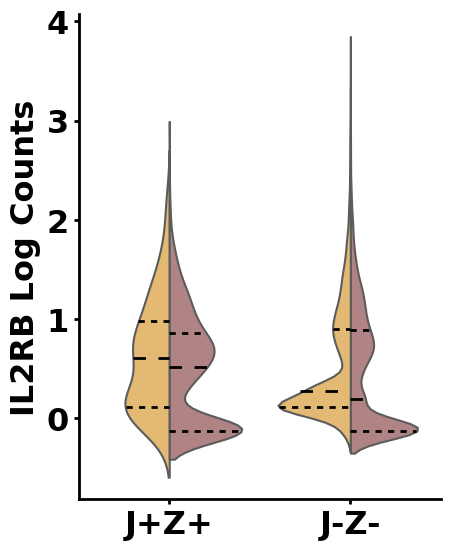

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


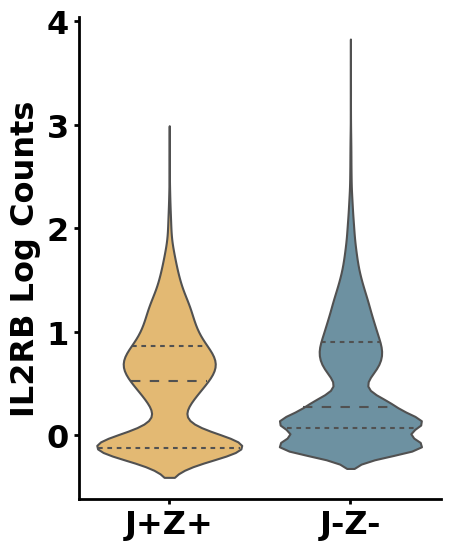

Mann-Whitney U test for IL7R with JhZh vs JlZl: U-statistic = 16173268.5, p-value = 3.784113827481082e-06


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


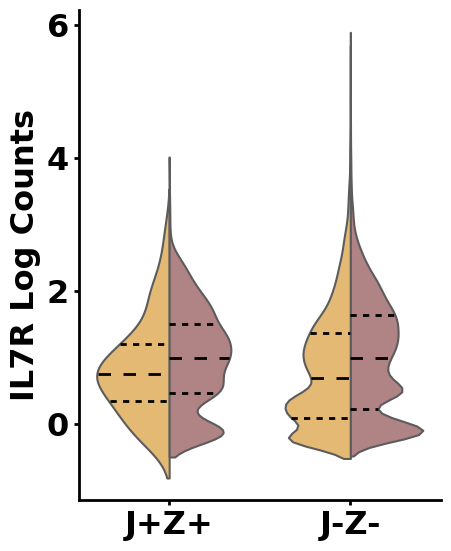

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


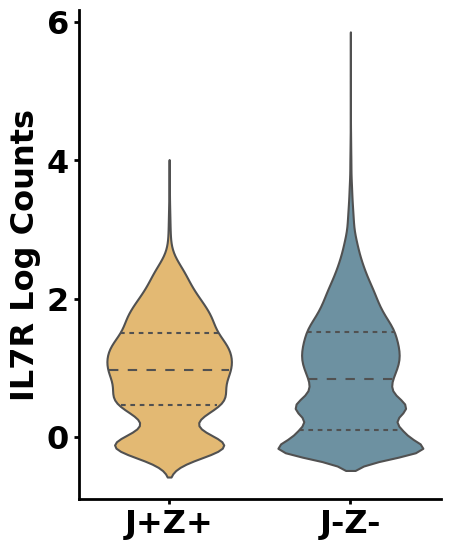

Mann-Whitney U test for CXCR3 with JhZh vs JlZl: U-statistic = 16469941.5, p-value = 2.6286183088921133e-09


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


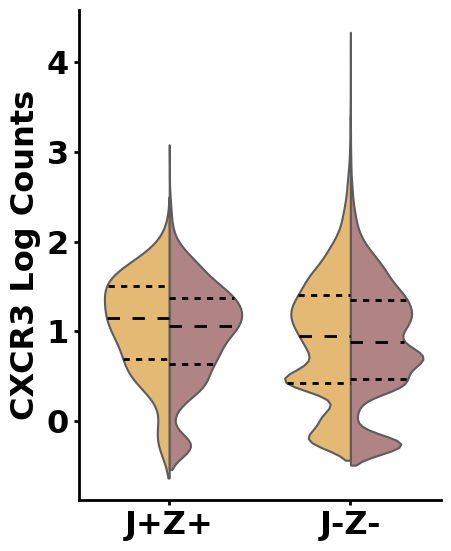

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


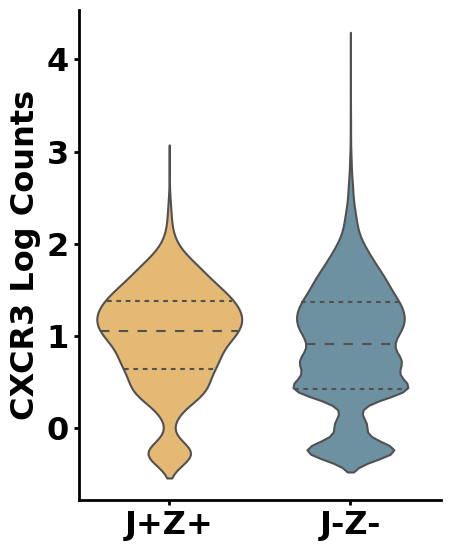

Mann-Whitney U test for CD27 with JhZh vs JlZl: U-statistic = 14579489.0, p-value = 0.011277173927557406


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


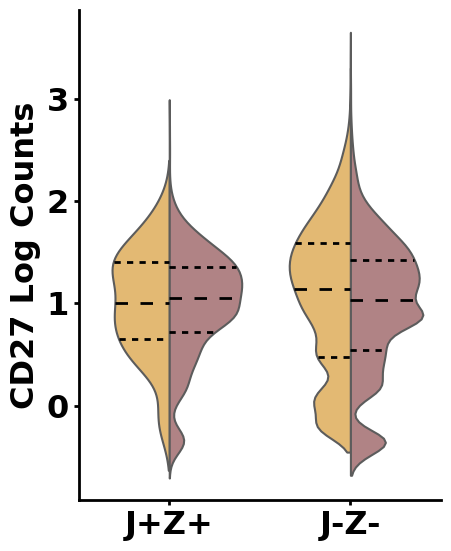

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


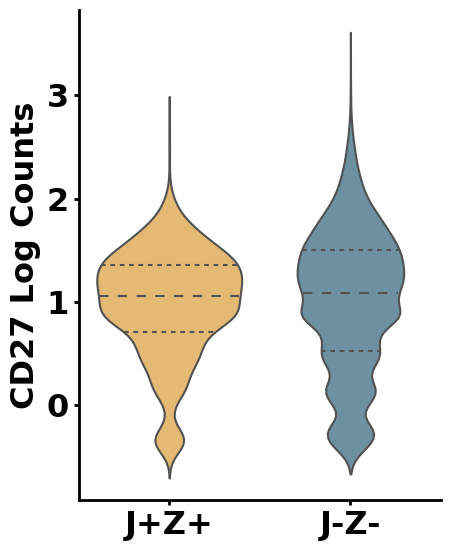

Mann-Whitney U test for CD28 with JhZh vs JlZl: U-statistic = 13985972.0, p-value = 1.9140141166312276e-07


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


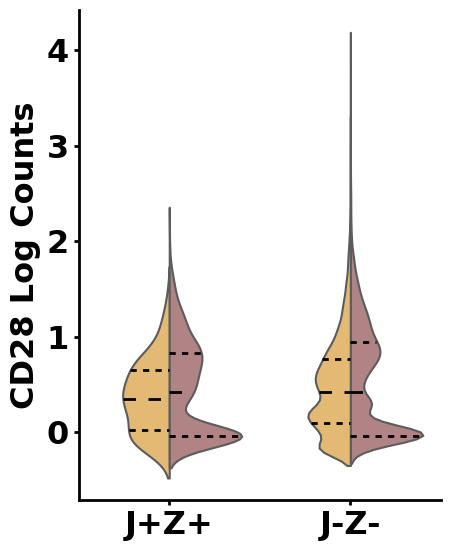

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


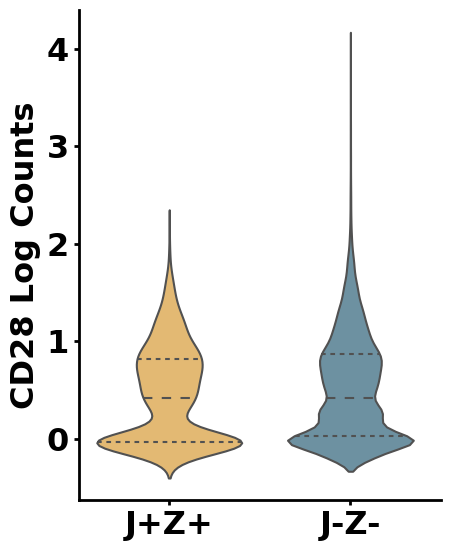

Mann-Whitney U test for ICOS with JhZh vs JlZl: U-statistic = 15615643.5, p-value = 0.03343490825741847


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


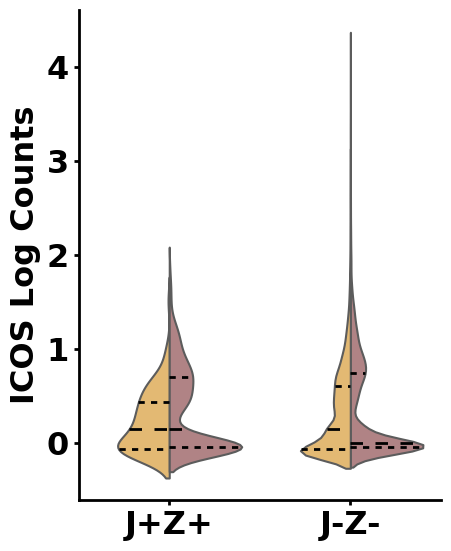

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


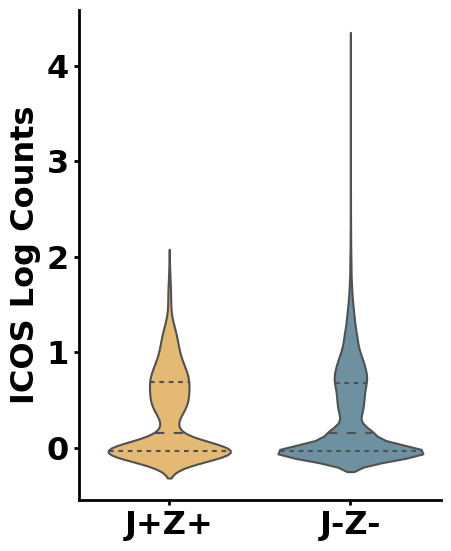

Mann-Whitney U test for CTLA4 with JhZh vs JlZl: U-statistic = 12864486.0, p-value = 1.1300482936284116e-24


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


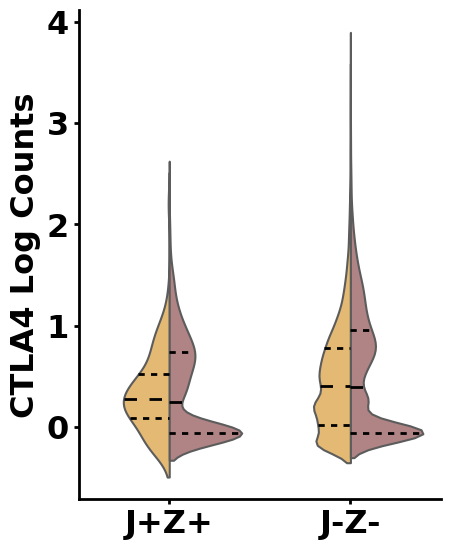

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


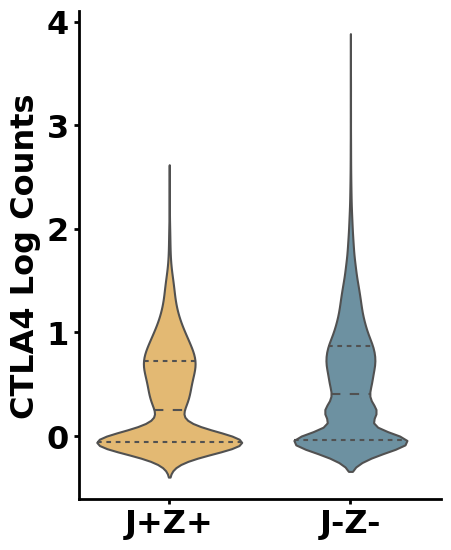

Mann-Whitney U test for LAG3 with JhZh vs JlZl: U-statistic = 14398206.5, p-value = 0.0008006880349186658


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


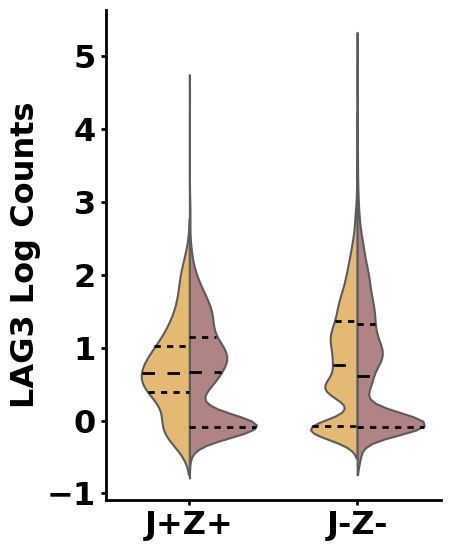

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


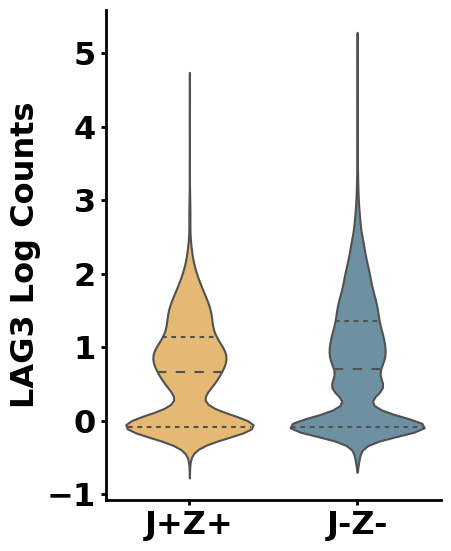

Mann-Whitney U test for PDCD1 with JhZh vs JlZl: U-statistic = 14237930.5, p-value = 4.54238757508489e-05


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


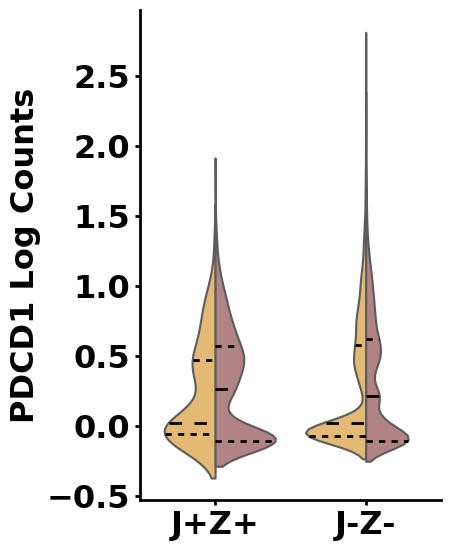

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


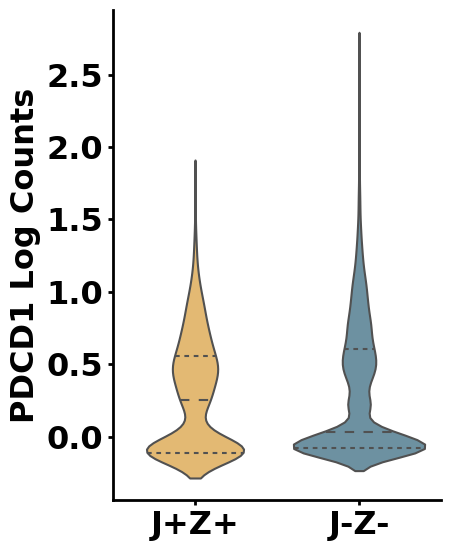

Mann-Whitney U test for HAVCR2 with JhZh vs JlZl: U-statistic = 13684307.0, p-value = 4.562890439005896e-11


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


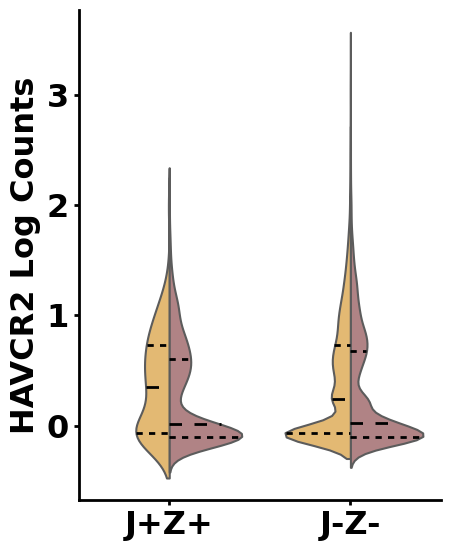

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


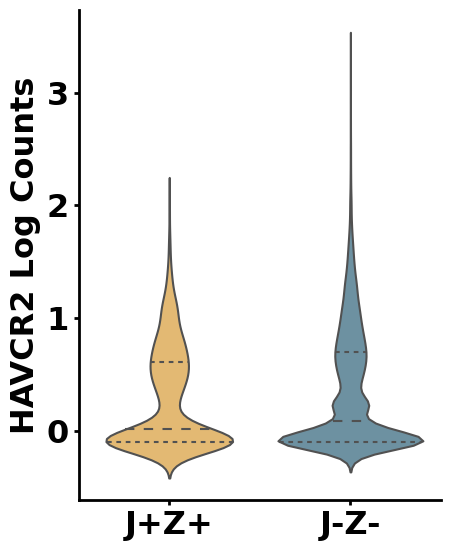

Mann-Whitney U test for TIGIT with JhZh vs JlZl: U-statistic = 13698025.0, p-value = 6.719141314418445e-11


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


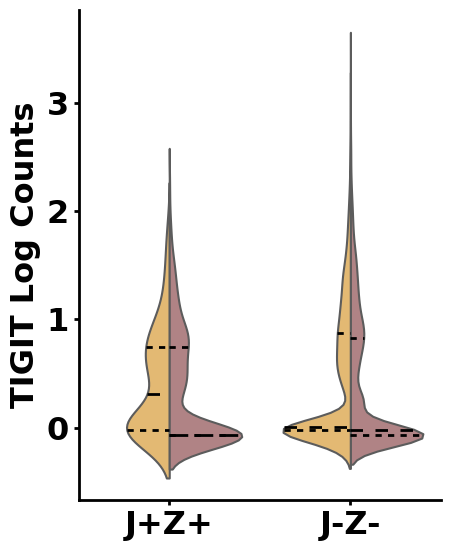

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


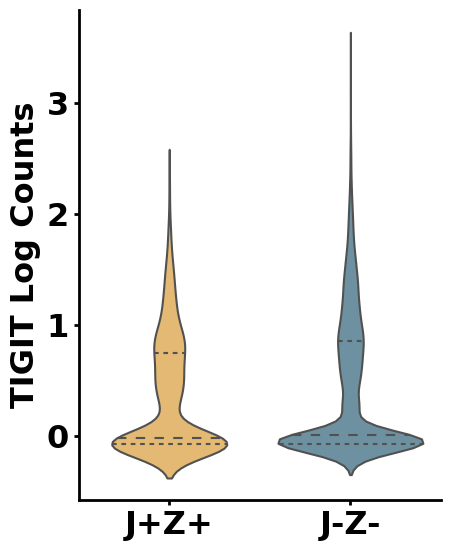

Mann-Whitney U test for IL2RA with JhZh vs JlZl: U-statistic = 13434388.0, p-value = 9.313116562610065e-15


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


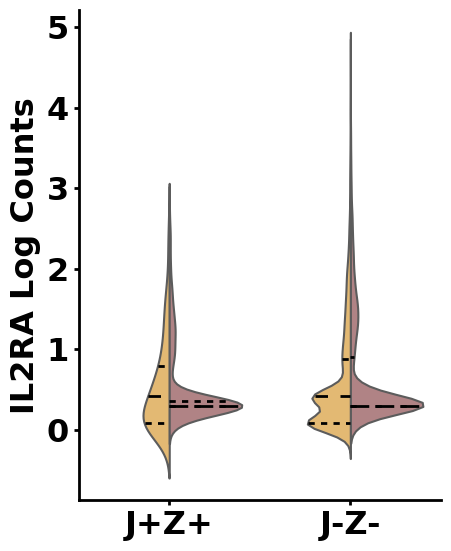

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


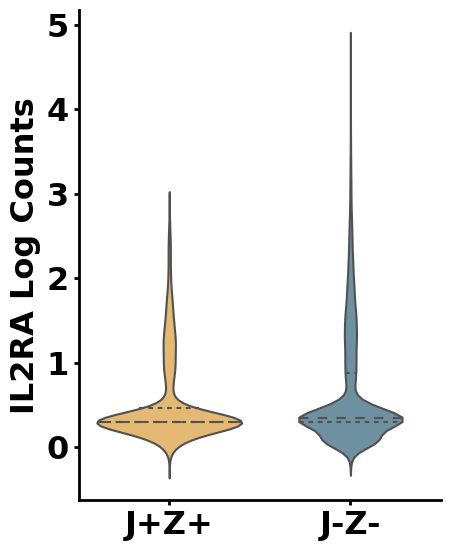

Mann-Whitney U test for CD38 with JhZh vs JlZl: U-statistic = 17351512.0, p-value = 1.0926502486920145e-23


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


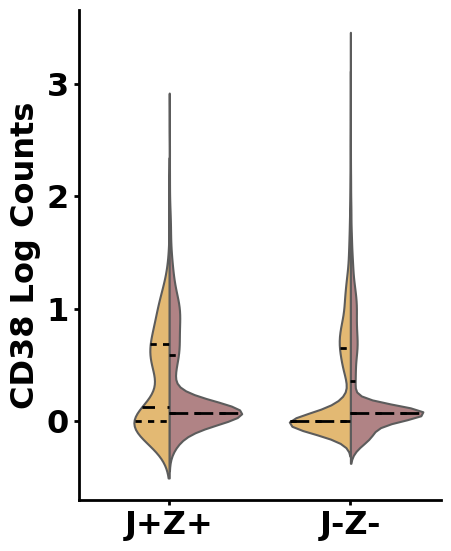

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


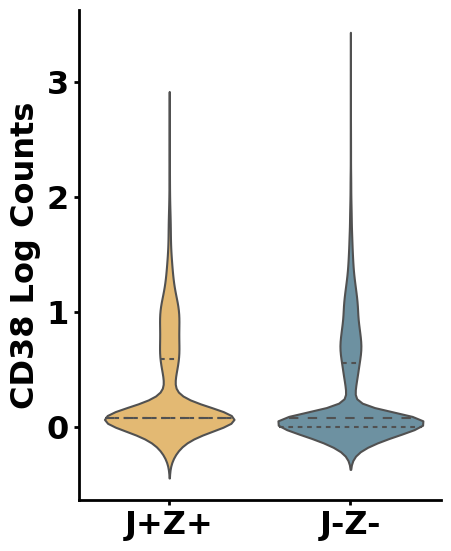

Mann-Whitney U test for MKI67 with JhZh vs JlZl: U-statistic = 16853514.5, p-value = 9.514376954076946e-15


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


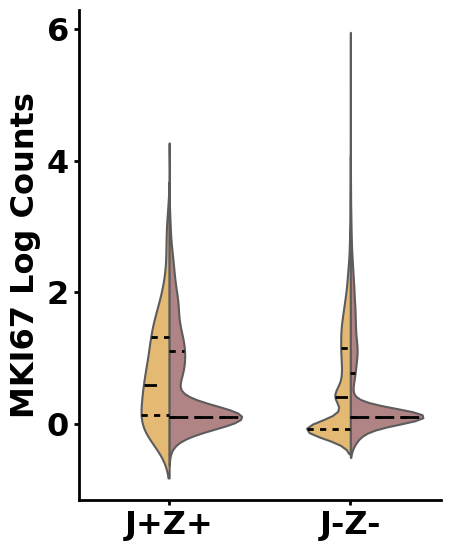

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


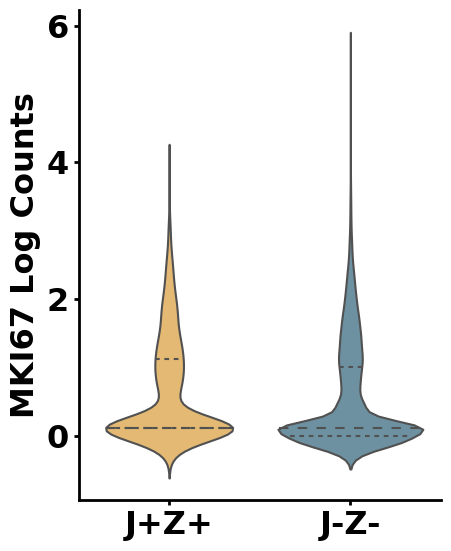

Mann-Whitney U test for PRDM1 with JhZh vs JlZl: U-statistic = 12861811.5, p-value = 6.375902427721274e-25


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


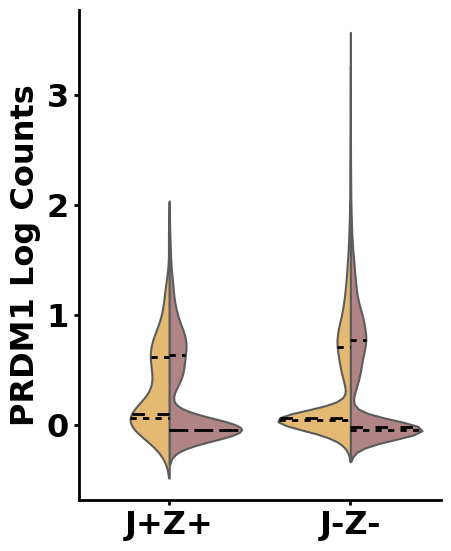

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


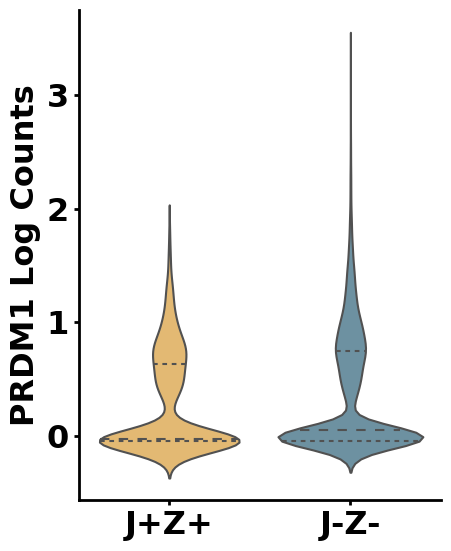

Mann-Whitney U test for TBX21 with JhZh vs JlZl: U-statistic = 15291764.5, p-value = 0.5052772385748177


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


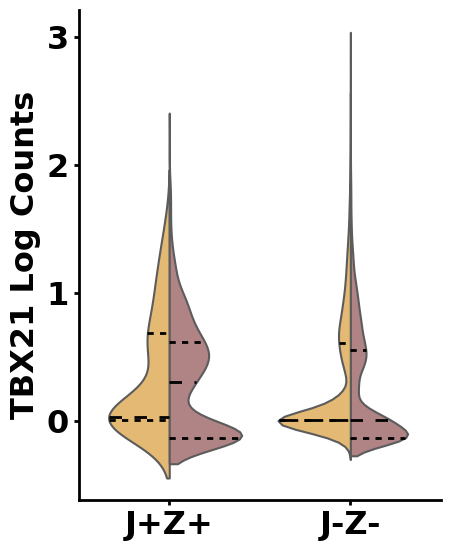

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


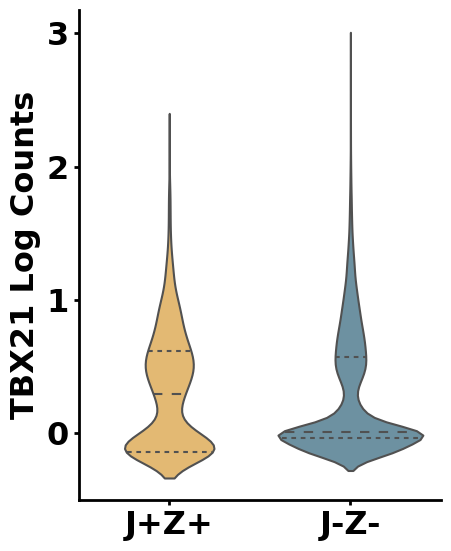

Mann-Whitney U test for B3GAT1 with JhZh vs JlZl: U-statistic = 15432240.0, p-value = 0.18408180659200868


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


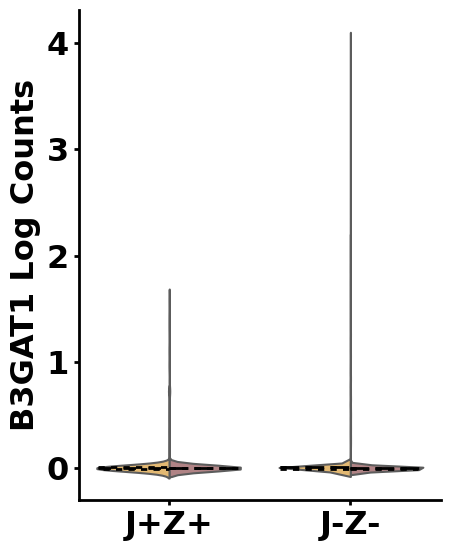

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


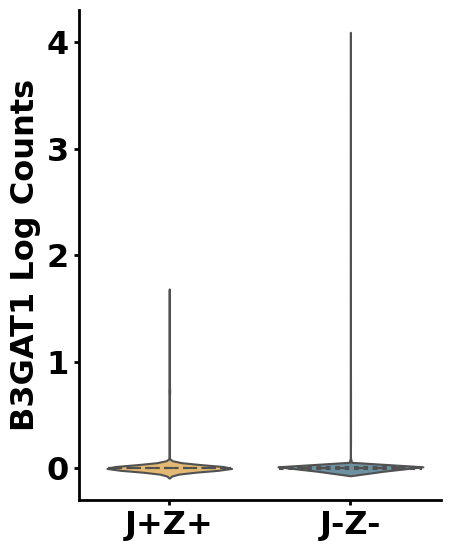

Bonferroni corrected p-value for IL2RB: 1.0
Bonferroni corrected p-value for IL7R: 6.432993506717839e-05
Bonferroni corrected p-value for CXCR3: 4.468651125116592e-08
Bonferroni corrected p-value for CD27: 0.19171195676847588
Bonferroni corrected p-value for CD28: 3.253823998273087e-06
Bonferroni corrected p-value for ICOS: 0.568393440376114
Bonferroni corrected p-value for CTLA4: 1.9210820991682998e-23
Bonferroni corrected p-value for LAG3: 0.013611696593617318
Bonferroni corrected p-value for PDCD1: 0.0007722058877644314
Bonferroni corrected p-value for HAVCR2: 7.756913746310023e-10
Bonferroni corrected p-value for TIGIT: 1.1422540234511356e-09
Bonferroni corrected p-value for IL2RA: 1.5832298156437112e-13
Bonferroni corrected p-value for CD38: 1.8575054227764246e-22
Bonferroni corrected p-value for MKI67: 1.617444082193081e-13
Bonferroni corrected p-value for PRDM1: 1.0839034127126166e-23
Bonferroni corrected p-value for TBX21: 1.0
Bonferroni corrected p-value for B3GAT1: 1.0


In [2]:
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import mannwhitneyu
from scipy.sparse import issparse

# -----------------------------------
# Step 1: Load and Preprocess Data
# -----------------------------------

# Load log-transformed dataset
adata_log = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_log_CD4 = adata_log[adata_log.obs['cell_type'] == 'CD4'].copy()
adata_log_CR_NR = adata_log_CD4[adata_log_CD4.obs['response'].isin(['CR', 'NR'])].copy()

# Load combat-corrected dataset for counts
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_combat_CD4 = adata_combat[adata_combat.obs['cell_type'] == 'CD4'].copy()
adata_combat_CR_NR = adata_combat_CD4[adata_combat_CD4.obs['response'].isin(['CR', 'NR'])].copy()

# -----------------------------------
# Step 2: Define JhZh and JlZl Populations
# -----------------------------------

# Define primary genes for population classification
primary_gene_1 = "JUND"
primary_gene_2 = "ZNF683"

# Extract expression data for primary genes from adata_log_CR_NR
JUND_log = adata_log_CR_NR[:, primary_gene_1].X.toarray().flatten() if issparse(adata_log_CR_NR.X) else adata_log_CR_NR[:, primary_gene_1].X.flatten()
ZNF689_log = adata_log_CR_NR[:, primary_gene_2].X.toarray().flatten() if issparse(adata_log_CR_NR.X) else adata_log_CR_NR[:, primary_gene_2].X.flatten()

# Define positive as expression >0
mask_JUND_positive = JUND_log > 0
mask_ZNF689_positive = ZNF689_log > 0
mask_JhZh = mask_JUND_positive & mask_ZNF689_positive

# Assign 'JhZh' or 'JlZl' based on mask to adata_combat_CR_NR
adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'] = np.where(mask_JhZh, 'J+Z+', 'J-Z-')
adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'] = adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'].astype('category')

# -----------------------------------
# Step 3: Define Gene List for Comparison
# -----------------------------------

genes = [
    "IL2RB",  # CD122 (IL2Rβ)
    "IL7R",   # CD127 (IL7Rα)
    "CXCR3",  # CD183 (CXCR3)
    "CD27",   # CD27
    "CD28",   # CD28
    "ICOS",   # CD278 (ICOS)
    "CTLA4",  # CD152 (CTLA4)
    "LAG3",   # CD223 (LAG3)
    "PDCD1",  # CD279 (PD1)
    "HAVCR2", # CD366 (TIM3)
    "TIGIT",  # TIGIT
    "IL2RA",  # CD25 (IL2Rα)
    "CD38",   # CD38 (ADPRC1)
    "MKI67",  # Ki-67
    "PRDM1",  # Blimp-1
    "TBX21",  # T-bet
    "B3GAT1"  # CD57
]

# -----------------------------------
# Step 4: Prepare Data for Comparison
# -----------------------------------
# Convert data to a DataFrame for plotting
df = adata_combat_CR_NR.to_df()
df[f'{primary_gene_1}_{primary_gene_2}_positive'] = adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'].values
df['response'] = adata_combat_CR_NR.obs['response'].values  # add response labels

# Set the order for the x-axis categories to ensure JUND+ZNF683+ appears first
category_order = ['J+Z+', 'J-Z-']

# Initialize a list to store p-values for Bonferroni correction
p_values = []
# -----------------------------------
# Step 5: Configure Plot Settings
# -----------------------------------
# Loop through each gene in the list and compare its expression between JUND+ZNF683+ and JUND-ZNF683- cells
plt.rcParams['font.weight'] = 'bold'
plt.rcParams['font.size'] = 23
plt.rcParams['axes.linewidth'] = 2
plt.rcParams['axes.labelweight'] = 'bold'
plt.rcParams['xtick.major.width'] = 2
plt.rcParams['ytick.major.width'] = 2

# -----------------------------------
# Step 6: Compare Gene Expressions and Plot
# -----------------------------------

for gene in genes:
    if gene in adata_combat_CR_NR.var_names:
        df['value'] = adata_combat_CR_NR[:, adata_combat_CR_NR.var_names == gene].X.toarray().flatten()

        # Separate values for cells expressing JUND+ZNF683+ (J+Z+) and not (J-Z-)
        group_positive = df[df[f'{primary_gene_1}_{primary_gene_2}_positive'] == 'J+Z+']['value']
        group_negative = df[df[f'{primary_gene_1}_{primary_gene_2}_positive'] == 'J-Z-']['value']

        # Perform Mann-Whitney U test to compare J+Z+ and J-Z-
        stat, p_value = mannwhitneyu(group_positive, group_negative, alternative='two-sided')
        p_values.append(p_value)
        print(f"Mann-Whitney U test for {gene} with JhZh vs JlZl: U-statistic = {stat}, p-value = {p_value}")

        # Create the violin plot using seaborn with hue for response
        plt.figure(figsize=(5, 6))
        ax = sns.violinplot(
            data=df,
            x=f'{primary_gene_1}_{primary_gene_2}_positive',
            y='value',
            hue='response',
            split=True,
            inner="quart",
            palette=["#F6BD60", "#B77B7E"],
            order=category_order
        )
        sns.despine()  # Remove the top and right spines

        for line in ax.lines:
            line.set_linewidth(2)
            line.set_color('black')

        # Remove the legend and customize the plot
        plt.legend([], [], frameon=False)
        plt.title('')
        plt.xlabel('')
        plt.ylabel(f'{gene} Log Counts')
        plt.tight_layout()

        # Display the plot
        plt.show()

        # Create another violin plot without hue for a cleaner view
        plt.figure(figsize=(5, 6))
        sns.violinplot(
            data=df,
            x=f'{primary_gene_1}_{primary_gene_2}_positive',
            y='value',
            inner="quart",
            palette=["#F6BD60", '#6494AA'],
            order=category_order
        )
        sns.despine()  # Remove the top and right spines

        # Remove the legend
        plt.legend([], [], frameon=False)
        # Customize the plot
        plt.title('')
        plt.xlabel('')
        plt.ylabel(f'{gene} Log Counts')
        plt.tight_layout()

        # Save or display the plot
        # Uncomment the next line to save the plot
        # plt.savefig(f'/home/emma/result/CART/violinplot_JUND/{primary_gene_1}_{gene}_violinplot.png')
        plt.show()
    else:
        print(f"{gene} is not present in the variable names. Please check your adata object.")

# -----------------------------------
# Step 7: Apply Bonferroni Correction
# -----------------------------------

# Apply Bonferroni correction to p-values
bonferroni_corrected_p_values = np.minimum(np.array(p_values) * len(genes), 1.0)

# Print corrected p-values
for gene, corrected_p_value in zip(genes, bonferroni_corrected_p_values):
    print(f"Bonferroni corrected p-value for {gene}: {corrected_p_value}")


Mann-Whitney U test for IL2RB with F+Z+ vs F-Z-: U-statistic = 5835326.0, p-value = 0.00012360948540380605


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


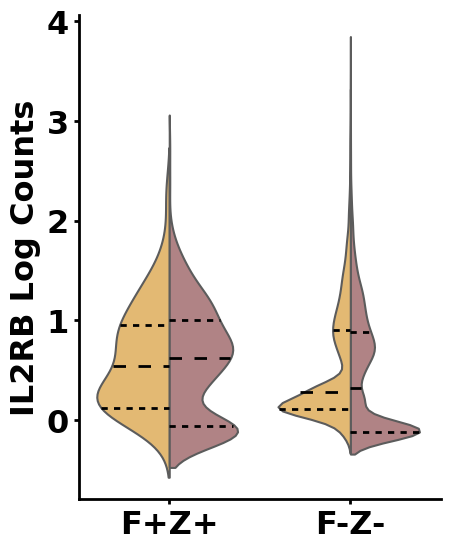

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


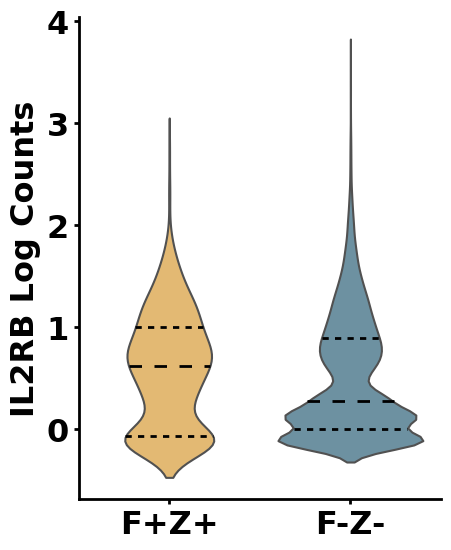

Mann-Whitney U test for IL7R with F+Z+ vs F-Z-: U-statistic = 5216948.5, p-value = 0.3943390324259364


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


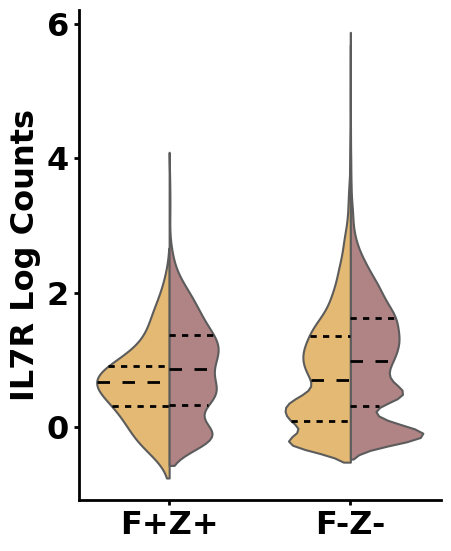

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


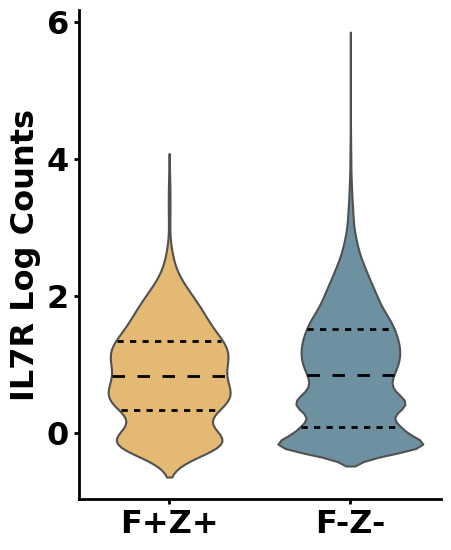

Mann-Whitney U test for CXCR3 with F+Z+ vs F-Z-: U-statistic = 5808511.0, p-value = 0.0002883761377063742


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


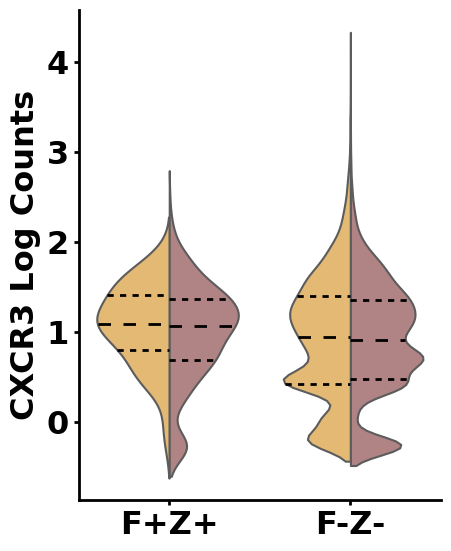

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


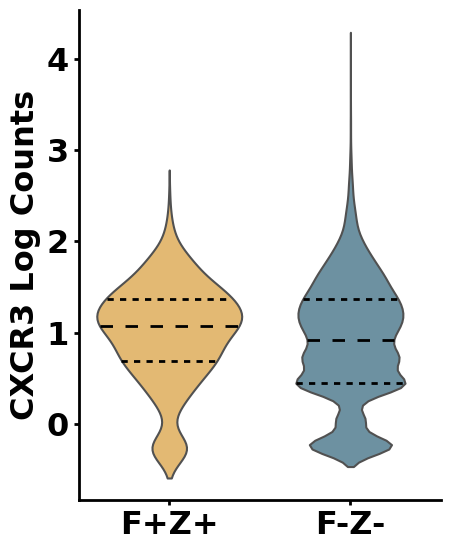

Mann-Whitney U test for CD27 with F+Z+ vs F-Z-: U-statistic = 5121155.5, p-value = 0.11494538083311699


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


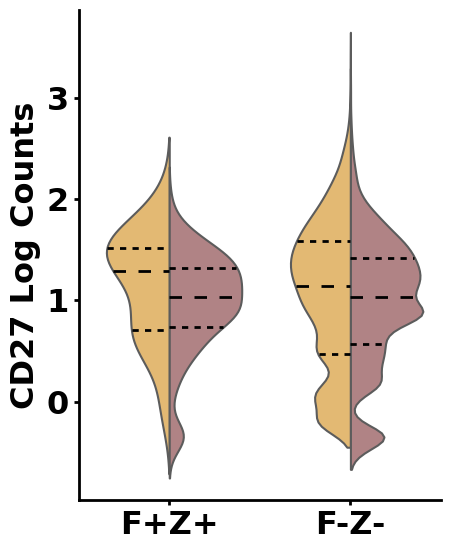

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


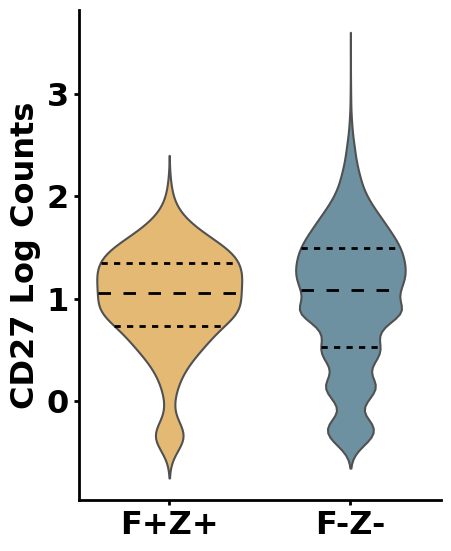

Mann-Whitney U test for CD28 with F+Z+ vs F-Z-: U-statistic = 4497416.0, p-value = 2.835921027068069e-10


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


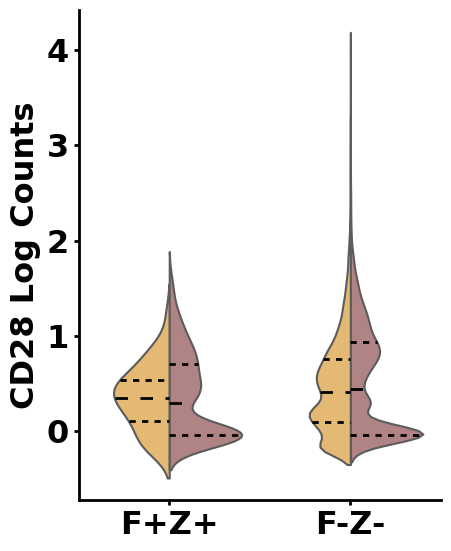

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


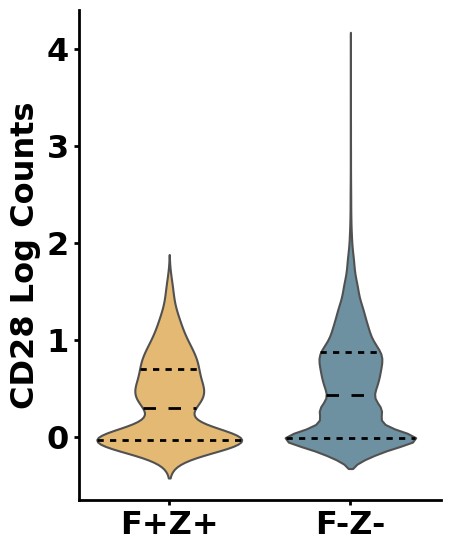

Mann-Whitney U test for ICOS with F+Z+ vs F-Z-: U-statistic = 5432030.5, p-value = 0.4356316412579362


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


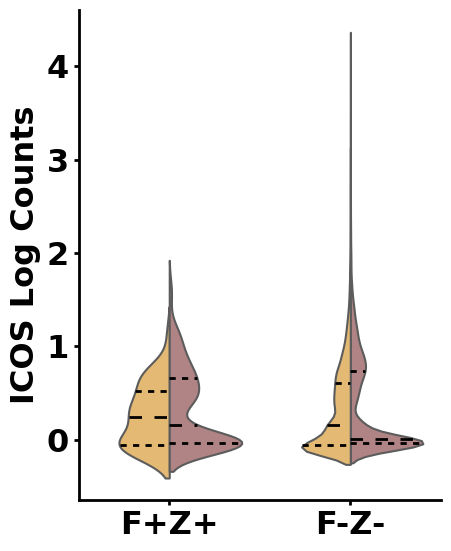

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


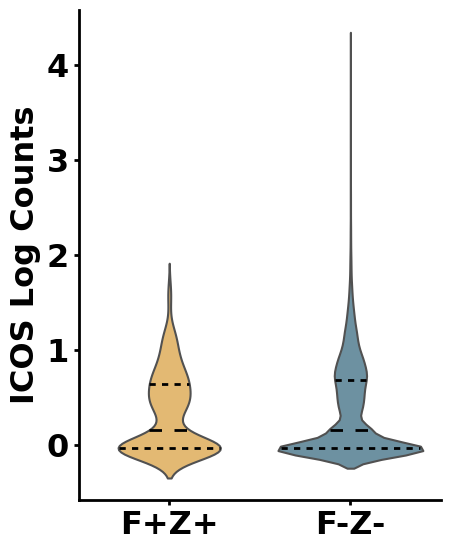

Mann-Whitney U test for CTLA4 with F+Z+ vs F-Z-: U-statistic = 4581154.0, p-value = 1.3898151140071557e-08


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


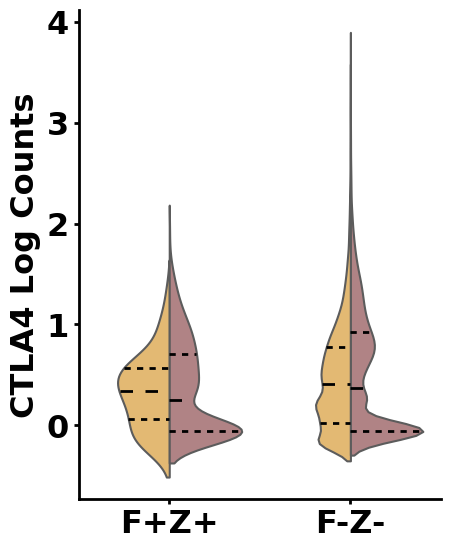

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


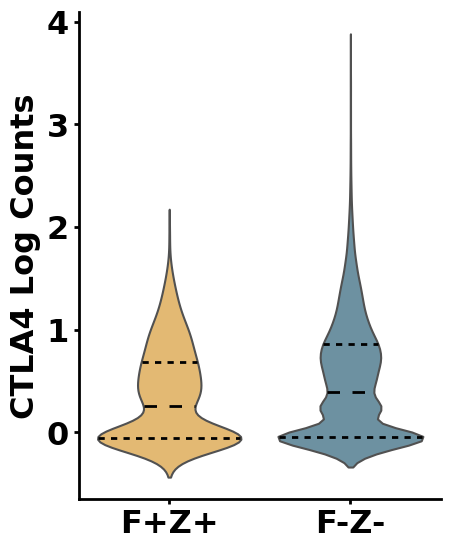

Mann-Whitney U test for LAG3 with F+Z+ vs F-Z-: U-statistic = 5480846.0, p-value = 0.25127386487592285


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


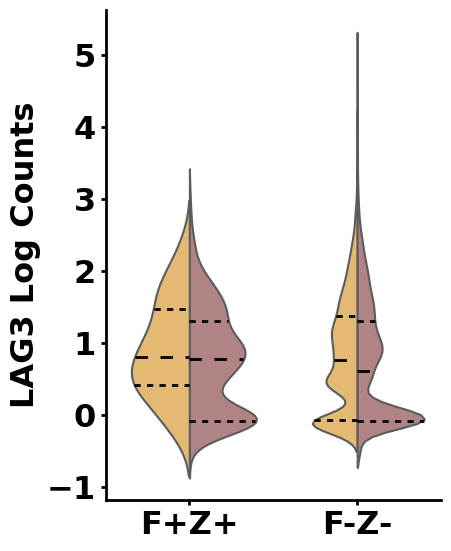

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


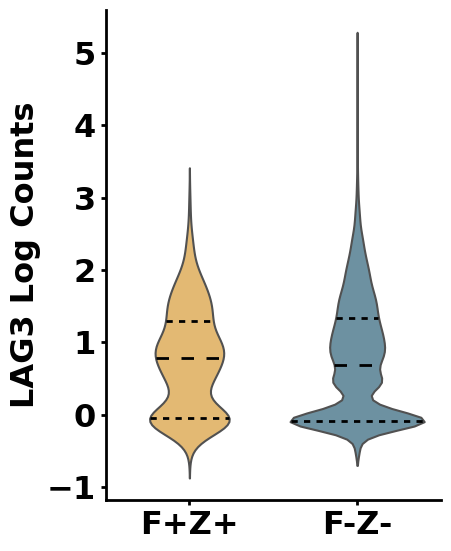

Mann-Whitney U test for PDCD1 with F+Z+ vs F-Z-: U-statistic = 5068251.0, p-value = 0.047492212641975236


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


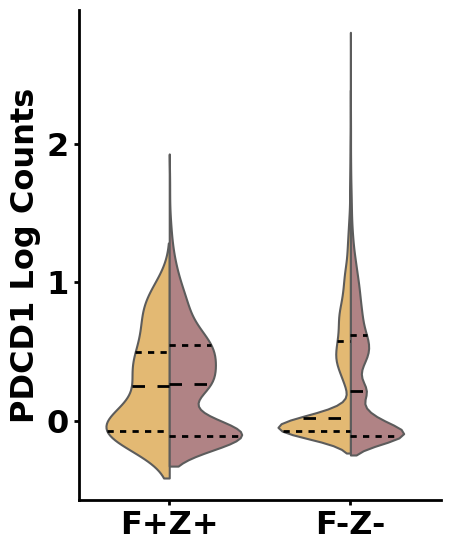

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


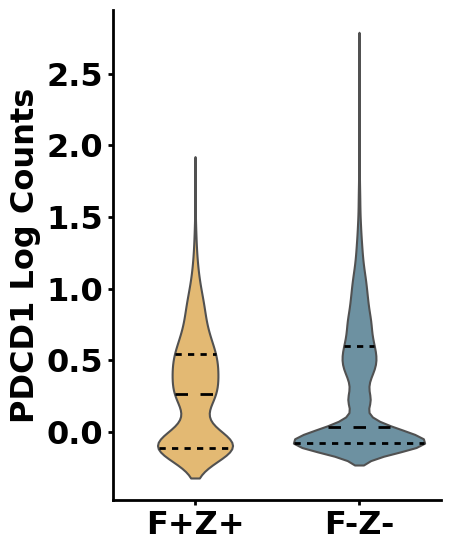

Mann-Whitney U test for HAVCR2 with F+Z+ vs F-Z-: U-statistic = 5355043.5, p-value = 0.8457400322182171


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


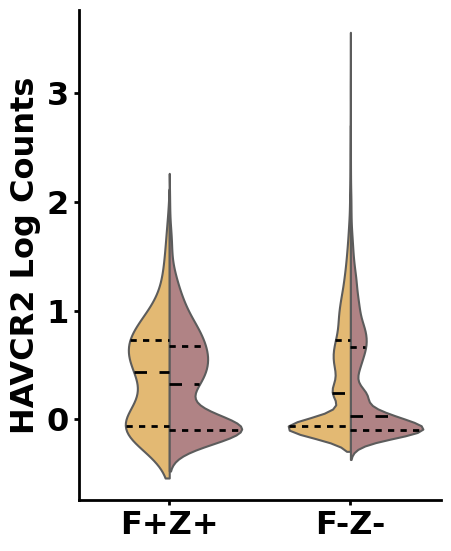

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


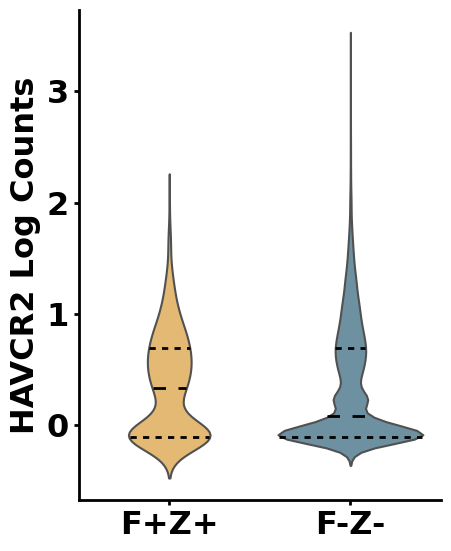

Mann-Whitney U test for TIGIT with F+Z+ vs F-Z-: U-statistic = 5080435.0, p-value = 0.05811238170212722


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


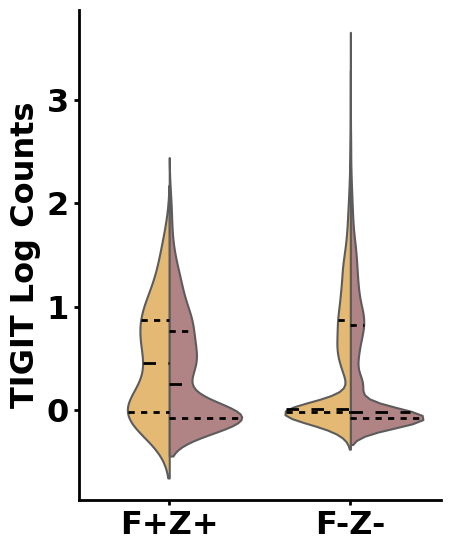

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


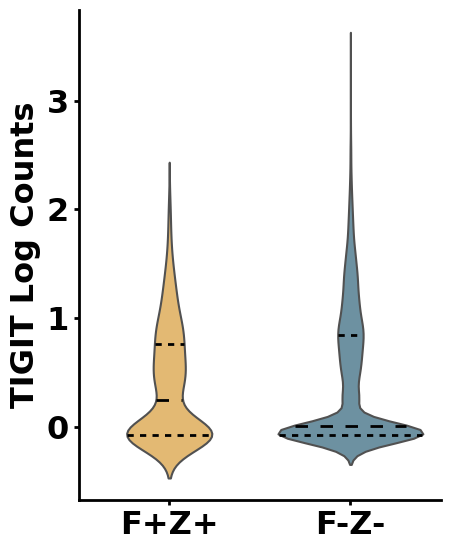

Mann-Whitney U test for IL2RA with F+Z+ vs F-Z-: U-statistic = 5194898.5, p-value = 0.3039249164376735


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


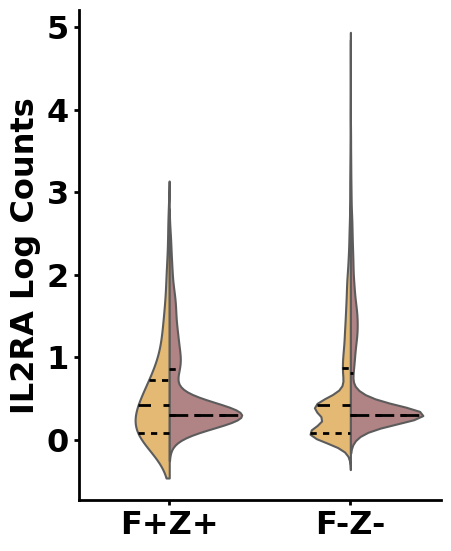

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


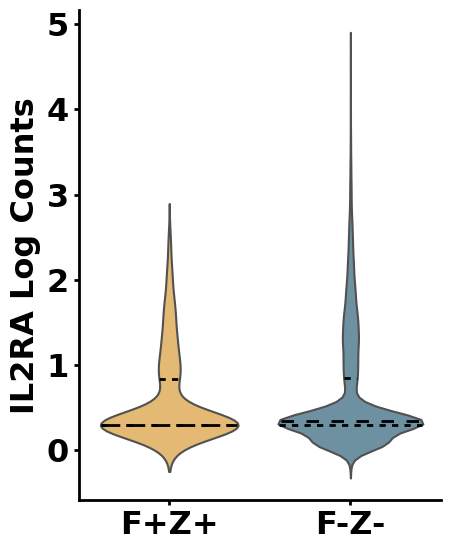

Mann-Whitney U test for CD38 with F+Z+ vs F-Z-: U-statistic = 6253318.0, p-value = 1.4652077514689131e-12


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


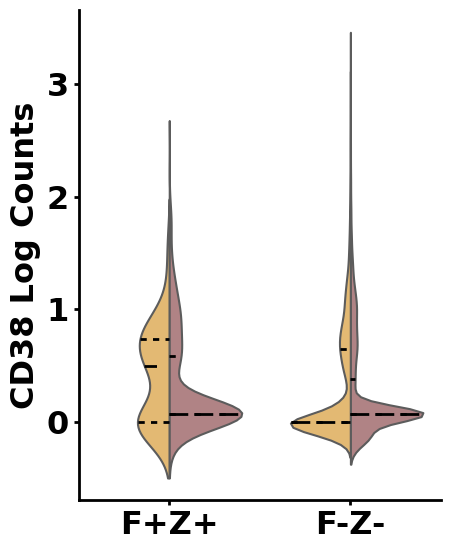

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


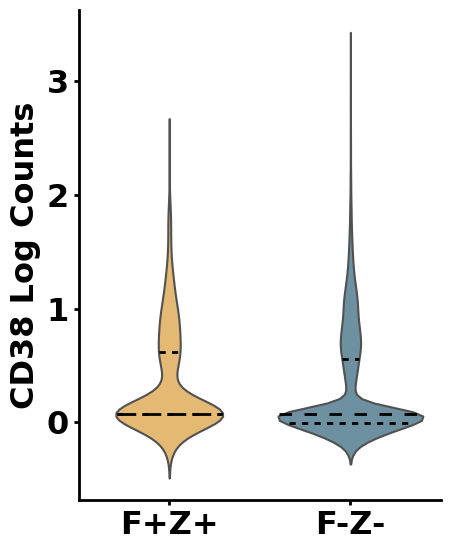

Mann-Whitney U test for MKI67 with F+Z+ vs F-Z-: U-statistic = 5768062.5, p-value = 0.0008087622772161775


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


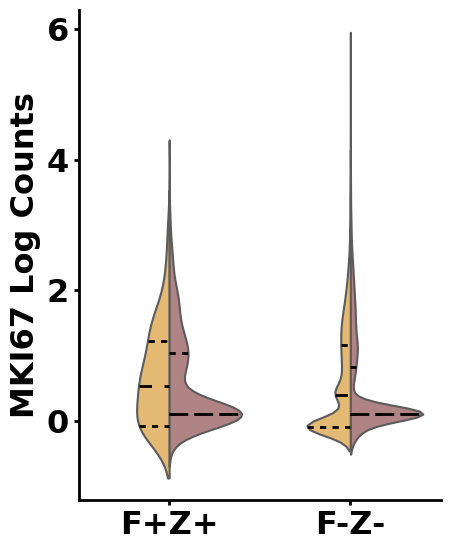

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


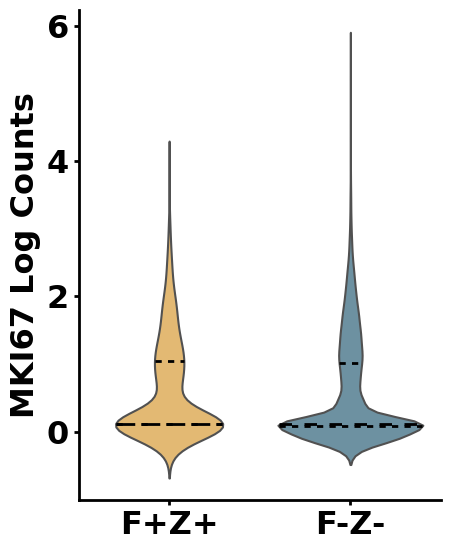

Mann-Whitney U test for PRDM1 with F+Z+ vs F-Z-: U-statistic = 4858347.5, p-value = 0.00033374700925524264


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


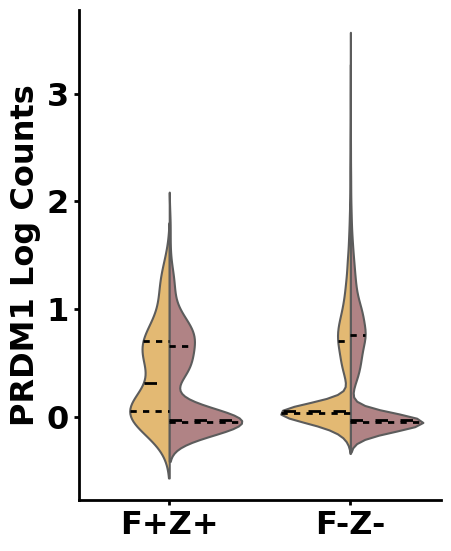

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


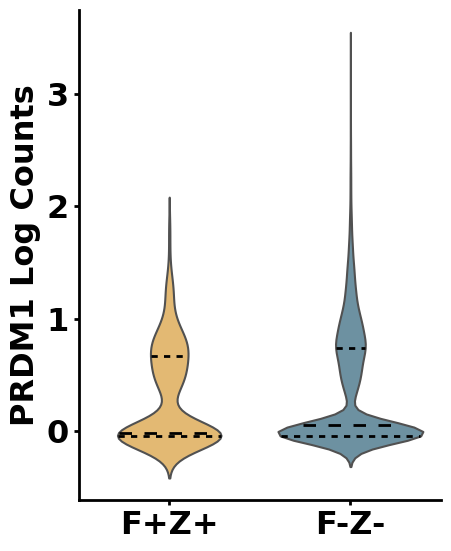

Mann-Whitney U test for TBX21 with F+Z+ vs F-Z-: U-statistic = 5695701.0, p-value = 0.005397389007349216


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


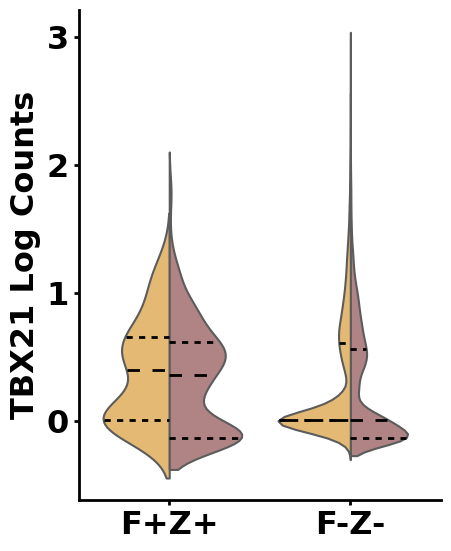

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


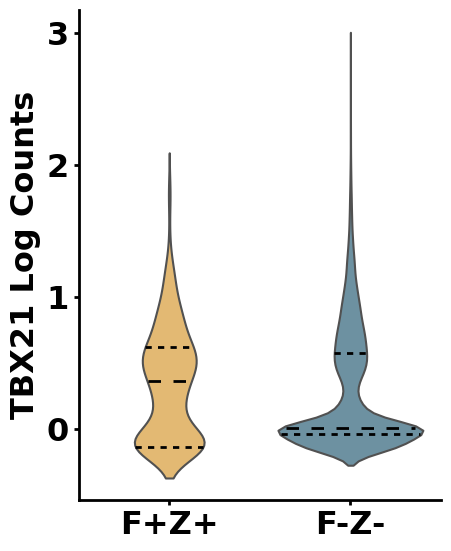

Mann-Whitney U test for B3GAT1 with F+Z+ vs F-Z-: U-statistic = 5715646.5, p-value = 0.002705853335074187


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


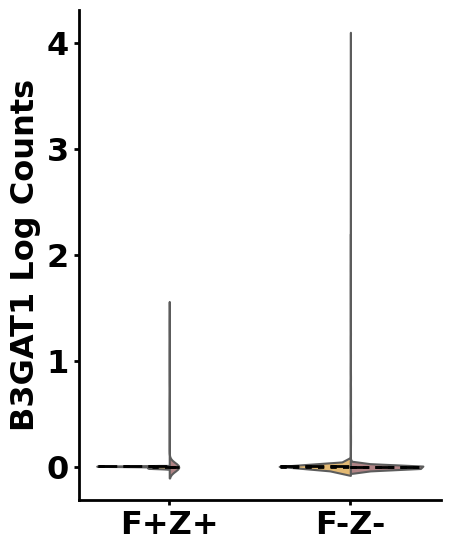

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


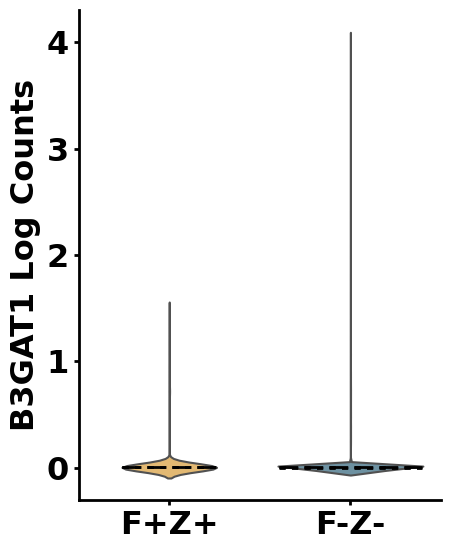

Bonferroni corrected p-value for IL2RB: 0.0021013612518647026
Bonferroni corrected p-value for IL7R: 1.0
Bonferroni corrected p-value for CXCR3: 0.004902394341008361
Bonferroni corrected p-value for CD27: 1.0
Bonferroni corrected p-value for CD28: 4.8210657460157176e-09
Bonferroni corrected p-value for ICOS: 1.0
Bonferroni corrected p-value for CTLA4: 2.3626856938121648e-07
Bonferroni corrected p-value for LAG3: 1.0
Bonferroni corrected p-value for PDCD1: 0.807367614913579
Bonferroni corrected p-value for HAVCR2: 1.0
Bonferroni corrected p-value for TIGIT: 0.9879104889361627
Bonferroni corrected p-value for IL2RA: 1.0
Bonferroni corrected p-value for CD38: 2.4908531774971525e-11
Bonferroni corrected p-value for MKI67: 0.013748958712675018
Bonferroni corrected p-value for PRDM1: 0.005673699157339125
Bonferroni corrected p-value for TBX21: 0.09175561312493667
Bonferroni corrected p-value for B3GAT1: 0.045999506696261176


In [5]:
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import mannwhitneyu
from scipy.sparse import issparse

# -----------------------------------
# Step 1: Load and Preprocess Data
# -----------------------------------

# Load log-transformed dataset
adata_log = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_log_CD4 = adata_log[adata_log.obs['cell_type'] == 'CD4'].copy()
adata_log_CR_NR = adata_log_CD4[adata_log_CD4.obs['response'].isin(['CR', 'NR'])].copy()

# Load combat-corrected dataset for counts
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_combat_CD4 = adata_combat[adata_combat.obs['cell_type'] == 'CD4'].copy()
adata_combat_CR_NR = adata_combat_CD4[adata_combat_CD4.obs['response'].isin(['CR', 'NR'])].copy()

# -----------------------------------
# Step 2: Define F+Z+ and F-Z- Populations
# -----------------------------------

# Define primary genes for population classification
primary_gene_1 = "FCER1G"
primary_gene_2 = "ZNF683"

# Extract expression data for primary genes from adata_log_CR_NR
F_log = adata_log_CR_NR[:, primary_gene_1].X.toarray().flatten() if issparse(adata_log_CR_NR.X) else adata_log_CR_NR[:, primary_gene_1].X.flatten()
Z_log = adata_log_CR_NR[:, primary_gene_2].X.toarray().flatten() if issparse(adata_log_CR_NR.X) else adata_log_CR_NR[:, primary_gene_2].X.flatten()

# Define positive as expression > 0
mask_F_positive = F_log > 0
mask_Z_positive = Z_log > 0
mask_FZ = mask_F_positive & mask_Z_positive

# Assign 'F+Z+' or 'F-Z-' based on mask to adata_combat_CR_NR
adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'] = np.where(mask_FZ, 'F+Z+', 'F-Z-')
adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'] = adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'].astype('category')

# -----------------------------------
# Step 3: Define Gene List for Comparison
# -----------------------------------

genes = [
    "IL2RB",  # CD122 (IL2Rβ)
    "IL7R",   # CD127 (IL7Rα)
    "CXCR3",  # CD183 (CXCR3)
    "CD27",   # CD27
    "CD28",   # CD28
    "ICOS",   # CD278 (ICOS)
    "CTLA4",  # CD152 (CTLA4)
    "LAG3",   # CD223 (LAG3)
    "PDCD1",  # CD279 (PD1)
    "HAVCR2", # CD366 (TIM3)
    "TIGIT",  # TIGIT
    "IL2RA",  # CD25 (IL2Rα)
    "CD38",   # CD38 (ADPRC1)
    "MKI67",  # Ki-67
    "PRDM1",  # Blimp-1
    "TBX21",  # T-bet
    "B3GAT1"  # CD57
]

# -----------------------------------
# Step 4: Prepare Data for Comparison
# -----------------------------------
df = adata_combat_CR_NR.to_df()
df[f'{primary_gene_1}_{primary_gene_2}_positive'] = adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'].values
df['response'] = adata_combat_CR_NR.obs['response'].values

# Set the order for the x-axis categories to ensure F+Z+ appears first
category_order = ['F+Z+', 'F-Z-']

# Initialize a list to store p-values for Bonferroni correction
p_values = []

# -----------------------------------
# Step 5: Configure Plot Settings
# -----------------------------------
plt.rcParams['font.weight'] = 'bold'
plt.rcParams['font.size'] = 23
plt.rcParams['axes.linewidth'] = 2
plt.rcParams['axes.labelweight'] = 'bold'
plt.rcParams['xtick.major.width'] = 2
plt.rcParams['ytick.major.width'] = 2

# -----------------------------------
# Step 6: Compare Gene Expressions and Plot
# -----------------------------------

for gene in genes:
    if gene in adata_combat_CR_NR.var_names:
        df['value'] = adata_combat_CR_NR[:, adata_combat_CR_NR.var_names == gene].X.toarray().flatten()

        # Separate values for F+Z+ and F-Z-
        group_positive = df[df[f'{primary_gene_1}_{primary_gene_2}_positive'] == 'F+Z+']['value']
        group_negative = df[df[f'{primary_gene_1}_{primary_gene_2}_positive'] == 'F-Z-']['value']

        # Perform Mann-Whitney U test
        stat, p_value = mannwhitneyu(group_positive, group_negative, alternative='two-sided')
        p_values.append(p_value)
        print(f"Mann-Whitney U test for {gene} with F+Z+ vs F-Z-: U-statistic = {stat}, p-value = {p_value}")

        # Create the violin plot with hue for response
        plt.figure(figsize=(5, 6))
        ax = sns.violinplot(
            data=df,
            x=f'{primary_gene_1}_{primary_gene_2}_positive',
            y='value',
            hue='response',
            split=True,
            inner="quart",
            palette=["#F6BD60", "#B77B7E"],
            order=category_order
        )
        sns.despine()

        # Make the inner quartile lines thicker and black
        for line in ax.lines:
            line.set_linewidth(2)
            line.set_color('black')

        plt.legend([], [], frameon=False)
        plt.title('')
        plt.xlabel('')
        plt.ylabel(f'{gene} Log Counts')
        plt.tight_layout()
        plt.show()

        # Another violin plot without hue
        plt.figure(figsize=(5, 6))
        ax = sns.violinplot(
            data=df,
            x=f'{primary_gene_1}_{primary_gene_2}_positive',
            y='value',
            inner="quart",
            palette=["#F6BD60", '#6494AA'],
            order=category_order
        )
        sns.despine()

        # Make the inner quartile lines thicker and black here as well
        for line in ax.lines:
            line.set_linewidth(2)
            line.set_color('black')

        plt.legend([], [], frameon=False)
        plt.title('')
        plt.xlabel('')
        plt.ylabel(f'{gene} Log Counts')
        plt.tight_layout()
        plt.show()

    else:
        print(f"{gene} is not present in the variable names. Please check your adata object.")

# -----------------------------------
# Step 7: Apply Bonferroni Correction
# -----------------------------------
bonferroni_corrected_p_values = np.minimum(np.array(p_values) * len(genes), 1.0)
for gene, corrected_p_value in zip(genes, bonferroni_corrected_p_values):
    print(f"Bonferroni corrected p-value for {gene}: {corrected_p_value}")


Mann-Whitney U test for IL2RB in NR: U-statistic = 7610199.0, p-value = 0.03956712160984965
Mann-Whitney U test for IL2RB in CR: U-statistic = 481708.0, p-value = 0.1093668441580109


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


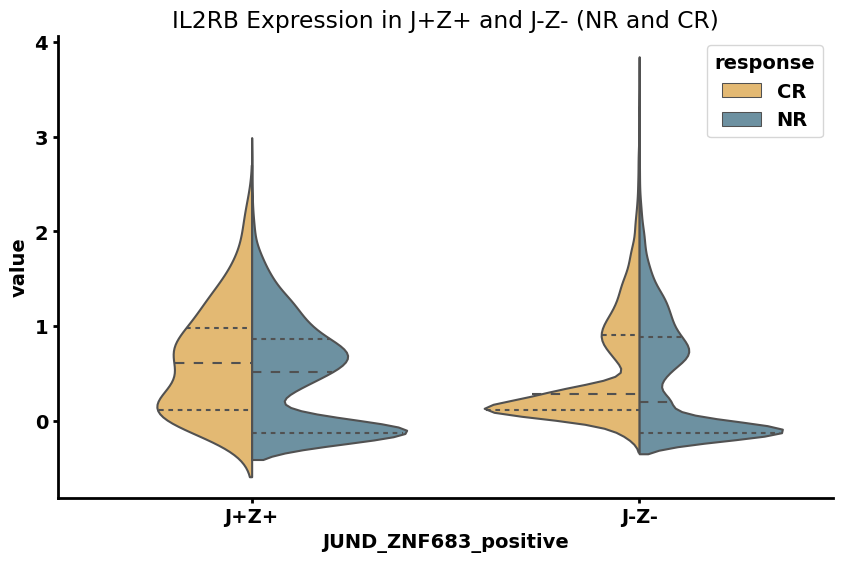

Mann-Whitney U test for IL7R in NR: U-statistic = 7333723.0, p-value = 0.7248207411510996
Mann-Whitney U test for IL7R in CR: U-statistic = 461028.5, p-value = 0.4421561696318713


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


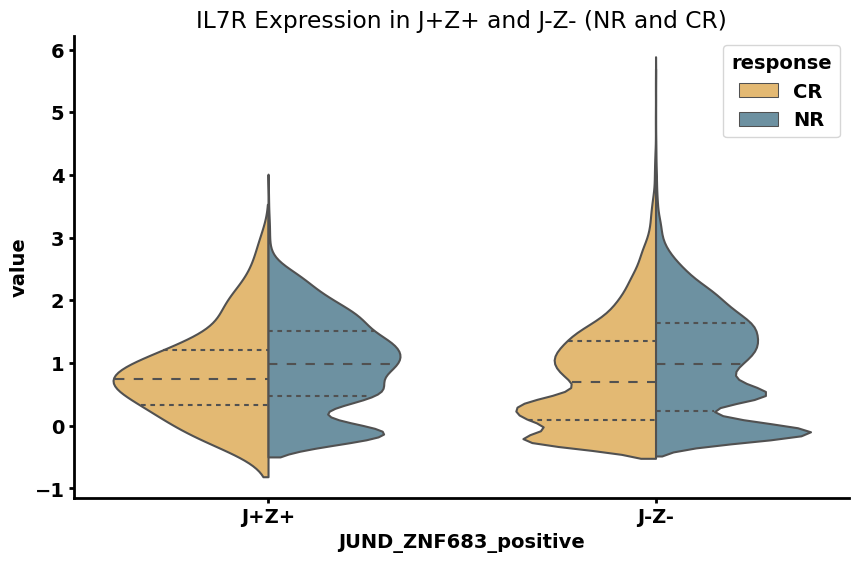

Mann-Whitney U test for CXCR3 in NR: U-statistic = 8106943.5, p-value = 2.4235065657489074e-10
Mann-Whitney U test for CXCR3 in CR: U-statistic = 504018.0, p-value = 0.013852558534492607


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


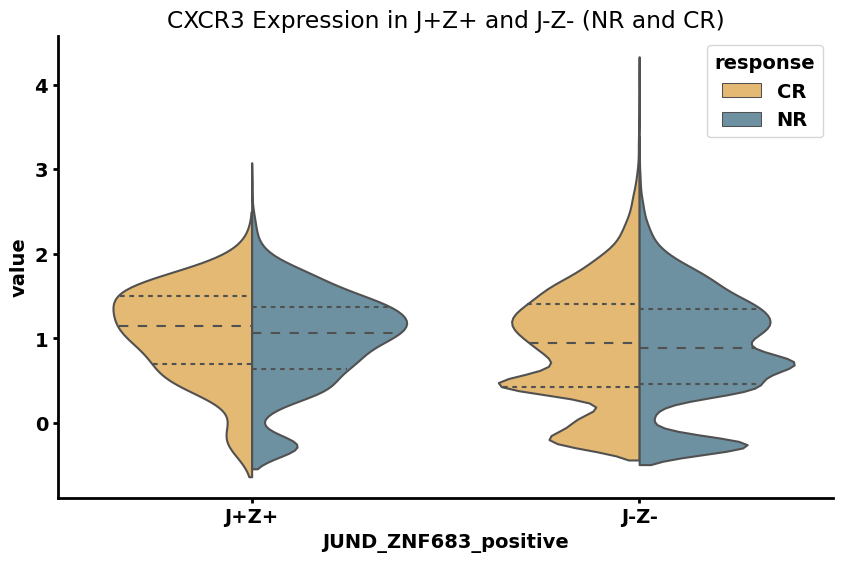

Mann-Whitney U test for CD27 in NR: U-statistic = 7419908.5, p-value = 0.6941618906007458
Mann-Whitney U test for CD27 in CR: U-statistic = 409403.5, p-value = 0.20530535363155955


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


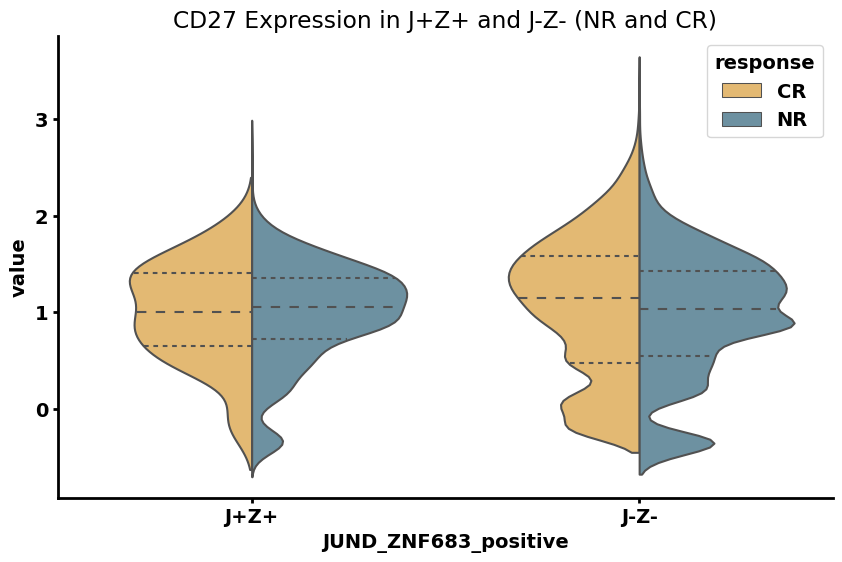

Mann-Whitney U test for CD28 in NR: U-statistic = 6618715.0, p-value = 4.2534194446414796e-11
Mann-Whitney U test for CD28 in CR: U-statistic = 404984.0, p-value = 0.14935814547967896


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


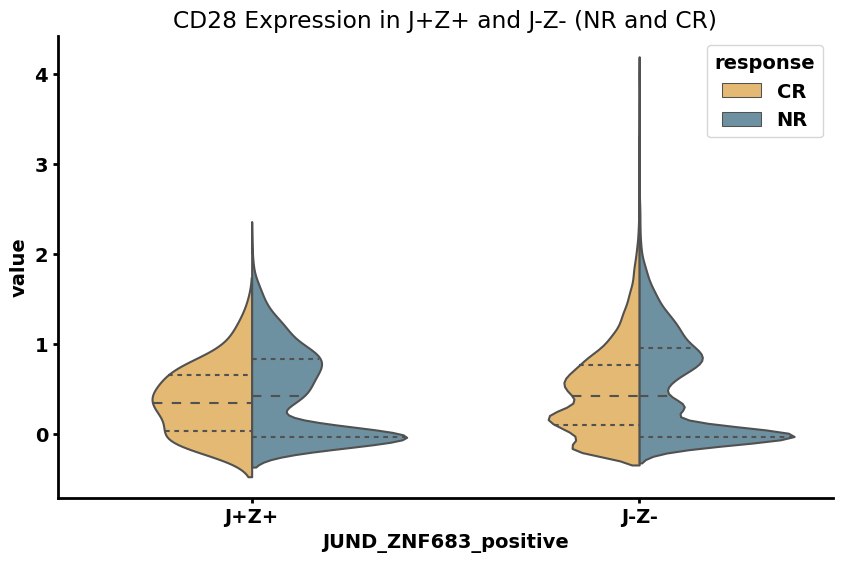

Mann-Whitney U test for ICOS in NR: U-statistic = 7245572.0, p-value = 0.2545838782036197
Mann-Whitney U test for ICOS in CR: U-statistic = 413227.5, p-value = 0.2618951606449246


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


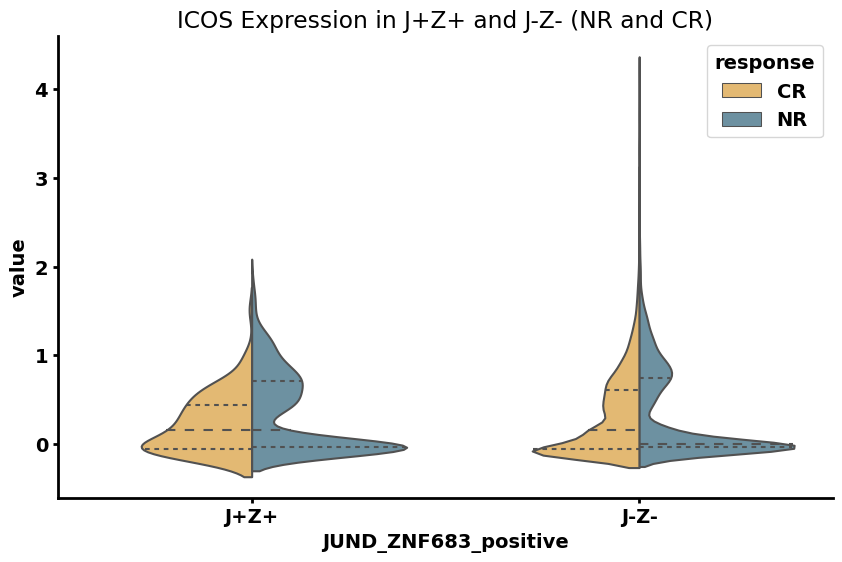

Mann-Whitney U test for CTLA4 in NR: U-statistic = 6121459.5, p-value = 6.323555514642916e-28
Mann-Whitney U test for CTLA4 in CR: U-statistic = 385415.5, p-value = 0.026816848884530113


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


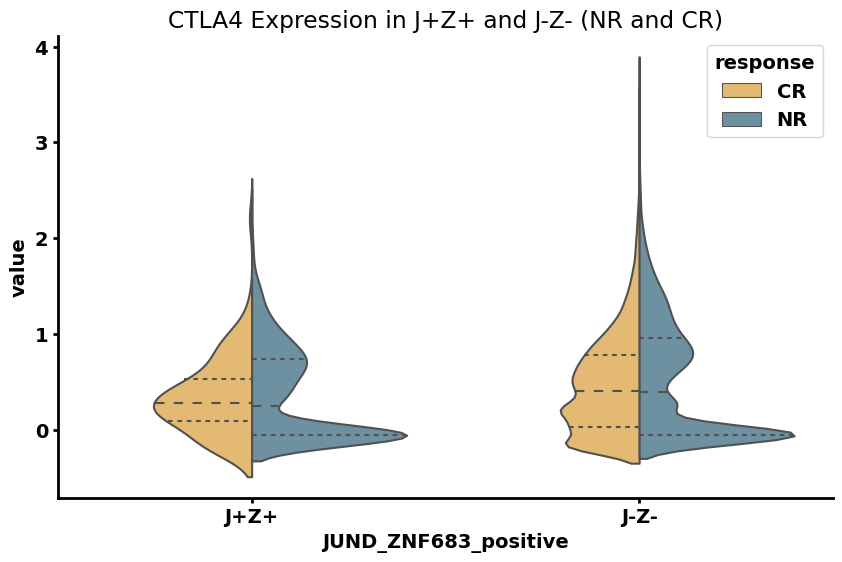

Mann-Whitney U test for LAG3 in NR: U-statistic = 6997411.5, p-value = 0.0010279427160624296
Mann-Whitney U test for LAG3 in CR: U-statistic = 413206.0, p-value = 0.26343150872085586


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


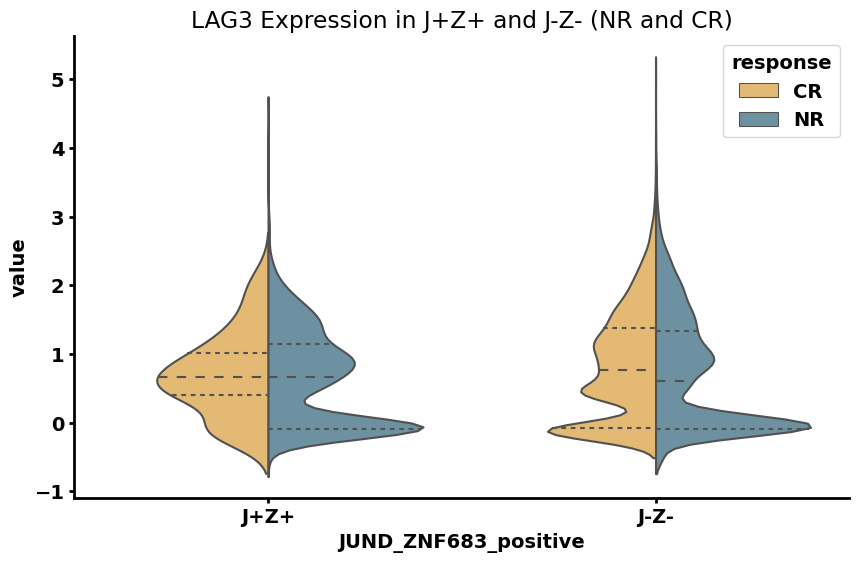

Mann-Whitney U test for PDCD1 in NR: U-statistic = 7027818.0, p-value = 0.002485415645604083
Mann-Whitney U test for PDCD1 in CR: U-statistic = 442303.5, p-value = 0.9763400992100058


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


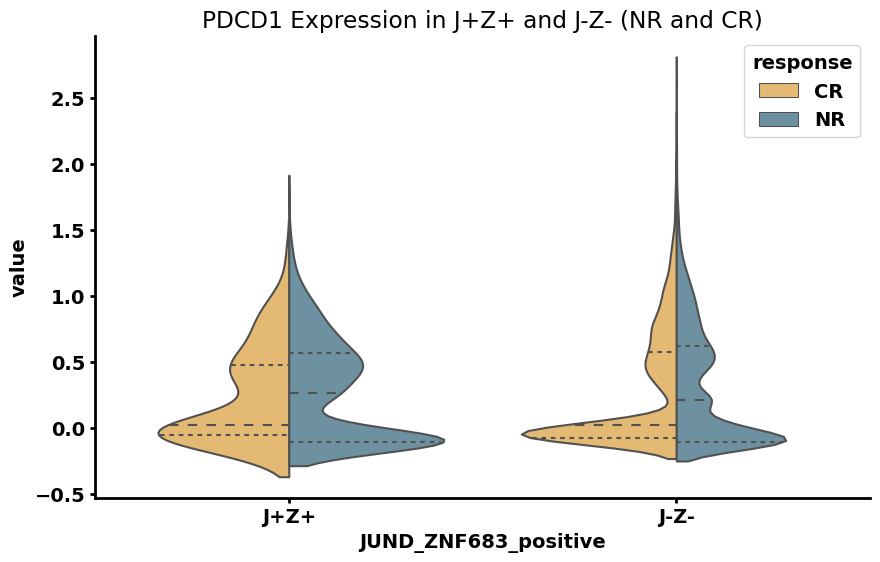

Mann-Whitney U test for HAVCR2 in NR: U-statistic = 7030720.5, p-value = 0.002331070493726989
Mann-Whitney U test for HAVCR2 in CR: U-statistic = 456006.5, p-value = 0.5661842678658344


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


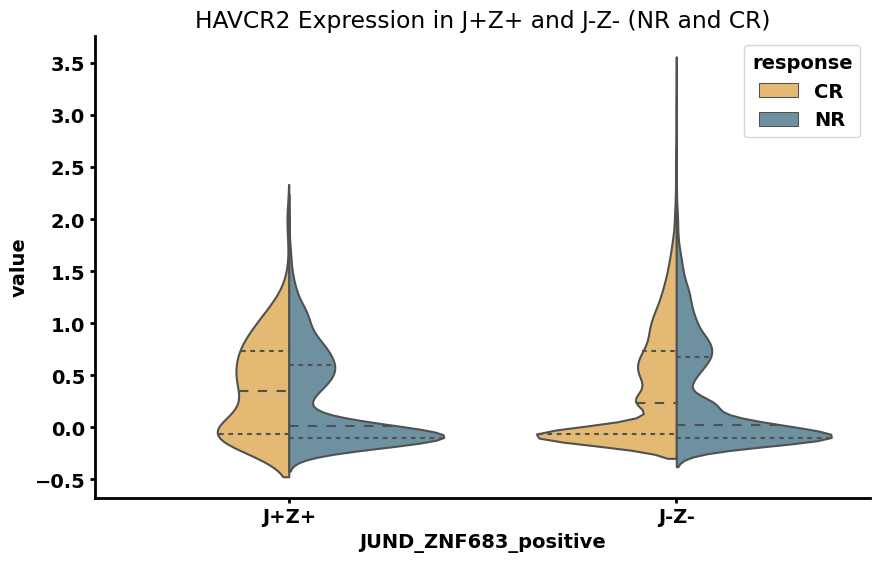

Mann-Whitney U test for TIGIT in NR: U-statistic = 7222876.5, p-value = 0.17852372838310637
Mann-Whitney U test for TIGIT in CR: U-statistic = 477046.5, p-value = 0.1575464939791844


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


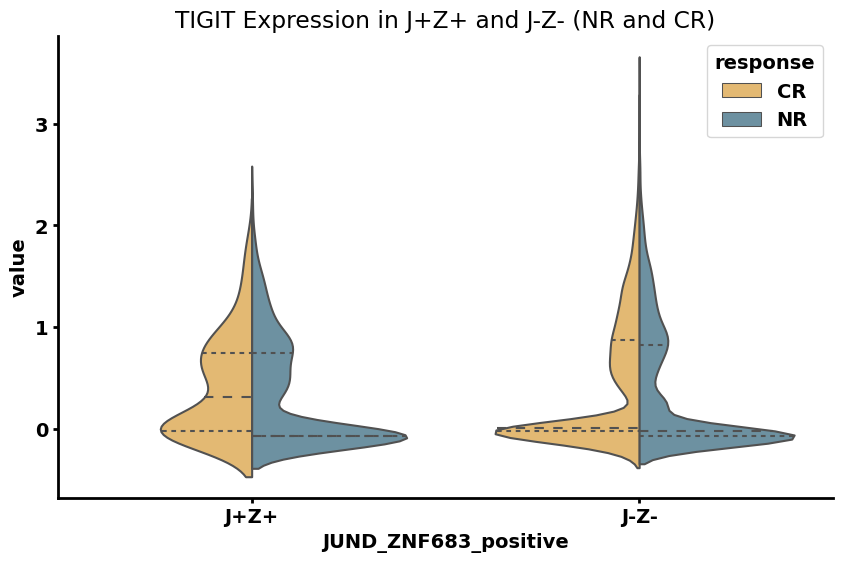

Mann-Whitney U test for IL2RA in NR: U-statistic = 6196098.5, p-value = 9.640401109009828e-27
Mann-Whitney U test for IL2RA in CR: U-statistic = 415622.5, p-value = 0.29954115223241884


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


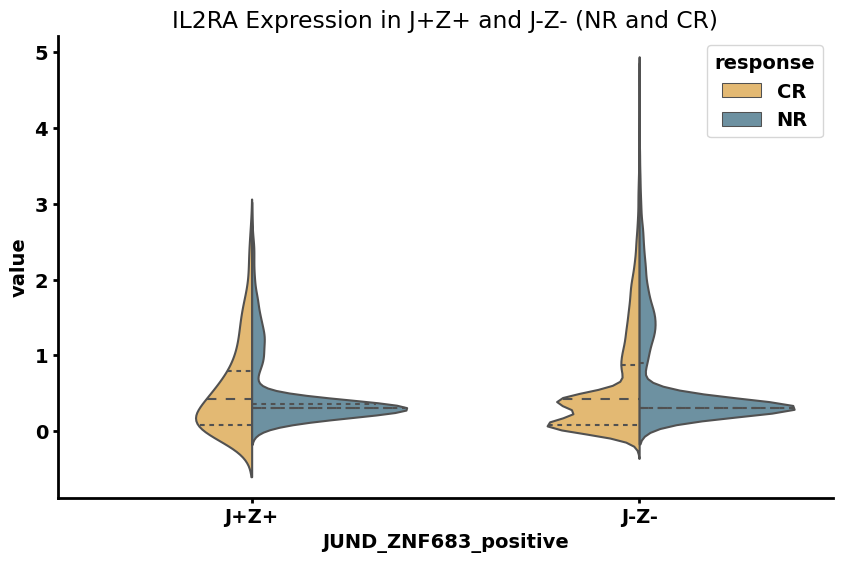

Mann-Whitney U test for CD38 in NR: U-statistic = 8306463.0, p-value = 7.75019715235689e-18
Mann-Whitney U test for CD38 in CR: U-statistic = 465218.0, p-value = 0.3424476755971049


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


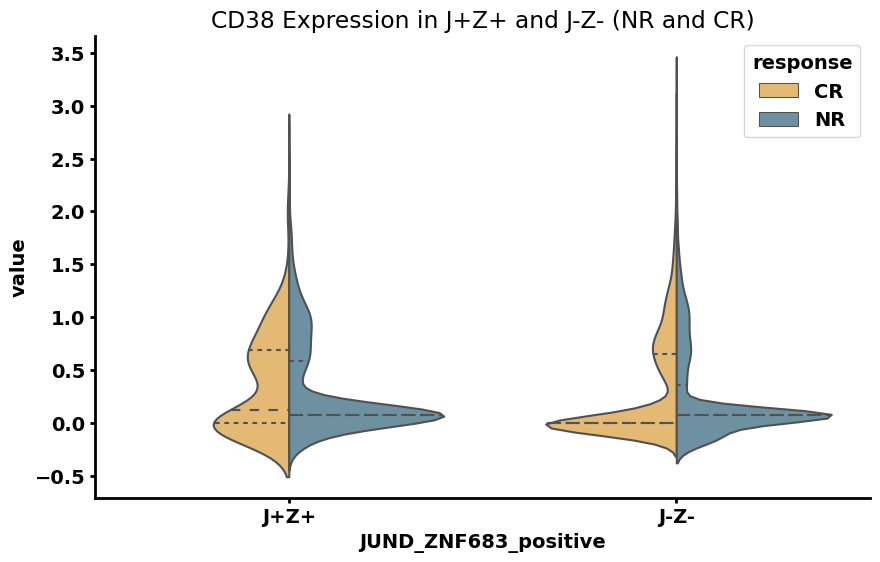

Mann-Whitney U test for MKI67 in NR: U-statistic = 8151014.5, p-value = 1.609659094526235e-12
Mann-Whitney U test for MKI67 in CR: U-statistic = 523762.0, p-value = 0.001087057485129474


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


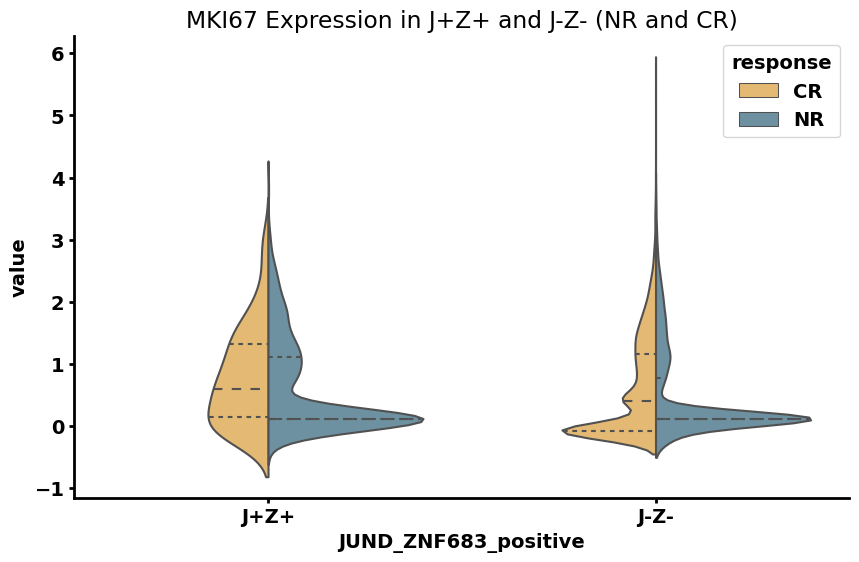

Mann-Whitney U test for PRDM1 in NR: U-statistic = 6847678.5, p-value = 2.9769892607873544e-06
Mann-Whitney U test for PRDM1 in CR: U-statistic = 451132.0, p-value = 0.6999281532631216


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


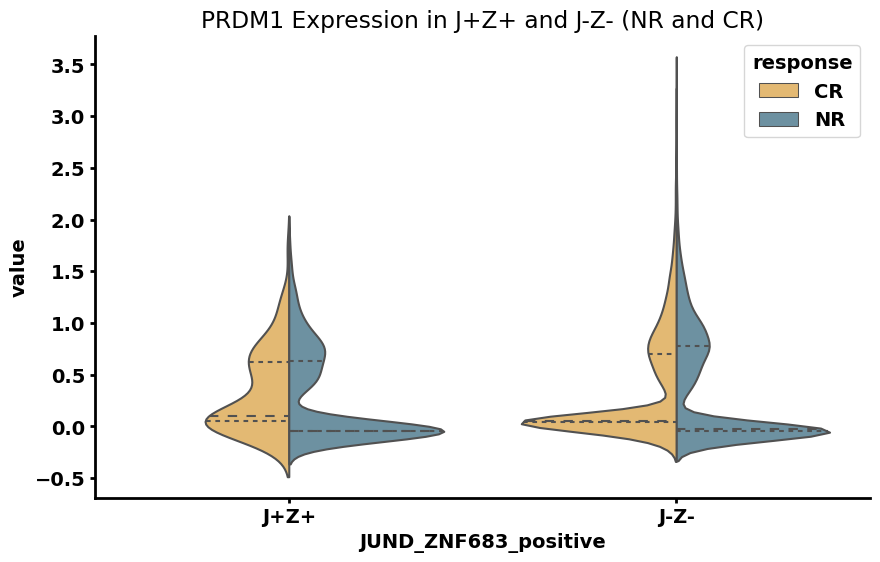

Mann-Whitney U test for TBX21 in NR: U-statistic = 7908208.5, p-value = 2.862996661110247e-06
Mann-Whitney U test for TBX21 in CR: U-statistic = 505310.0, p-value = 0.010704592899517477


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


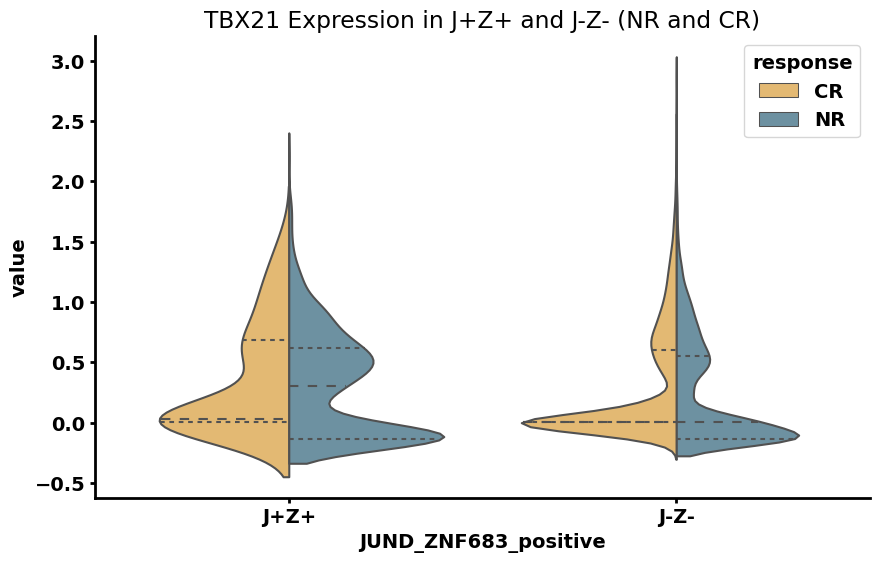

Mann-Whitney U test for B3GAT1 in NR: U-statistic = 8420426.5, p-value = 8.871751068179225e-25
Mann-Whitney U test for B3GAT1 in CR: U-statistic = 411173.5, p-value = 0.19805104616882263


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


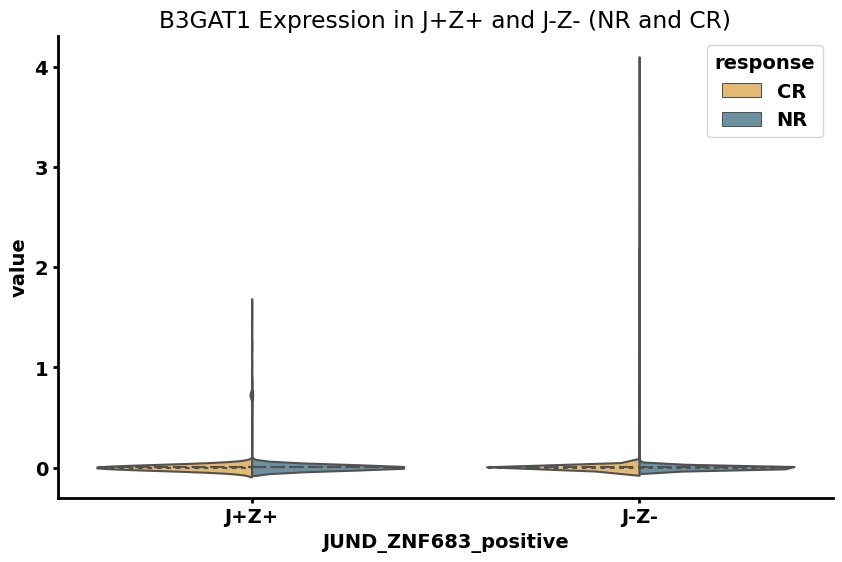

Bonferroni corrected p-value for IL2RB in NR: 0.03956712160984965
Bonferroni corrected p-value for IL2RB in CR: 0.1093668441580109
Bonferroni corrected p-value for IL7R in NR: 0.7248207411510996
Bonferroni corrected p-value for IL7R in CR: 0.4421561696318713
Bonferroni corrected p-value for CXCR3 in NR: 2.4235065657489074e-10
Bonferroni corrected p-value for CXCR3 in CR: 0.013852558534492607
Bonferroni corrected p-value for CD27 in NR: 0.6941618906007458
Bonferroni corrected p-value for CD27 in CR: 0.20530535363155955
Bonferroni corrected p-value for CD28 in NR: 4.2534194446414796e-11
Bonferroni corrected p-value for CD28 in CR: 0.14935814547967896
Bonferroni corrected p-value for ICOS in NR: 0.2545838782036197
Bonferroni corrected p-value for ICOS in CR: 0.2618951606449246
Bonferroni corrected p-value for CTLA4 in NR: 6.323555514642916e-28
Bonferroni corrected p-value for CTLA4 in CR: 0.026816848884530113
Bonferroni corrected p-value for LAG3 in NR: 0.0010279427160624296
Bonferroni co

In [6]:
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import mannwhitneyu
from scipy.sparse import issparse

# -----------------------------------
# Step 1: Load and Preprocess Data
# -----------------------------------

# Load log-transformed dataset
adata_log = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_log_CD4 = adata_log[adata_log.obs['cell_type'] == 'CD4'].copy()
adata_log_CR_NR = adata_log_CD4[adata_log_CD4.obs['response'].isin(['CR', 'NR'])].copy()

# Load combat-corrected dataset for counts
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_combat_CD4 = adata_combat[adata_combat.obs['cell_type'] == 'CD4'].copy()
adata_combat_CR_NR = adata_combat_CD4[adata_combat_CD4.obs['response'].isin(['CR', 'NR'])].copy()

# -----------------------------------
# Step 2: Define J+Z+ and J-Z- Populations
# -----------------------------------

# Define primary genes for population classification
primary_gene_1 = "JUND"
primary_gene_2 = "ZNF683"

# Extract expression data for primary genes from adata_log_CR_NR
JUND_log = adata_log_CR_NR[:, primary_gene_1].X.toarray().flatten() if issparse(adata_log_CR_NR.X) else adata_log_CR_NR[:, primary_gene_1].X.flatten()
ZNF689_log = adata_log_CR_NR[:, primary_gene_2].X.toarray().flatten() if issparse(adata_log_CR_NR.X) else adata_log_CR_NR[:, primary_gene_2].X.flatten()

# Define positive as expression >0
mask_JUND_positive = JUND_log > 0
mask_ZNF689_positive = ZNF689_log > 0
mask_JhZh = mask_JUND_positive & mask_ZNF689_positive

# Assign 'J+Z+' or 'J-Z-' based on mask to adata_combat_CR_NR
adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'] = np.where(mask_JhZh, 'J+Z+', 'J-Z-')
adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'] = adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'].astype('category')

# -----------------------------------
# Step 3: Define Gene List for Comparison
# -----------------------------------

genes = [
    "IL2RB",  "IL7R",  "CXCR3",  "CD27",  "CD28", 
    "ICOS",  "CTLA4",  "LAG3",  "PDCD1",  "HAVCR2", 
    "TIGIT",  "IL2RA",  "CD38",  "MKI67",  "PRDM1", 
    "TBX21",  "B3GAT1"
]

# -----------------------------------
# Step 4: Prepare Data for Comparison
# -----------------------------------
df = adata_combat_CR_NR.to_df()
df[f'{primary_gene_1}_{primary_gene_2}_positive'] = adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'].values
df['response'] = adata_combat_CR_NR.obs['response'].values

category_order = ['J+Z+', 'J-Z-']

p_values = []
# -----------------------------------
# Step 5: Compare Gene Expressions and Plot
# -----------------------------------

for gene in genes:
    if gene in adata_combat_CR_NR.var_names:
        df['value'] = adata_combat_CR_NR[:, adata_combat_CR_NR.var_names == gene].X.toarray().flatten()

        # Compare in NR group
        df_NR = df[df['response'] == 'NR']
        group_NR_positive = df_NR[df_NR[f'{primary_gene_1}_{primary_gene_2}_positive'] == 'J+Z+']['value']
        group_NR_negative = df_NR[df_NR[f'{primary_gene_1}_{primary_gene_2}_positive'] == 'J-Z-']['value']
        stat_NR, p_value_NR = mannwhitneyu(group_NR_positive, group_NR_negative, alternative='two-sided')

        # Compare in CR group
        df_CR = df[df['response'] == 'CR']
        group_CR_positive = df_CR[df_CR[f'{primary_gene_1}_{primary_gene_2}_positive'] == 'J+Z+']['value']
        group_CR_negative = df_CR[df_CR[f'{primary_gene_1}_{primary_gene_2}_positive'] == 'J-Z-']['value']
        stat_CR, p_value_CR = mannwhitneyu(group_CR_positive, group_CR_negative, alternative='two-sided')

        p_values.append((gene, p_value_NR, p_value_CR))

        print(f"Mann-Whitney U test for {gene} in NR: U-statistic = {stat_NR}, p-value = {p_value_NR}")
        print(f"Mann-Whitney U test for {gene} in CR: U-statistic = {stat_CR}, p-value = {p_value_CR}")

        # Plotting NR and CR together for each gene
        plt.figure(figsize=(10, 6))
        sns.violinplot(
            data=df,
            x=f'{primary_gene_1}_{primary_gene_2}_positive',
            y='value',
            hue='response',
            split=True,
            inner="quart",
            palette=["#F6BD60", '#6494AA'],
            order=category_order
        )
        plt.title(f"{gene} Expression in J+Z+ and J-Z- (NR and CR)")
        sns.despine()
        plt.show()

# -----------------------------------
# Step 6: Bonferroni Correction
# -----------------------------------

bonferroni_corrected_p_values_NR = np.minimum([p[1] for p in p_values] * len(genes), 1.0)
bonferroni_corrected_p_values_CR = np.minimum([p[2] for p in p_values] * len(genes), 1.0)

# Print corrected p-values
for (gene, p_value_NR, p_value_CR), p_corrected_NR, p_corrected_CR in zip(p_values, bonferroni_corrected_p_values_NR, bonferroni_corrected_p_values_CR):
    print(f"Bonferroni corrected p-value for {gene} in NR: {p_corrected_NR}")
    print(f"Bonferroni corrected p-value for {gene} in CR: {p_corrected_CR}")


Mann-Whitney U test for IL2RB with FhZh vs FlZl: U-statistic = 49272220.5, p-value = 3.500631214113242e-54


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


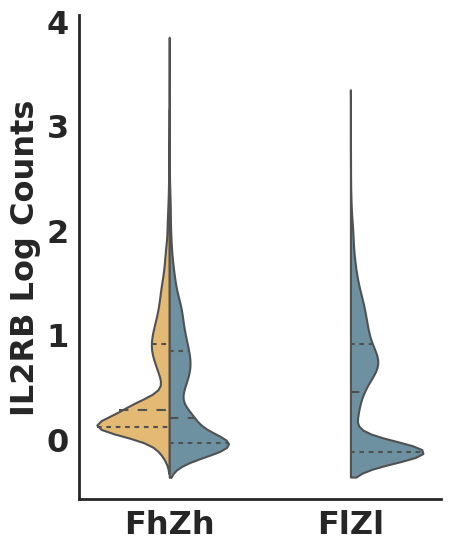

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


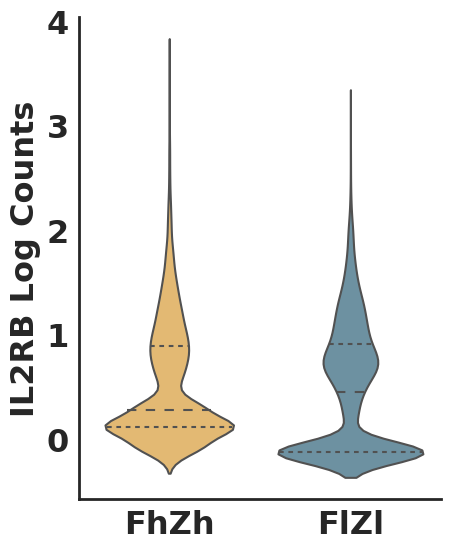

Mann-Whitney U test for IL7R with FhZh vs FlZl: U-statistic = 36443171.0, p-value = 7.24413024307198e-77


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


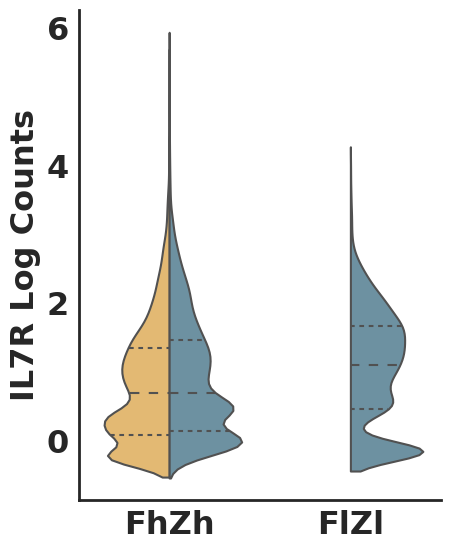

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


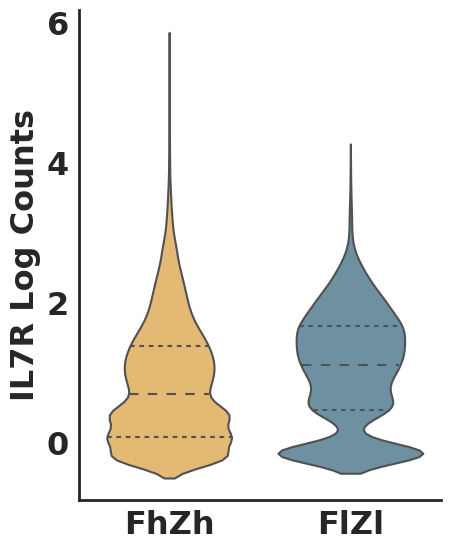

Mann-Whitney U test for CXCR3 with FhZh vs FlZl: U-statistic = 42321849.0, p-value = 0.0030103316086745676


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


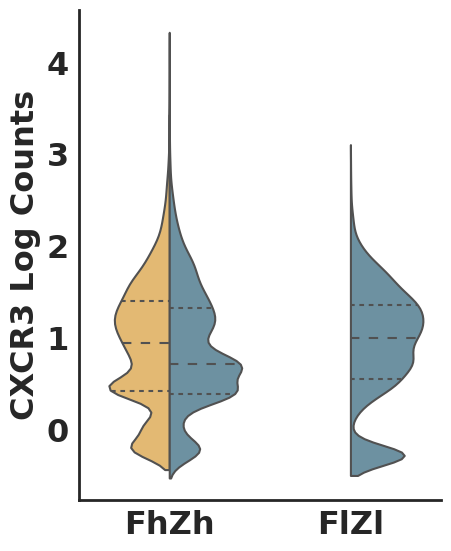

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


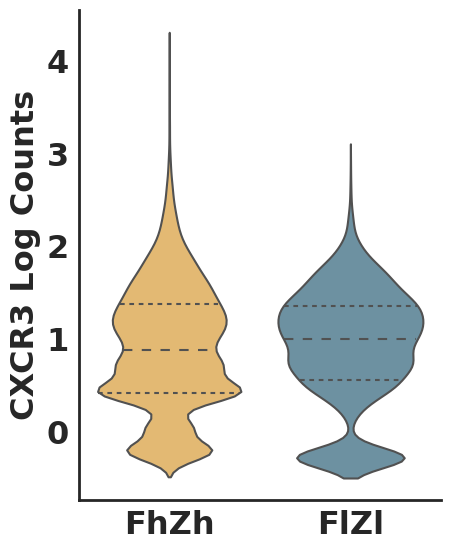

Mann-Whitney U test for CCR7 with FhZh vs FlZl: U-statistic = 42760397.0, p-value = 0.0663456830754456


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


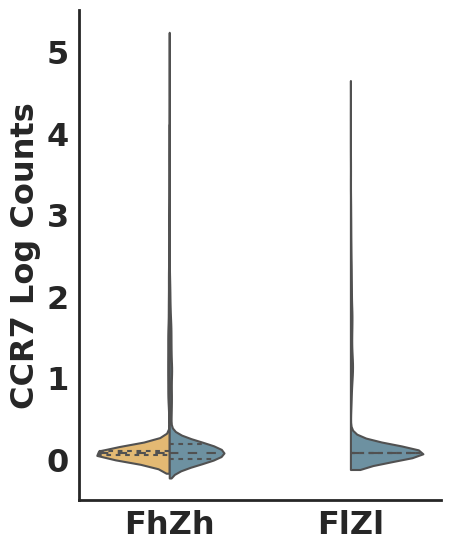

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


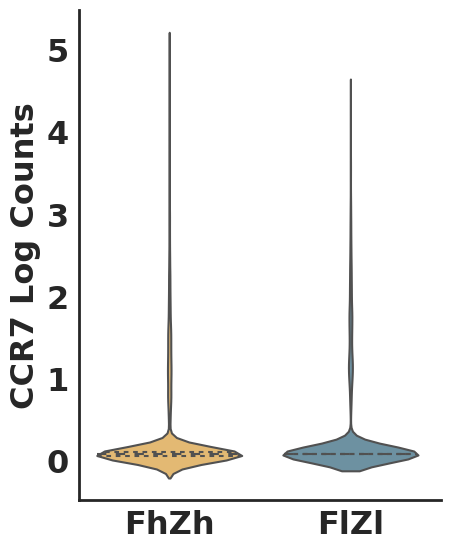

Mann-Whitney U test for CD27 with FhZh vs FlZl: U-statistic = 45334882.0, p-value = 5.167838984052104e-07


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


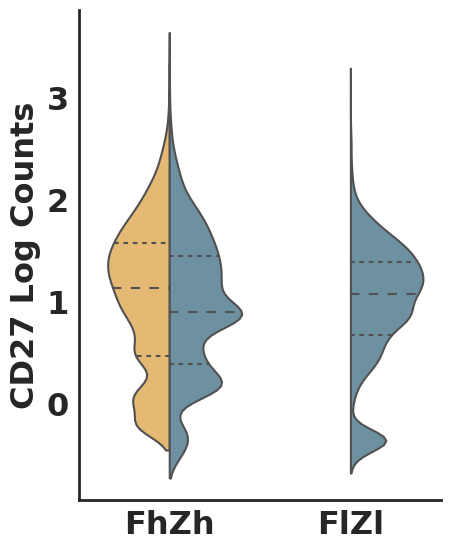

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


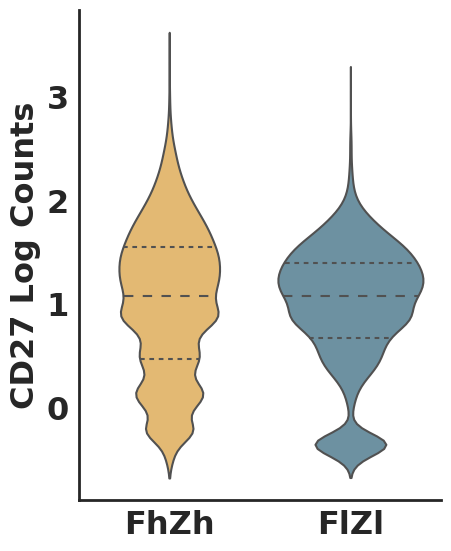

Mann-Whitney U test for CD28 with FhZh vs FlZl: U-statistic = 41957523.5, p-value = 8.182123944219703e-05


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


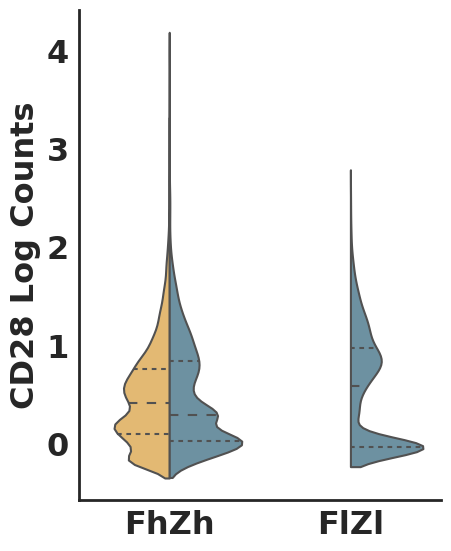

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


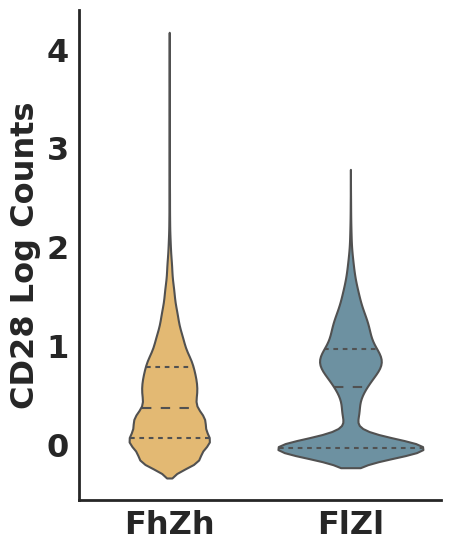

Mann-Whitney U test for TNFRSF4 with FhZh vs FlZl: U-statistic = 40999065.0, p-value = 6.25592267707302e-11


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


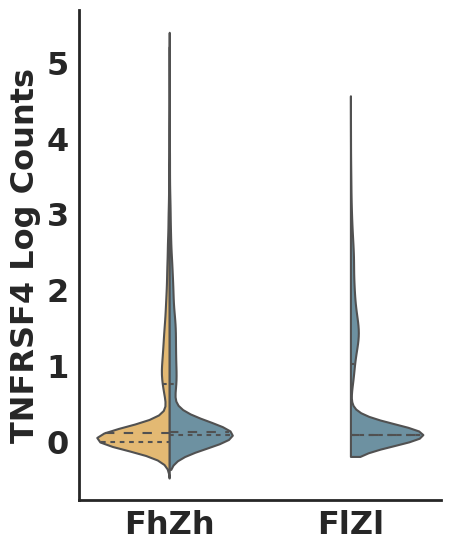

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


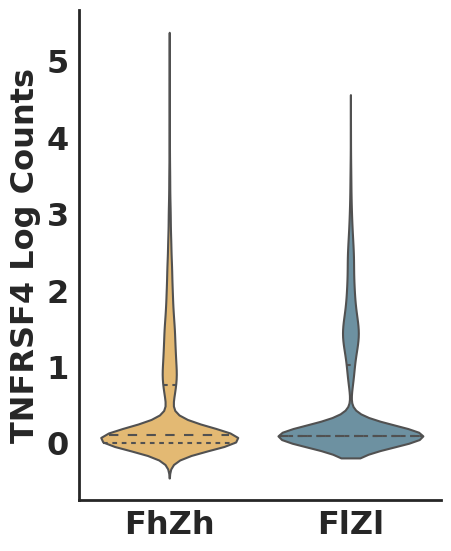

Mann-Whitney U test for TNFRSF9 with FhZh vs FlZl: U-statistic = 63428421.0, p-value = 0.0


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


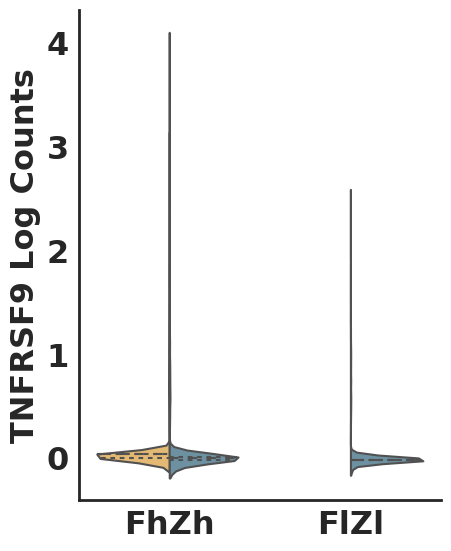

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


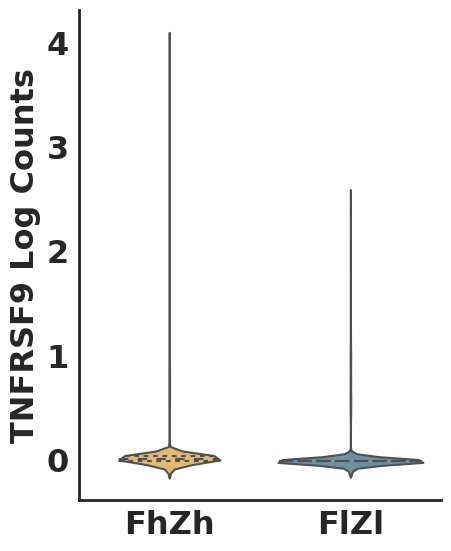

Mann-Whitney U test for ICOS with FhZh vs FlZl: U-statistic = 41887731.5, p-value = 3.549149155449358e-05


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


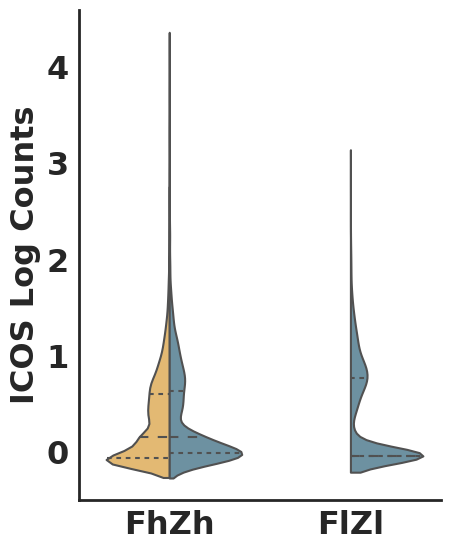

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


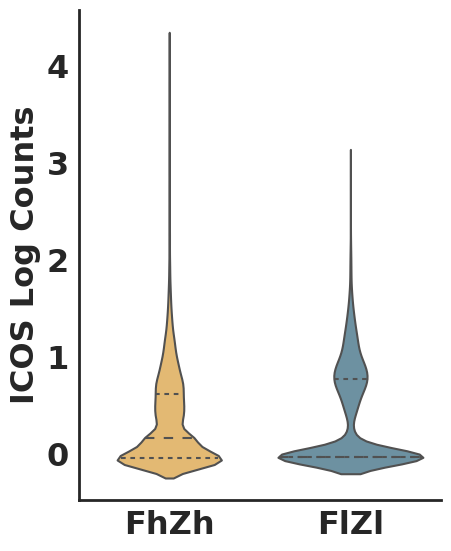

Mann-Whitney U test for ENTPD1 with FhZh vs FlZl: U-statistic = 40722066.5, p-value = 1.774925974702689e-13


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


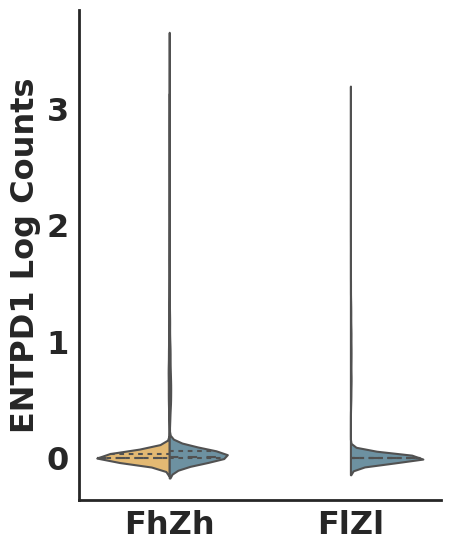

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


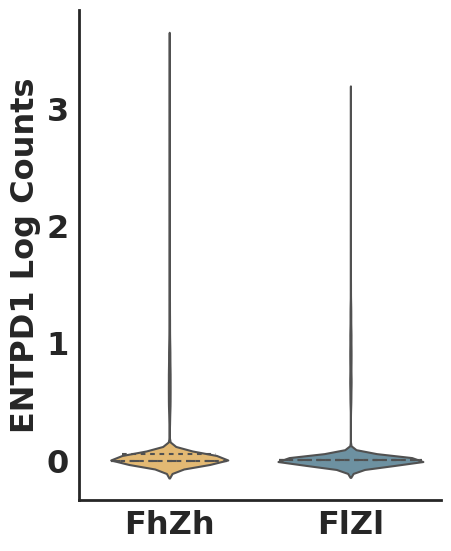

Mann-Whitney U test for CD101 with FhZh vs FlZl: U-statistic = 25681562.0, p-value = 0.0


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


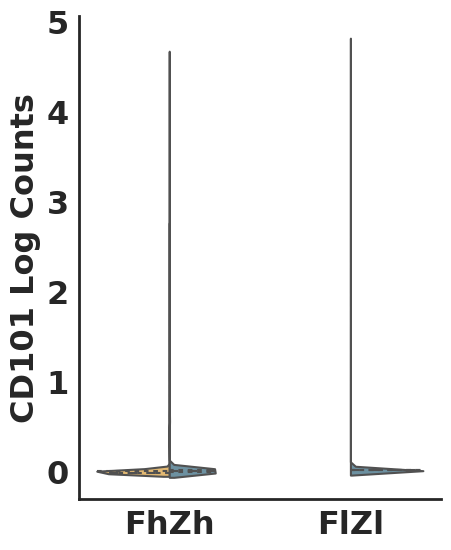

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


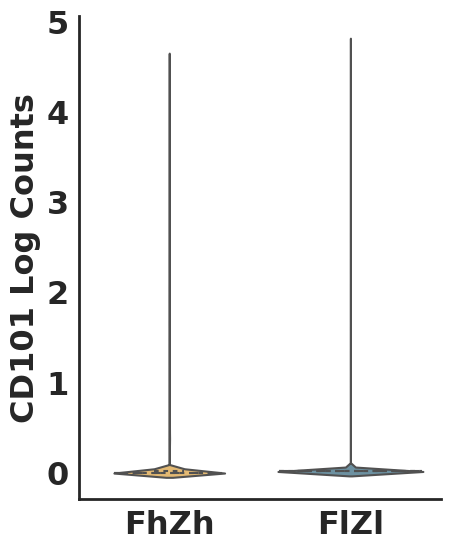

Mann-Whitney U test for CTLA4 with FhZh vs FlZl: U-statistic = 43513393.5, p-value = 0.8475345026358089


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


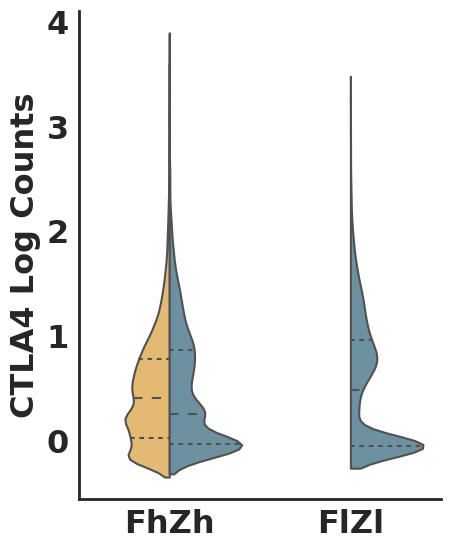

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


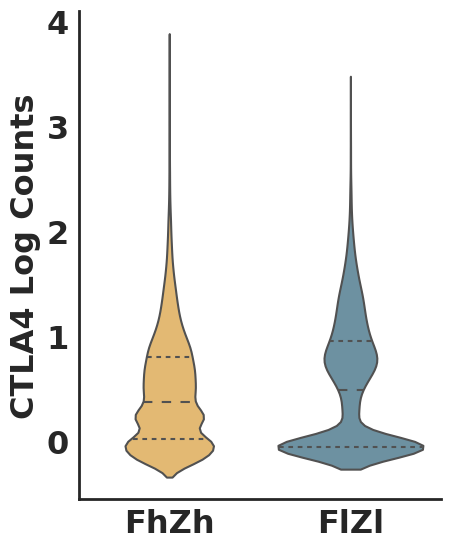

Mann-Whitney U test for LAG3 with FhZh vs FlZl: U-statistic = 42581899.0, p-value = 0.022583763269208423


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


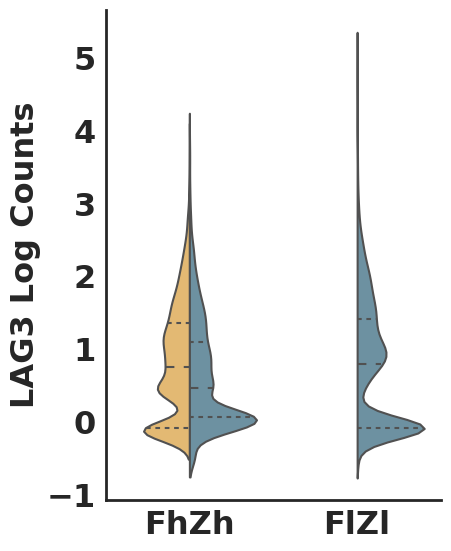

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


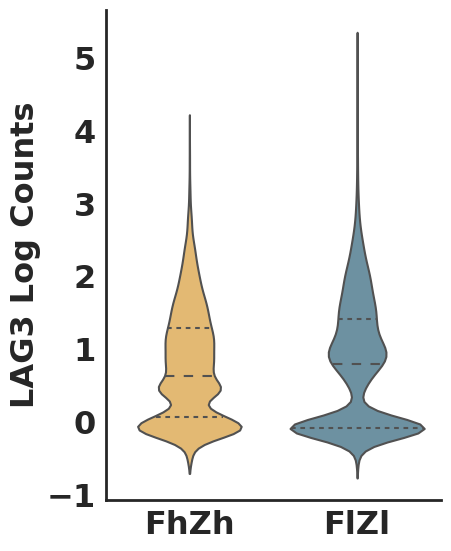

Mann-Whitney U test for CD244 with FhZh vs FlZl: U-statistic = 56694744.5, p-value = 7.522761454817635e-285


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


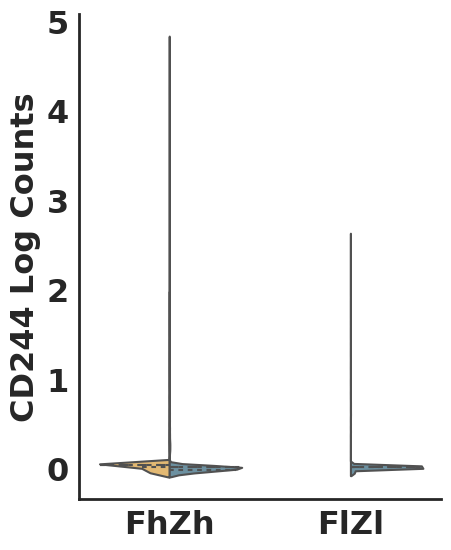

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


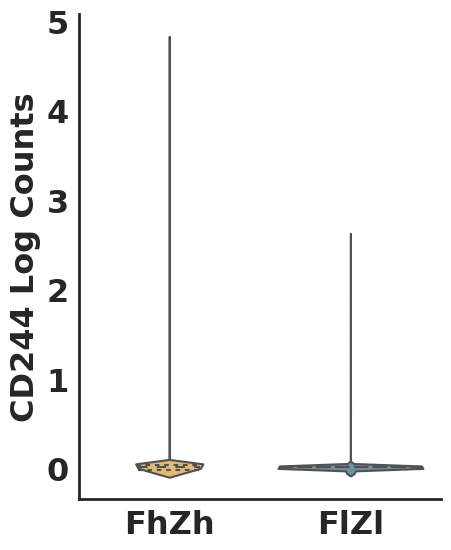

Mann-Whitney U test for BTLA with FhZh vs FlZl: U-statistic = 39402648.5, p-value = 9.007531873677784e-28


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


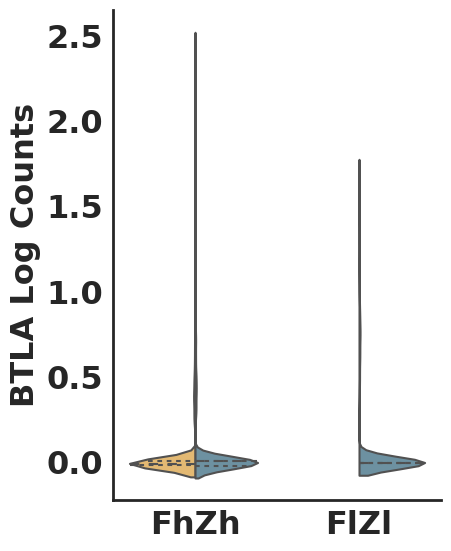

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


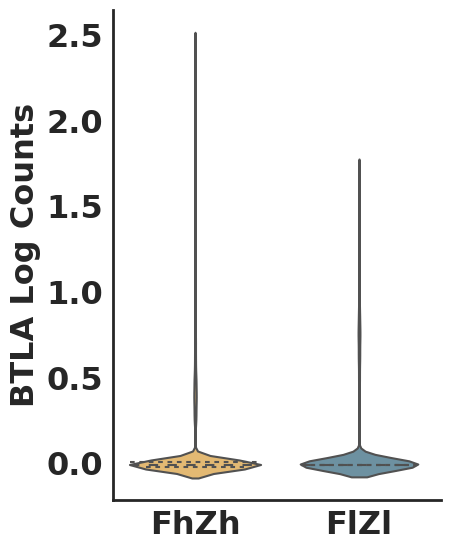

Mann-Whitney U test for CD274 with FhZh vs FlZl: U-statistic = 24384779.5, p-value = 0.0


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


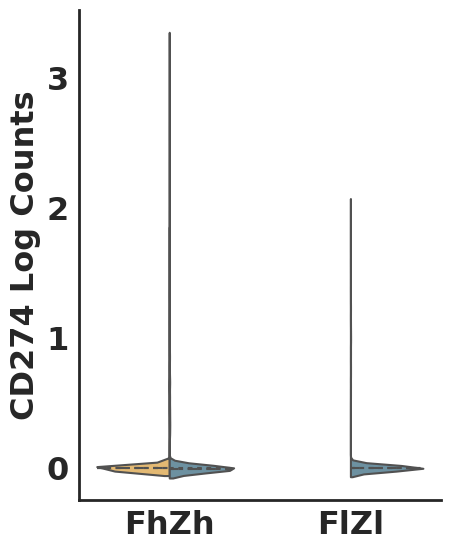

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


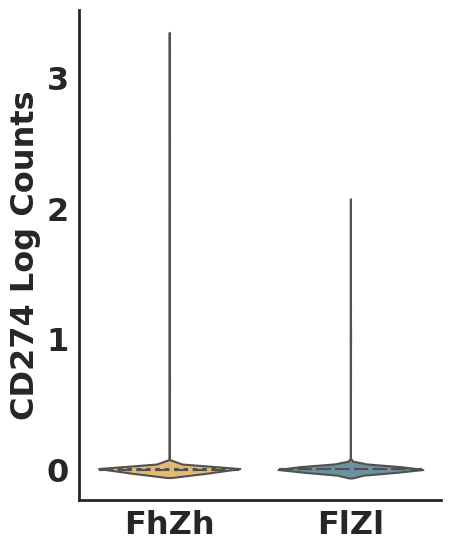

Mann-Whitney U test for PDCD1 with FhZh vs FlZl: U-statistic = 47362878.0, p-value = 1.9538947667096843e-25


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


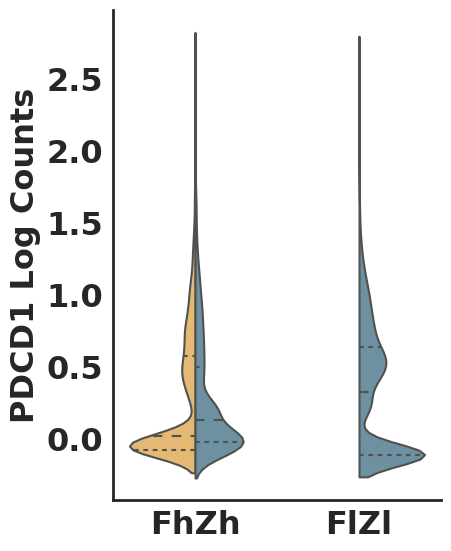

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


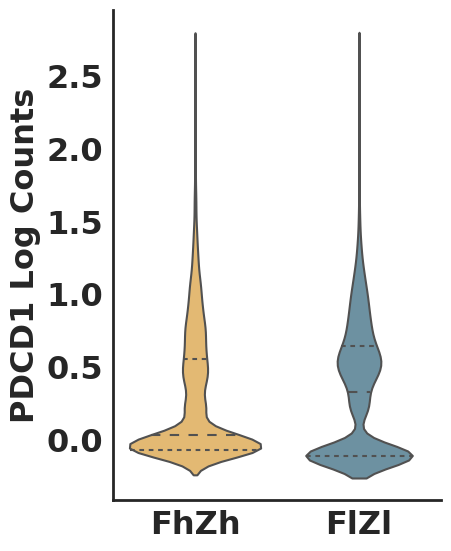

Mann-Whitney U test for HAVCR2 with FhZh vs FlZl: U-statistic = 54134055.5, p-value = 2.0198104539234318e-178


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


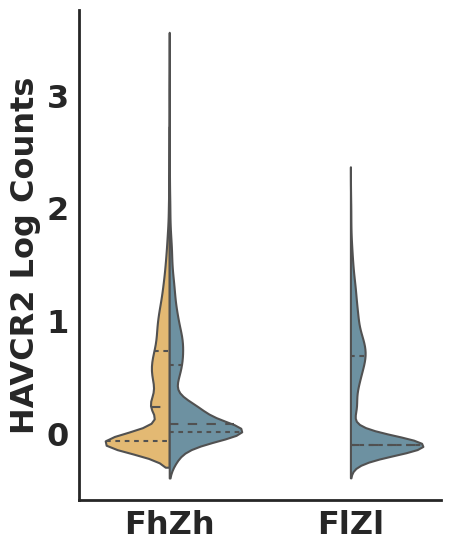

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


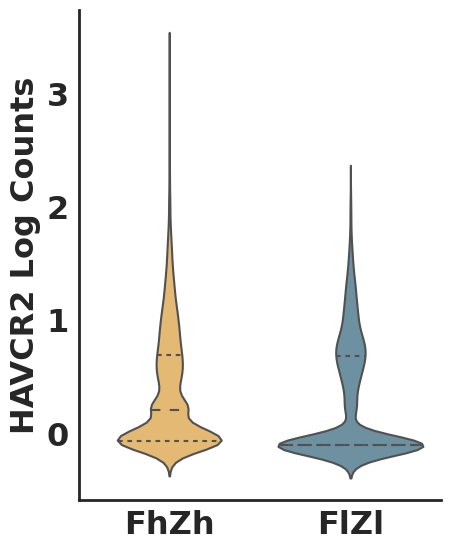

Mann-Whitney U test for TIGIT with FhZh vs FlZl: U-statistic = 50226578.5, p-value = 4.1980403722614365e-73


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


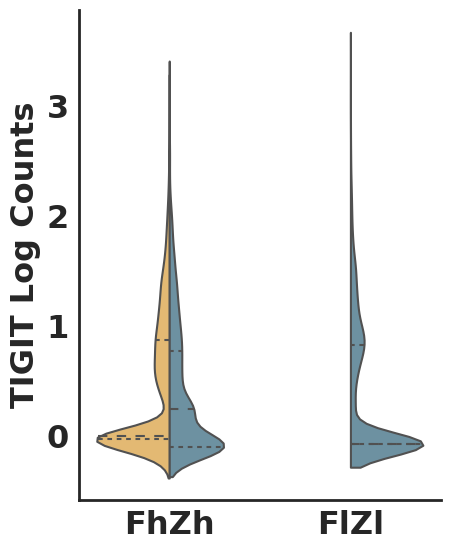

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


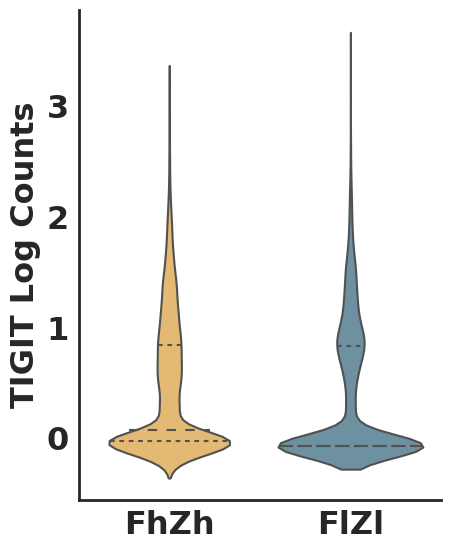

Mann-Whitney U test for IL2RA with FhZh vs FlZl: U-statistic = 44676815.5, p-value = 0.0009427329360901307


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


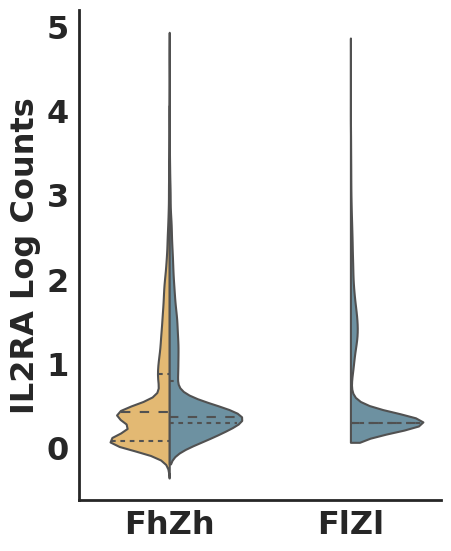

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


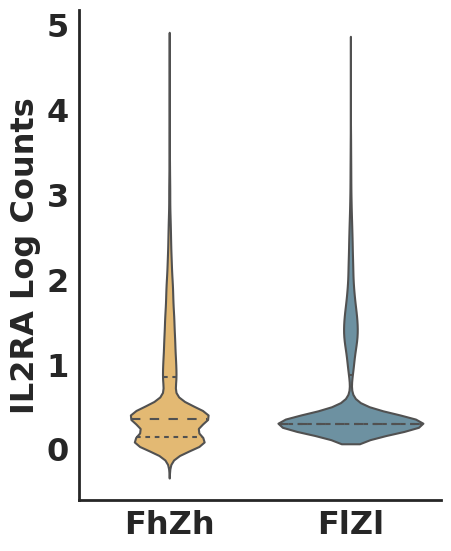

Mann-Whitney U test for CD38 with FhZh vs FlZl: U-statistic = 34480300.0, p-value = 9.441731725456463e-128


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


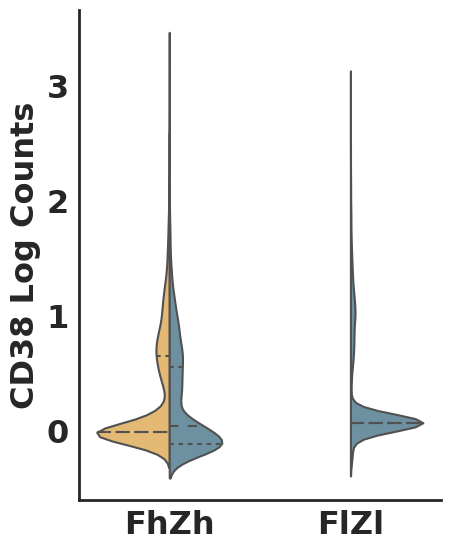

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


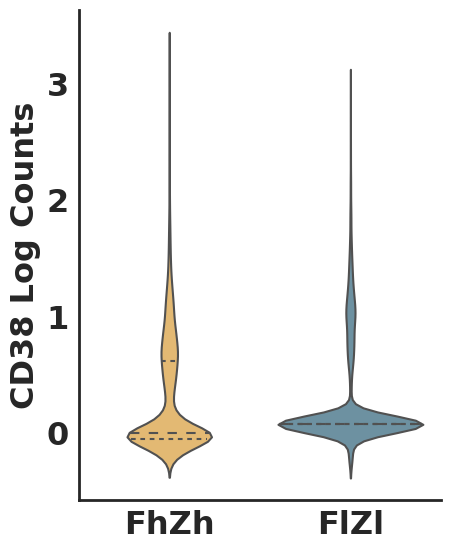

Mann-Whitney U test for MKI67 with FhZh vs FlZl: U-statistic = 42912501.0, p-value = 0.15742309669588317


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


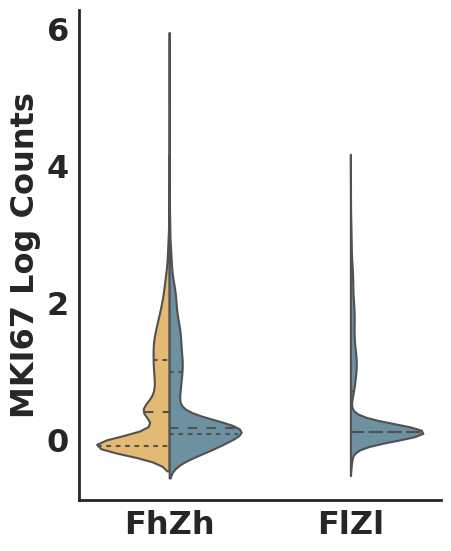

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


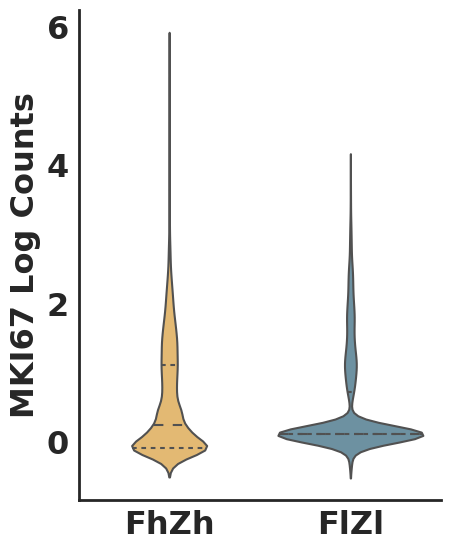

Mann-Whitney U test for PRDM1 with FhZh vs FlZl: U-statistic = 50768942.5, p-value = 4.477953449364051e-85


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


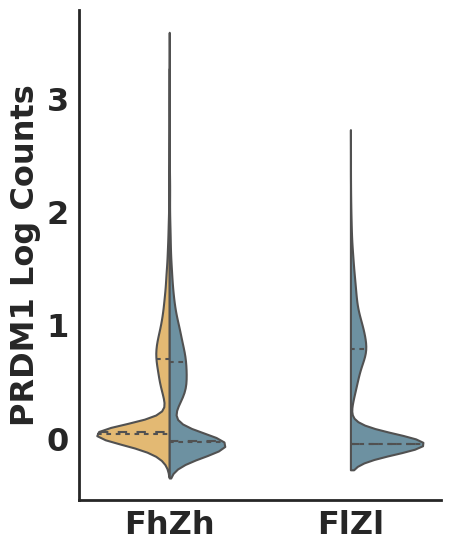

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


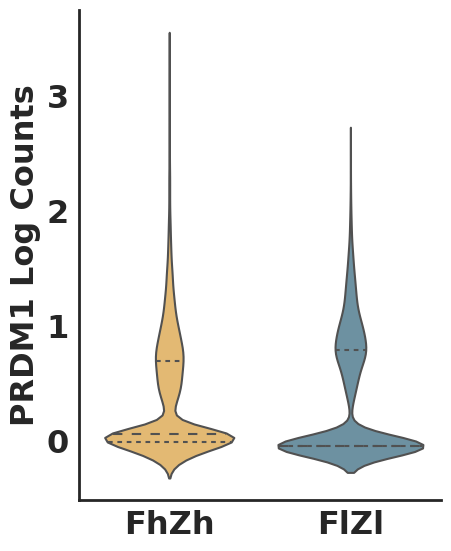

Mann-Whitney U test for EOMES with FhZh vs FlZl: U-statistic = 63403549.5, p-value = 0.0


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


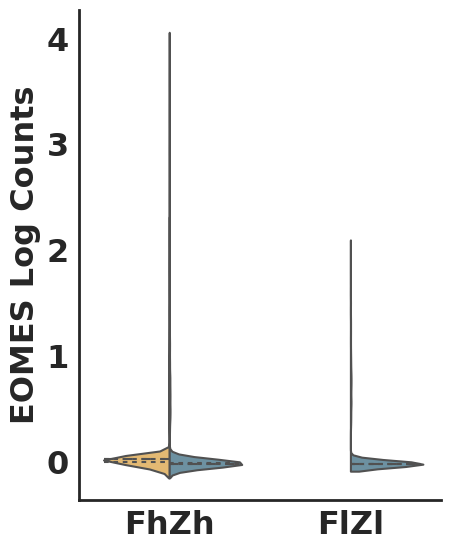

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


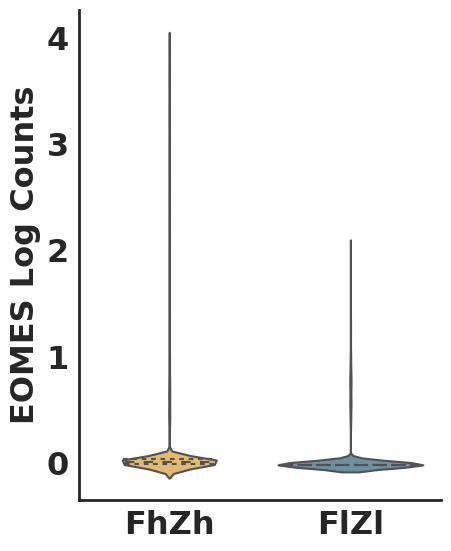

Mann-Whitney U test for IKZF2 with FhZh vs FlZl: U-statistic = 58542417.5, p-value = 0.0


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


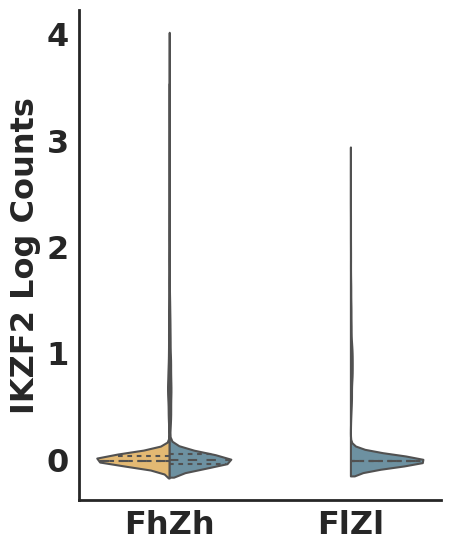

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


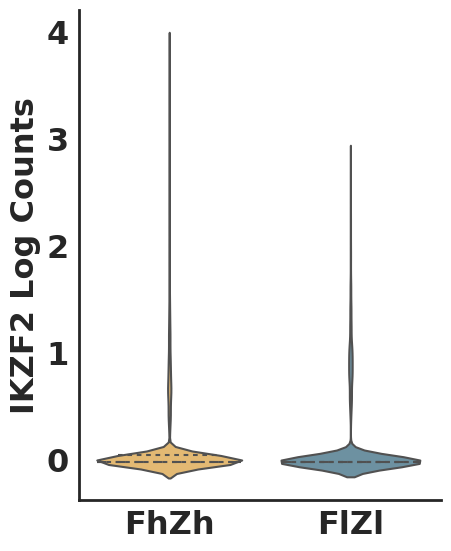

Mann-Whitney U test for TBX21 with FhZh vs FlZl: U-statistic = 51901534.5, p-value = 3.1252786898970027e-112


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


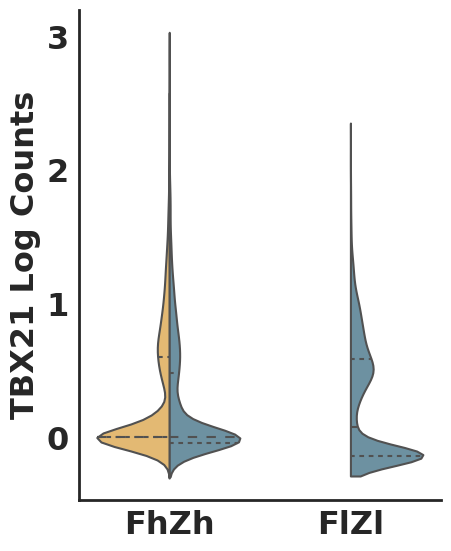

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


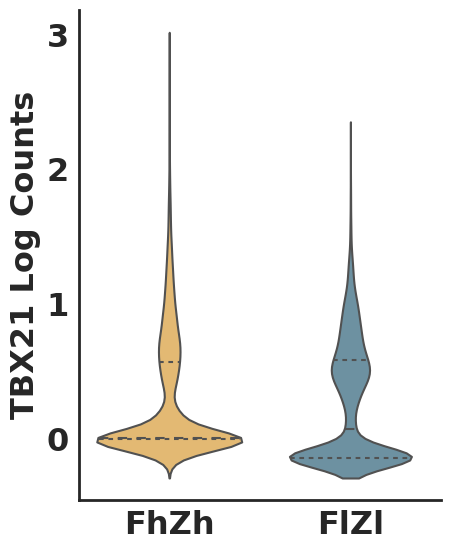

Mann-Whitney U test for B3GAT1 with FhZh vs FlZl: U-statistic = 35710539.0, p-value = 3.5520229290457726e-98


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


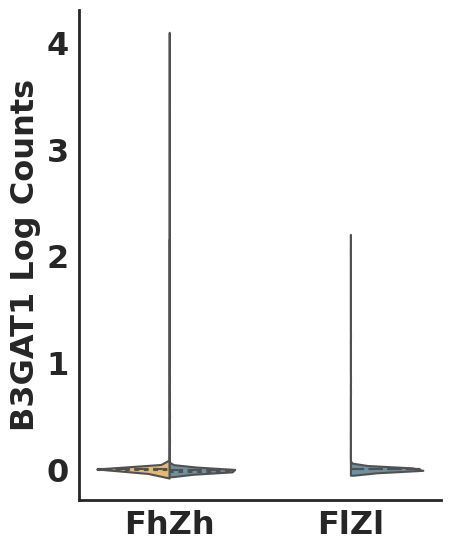

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


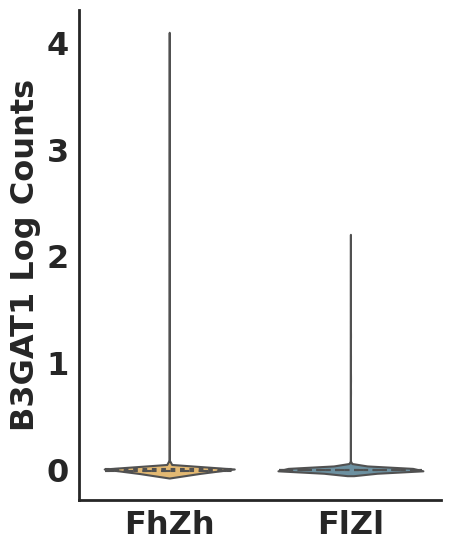

Bonferroni corrected p-value for IL2RB: 9.451704278105753e-53
Bonferroni corrected p-value for IL7R: 1.9559151656294347e-75
Bonferroni corrected p-value for CXCR3: 0.08127895343421332
Bonferroni corrected p-value for CCR7: 1.0
Bonferroni corrected p-value for CD27: 1.3953165256940682e-05
Bonferroni corrected p-value for CD28: 0.0022091734649393197
Bonferroni corrected p-value for TNFRSF4: 1.6890991228097153e-09
Bonferroni corrected p-value for TNFRSF9: 0.0
Bonferroni corrected p-value for ICOS: 0.0009582702719713265
Bonferroni corrected p-value for ENTPD1: 4.792300131697261e-12
Bonferroni corrected p-value for CD101: 0.0
Bonferroni corrected p-value for CTLA4: 1.0
Bonferroni corrected p-value for LAG3: 0.6097616082686275
Bonferroni corrected p-value for CD244: 2.0311455928007614e-283
Bonferroni corrected p-value for BTLA: 2.4320336058930017e-26
Bonferroni corrected p-value for CD274: 0.0
Bonferroni corrected p-value for PDCD1: 5.275515870116148e-24
Bonferroni corrected p-value for HAVC

In [5]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import mannwhitneyu
from scipy.sparse import issparse

# Load combat-corrected dataset (for visualization)
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_combat_CD4 = adata_combat[adata_combat.obs['cell_type'] == 'CD4'].copy()
adata_combat_CR_NR = adata_combat_CD4[(adata_combat_CD4.obs['response'] == 'CR') | (adata_combat_CD4.obs['response'] == 'NR')].copy()

# Define the gene list for marker comparison
genes = [
    "IL2RB",  # CD122 (IL2Rβ)
    "IL7R",   # CD127 (IL7Rα)
    "CXCR3",  # CD183 (CXCR3)
    "CCR7",   # CD197 (CCR7)
    # Co-stimulatory receptors
    "CD27",   # CD27
    "CD28",   # CD28
    "TNFRSF4",# CD134 (OX40)
    "TNFRSF9",# CD137 (4-1BB)
    "ICOS",   # CD278 (ICOS)
    # Exhaustion markers
    "ENTPD1", # CD39
    "CD101",  # CD101
    "CTLA4",  # CD152 (CTLA4)
    "LAG3",   # CD223 (LAG3)
    "CD244",  # CD244 (2B4)
    "BTLA",   # CD272 (BTLA)
    "CD274",  # CD274 (PD-L1)
    "PDCD1",  # CD279 (PD1)
    "HAVCR2", # CD366 (TIM3)
    "TIGIT",  # TIGIT
    # Activation markers
    "IL2RA",  # CD25 (IL2Rα)
    "CD38",   # CD38 (ADPRC1)
    # Proliferation marker
    "MKI67",  # Ki-67
    # Transcription factors
    "PRDM1",  # Blimp-1
    "EOMES",  # Eomes
    "IKZF2",  # Helios
    "TBX21",  # T-bet
    # Senescence marker
    "B3GAT1"  # CD57
]

# Identify JUND+ and ZNF683+ populations using log-transformed data
primary_gene_1 = "FCER1G"
primary_gene_2 = "ZNF683"

# Calculate the 25% quantile of both genes' expression
JUND_CR_NR = adata_combat_CR_NR[:, primary_gene_1].X.toarray().flatten() if issparse(adata_combat_CR_NR.X) else adata_combat_CR_NR[:, primary_gene_1].X.flatten()
ZNF683_CR_NR = adata_combat_CR_NR[:, primary_gene_2].X.toarray().flatten() if issparse(adata_combat_CR_NR.X) else adata_combat_CR_NR[:, primary_gene_2].X.flatten()
mask_JUND_positive_25perct = np.quantile(JUND_CR_NR, 0.25)
mask_ZNF683_positive_25perct = np.quantile(ZNF683_CR_NR, 0.25)
mask_JUND_ZNF683_positive = (JUND_CR_NR > mask_JUND_positive_25perct) & (ZNF683_CR_NR > mask_ZNF683_positive_25perct)  # JUND+ZNF683+
adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'] = np.where(mask_JUND_ZNF683_positive, 'FhZh', 'FlZl')
adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'] = adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'].astype('category')

# Convert data to a DataFrame for plotting
df = adata_combat_CR_NR.to_df()
df[f'{primary_gene_1}_{primary_gene_2}_positive'] = adata_combat_CR_NR.obs[f'{primary_gene_1}_{primary_gene_2}_positive'].values
df['response'] = adata_combat_CR_NR.obs['response'].values  # add response labels

# Set the order for the x-axis categories to ensure JUND+ZNF683+ appears first
category_order = ['FhZh', 'FlZl']

# Initialize a list to store p-values for Bonferroni correction
p_values = []

# Loop through each gene in the list and compare its expression between JUND+ZNF683+ and JUND-ZNF683- cells
plt.rcParams['font.weight'] = 'bold'
plt.rcParams['font.size'] = 23
plt.rcParams['axes.linewidth'] = 2
plt.rcParams['axes.labelweight'] = 'bold'
plt.rcParams['xtick.major.width'] = 2
plt.rcParams['ytick.major.width'] = 2

for gene in genes:
    if gene in adata_combat_CR_NR.var_names:
        df['value'] = adata_combat_CR_NR[:, adata_combat_CR_NR.var_names == gene].X.toarray().flatten()

        # Separate values for cells expressing JUND+ZNF683+ (J+Z+) and not (J-Z-)
        group_positive = df[df[f'{primary_gene_1}_{primary_gene_2}_positive'] == 'FhZh']['value']
        group_negative = df[df[f'{primary_gene_1}_{primary_gene_2}_positive'] == 'FlZl']['value']

        # Perform Mann-Whitney U test to compare J+Z+ and J-Z-
        stat, p_value = mannwhitneyu(group_positive, group_negative, alternative='two-sided')
        p_values.append(p_value)
        print(f"Mann-Whitney U test for {gene} with FhZh vs FlZl: U-statistic = {stat}, p-value = {p_value}")

        # Create the violin plot using seaborn, split by JUND_ZNF683 expression
        plt.figure(figsize=(5, 6))
        sns.violinplot(data=df, x=f'{primary_gene_1}_{primary_gene_2}_positive', y='value', hue='response', split=True, inner="quart", palette=["#F6BD60", '#6494AA'], order=category_order)
        sns.despine()  # Remove the top and right spines

        # Remove the legend and customize the plot
        plt.legend([], [], frameon=False)
        plt.title(f'')
        plt.xlabel('')
        plt.ylabel(f'{gene} Log Counts')
        plt.tight_layout()

        # Display the plot
        plt.show()

        plt.figure(figsize=(5, 6))
        sns.violinplot(data=df, x=f'{primary_gene_1}_{primary_gene_2}_positive', y='value', inner="quart", palette=["#F6BD60", '#6494AA'], order=category_order)
        #sns.stripplot(data=df, x=f'{primary_gene}_positive', y='value', hue='response', dodge=True, palette=["black"], order=category_order, jitter=True, size=4, alpha=0.5)
        sns.despine()  # Remove the top and right spines

        # Remove the legend
        plt.legend([], [], frameon=False)
        # Customize the plot
        plt.title(f'')
        plt.xlabel('')
        plt.ylabel(f'{gene} Log Counts')
        plt.tight_layout()

        # Save or display the plot
        #plt.savefig(f'/home/emma/result/CART/violinplot_JUND/{primary_gene}_{gene}_violinplot.png')
        plt.show()
    else:
        print(f"{gene} is not present in the variable names. Please check your adata object.")

# Apply Bonferroni correction
bonferroni_corrected_p_values = np.minimum(np.array(p_values) * len(genes), 1.0)

# Print corrected p-values
for gene, corrected_p_value in zip(genes, bonferroni_corrected_p_values):
    print(f"Bonferroni corrected p-value for {gene}: {corrected_p_value}")


In [12]:
# Load combat-corrected dataset (for visualization)
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_combat_CD4 = adata_combat[adata_combat.obs['cell_type'] == 'CD4'].copy()
adata_combat_CR_NR = adata_combat_CD4[(adata_combat_CD4.obs['response'] == 'CR') | (adata_combat_CD4.obs['response'] == 'NR')].copy()
gene_expression_NR = adata_combat_CR_NR[:, primary_gene].X.toarray().flatten() if issparse(adata_combat_CR_NR.X) else adata_combat_CR_NR[:, primary_gene].X.flatten()
mask_jund_positive_25perct = np.quantile(gene_expression_NR, 0.25)
mask_jund_positive_25perct 

0.7975020679226194

In [11]:
# Load combat-corrected dataset (for visualization)
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_combat_CD4 = adata_combat[adata_combat.obs['cell_type'] == 'CD8'].copy()
adata_combat_CR_NR = adata_combat_CD4[(adata_combat_CD4.obs['response'] == 'CR') | (adata_combat_CD4.obs['response'] == 'NR')].copy()
gene_expression_NR = adata_combat_CR_NR[:, 'CD81'].X.toarray().flatten() if issparse(adata_combat_CR_NR.X) else adata_combat_CR_NR[:, primary_gene].X.flatten()
mask_jund_positive_25perct = np.quantile(gene_expression_NR, 0.25)
mask_jund_positive_25perct 

0.6131020689215452

Wilcoxon test for PDCD1 with FCER1G & ZNF683: U-statistic = 5620471.5, p-value = 0.015459961754484183


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


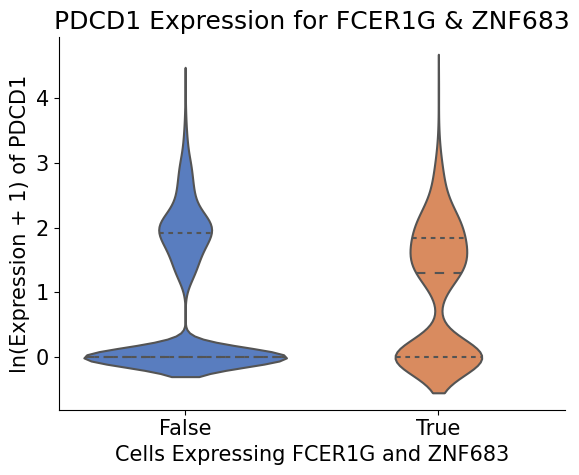

Wilcoxon test for HAVCR2 with FCER1G & ZNF683: U-statistic = 5703667.5, p-value = 0.0015213763037632277


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


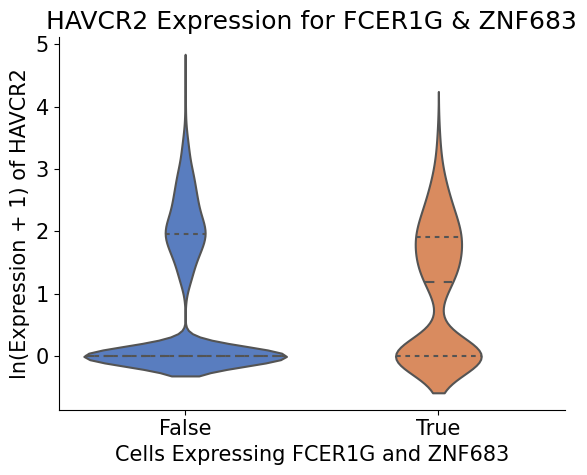

Wilcoxon test for LAG3 with FCER1G & ZNF683: U-statistic = 5305916.5, p-value = 0.8541447653623383


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


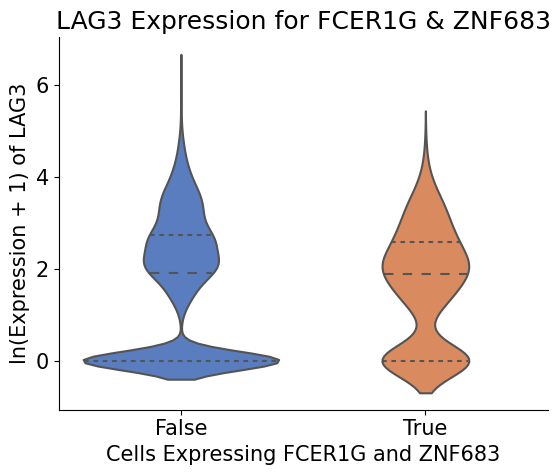

Wilcoxon test for TIGIT with FCER1G & ZNF683: U-statistic = 5289566.5, p-value = 0.7371518446411625


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


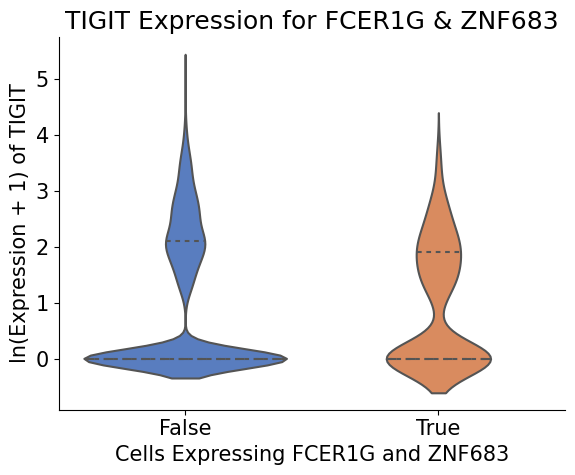

Wilcoxon test for SLAMF6 with FCER1G & ZNF683: U-statistic = 5724581.5, p-value = 0.0013562234205178906


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


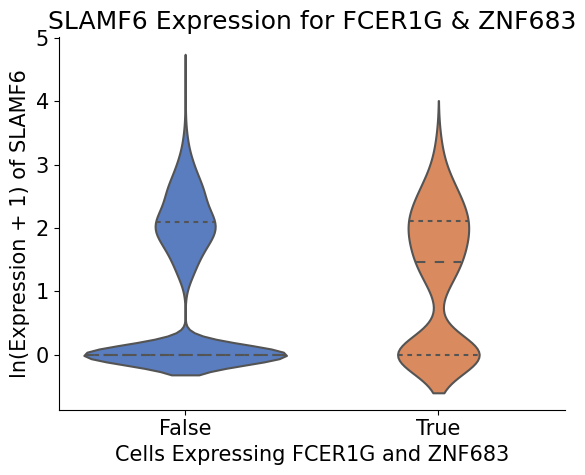

Wilcoxon test for IL7R with FCER1G & ZNF683: U-statistic = 5308738.5, p-value = 0.8730802863872924


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


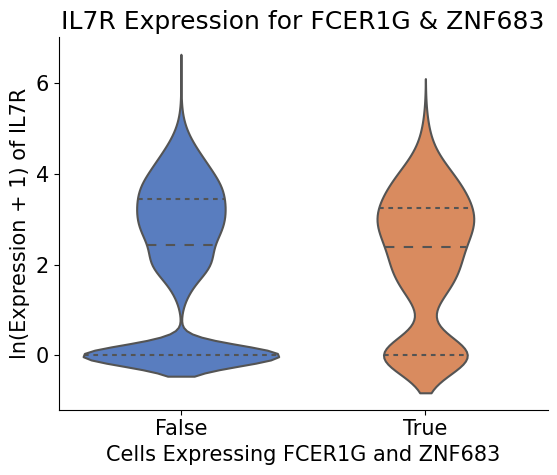

Wilcoxon test for PDCD1 with JUND & TLE5: U-statistic = 46430575.5, p-value = 1.2668846393488297e-10


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


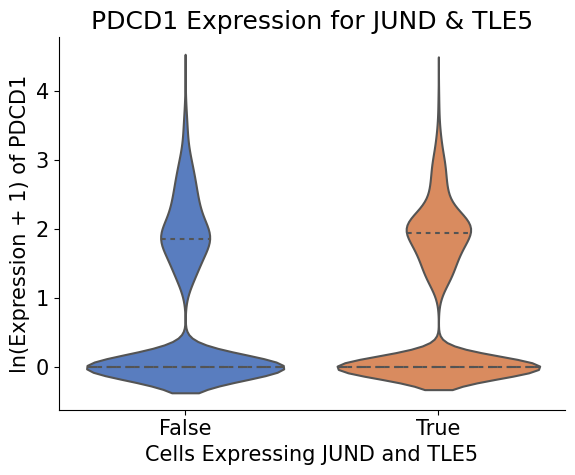

Wilcoxon test for HAVCR2 with JUND & TLE5: U-statistic = 40378005.5, p-value = 2.1254497018235165e-29


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


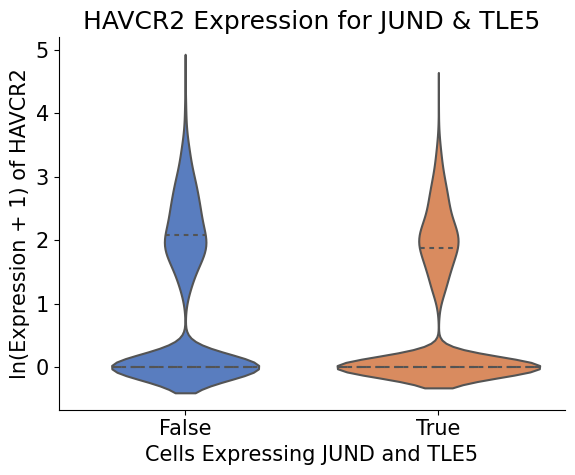

Wilcoxon test for LAG3 with JUND & TLE5: U-statistic = 39708928.5, p-value = 3.518115341362457e-34


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


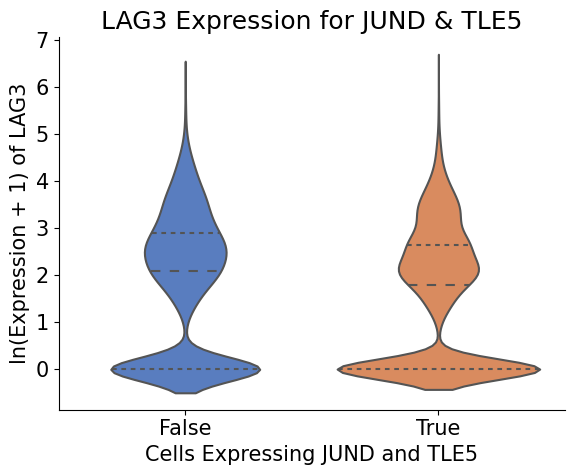

Wilcoxon test for TIGIT with JUND & TLE5: U-statistic = 40746030.0, p-value = 5.310774913546593e-24


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


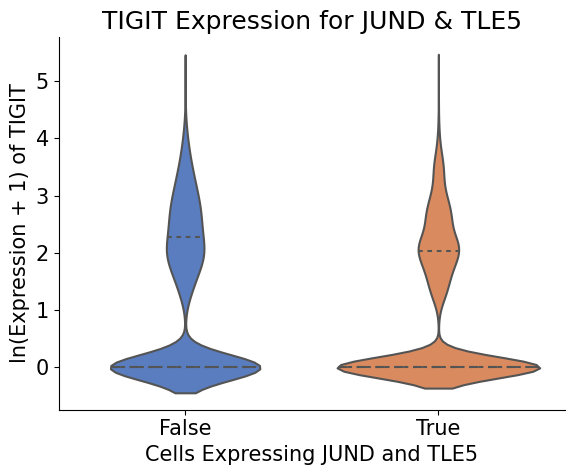

Wilcoxon test for SLAMF6 with JUND & TLE5: U-statistic = 42387004.5, p-value = 3.099472859533894e-07


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


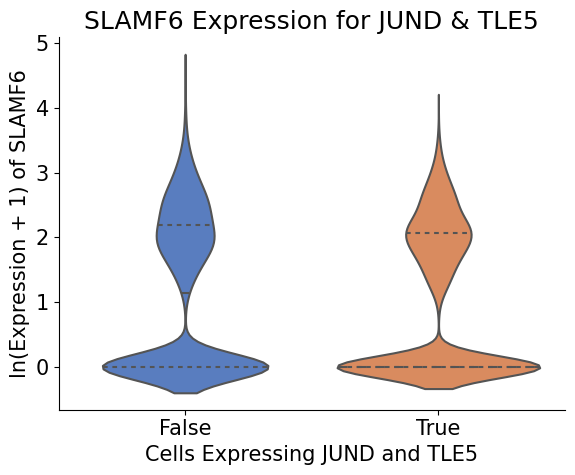

Wilcoxon test for IL7R with JUND & TLE5: U-statistic = 50107454.5, p-value = 2.976707314661519e-56


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


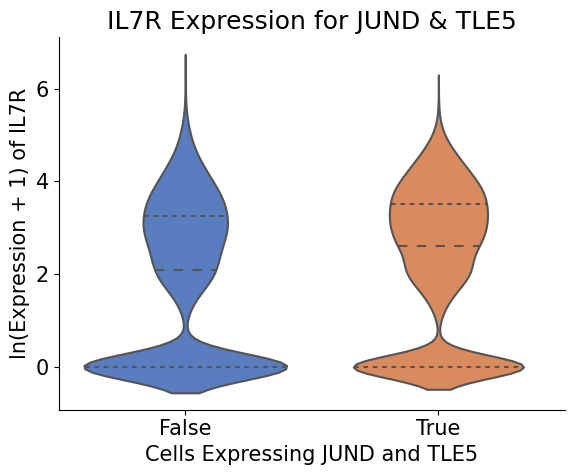

Wilcoxon test for PDCD1 with FCER1G & LFNG: U-statistic = 20842461.0, p-value = 1.1953459124667767e-13


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


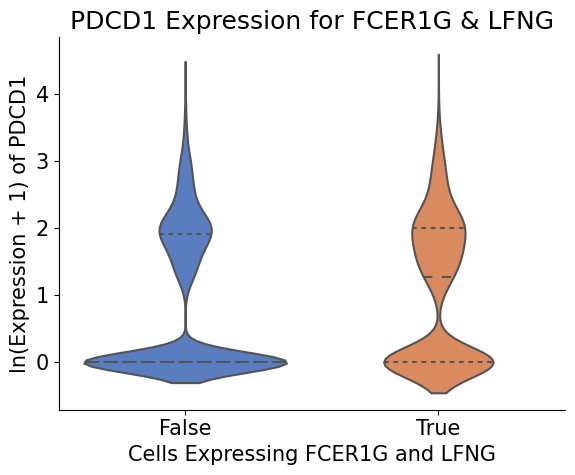

Wilcoxon test for HAVCR2 with FCER1G & LFNG: U-statistic = 20739526.5, p-value = 1.314217708448362e-12


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


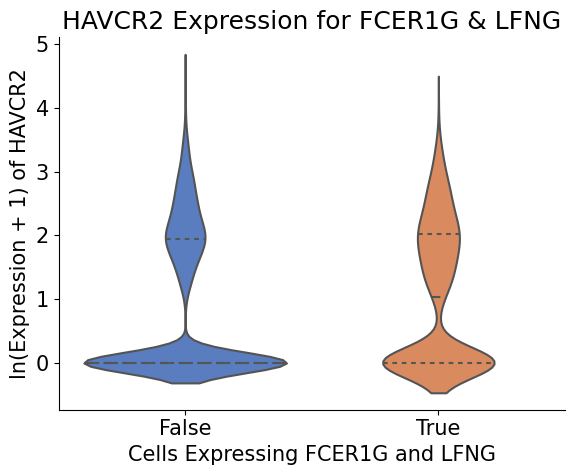

Wilcoxon test for LAG3 with FCER1G & LFNG: U-statistic = 20403286.5, p-value = 2.575579515840657e-07


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


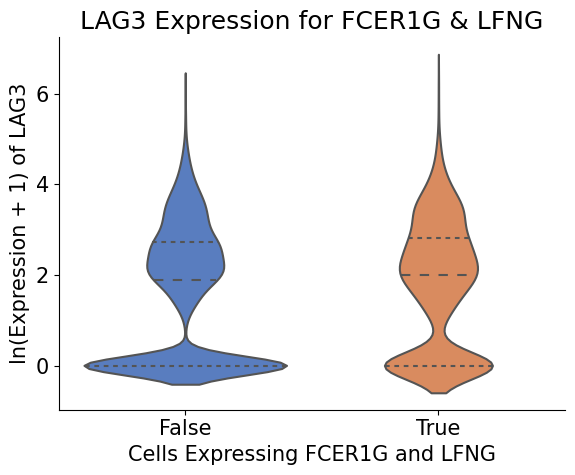

Wilcoxon test for TIGIT with FCER1G & LFNG: U-statistic = 17759794.0, p-value = 6.351600137580613e-10


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


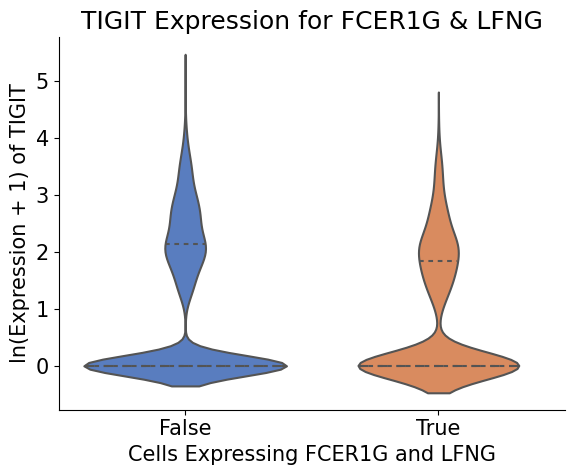

Wilcoxon test for SLAMF6 with FCER1G & LFNG: U-statistic = 18763525.0, p-value = 0.09610989757701377


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


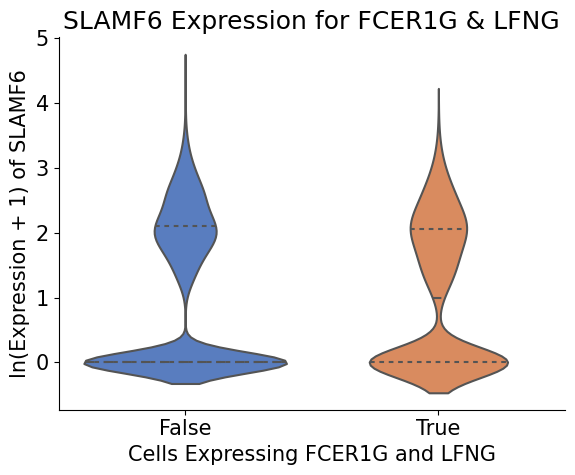

Wilcoxon test for IL7R with FCER1G & LFNG: U-statistic = 18554903.0, p-value = 0.015065833316037402


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


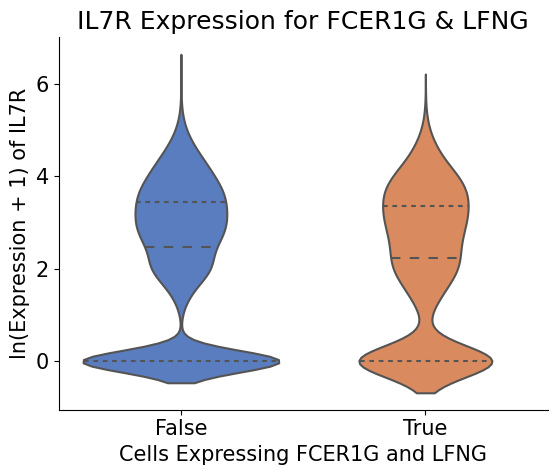

Wilcoxon test for PDCD1 with JUND & TSC22D3: U-statistic = 49767365.0, p-value = 3.3628007838258096e-05


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


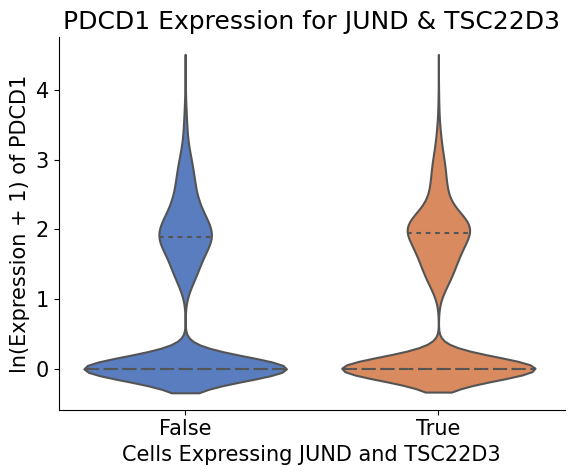

Wilcoxon test for HAVCR2 with JUND & TSC22D3: U-statistic = 44049495.5, p-value = 1.5994291856721525e-32


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


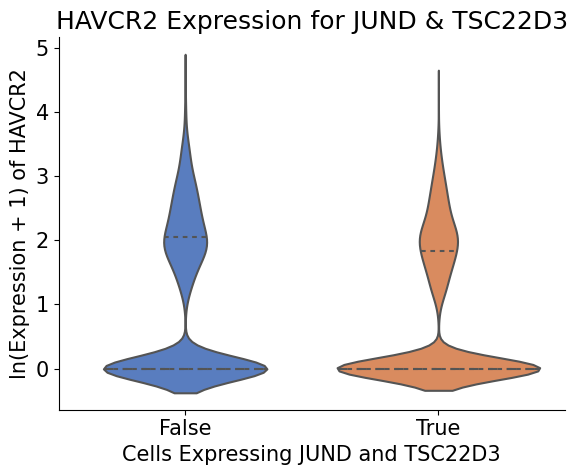

Wilcoxon test for LAG3 with JUND & TSC22D3: U-statistic = 42332114.0, p-value = 1.6117400688372162e-53


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


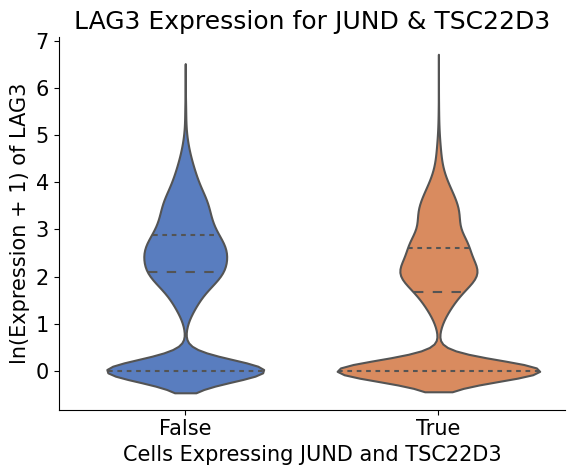

Wilcoxon test for TIGIT with JUND & TSC22D3: U-statistic = 45901057.0, p-value = 3.703486559121732e-11


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


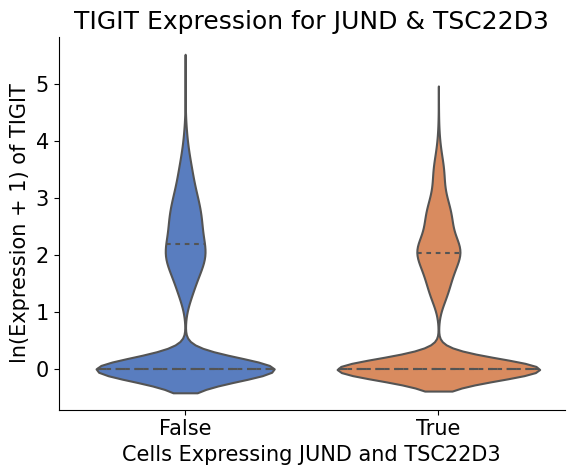

Wilcoxon test for SLAMF6 with JUND & TSC22D3: U-statistic = 46925667.5, p-value = 0.00030051563632301474


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


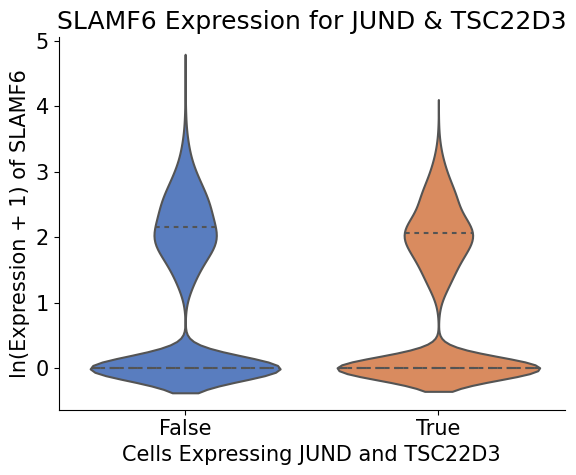

Wilcoxon test for IL7R with JUND & TSC22D3: U-statistic = 54873261.5, p-value = 2.9732618986522173e-64


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


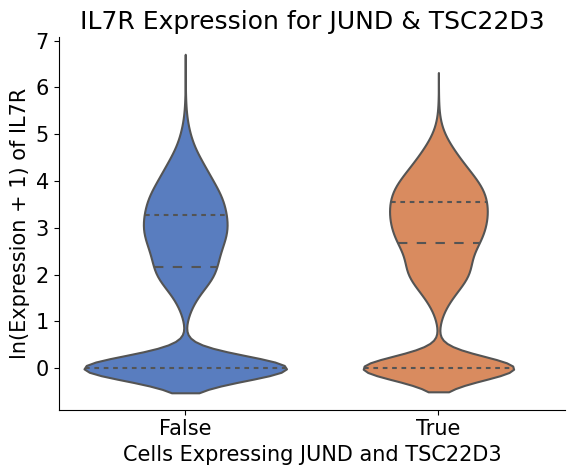

Wilcoxon test for PDCD1 with ZNF683 & TLE5: U-statistic = 18112131.5, p-value = 0.0003088965072627415


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


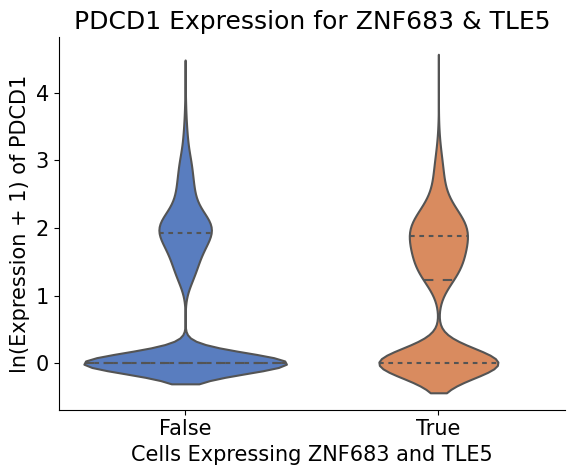

Wilcoxon test for HAVCR2 with ZNF683 & TLE5: U-statistic = 17305104.5, p-value = 0.9059231833411981


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


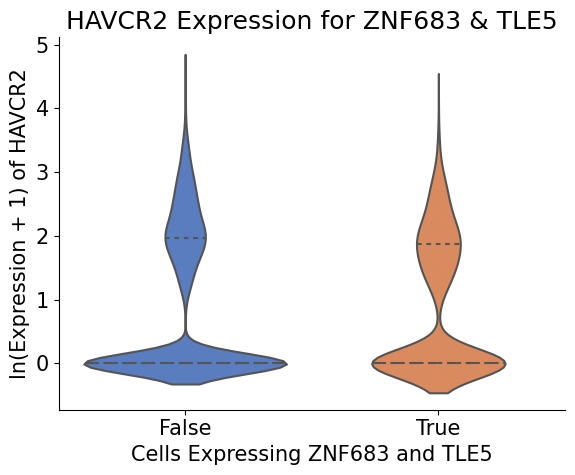

Wilcoxon test for LAG3 with ZNF683 & TLE5: U-statistic = 16187427.5, p-value = 7.459201193971883e-07


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


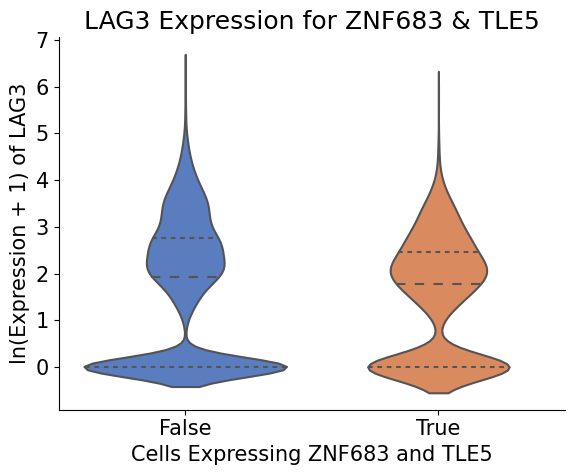

Wilcoxon test for TIGIT with ZNF683 & TLE5: U-statistic = 16839535.0, p-value = 0.022045165735114756


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


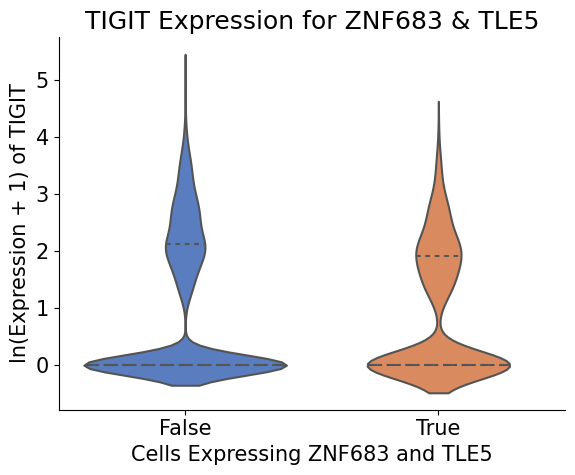

Wilcoxon test for SLAMF6 with ZNF683 & TLE5: U-statistic = 19146473.0, p-value = 3.1724249272046024e-16


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


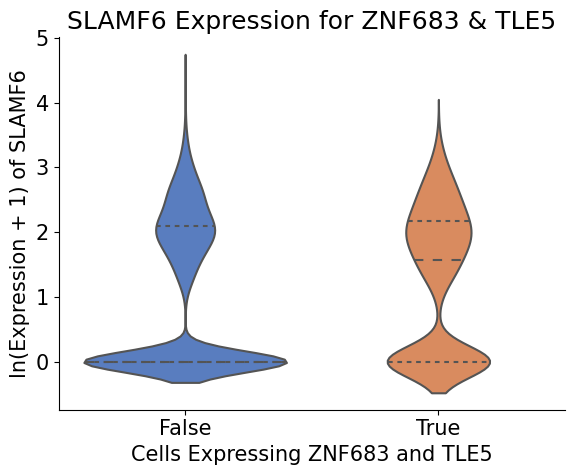

Wilcoxon test for IL7R with ZNF683 & TLE5: U-statistic = 18612682.0, p-value = 4.1768192908917706e-08


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


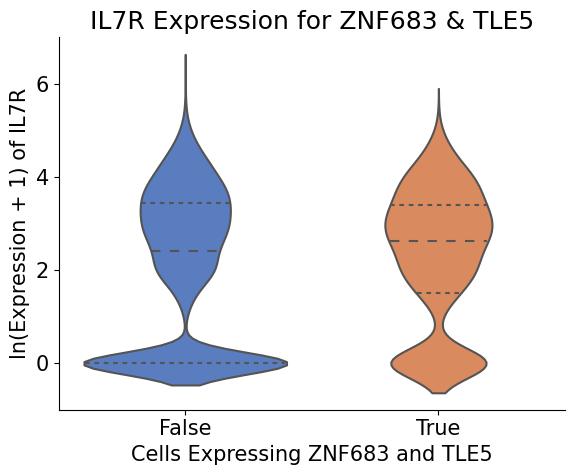

Wilcoxon test for PDCD1 with JUND & ZNF683: U-statistic = 15941448.5, p-value = 8.265932338147787e-05


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


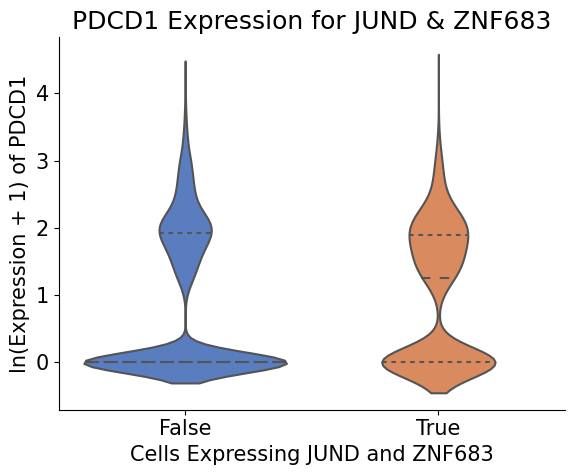

Wilcoxon test for HAVCR2 with JUND & ZNF683: U-statistic = 14815743.0, p-value = 0.0990264160279184


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


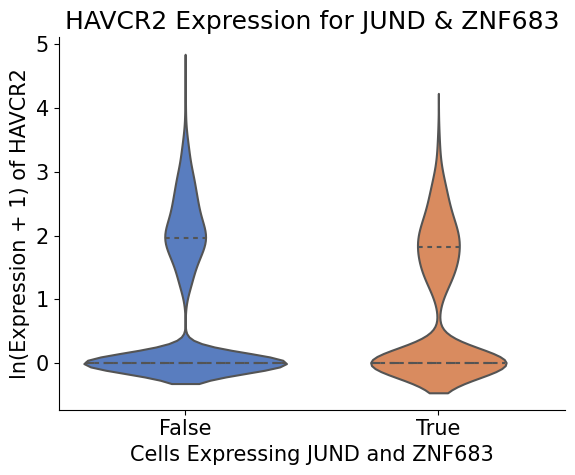

Wilcoxon test for LAG3 with JUND & ZNF683: U-statistic = 13881952.5, p-value = 5.029236761443481e-09


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


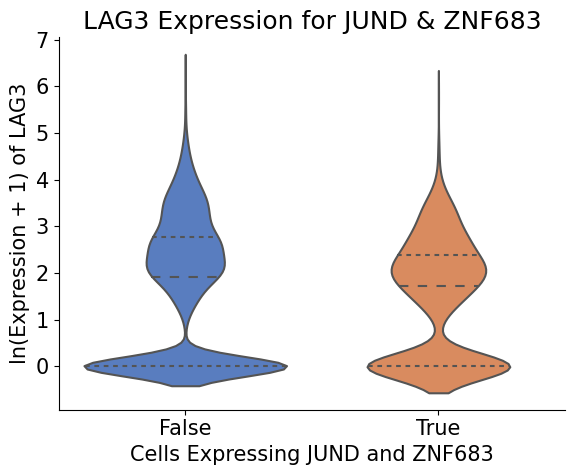

Wilcoxon test for TIGIT with JUND & ZNF683: U-statistic = 14763273.0, p-value = 0.05743723412029717


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


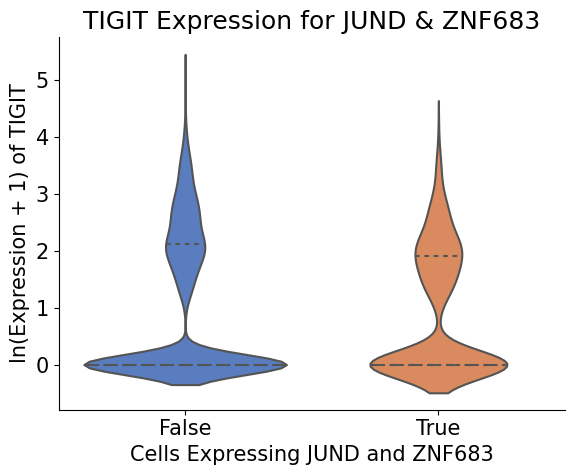

Wilcoxon test for SLAMF6 with JUND & ZNF683: U-statistic = 16636835.5, p-value = 6.919071497384393e-13


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


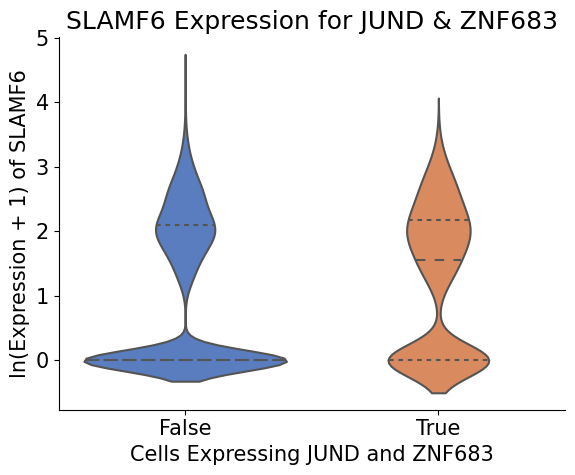

Wilcoxon test for IL7R with JUND & ZNF683: U-statistic = 16402650.5, p-value = 8.55099958421748e-09


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


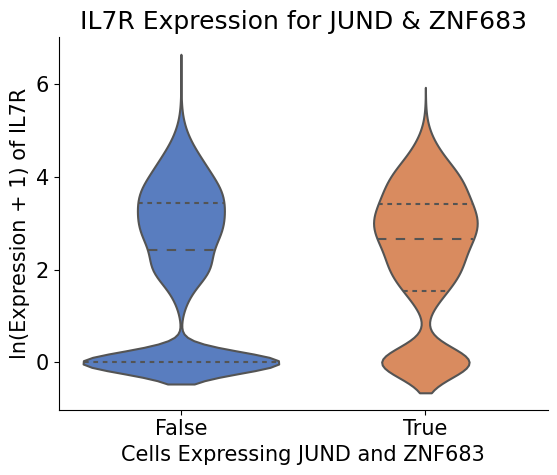

In [15]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
from scipy.stats import mannwhitneyu

# Load log-transformed dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()
adata_CR_NR = adata_CD4[(adata_log_CD4.obs['response'] == 'CR') | (adata_log_CD4.obs['response'] == 'NR')].copy()

# Define gene list and gene pairs
gene_pairs = [
    ("FCER1G", "ZNF683"),
    ("JUND", "TLE5"),
    ("FCER1G", "LFNG"),
    ("JUND", "TSC22D3"),
    ("ZNF683", "TLE5"),
    ("JUND", "ZNF683")
]

# Prepare to store results
genes = ['PDCD1', 'HAVCR2', 'LAG3', 'TIGIT', 'SLAMF6', 'IL7R']

for gene1, gene2 in gene_pairs:
    # Create a mask for cells that express both gene1 and gene2
    mask = (adata_log_CR_NR[:, gene1].X > 0) & (adata_log_CR_NR[:, gene2].X > 0)
    adata_log_CR_NR_both = adata_log_CR_NR[mask].copy()
    
    # Create a new column to indicate if cells express both gene pairs or neither
    adata_log_CR_NR.obs[f'both_{gene1}_{gene2}'] = adata_log_CR_NR.obs_names.isin(adata_log_CR_NR_both.obs_names)
    adata_log_CR_NR.obs[f'both_{gene1}_{gene2}'] = adata_log_CR_NR.obs[f'both_{gene1}_{gene2}'].astype('category')

    # Convert data to a DataFrame for plotting
    df = adata_log_CR_NR.to_df()
    df[f'both_{gene1}_{gene2}'] = adata_log_CR_NR.obs[f'both_{gene1}_{gene2}'].values

    # Generate violin plot and perform Wilcoxon rank-sum test for each gene
    for gene in genes:
        if gene in adata_log_CR_NR.var_names:
            df['value'] = adata_log_CR_NR[:, adata_log_CR_NR.var_names == gene].X.toarray().flatten()
            
            # Separate values for cells expressing both gene pairs and neither
            group_both = df[df[f'both_{gene1}_{gene2}'] == True]['value']
            group_neither = df[df[f'both_{gene1}_{gene2}'] == False]['value']
            
            # Perform Wilcoxon rank-sum test (Mann-Whitney U test since Wilcoxon requires paired samples)
            stat, p_value = mannwhitneyu(group_both, group_neither, alternative='two-sided')
            print(f"Wilcoxon test for {gene} with {gene1} & {gene2}: U-statistic = {stat}, p-value = {p_value}")

            # Create the violin plot using seaborn
            plt.figure(figsize=(6, 5))
            plt.rcParams.update({'font.size': 15})
            ax = sns.violinplot(data=df, x=f'both_{gene1}_{gene2}', y='value', inner="quart", palette="muted")
            sns.despine()  # Remove the top and right spines

            # Customize the plot
            plt.title(f'{gene} Expression for {gene1} & {gene2}')
            plt.xlabel(f'Cells Expressing {gene1} and {gene2}')
            plt.ylabel(f'ln(Expression + 1) of {gene}')
            plt.tight_layout()

            # Save or display the plot
            #plt.savefig(f'/home/emma/result/CART/violinplot_gene_pairs/{gene1}_{gene2}_{gene}_violinplot.png')
            plt.show()
        else:
            print(f"{gene} is not present in the variable names. Please check your adata object.")


Wilcoxon test for PDCD1 with FCER1G & ZNF683: U-statistic = 5620471.5, p-value = 0.015459961754484183


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


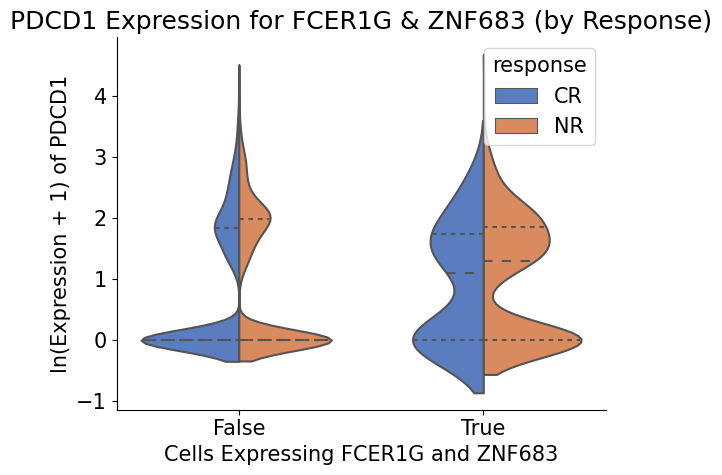

Wilcoxon test for HAVCR2 with FCER1G & ZNF683: U-statistic = 5703667.5, p-value = 0.0015213763037632277


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


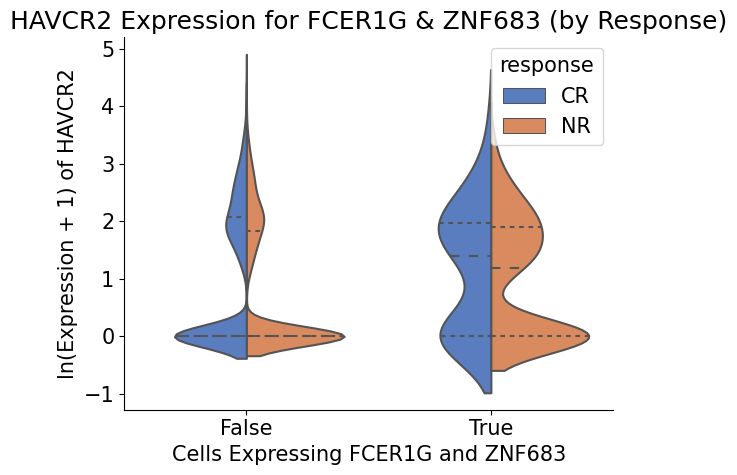

Wilcoxon test for LAG3 with FCER1G & ZNF683: U-statistic = 5305916.5, p-value = 0.8541447653623383


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


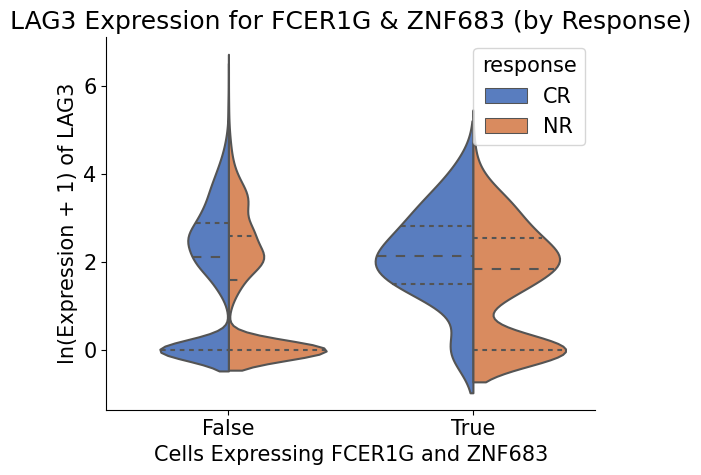

Wilcoxon test for TIGIT with FCER1G & ZNF683: U-statistic = 5289566.5, p-value = 0.7371518446411625


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


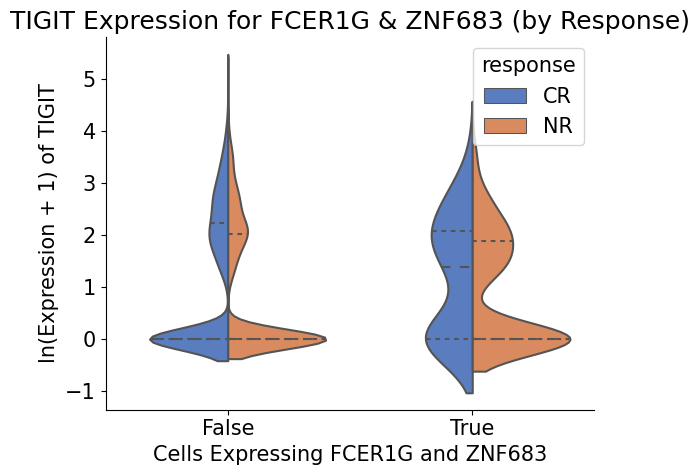

Wilcoxon test for SLAMF6 with FCER1G & ZNF683: U-statistic = 5724581.5, p-value = 0.0013562234205178906


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


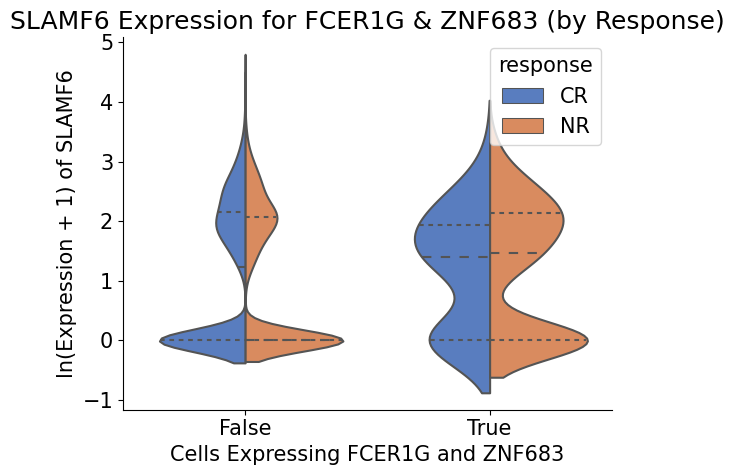

Wilcoxon test for IL7R with FCER1G & ZNF683: U-statistic = 5308738.5, p-value = 0.8730802863872924


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


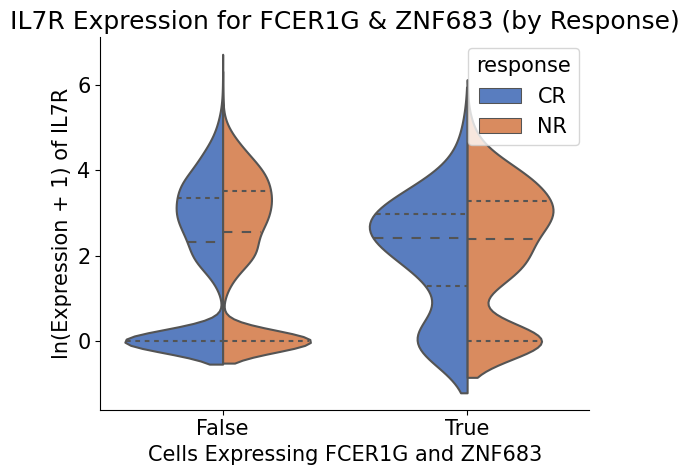

Wilcoxon test for PDCD1 with JUND & TLE5: U-statistic = 46430575.5, p-value = 1.2668846393488297e-10


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


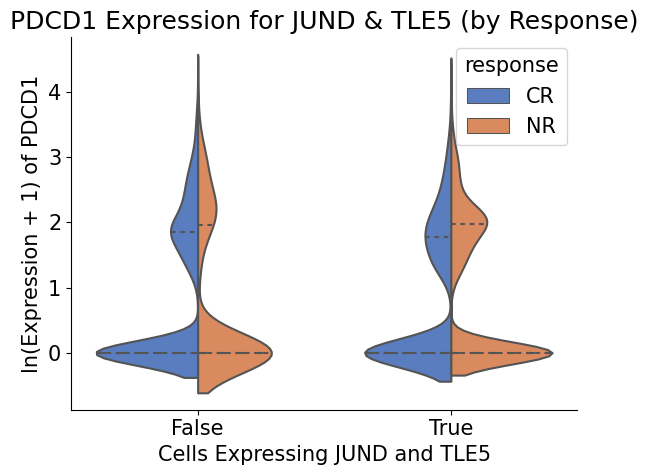

Wilcoxon test for HAVCR2 with JUND & TLE5: U-statistic = 40378005.5, p-value = 2.1254497018235165e-29


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


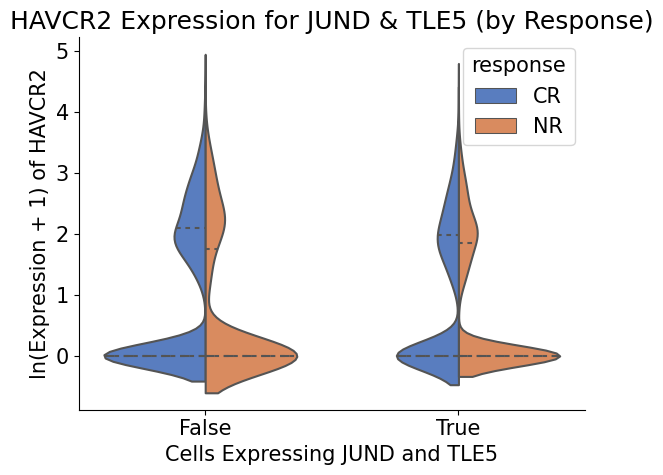

Wilcoxon test for LAG3 with JUND & TLE5: U-statistic = 39708928.5, p-value = 3.518115341362457e-34


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


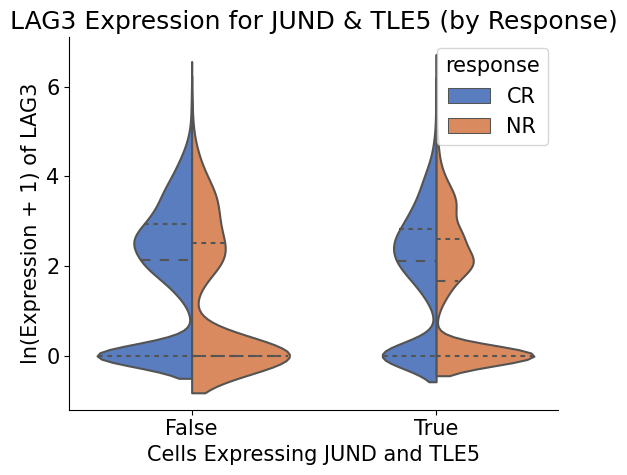

Wilcoxon test for TIGIT with JUND & TLE5: U-statistic = 40746030.0, p-value = 5.310774913546593e-24


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


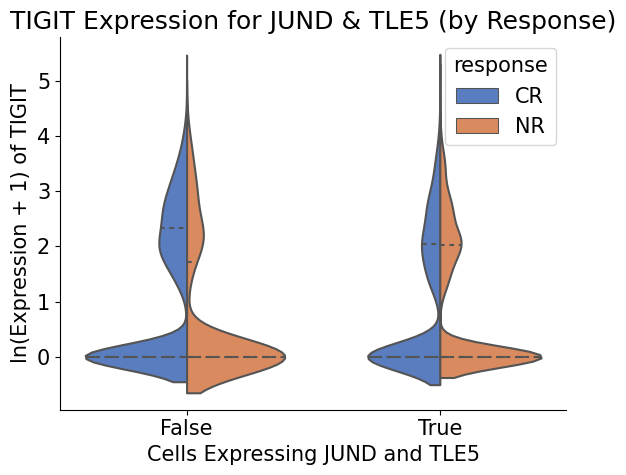

Wilcoxon test for SLAMF6 with JUND & TLE5: U-statistic = 42387004.5, p-value = 3.099472859533894e-07


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


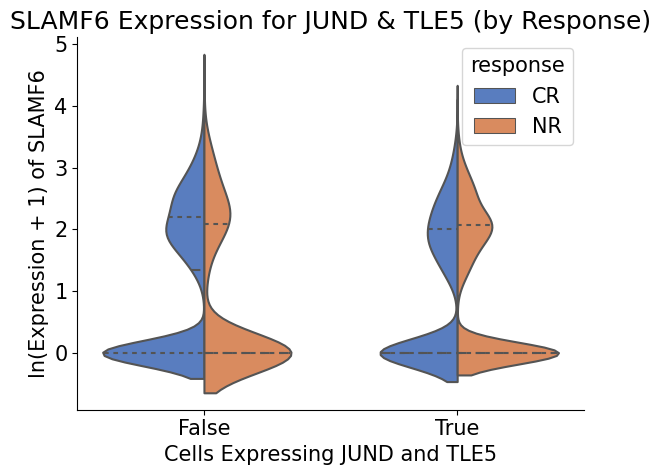

Wilcoxon test for IL7R with JUND & TLE5: U-statistic = 50107454.5, p-value = 2.976707314661519e-56


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


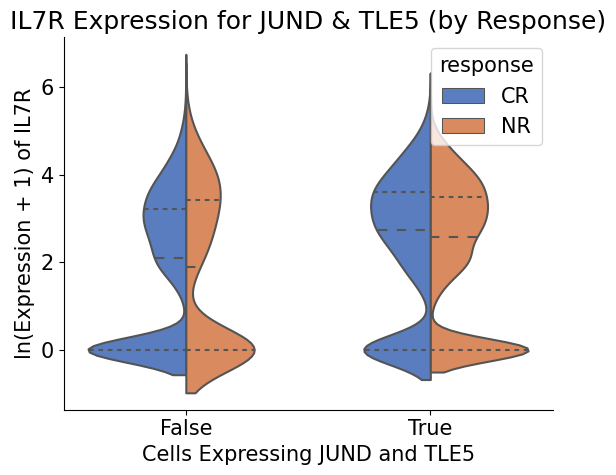

Wilcoxon test for PDCD1 with FCER1G & LFNG: U-statistic = 20842461.0, p-value = 1.1953459124667767e-13


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


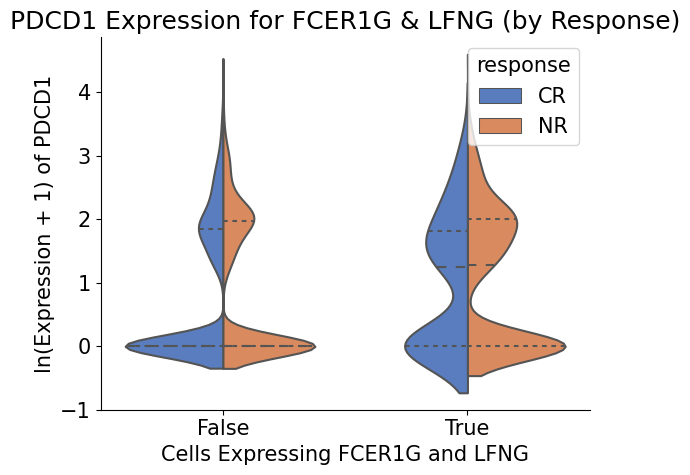

Wilcoxon test for HAVCR2 with FCER1G & LFNG: U-statistic = 20739526.5, p-value = 1.314217708448362e-12


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


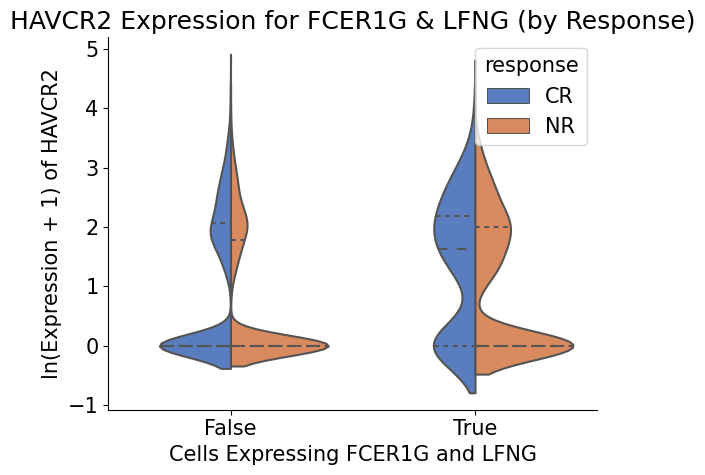

Wilcoxon test for LAG3 with FCER1G & LFNG: U-statistic = 20403286.5, p-value = 2.575579515840657e-07


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


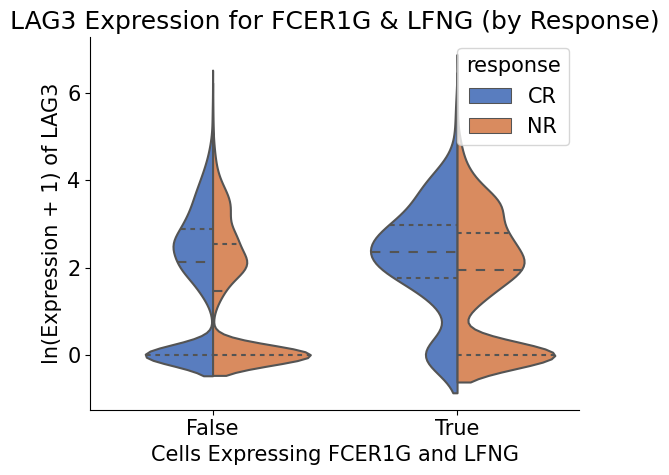

Wilcoxon test for TIGIT with FCER1G & LFNG: U-statistic = 17759794.0, p-value = 6.351600137580613e-10


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


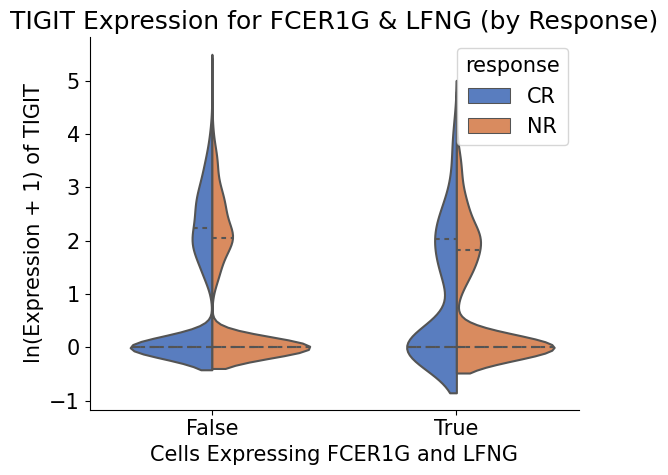

Wilcoxon test for SLAMF6 with FCER1G & LFNG: U-statistic = 18763525.0, p-value = 0.09610989757701377


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


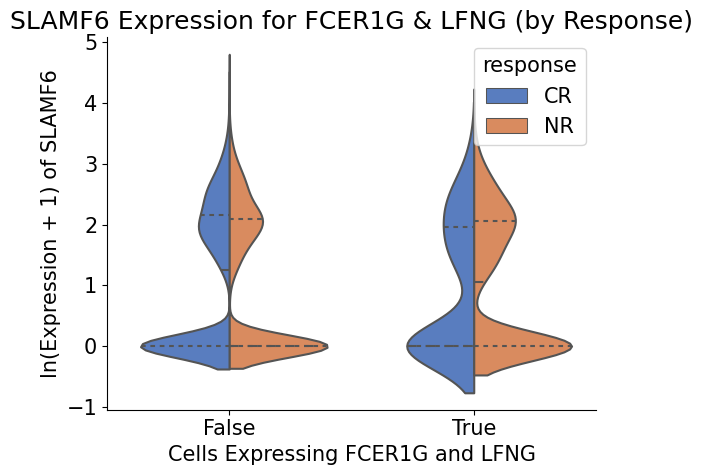

Wilcoxon test for IL7R with FCER1G & LFNG: U-statistic = 18554903.0, p-value = 0.015065833316037402


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


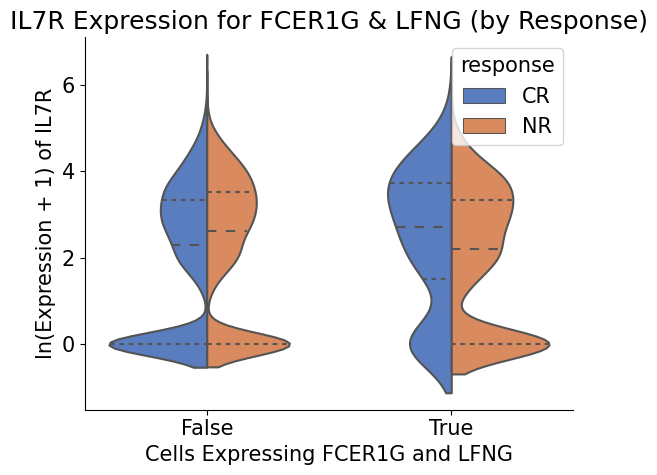

Wilcoxon test for PDCD1 with JUND & TSC22D3: U-statistic = 49767365.0, p-value = 3.3628007838258096e-05


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


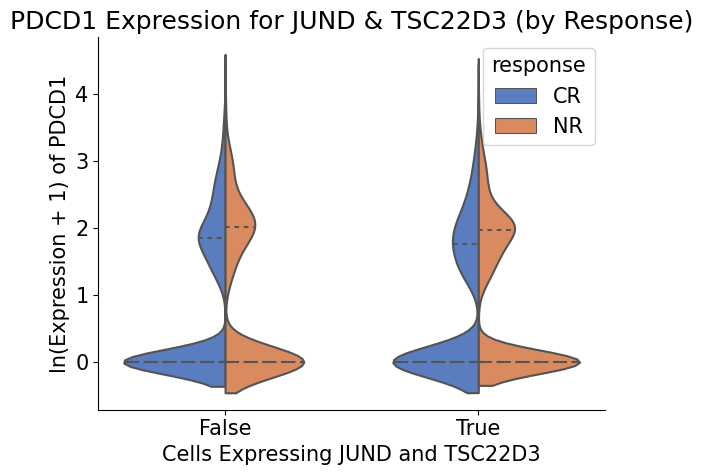

Wilcoxon test for HAVCR2 with JUND & TSC22D3: U-statistic = 44049495.5, p-value = 1.5994291856721525e-32


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


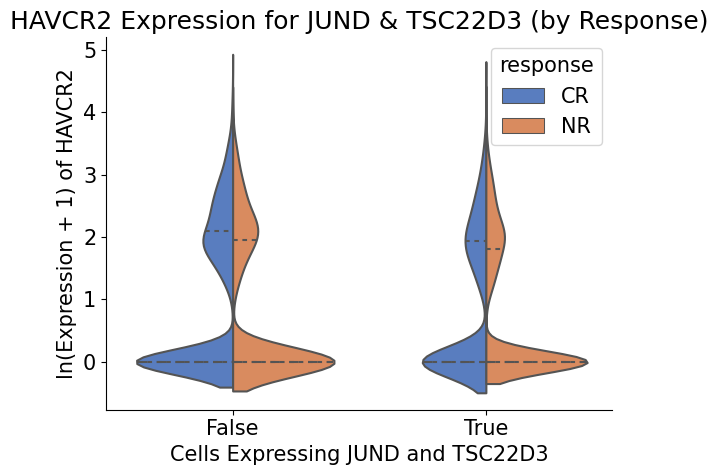

Wilcoxon test for LAG3 with JUND & TSC22D3: U-statistic = 42332114.0, p-value = 1.6117400688372162e-53


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


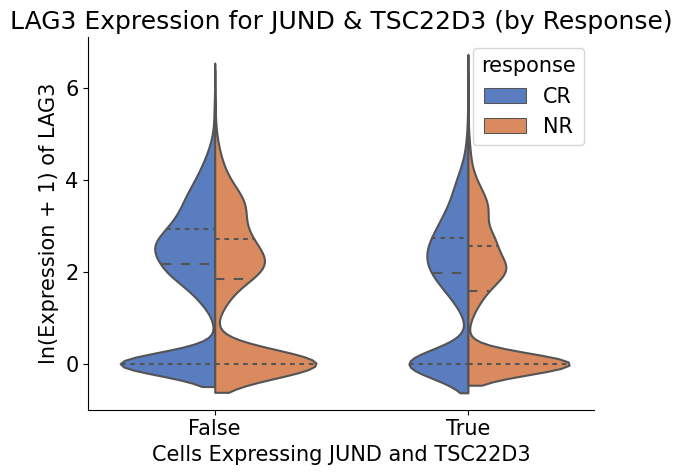

Wilcoxon test for TIGIT with JUND & TSC22D3: U-statistic = 45901057.0, p-value = 3.703486559121732e-11


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


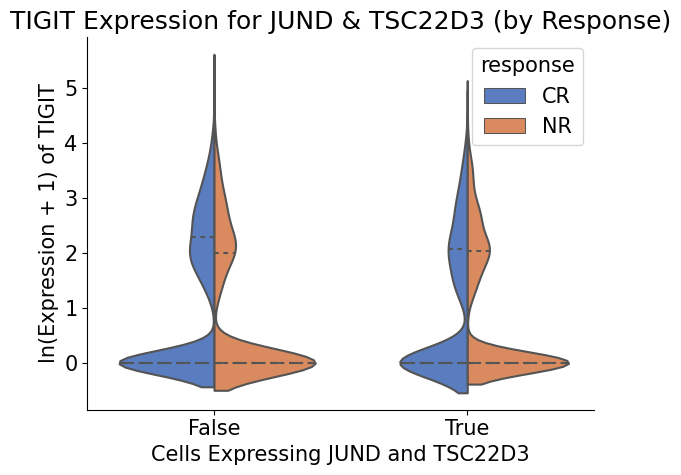

Wilcoxon test for SLAMF6 with JUND & TSC22D3: U-statistic = 46925667.5, p-value = 0.00030051563632301474


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


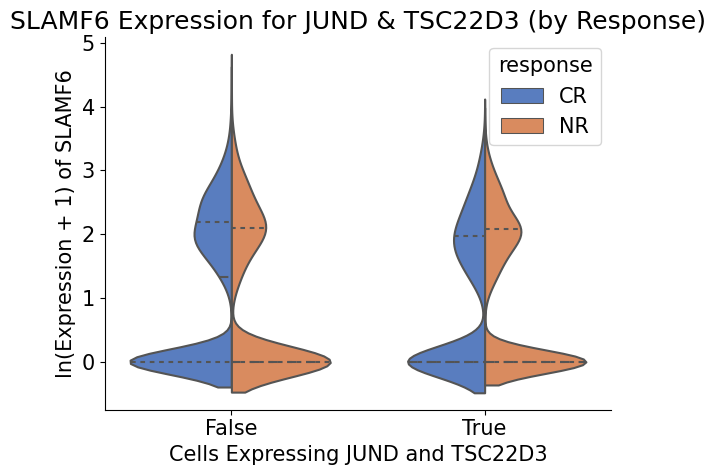

Wilcoxon test for IL7R with JUND & TSC22D3: U-statistic = 54873261.5, p-value = 2.9732618986522173e-64


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


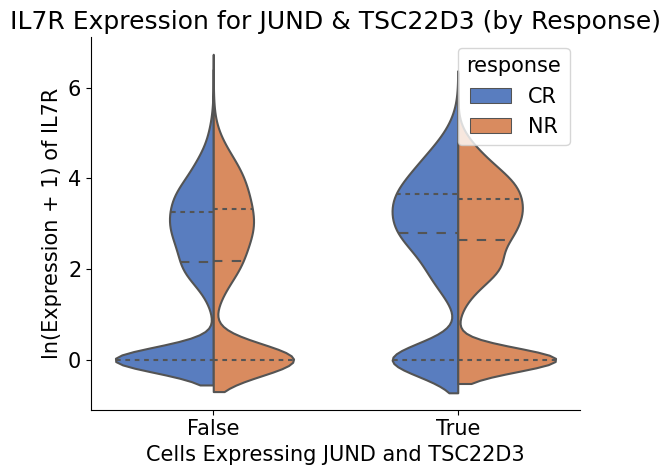

Wilcoxon test for PDCD1 with ZNF683 & TLE5: U-statistic = 18112131.5, p-value = 0.0003088965072627415


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


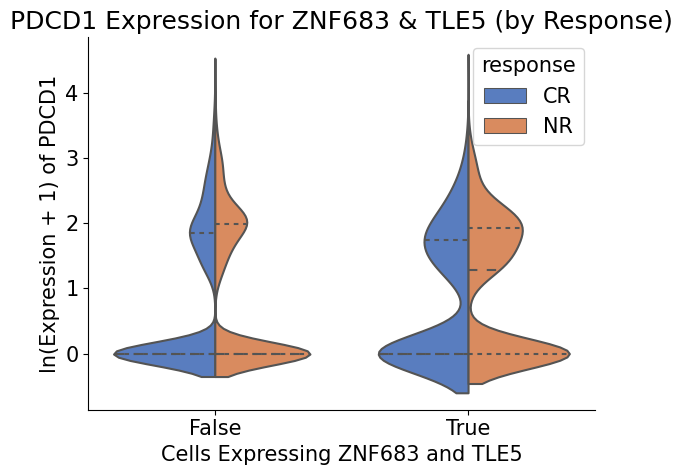

Wilcoxon test for HAVCR2 with ZNF683 & TLE5: U-statistic = 17305104.5, p-value = 0.9059231833411981


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


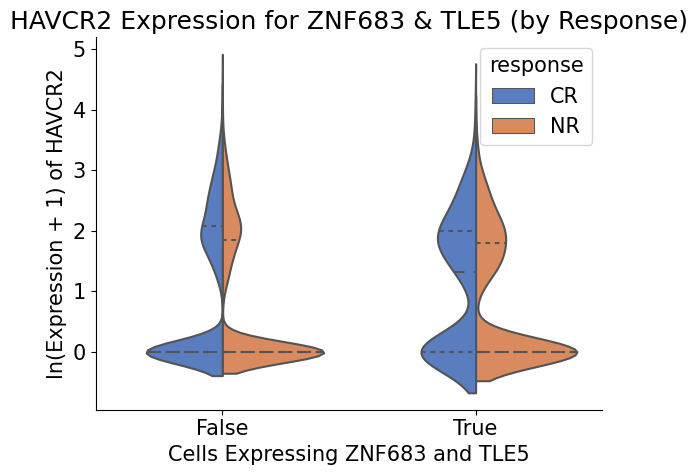

Wilcoxon test for LAG3 with ZNF683 & TLE5: U-statistic = 16187427.5, p-value = 7.459201193971883e-07


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


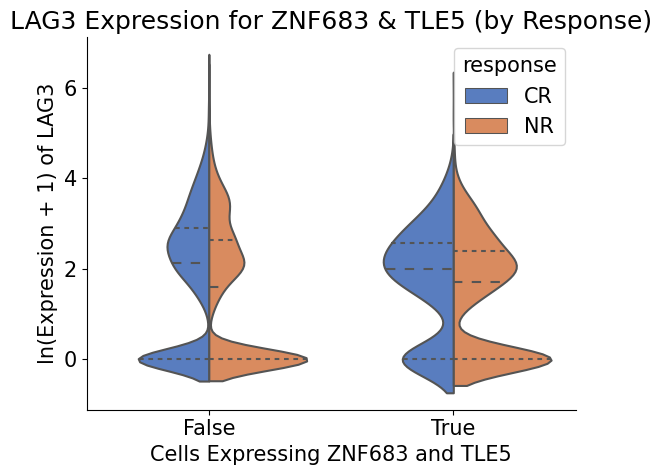

Wilcoxon test for TIGIT with ZNF683 & TLE5: U-statistic = 16839535.0, p-value = 0.022045165735114756


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


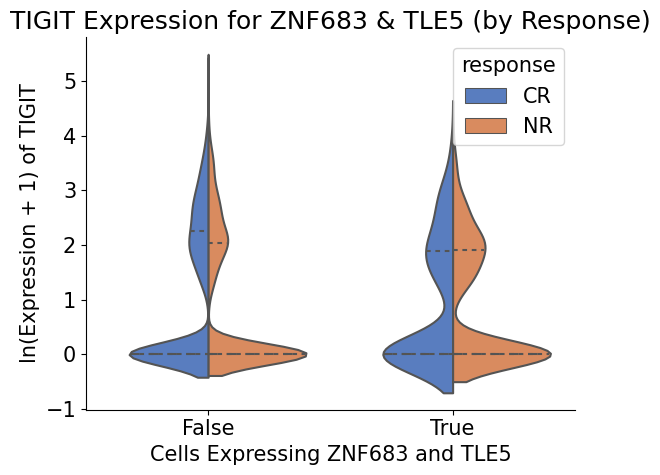

Wilcoxon test for SLAMF6 with ZNF683 & TLE5: U-statistic = 19146473.0, p-value = 3.1724249272046024e-16


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


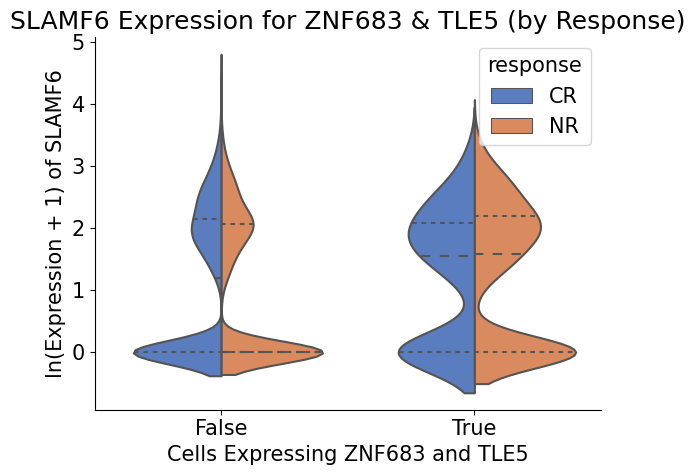

Wilcoxon test for IL7R with ZNF683 & TLE5: U-statistic = 18612682.0, p-value = 4.1768192908917706e-08


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


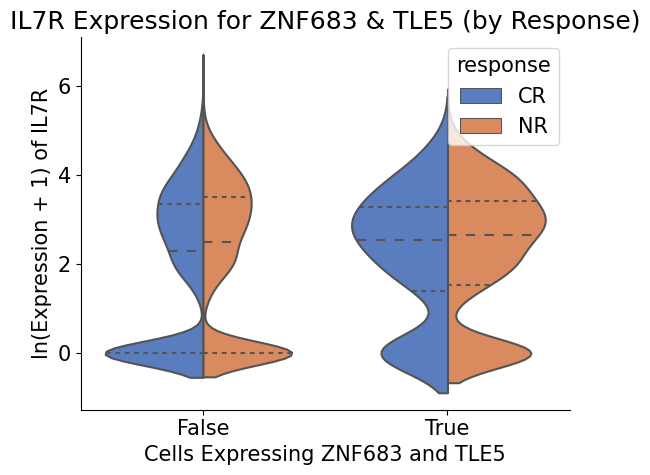

Wilcoxon test for PDCD1 with JUND & ZNF683: U-statistic = 15941448.5, p-value = 8.265932338147787e-05


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


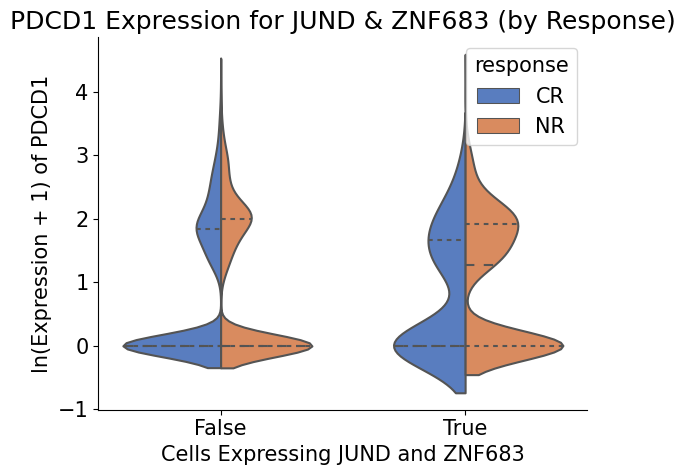

Wilcoxon test for HAVCR2 with JUND & ZNF683: U-statistic = 14815743.0, p-value = 0.0990264160279184


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


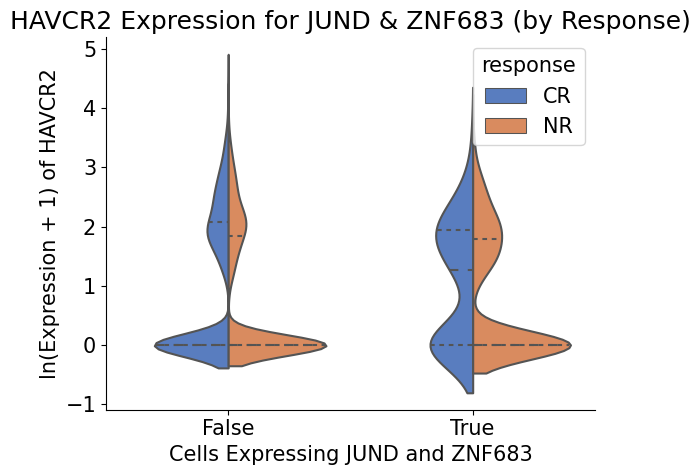

Wilcoxon test for LAG3 with JUND & ZNF683: U-statistic = 13881952.5, p-value = 5.029236761443481e-09


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


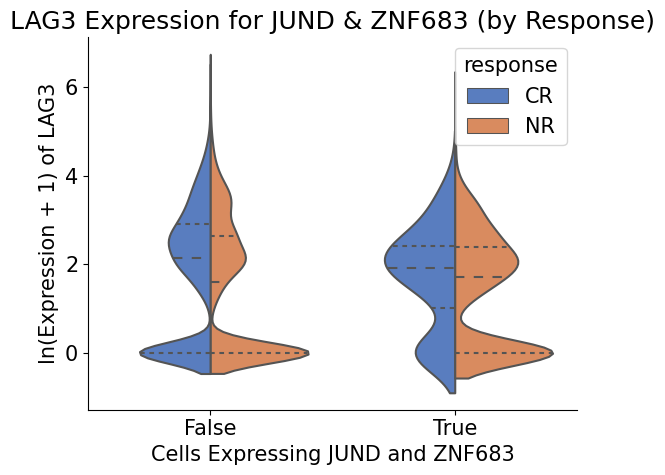

Wilcoxon test for TIGIT with JUND & ZNF683: U-statistic = 14763273.0, p-value = 0.05743723412029717


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


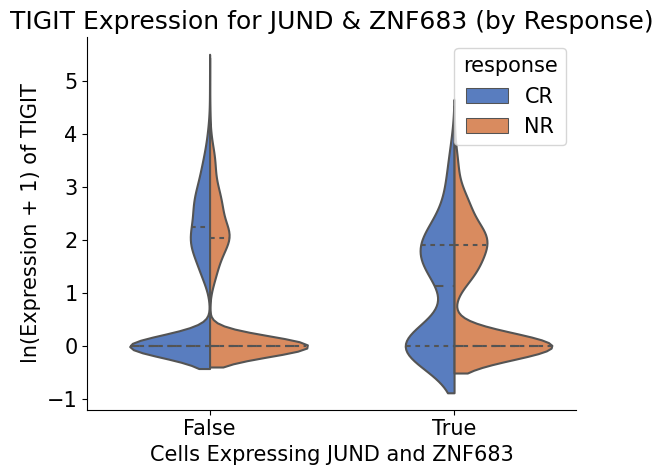

Wilcoxon test for SLAMF6 with JUND & ZNF683: U-statistic = 16636835.5, p-value = 6.919071497384393e-13


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


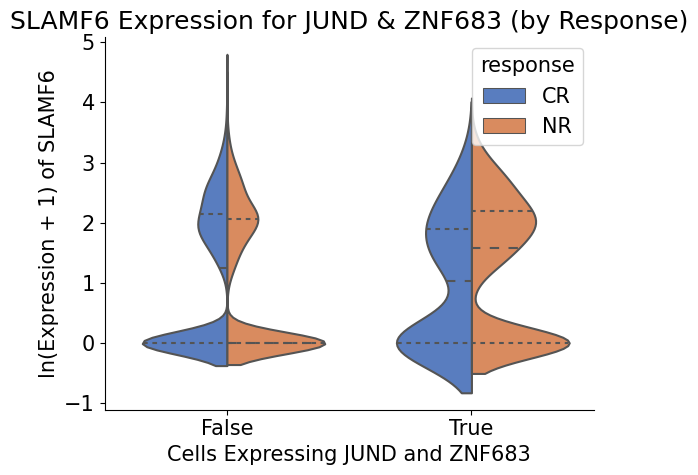

Wilcoxon test for IL7R with JUND & ZNF683: U-statistic = 16402650.5, p-value = 8.55099958421748e-09


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


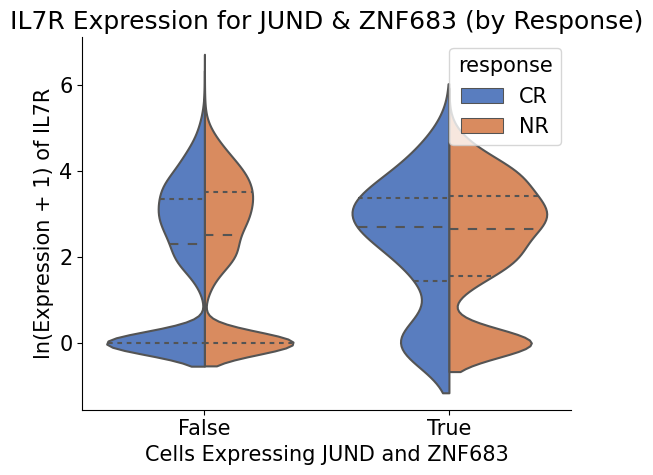

In [16]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
from scipy.stats import mannwhitneyu

# Load log-transformed dataset
adata_log = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat_log.h5ad')
adata_log_CD4 = adata_log[adata_log.obs['cell_type'] == 'CD4'].copy()
adata_log_CR_NR = adata_log_CD4[(adata_log_CD4.obs['response'] == 'CR') | (adata_log_CD4.obs['response'] == 'NR')].copy()

# Define gene list and gene pairs
gene_pairs = [
    ("FCER1G", "ZNF683"),
    ("JUND", "TLE5"),
    ("FCER1G", "LFNG"),
    ("JUND", "TSC22D3"),
    ("ZNF683", "TLE5"),
    ("JUND", "ZNF683")
]

# Prepare to store results
genes = ['PDCD1', 'HAVCR2', 'LAG3', 'TIGIT', 'SLAMF6', 'IL7R']

for gene1, gene2 in gene_pairs:
    # Create a mask for cells that express both gene1 and gene2
    mask = (adata_log_CR_NR[:, gene1].X > 0) & (adata_log_CR_NR[:, gene2].X > 0)
    adata_log_CR_NR_both = adata_log_CR_NR[mask].copy()
    
    # Create a new column to indicate if cells express both gene pairs or neither
    adata_log_CR_NR.obs[f'both_{gene1}_{gene2}'] = adata_log_CR_NR.obs_names.isin(adata_log_CR_NR_both.obs_names)
    adata_log_CR_NR.obs[f'both_{gene1}_{gene2}'] = adata_log_CR_NR.obs[f'both_{gene1}_{gene2}'].astype('category')

    # Convert data to a DataFrame for plotting
    df = adata_log_CR_NR.to_df()
    df[f'both_{gene1}_{gene2}'] = adata_log_CR_NR.obs[f'both_{gene1}_{gene2}'].values
    df['response'] = adata_log_CR_NR.obs['response'].values

    # Generate violin plot and perform Wilcoxon rank-sum test for each gene
    for gene in genes:
        if gene in adata_log_CR_NR.var_names:
            df['value'] = adata_log_CR_NR[:, adata_log_CR_NR.var_names == gene].X.toarray().flatten()
            
            # Separate values for cells expressing both gene pairs and neither
            group_both = df[df[f'both_{gene1}_{gene2}'] == True]['value']
            group_neither = df[df[f'both_{gene1}_{gene2}'] == False]['value']
            
            # Perform Wilcoxon rank-sum test (Mann-Whitney U test since Wilcoxon requires paired samples)
            stat, p_value = mannwhitneyu(group_both, group_neither, alternative='two-sided')
            print(f"Wilcoxon test for {gene} with {gene1} & {gene2}: U-statistic = {stat}, p-value = {p_value}")

            # Create the violin plot using seaborn, split by both gene expression and response
            plt.figure(figsize=(6, 5))
            plt.rcParams.update({'font.size': 15})
            ax = sns.violinplot(data=df, x=f'both_{gene1}_{gene2}', y='value', hue='response', split=True, inner="quart", palette="muted")
            sns.despine()  # Remove the top and right spines

            # Customize the plot
            plt.title(f'{gene} Expression for {gene1} & {gene2} (by Response)')
            plt.xlabel(f'Cells Expressing {gene1} and {gene2}')
            plt.ylabel(f'ln(Expression + 1) of {gene}')
            plt.tight_layout()

            # Save or display the plot
            #plt.savefig(f'/home/emma/result/CART/violinplot_gene_pairs/{gene1}_{gene2}_{gene}_violinplot.png')
            plt.show()
        else:
            print(f"{gene} is not present in the variable names. Please check your adata object.")


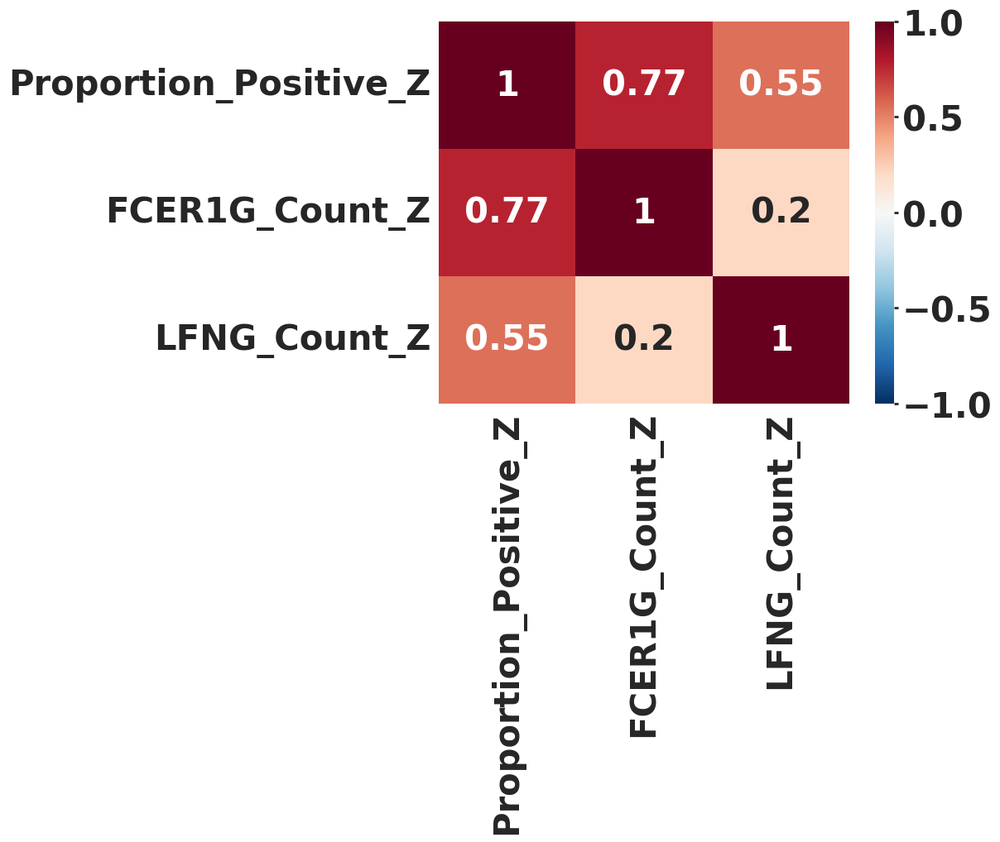

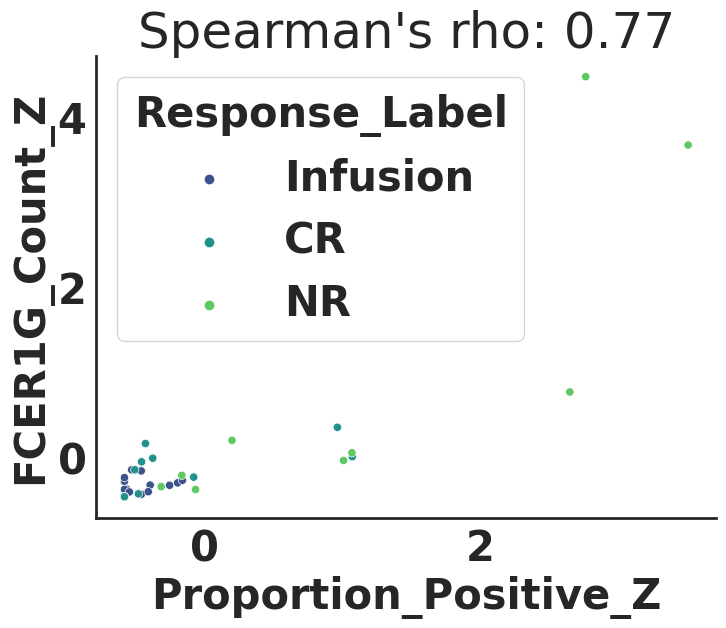

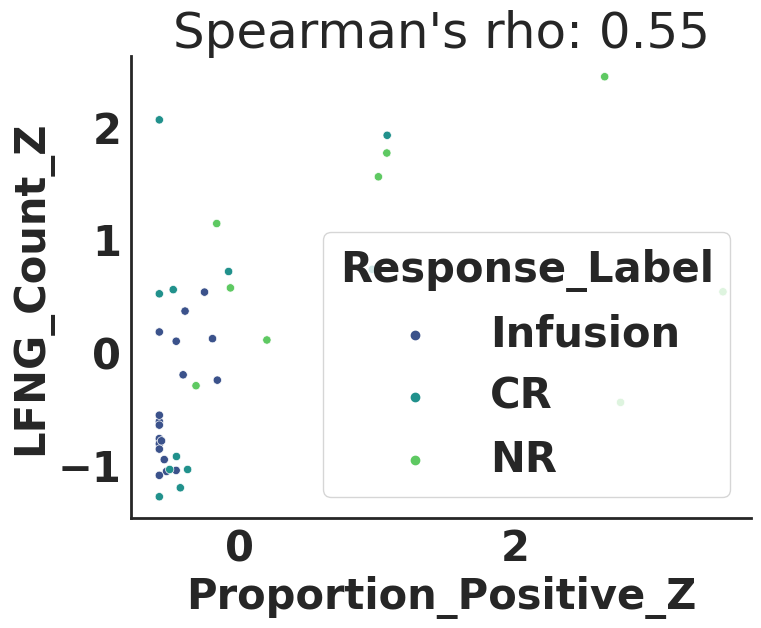

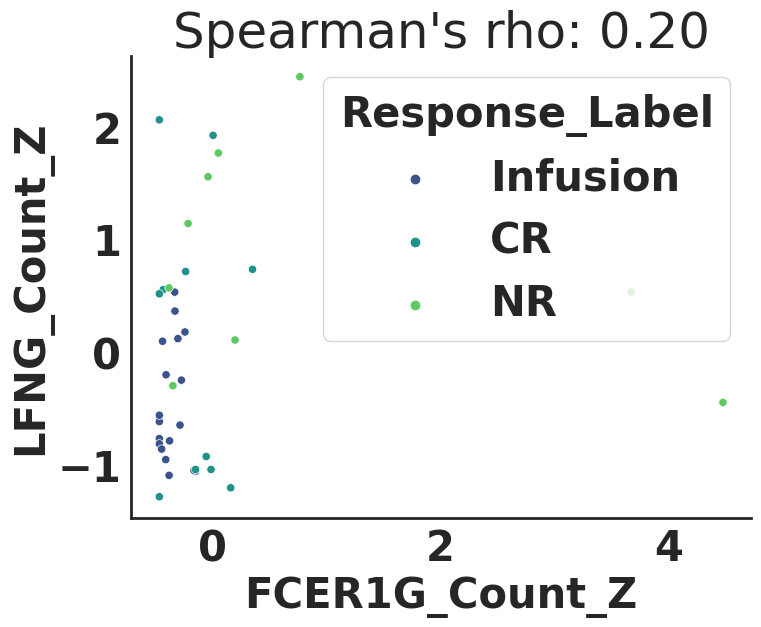

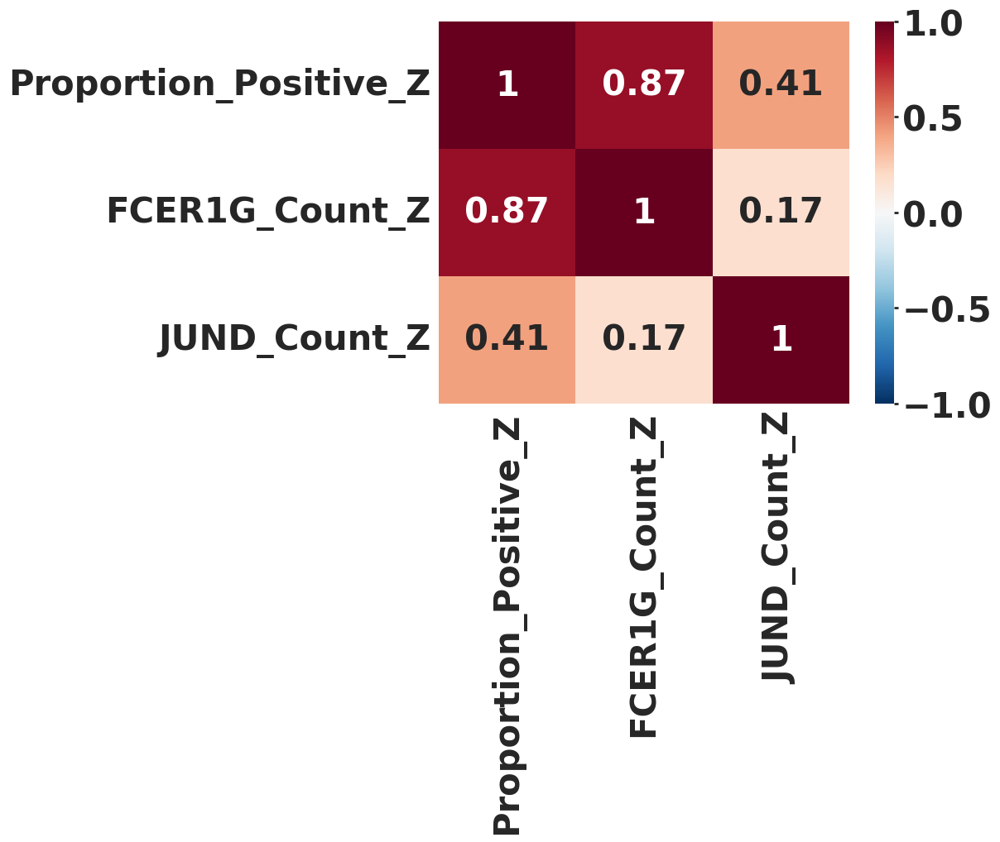

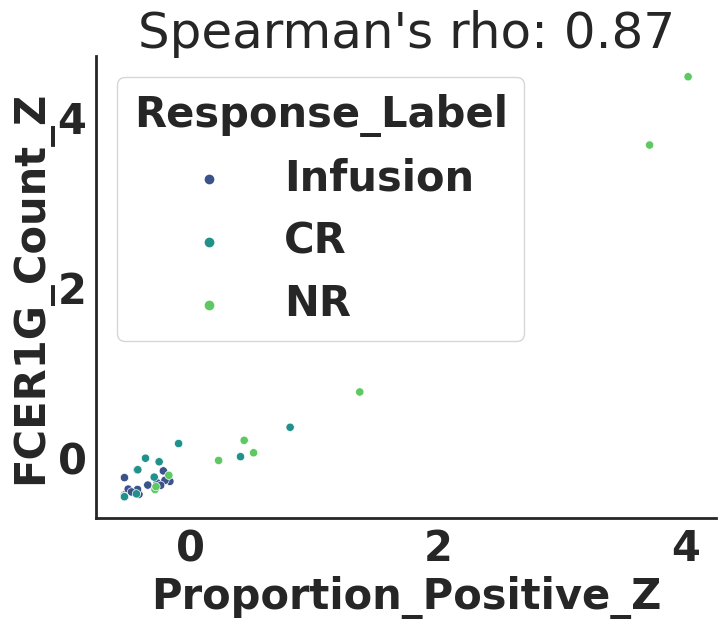

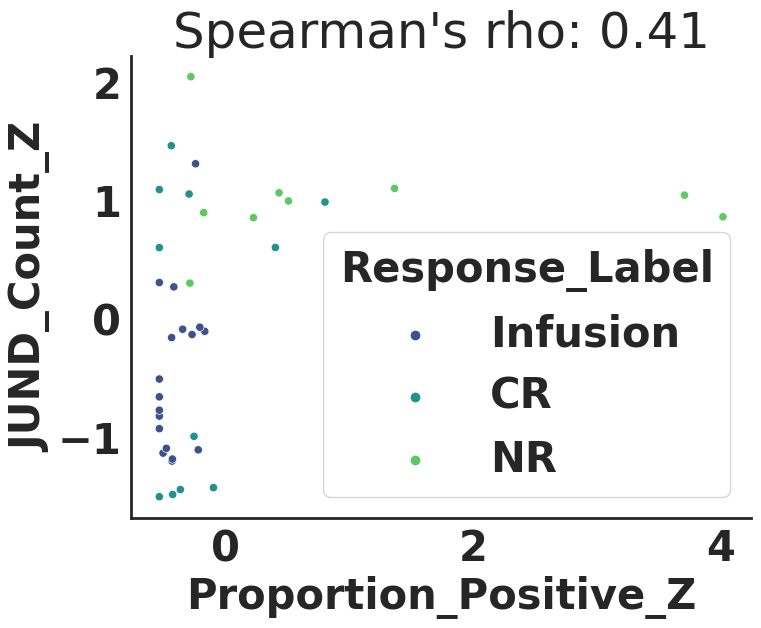

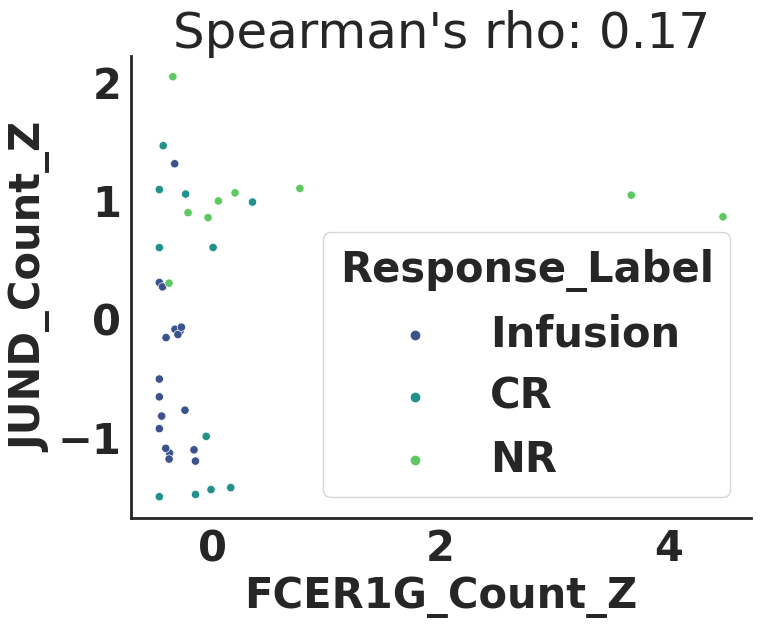

In [37]:
import scanpy as sc
import numpy as np
import pandas as pd
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from scipy.stats import spearmanr, zscore
import matplotlib.pyplot as plt
import seaborn as sns

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Encode the 'response' labels
le = LabelEncoder()
adata_CD4.obs['Response_Encoded'] = le.fit_transform(adata_CD4.obs['response'])

# Add a suffix to the patient IDs to make them unique
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Define gene pairs
gene_pairs = [
    ("FCER1G", "LFNG"),
    ("FCER1G", "JUND"),
]

# Map the encoded response back to the original labels for plotting
response_map = {index: label for index, label in enumerate(le.classes_)}
adata_CD4.obs['Response_Label'] = adata_CD4.obs['Response_Encoded'].map(response_map)

# Define the color palette
color_palette = ["#A3B18A", "#B77B7E", "#F6BD60"]

for gene1, gene2 in gene_pairs:
    # Prepare the data for the gene pair
    model_data = []

    responses = adata_CD4.obs['response'].unique()
    for response in responses:
        resp_adata = adata_CD4[adata_CD4.obs['response'] == response]
        patients = resp_adata.obs['Unique_ID'].unique()
        
        # Calculate the proportion of cells expressing both genes for each patient
        for patient in patients:
            patient_data = resp_adata[resp_adata.obs['Unique_ID'] == patient]
            gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
            gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
            both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
            proportion = np.sum(both_genes_expr) / patient_data.shape[0]
            gene1_count = np.mean(patient_data[:, gene1].X)  # Sum of log1p-transformed counts
            gene2_count = np.mean(patient_data[:, gene2].X)  # Sum of log1p-transformed counts

            # Append the data for analysis
            model_data.append({
                'Patient': patient,
                'Response_Label': patient_data.obs['Response_Label'].values[0], 
                'Response_Encoded': patient_data.obs['Response_Encoded'].values[0], 
                'Proportion_Positive': proportion,
                f'{gene1}_Count': gene1_count,
                f'{gene2}_Count': gene2_count
            })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)

    # Normalize the features using zscore for XGBoost
    model_df['Proportion_Positive_Z'] = zscore(model_df['Proportion_Positive'])
    model_df[f'{gene1}_Count_Z'] = zscore(model_df[f'{gene1}_Count'])
    model_df[f'{gene2}_Count_Z'] = zscore(model_df[f'{gene2}_Count'])

    # 5. Heatmap of Spearman Correlation (using z-score normalized data)
    correlation_matrix = model_df[['Proportion_Positive_Z', f'{gene1}_Count_Z', f'{gene2}_Count_Z']].corr(method='spearman')
    plt.figure(figsize=(8, 6))
    sns.heatmap(correlation_matrix, annot=True, cmap='RdBu_r', vmin=-1, vmax=1)
    #sns.despine(top=True, right=True)
    plt.show()
    
    # 6. Scatter plots with Spearman's rho displayed (using z-score normalized data)
    pairs = [
        ('Proportion_Positive_Z', f'{gene1}_Count_Z'),
        ('Proportion_Positive_Z', f'{gene2}_Count_Z'),
        (f'{gene1}_Count_Z', f'{gene2}_Count_Z')
    ]
    
    for var1, var2 in pairs:
        plt.figure(figsize=(8, 6))
        sns.scatterplot(x=model_df[var1], y=model_df[var2], hue=model_df['Response_Label'], palette='viridis')
        rho, _ = spearmanr(model_df[var1], model_df[var2])
        plt.title(f"Spearman's rho: {rho:.2f}")
        plt.xlabel(var1)
        plt.ylabel(var2)
        sns.despine(top=True, right=True)
        plt.show()  # Make sure to show each scatter plot


Evaluation Metrics for Gene Pair: FCER1G - ZNF683
Accuracy: 0.7500
Precision: 0.7292
Recall: 0.7500
F1 Score: 0.7310

Visualizing for Gene Pair: FCER1G - ZNF683


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


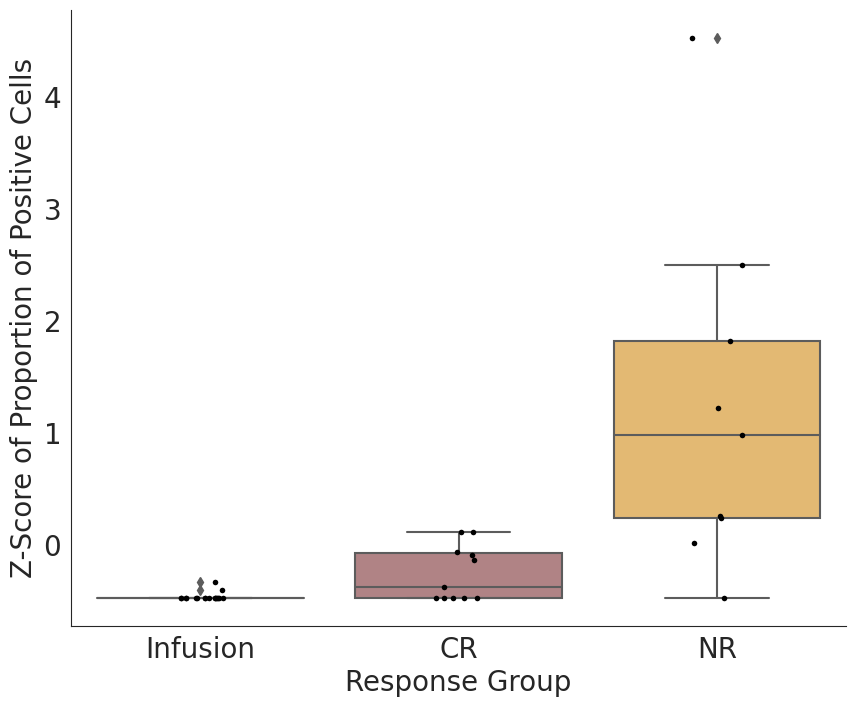

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


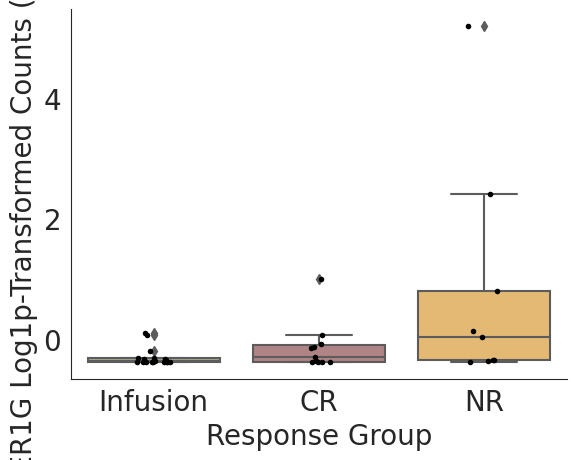

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


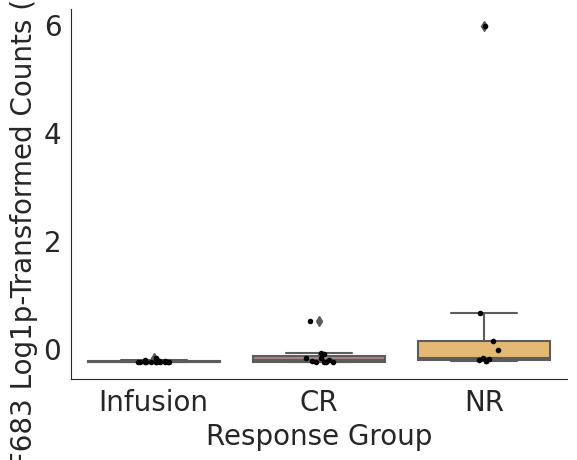

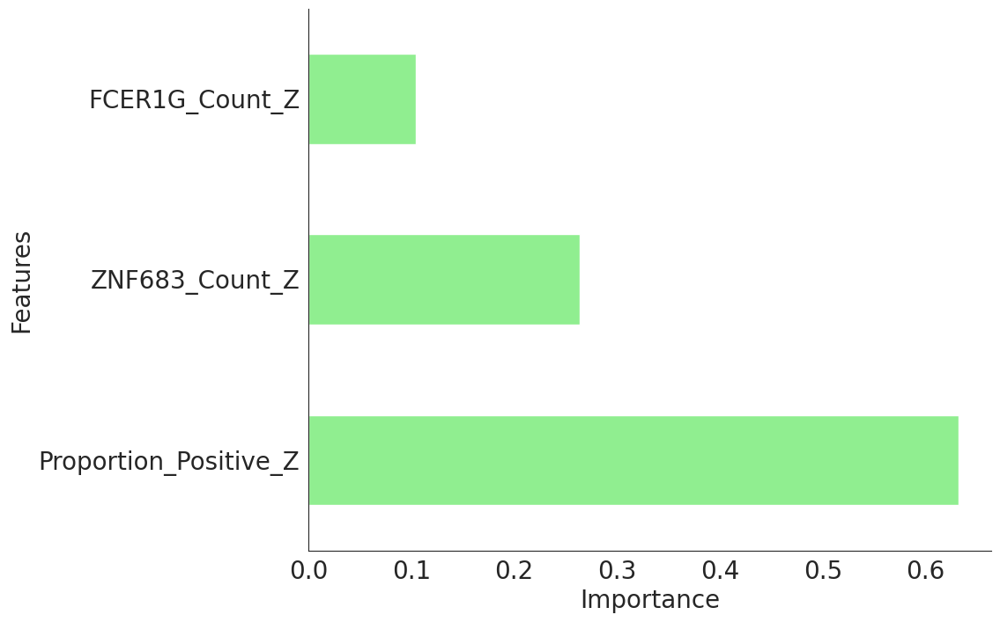

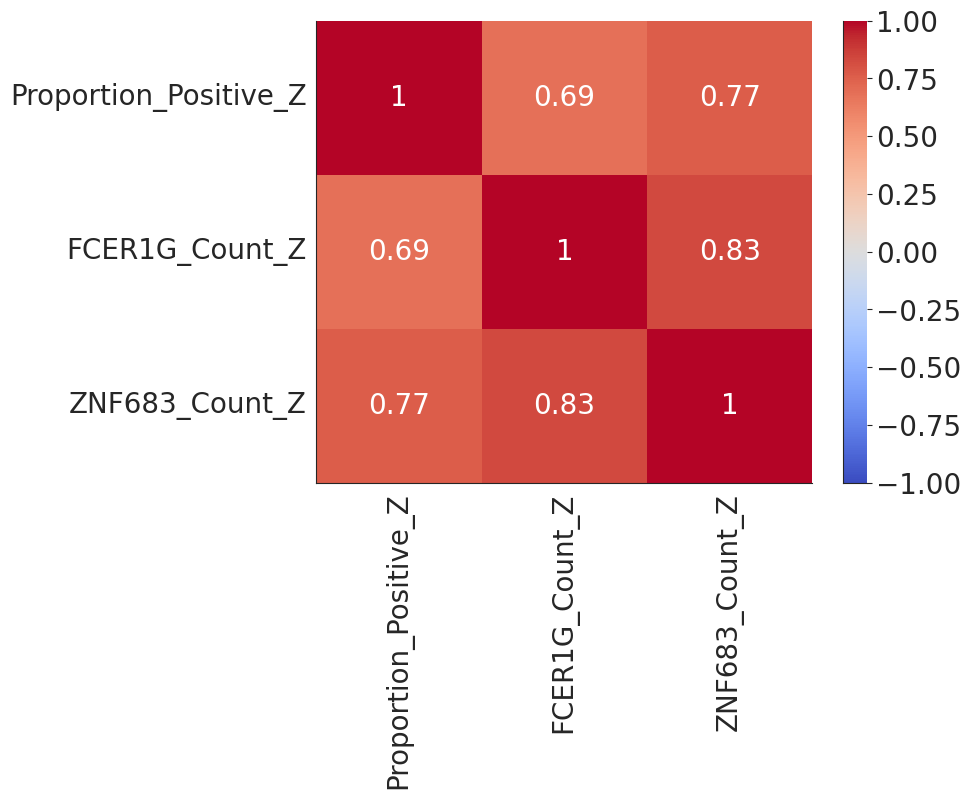

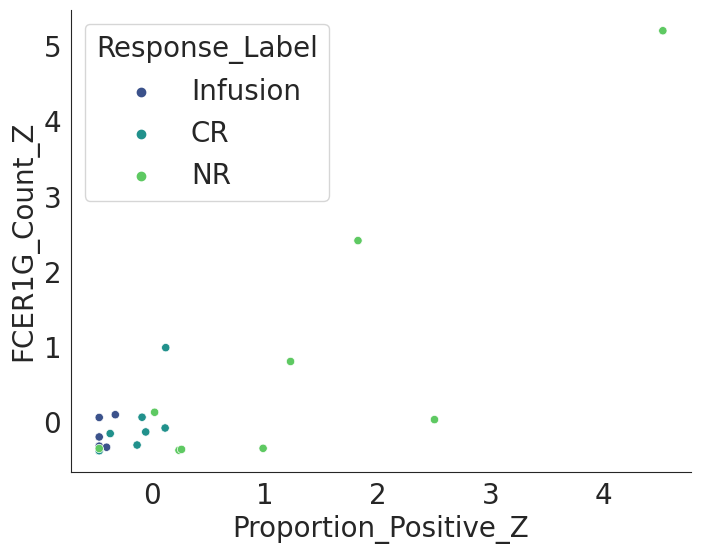

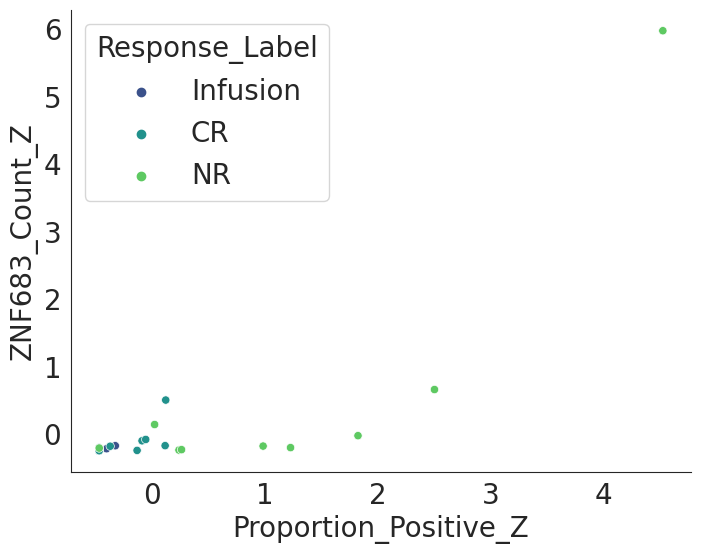

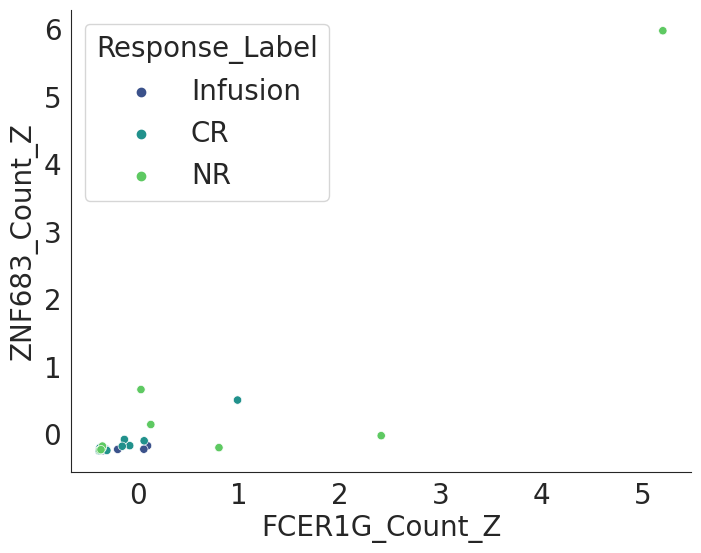


Evaluation Metrics for Gene Pair: FCER1G - LFNG
Accuracy: 0.4167
Precision: 0.4643
Recall: 0.4167
F1 Score: 0.4308

Visualizing for Gene Pair: FCER1G - LFNG


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


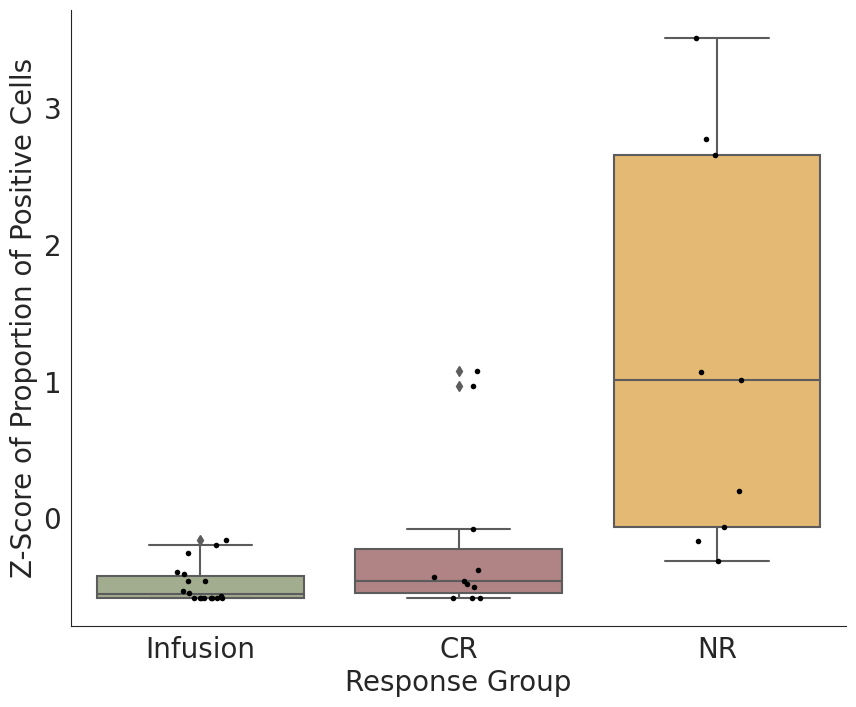

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


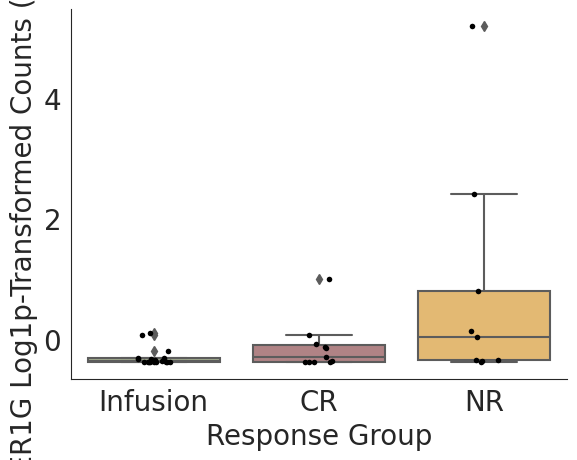

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


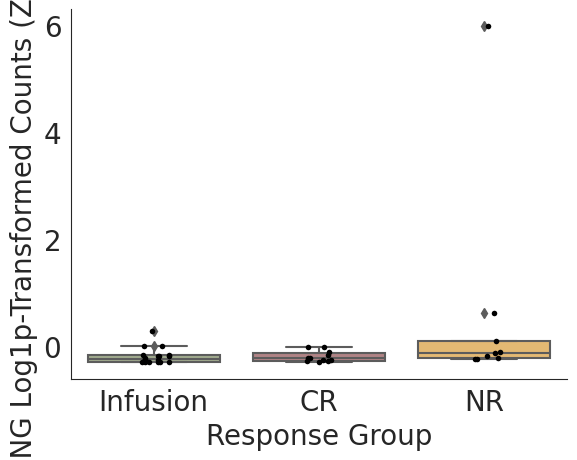

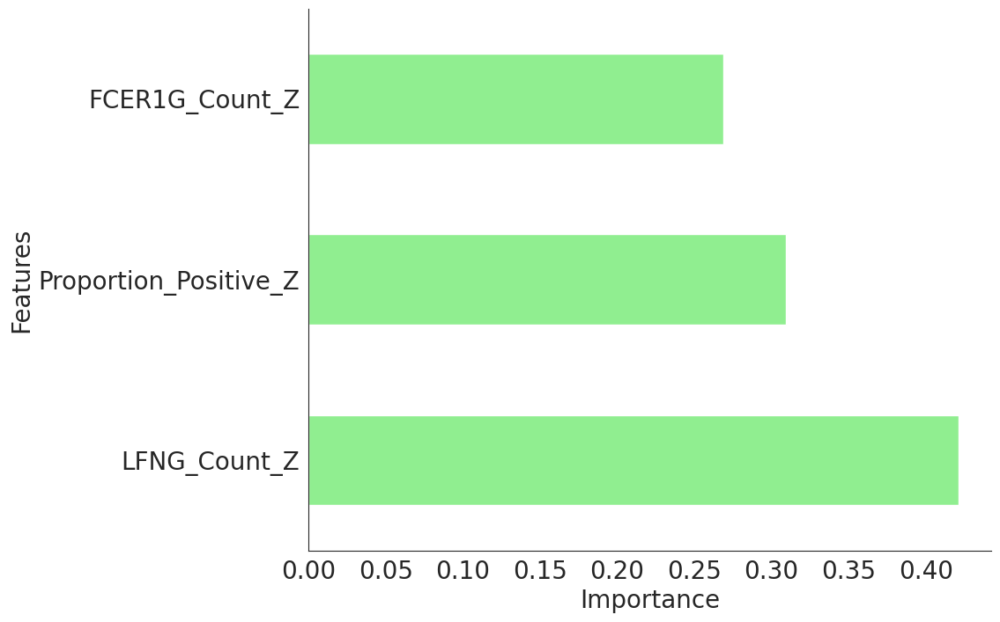

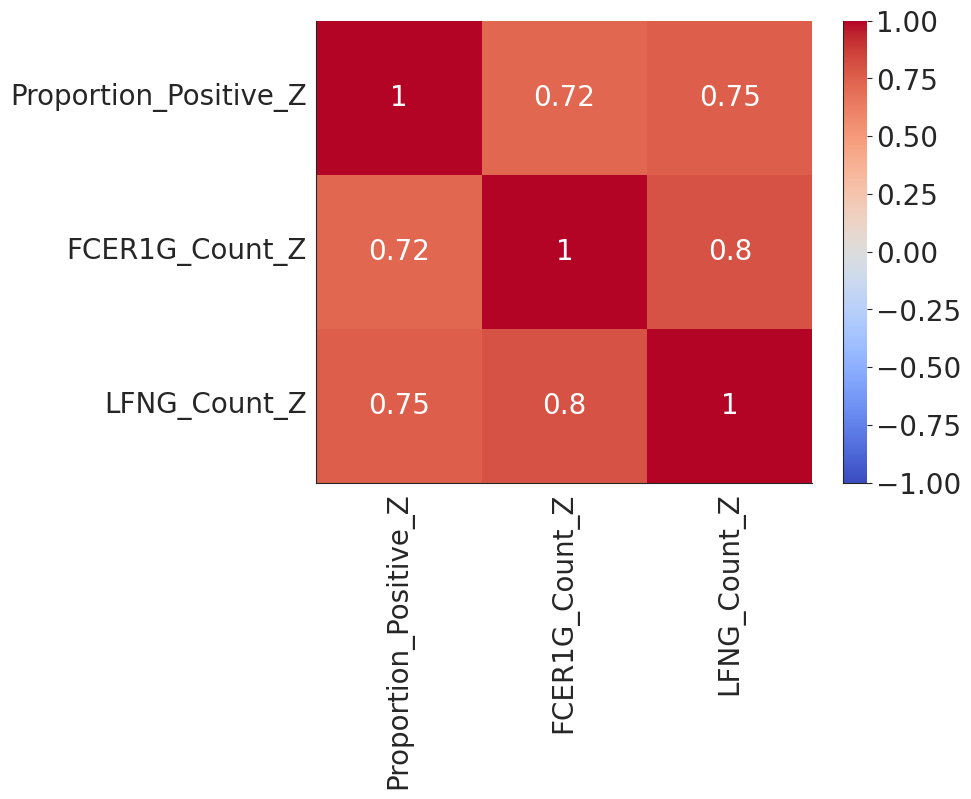

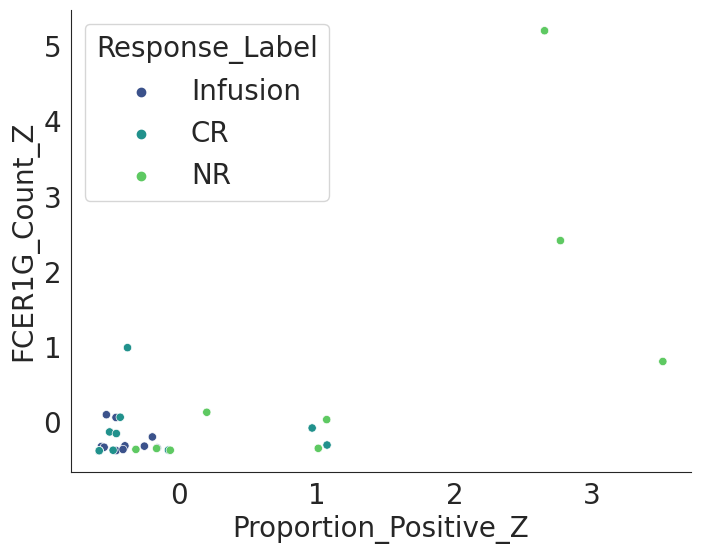

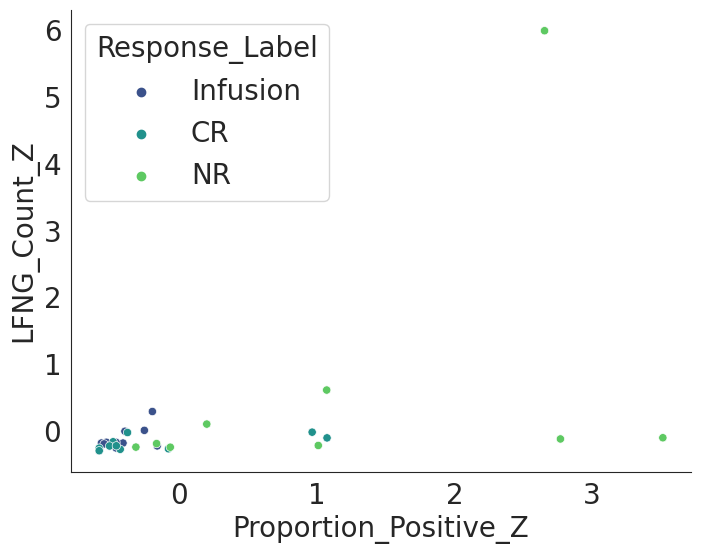

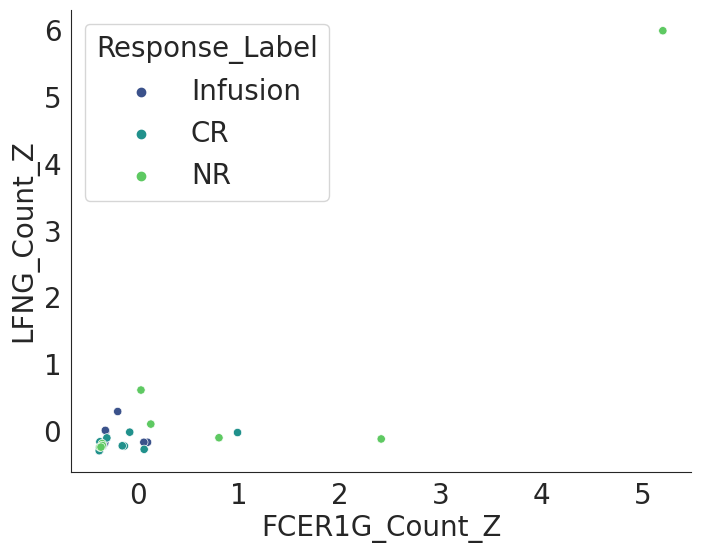


Evaluation Metrics for Gene Pair: PECAM1 - LFNG
Accuracy: 0.3333
Precision: 0.3333
Recall: 0.3333
F1 Score: 0.3333

Visualizing for Gene Pair: PECAM1 - LFNG


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


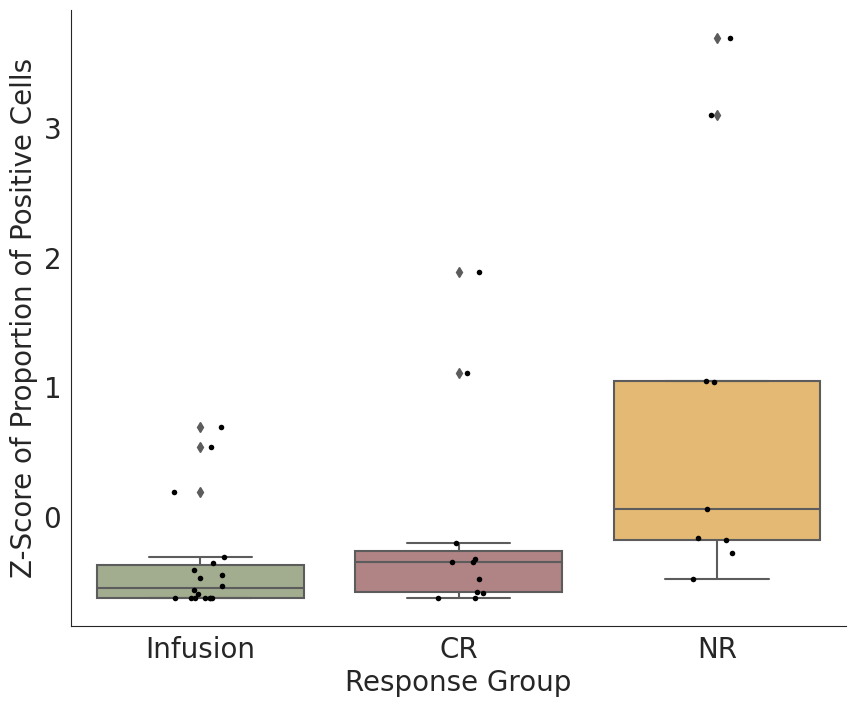

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


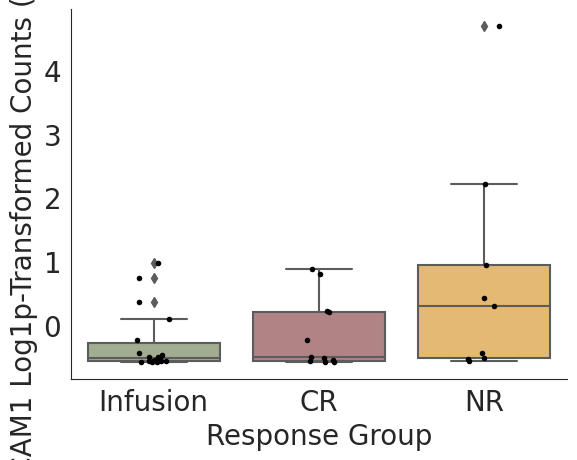

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


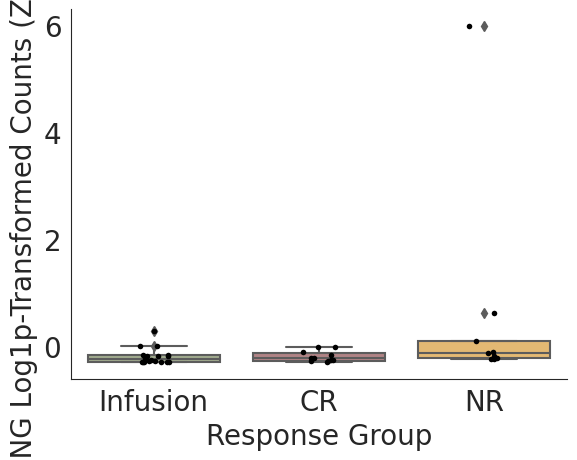

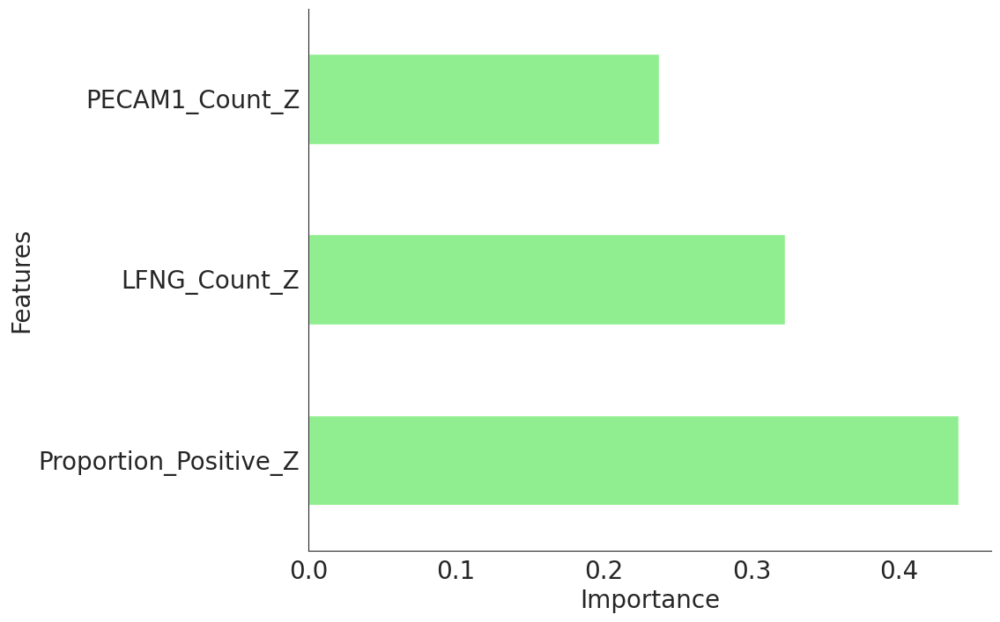

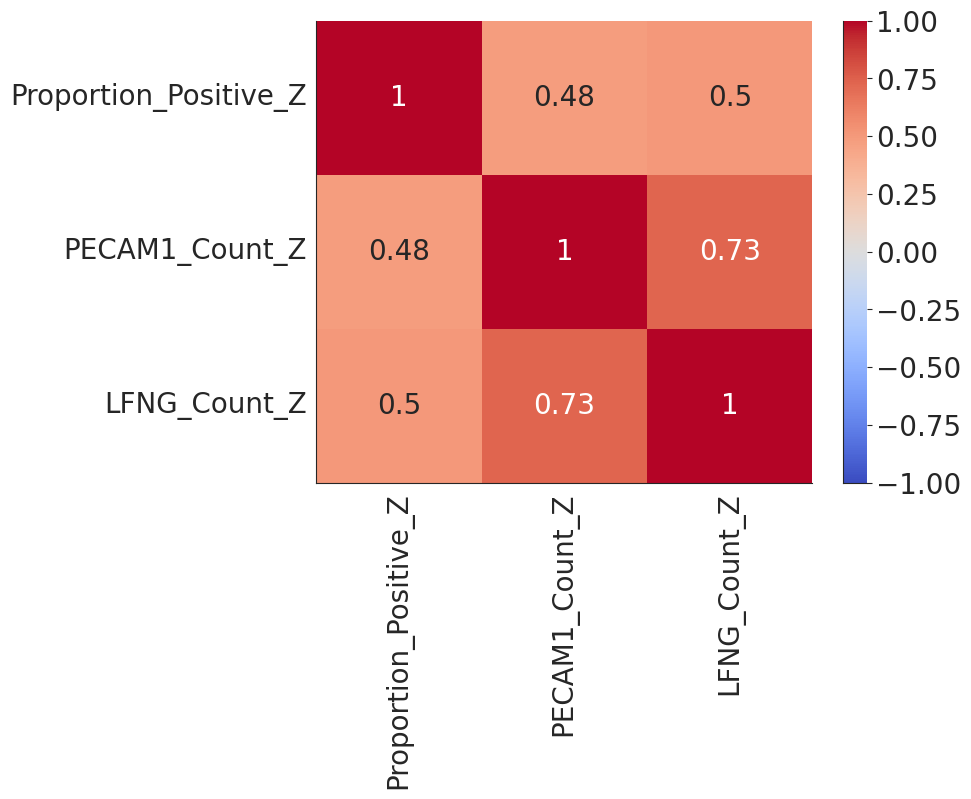

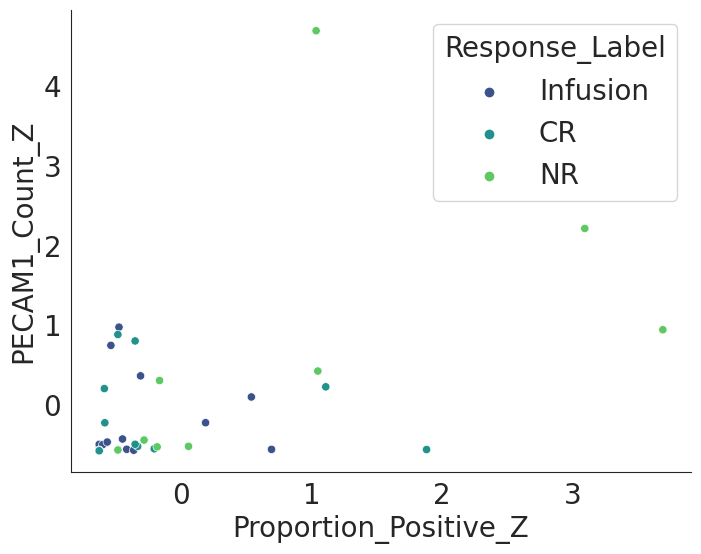

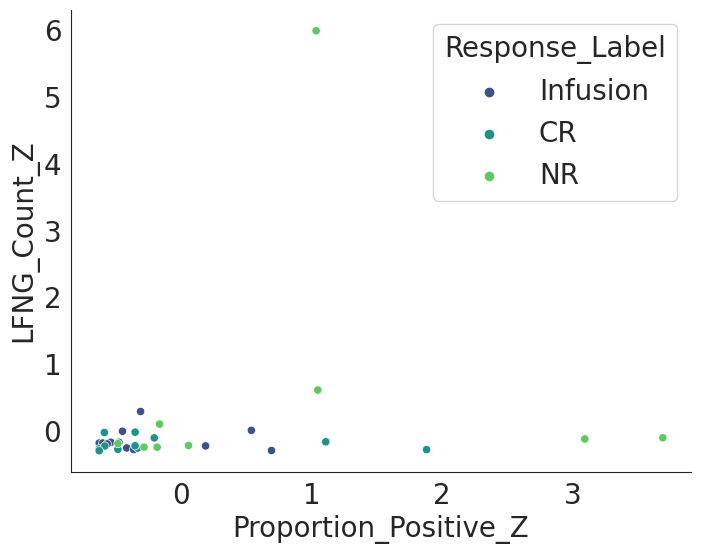

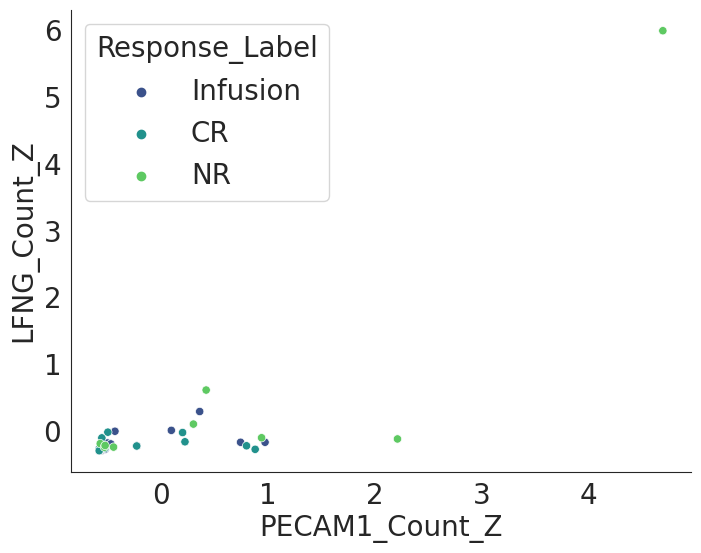

In [78]:
import scanpy as sc
import numpy as np
import pandas as pd
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from scipy.stats import spearmanr, zscore
import xgboost as xgb
import matplotlib.pyplot as plt
import seaborn as sns

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Encode the 'response' labels
le = LabelEncoder()
adata_CD4.obs['Response_Encoded'] = le.fit_transform(adata_CD4.obs['response'])

# Add a suffix to the patient IDs to make them unique
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Define gene pairs
gene_pairs = [
    ("FCER1G", "ZNF683"),
    ("FCER1G", "LFNG"),
    ("PECAM1", "LFNG")
]

# Map the encoded response back to the original labels for plotting
response_map = {index: label for index, label in enumerate(le.classes_)}
adata_CD4.obs['Response_Label'] = adata_CD4.obs['Response_Encoded'].map(response_map)

# Define the color palette
color_palette = ["#A3B18A", "#B77B7E", "#F6BD60"]

for gene1, gene2 in gene_pairs:
    # Prepare the data for the gene pair
    model_data = []

    responses = adata_CD4.obs['response'].unique()
    for response in responses:
        resp_adata = adata_CD4[adata_CD4.obs['response'] == response]
        patients = resp_adata.obs['Unique_ID'].unique()
        
        # Calculate the proportion of cells expressing both genes for each patient
        for patient in patients:
            patient_data = resp_adata[resp_adata.obs['Unique_ID'] == patient]
            gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
            gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
            both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
            proportion = np.sum(both_genes_expr) / patient_data.shape[0]
            gene1_count = np.sum(patient_data[:, gene1].X)  # Sum of log1p-transformed counts
            gene2_count = np.sum(patient_data[:, gene2].X)  # Sum of log1p-transformed counts

            # Append the data for analysis
            model_data.append({
                'Patient': patient,
                'Response_Label': patient_data.obs['Response_Label'].values[0], 
                'Response_Encoded': patient_data.obs['Response_Encoded'].values[0], 
                'Proportion_Positive': proportion,
                f'{gene1}_Count': gene1_count,
                f'{gene2}_Count': gene2_count
            })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)

    # Normalize the features using zscore for XGBoost
    model_df['Proportion_Positive_Z'] = zscore(model_df['Proportion_Positive'])
    model_df[f'{gene1}_Count_Z'] = zscore(model_df[f'{gene1}_Count'])
    model_df[f'{gene2}_Count_Z'] = zscore(model_df[f'{gene2}_Count'])

    # Select the normalized features and the target variable
    X = model_df[['Proportion_Positive_Z', f'{gene1}_Count_Z', f'{gene2}_Count_Z']]
    y = model_df['Response_Encoded']

    # Split the data into training and test sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

    # Train an XGBoost classifier using the common parameters
    xgb_params = {
        'n_estimators': 100,
        'random_state': 42,
        'use_label_encoder': False,
        'eval_metric': 'logloss'
    }
    xgb_model = xgb.XGBClassifier(**xgb_params)
    xgb_model.fit(X_train, y_train)

    # Predict on the test set
    y_pred = xgb_model.predict(X_test)

    # Calculate accuracy, precision, recall, and F1-score
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    f1 = f1_score(y_test, y_pred, average='weighted')

    print(f"\nEvaluation Metrics for Gene Pair: {gene1} - {gene2}")
    print(f"Accuracy: {accuracy:.4f}")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1 Score: {f1:.4f}")

    # Feature Importance using XGBoost
    feature_importances = pd.Series(xgb_model.feature_importances_, index=X.columns).sort_values(ascending=False)

    # Visualization
    print(f"\nVisualizing for Gene Pair: {gene1} - {gene2}")
    
    plt.figure(figsize=(10, 8))
    plt.rcParams['font.size'] = 20
    sns.set_style("white")
    
    # 1. Proportion of cells expressing both genes across response groups
    sns.boxplot(x='Response_Label', y='Proportion_Positive_Z', data=model_df, palette=color_palette)
    sns.stripplot(x='Response_Label', y='Proportion_Positive_Z', data=model_df, color='black', size=4, jitter=True)
    plt.xlabel('Response Group')
    plt.ylabel('Z-Score of Proportion of Positive Cells')
    sns.despine(top=True, right=True)
    plt.show()
    
    # 2. Gene counts across response groups for gene1
    sns.boxplot(x='Response_Label', y=f'{gene1}_Count_Z', data=model_df, palette=color_palette)
    sns.stripplot(x='Response_Label', y=f'{gene1}_Count_Z', data=model_df, color='black', size=4, jitter=True)
    plt.xlabel('Response Group')
    plt.ylabel(f'{gene1} Log1p-Transformed Counts (Z-Score)')
    sns.despine(top=True, right=True)
    plt.show()
    
    # 3. Gene counts across response groups for gene2
    sns.boxplot(x='Response_Label', y=f'{gene2}_Count_Z', data=model_df, palette=color_palette)
    sns.stripplot(x='Response_Label', y=f'{gene2}_Count_Z', data=model_df, color='black', size=4, jitter=True)
    plt.xlabel('Response Group')
    plt.ylabel(f'{gene2} Log1p-Transformed Counts (Z-Score)')
    sns.despine(top=True, right=True)
    plt.show()
    
    # 4. Feature Importance using XGBoost
    feature_importances.plot(kind='barh', color='lightgreen', figsize=(10, 8))
    plt.xlabel('Importance')
    plt.ylabel('Features')
    sns.despine(top=True, right=True)
    plt.show()
    
    # 5. Heatmap of Spearman Correlation (using z-score normalized data)
    correlation_matrix = model_df[['Proportion_Positive_Z', f'{gene1}_Count_Z', f'{gene2}_Count_Z']].corr(method='spearman')
    plt.figure(figsize=(8, 6))
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
    sns.despine(top=True, right=True)
    plt.show()
    
    # 6. Scatter plots with Spearman's rho displayed (using z-score normalized data)
    pairs = [
        ('Proportion_Positive_Z', f'{gene1}_Count_Z'),
        ('Proportion_Positive_Z', f'{gene2}_Count_Z'),
        (f'{gene1}_Count_Z', f'{gene2}_Count_Z')
    ]
    
    for var1, var2 in pairs:
        plt.figure(figsize=(8, 6))
        sns.scatterplot(x=model_df[var1], y=model_df[var2], hue=model_df['Response_Label'], palette='viridis')
        rho, _ = spearmanr(model_df[var1], model_df[var2])
        plt.xlabel(var1)
        plt.ylabel(var2)
        sns.despine(top=True, right=True)
        plt.show()


In [57]:
import scanpy as sc
import numpy as np
import pandas as pd
import itertools
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from scipy.spatial.distance import pdist, squareform
from skbio.stats.distance import DistanceMatrix
from skbio.stats.distance import permanova
from scipy.stats import zscore

# Load log-transformed dataset for proportions and gene counts
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Encode the 'response' labels
le = LabelEncoder()
adata_CD4.obs['Response_Encoded'] = le.fit_transform(adata_CD4.obs['response'])

# Add a suffix to the patient IDs to make them unique
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Define gene list
genes = [
    "PECAM1", "CD7", "FCER1G", "KLRK1",                             # Immune System and Cell Surface Markers
    "JUND", "ZNF683", "TLE5", "LFNG", "TSC22D3", "MAF",             # Transcription Factors and Gene Regulation
    "MTRNR2L12", "RRM2", "TYMS", "GINS2",                           # Mitochondrial and Cellular Metabolism
    "MATK",                                                         # Signal Transduction and Kinases
    "IFITM3",                                                       # Antiviral Response
    "PLP2", "CLSPN", "MSN", "CTSW"                                  # Cellular Structure and Adhesion
]

# Prepare to store results
results = []

# Iterate over all pairs of genes
for gene1, gene2 in itertools.combinations(genes, 2):
    # Prepare a list to store the data for the PERMANOVA analysis
    model_data = []

    responses = adata_CD4.obs['response'].unique()
    for response in responses:
        resp_adata = adata_CD4[adata_CD4.obs['response'] == response]
        patients = resp_adata.obs['Unique_ID'].unique()
        
        # Calculate the proportion of cells expressing both genes for each patient
        for patient in patients:
            patient_data = resp_adata[resp_adata.obs['Unique_ID'] == patient]
            
            # Ensure the data is dense if needed
            gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
            gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
            both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
            proportion = np.sum(both_genes_expr) / patient_data.shape[0]
            gene1_count = np.sum(patient_data[:, gene1].X)
            gene2_count = np.sum(patient_data[:, gene2].X)

            # Append the data for PERMANOVA analysis
            model_data.append({
                'Patient': patient,
                'Response_Encoded': patient_data.obs['Response_Encoded'].values[0], 
                'Proportion_Positive': proportion,
                f'{gene1}_Count': gene1_count,
                f'{gene2}_Count': gene2_count
            })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)

    # Normalize the variables using Z-scores
    model_df['Proportion_Positive_Z'] = zscore(model_df['Proportion_Positive'])
    model_df[f'{gene1}_Count_Z'] = zscore(model_df[f'{gene1}_Count'])
    model_df[f'{gene2}_Count_Z'] = zscore(model_df[f'{gene2}_Count'])

    # Calculate the distance matrix for the three normalized variables
    dist_matrix = squareform(pdist(model_df[[f'{gene1}_Count_Z', f'{gene2}_Count_Z', 'Proportion_Positive_Z']], metric='euclidean'))
    
    # Prepare unique IDs for each sample
    ids = model_df.index.to_list()

    # Convert the distance matrix into a skbio DistanceMatrix object
    dist_matrix = DistanceMatrix(dist_matrix, ids=ids)

    # Perform PERMANOVA for each pairwise comparison and retrieve additional statistics
    result_CR_NR = permanova(dist_matrix, model_df['Response_Encoded'].isin([0, 1]), permutations=999)
    result_Infusion_CR = permanova(dist_matrix, model_df['Response_Encoded'].isin([1, 2]), permutations=999)
    result_Infusion_NR = permanova(dist_matrix, model_df['Response_Encoded'].isin([0, 2]), permutations=999)

    p_val_CR_NR = result_CR_NR['p-value']
    p_val_Infusion_CR = result_Infusion_CR['p-value']
    p_val_Infusion_NR = result_Infusion_NR['p-value']
    Var_p = p_val_CR_NR + p_val_Infusion_NR - p_val_Infusion_CR

    pseudo_F_CR_NR = result_CR_NR['test statistic']
    pseudo_F_Infusion_CR = result_Infusion_CR['test statistic']
    pseudo_F_Infusion_NR = result_Infusion_NR['test statistic']
    Var_F = pseudo_F_CR_NR + pseudo_F_Infusion_NR - pseudo_F_Infusion_CR

    # Apply criteria: Significant for CR vs NR and Infusion vs CR, but not Infusion vs NR
    if p_val_CR_NR < 0.05 and p_val_Infusion_CR > 0.05 and p_val_Infusion_NR < 0.05:
        results.append({
            'Gene1': gene1,
            'Gene2': gene2,
            'Pseudo-F CR vs NR': pseudo_F_CR_NR,
            'P-value CR vs NR': p_val_CR_NR,
            'Pseudo-F Infusion vs CR': pseudo_F_Infusion_CR,
            'P-value Infusion vs CR': p_val_Infusion_CR,
            'Pseudo-F Infusion vs NR': pseudo_F_Infusion_NR,
            'P-value Infusion vs NR': p_val_Infusion_NR,
            'Variance F': Var_F,
            'Variance p': Var_p
        })

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Calculate Z-scores for Variance F and Variance p
results_df['Z_Var_F'] = zscore(results_df['Variance F'])
results_df['Z_Var_P'] = zscore(results_df['Variance p'])

# Combine Z-scores into a single score
results_df['Z_Score'] = results_df['Z_Var_F'] - results_df['Z_Var_P']

# Rank the pairs by the Z_Score
ranked_pairs = results_df.sort_values(by='Z_Score', ascending=False)

# Export the ranked results to an Excel file
ranked_pairs.to_excel('/home/emma/result/CART/CD4_figure3_2_genes_permanova_results_ranked_by_z_score_log.xlsx', index=False)

print("Analysis complete. Results exported to '/home/emma/result/CART/CD4_figure3_gene_pair_permanova_results_ranked_by_z_score_log.xlsx'.")

Analysis complete. Results exported to '/home/emma/result/CART/CD4_figure3_gene_pair_permanova_results_ranked_by_z_score_log.xlsx'.


Response Label Mapping (Original Label -> Encoded Value):
CR -> 0
Infusion -> 1
NR -> 2

Random Forest Feature Importances for JUND & TSC22D3:
Proportion_Positive    0.391838
TSC22D3_Count          0.330920
JUND_Count             0.277242
dtype: float64


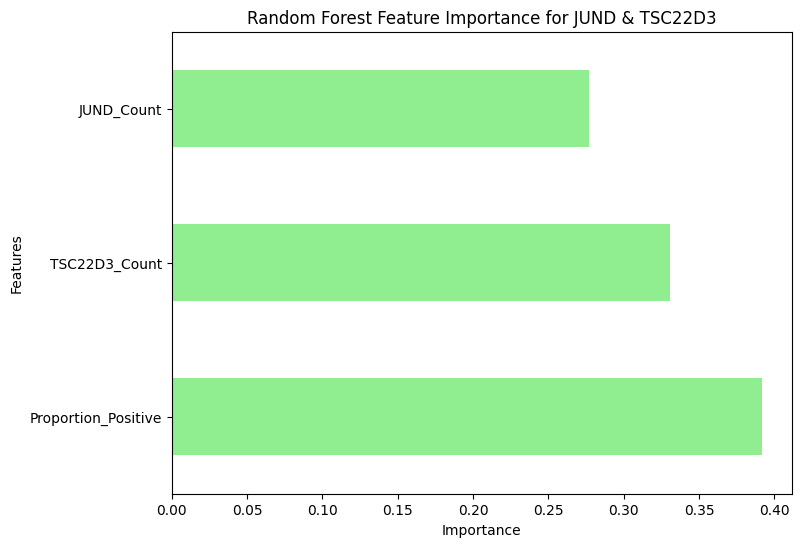


Random Forest Feature Importances for ZNF683 & TSC22D3:
TSC22D3_Count          0.383307
Proportion_Positive    0.360555
ZNF683_Count           0.256138
dtype: float64


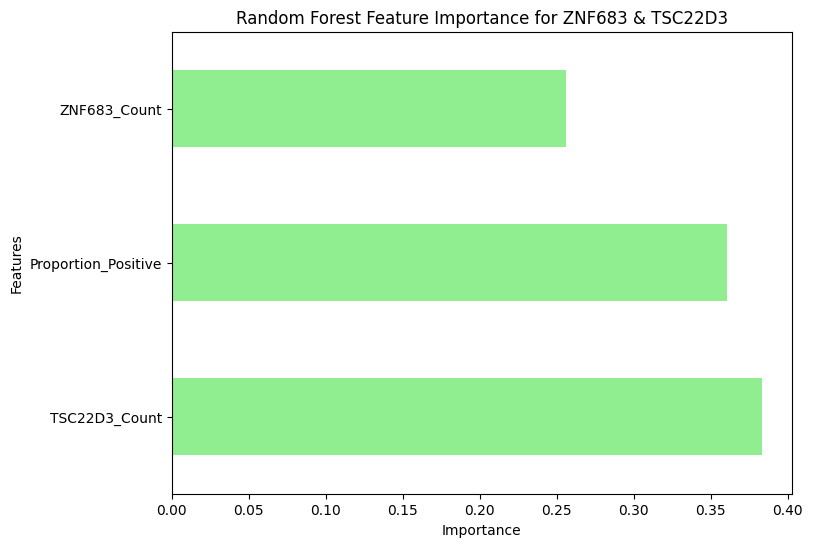


Random Forest Feature Importances for ZNF683 & TLE5:
Proportion_Positive    0.387109
TLE5_Count             0.358507
ZNF683_Count           0.254384
dtype: float64


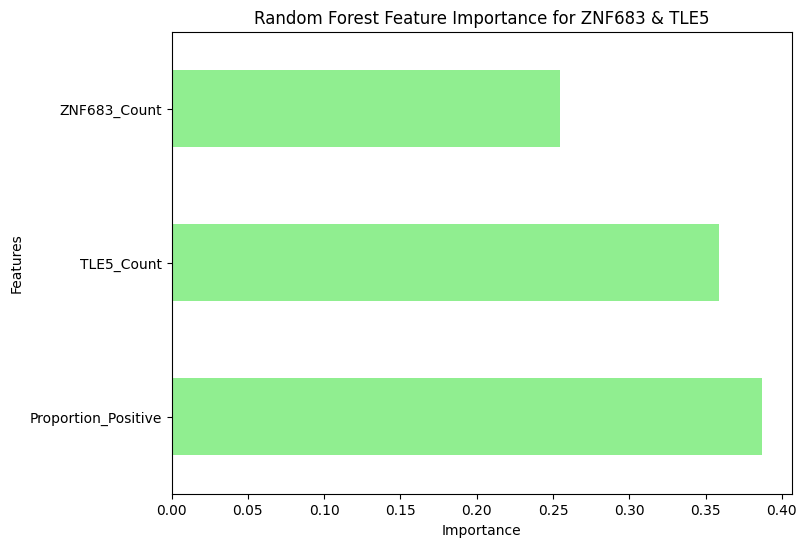


Random Forest Feature Importances for FCER1G & TSC22D3:
Proportion_Positive    0.37672
TSC22D3_Count          0.34790
FCER1G_Count           0.27538
dtype: float64


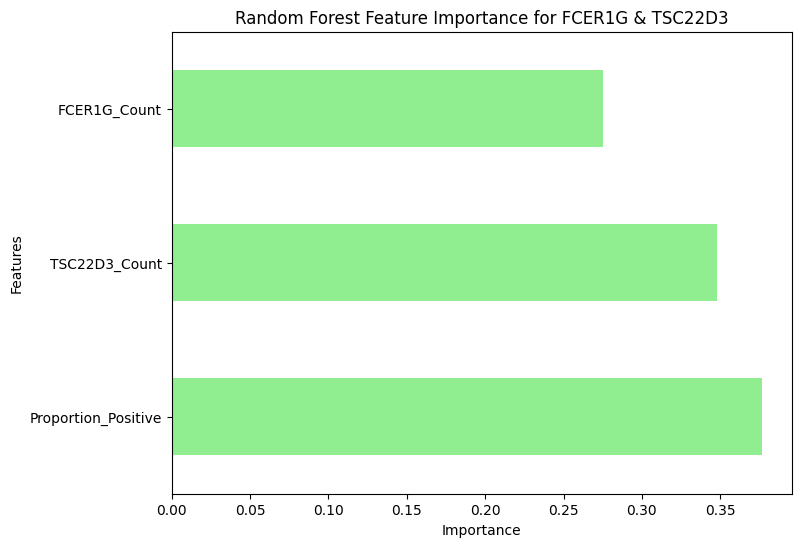


Random Forest Feature Importances for ZNF683 & MSN:
Proportion_Positive    0.379083
MSN_Count              0.365567
ZNF683_Count           0.255350
dtype: float64


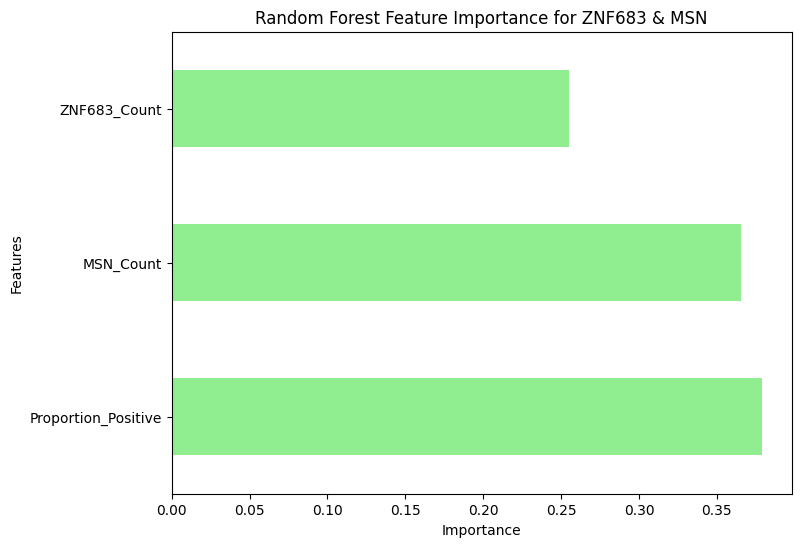


Random Forest Feature Importances for ZNF683 & CLSPN:
CLSPN_Count            0.377367
ZNF683_Count           0.315940
Proportion_Positive    0.306693
dtype: float64


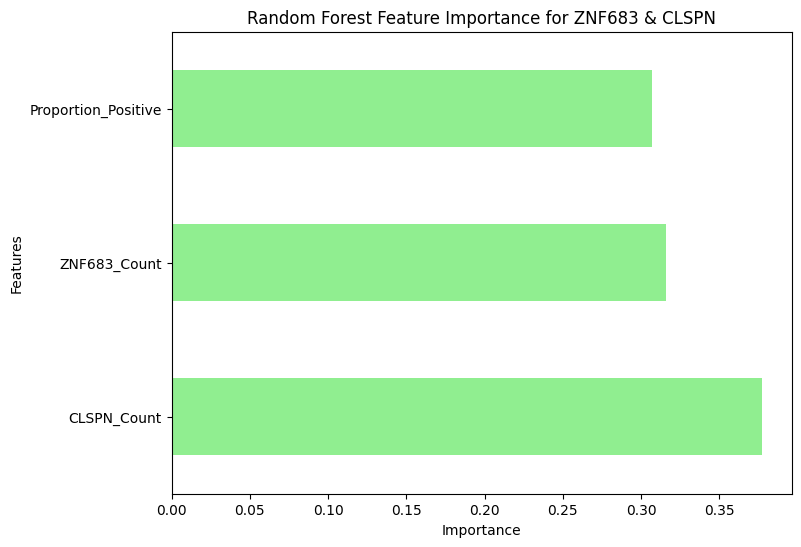


Random Forest Feature Importances for ZNF683 & TYMS:
TYMS_Count             0.374793
Proportion_Positive    0.329167
ZNF683_Count           0.296040
dtype: float64


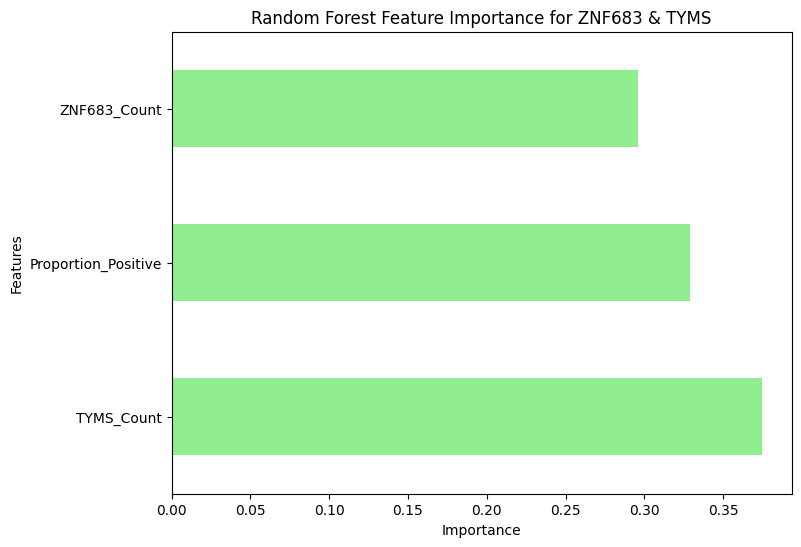


Random Forest Feature Importances for LFNG & TSC22D3:
Proportion_Positive    0.39144
TSC22D3_Count          0.33864
LFNG_Count             0.26992
dtype: float64


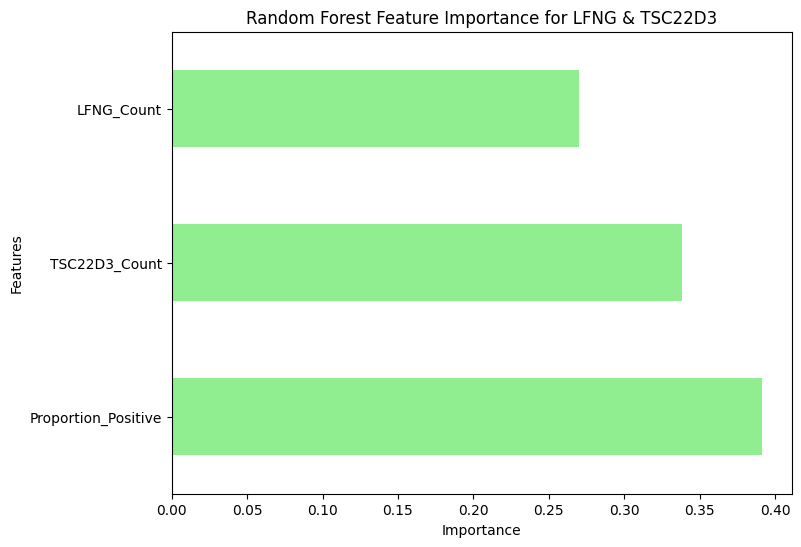


Random Forest Feature Importances for ZNF683 & PLP2:
Proportion_Positive    0.38898
PLP2_Count             0.36683
ZNF683_Count           0.24419
dtype: float64


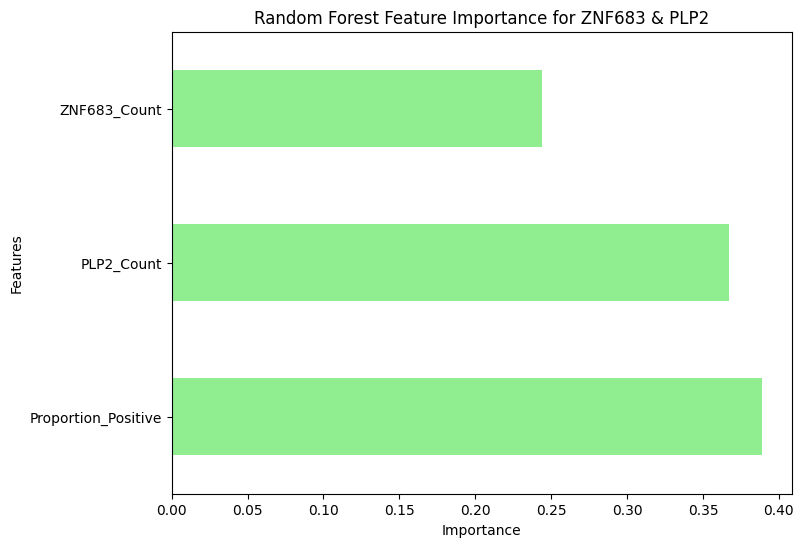


Random Forest Feature Importances for FCER1G & MAF:
MAF_Count              0.377747
Proportion_Positive    0.335420
FCER1G_Count           0.286833
dtype: float64


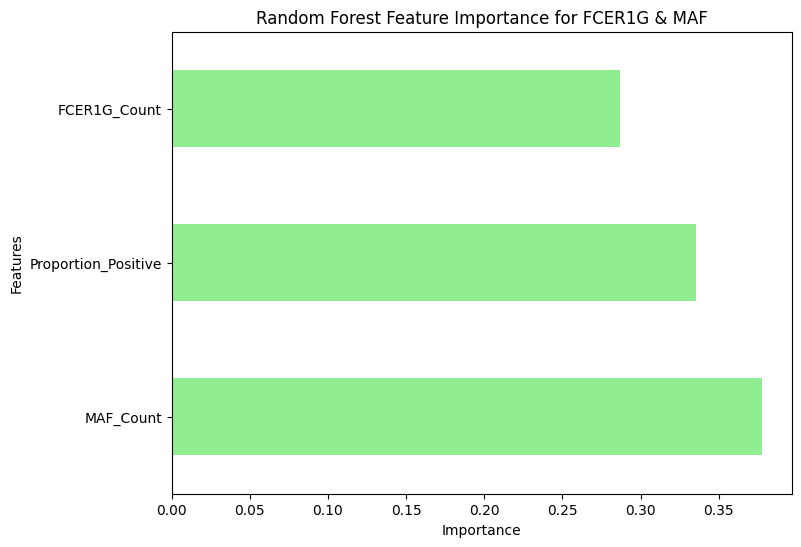

NameError: name 'result' is not defined

In [7]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
import itertools

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Encode the 'response' labels
le = LabelEncoder()
adata_CD4.obs['Response_Encoded'] = le.fit_transform(adata_CD4.obs['response'])

# Print the mapping of the encoded labels
response_mapping = dict(zip(le.classes_, le.transform(le.classes_)))
print("Response Label Mapping (Original Label -> Encoded Value):")
for label, encoded_value in response_mapping.items():
    print(f"{label} -> {encoded_value}")

# Add unique ID to each patient
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Define the pairs of genes of interest
gene_pairs = [
    ("JUND", "TSC22D3"),
    ("ZNF683", "TSC22D3"),
    ("ZNF683", "TLE5"),
    ("FCER1G", "TSC22D3"),
    ("ZNF683", "MSN"),
    ("ZNF683", "CLSPN"),
    ("ZNF683", "TYMS"),
    ("LFNG", "TSC22D3"),
    ("ZNF683", "PLP2"),
    ("FCER1G", "MAF")
]

# Prepare to store Random Forest results
rf_results = []

# Iterate over all pairs of genes
for gene1, gene2 in gene_pairs:
    # Prepare a list to store the data for each gene pair
    model_data = []

    responses = adata_CD4.obs['Response_Encoded'].unique()
    for response in responses:
        resp_adata = adata_CD4[adata_CD4.obs['Response_Encoded'] == response]
        patients = resp_adata.obs['Unique_ID'].unique()
        
        # Calculate the proportion of cells expressing both genes for each patient
        for patient in patients:
            patient_data = resp_adata[resp_adata.obs['Unique_ID'] == patient]
            
            # Ensure the data is dense if needed
            gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
            gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
            both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
            proportion = np.sum(both_genes_expr) / patient_data.shape[0]
            gene1_count = np.sum(patient_data[:, gene1].X)
            gene2_count = np.sum(patient_data[:, gene2].X)

            # Append the data for analysis
            model_data.append({
                'Patient': patient,
                'Response_Encoded': response,
                'Proportion_Positive': proportion,
                f'{gene1}_Count': gene1_count,
                f'{gene2}_Count': gene2_count
            })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)

    # Select the features and the target variable
    X = model_df[['Proportion_Positive', f'{gene1}_Count', f'{gene2}_Count']]
    y = model_df['Response_Encoded']

    # Train a Random Forest classifier
    rf = RandomForestClassifier(n_estimators=100, random_state=42)
    rf.fit(X, y)
    importances = rf.feature_importances_

    # Store the feature importances
    feature_importances = pd.Series(importances, index=X.columns).sort_values(ascending=False)
    rf_results.append({
        'Gene_Pair': f'{gene1} & {gene2}',
        'Feature_Importances': feature_importances
    })

    # Print and plot feature importances for this gene pair
    print(f"\nRandom Forest Feature Importances for {gene1} & {gene2}:")
    print(feature_importances)

    # Plotting the feature importances
    plt.figure(figsize=(8, 6))
    feature_importances.plot(kind='barh', color='lightgreen')
    plt.xlabel('Importance')
    plt.ylabel('Features')
    plt.title(f'Random Forest Feature Importance for {gene1} & {gene2}')
    plt.show()

# Combine all Random Forest results into a single DataFrame
rf_importances_df = pd.DataFrame({
    'Gene_Pair': [result['Gene_Pair'] for result in rf_results],
    'Proportion_Positive_Importance': [result['Feature_Importances']['Proportion_Positive'] for result in rf_results],
    'Gene1_Count_Importance': [result['Feature_Importances'][f'{gene1}_Count'] for gene1, gene2 in gene_pairs],
    'Gene2_Count_Importance': [result['Feature_Importances'][f'{gene2}_Count'] for gene1, gene2 in gene_pairs]
})

# Save the combined results to a CSV file
rf_importances_df.to_csv('/home/emma/result/CART/CD4_gene_pairs_rf_feature_importances.csv', index=False)

print("Random Forest analysis complete. Results exported to '/home/emma/result/CART/CD4_gene_pairs_rf_feature_importances.csv'.")

Response Label Mapping (Original Label -> Encoded Value):
NR -> 0
Non-NR -> 1

Classification Report for JUND & TSC22D3:
              precision    recall  f1-score   support

          NR       0.50      0.33      0.40         3
      Non-NR       0.80      0.89      0.84         9

    accuracy                           0.75        12
   macro avg       0.65      0.61      0.62        12
weighted avg       0.72      0.75      0.73        12



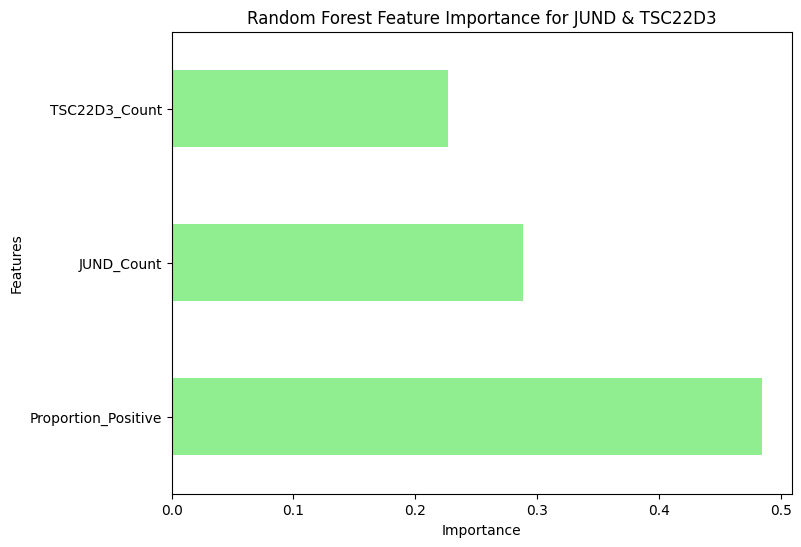


Classification Report for ZNF683 & TSC22D3:
              precision    recall  f1-score   support

          NR       0.25      0.33      0.29         3
      Non-NR       0.75      0.67      0.71         9

    accuracy                           0.58        12
   macro avg       0.50      0.50      0.50        12
weighted avg       0.62      0.58      0.60        12



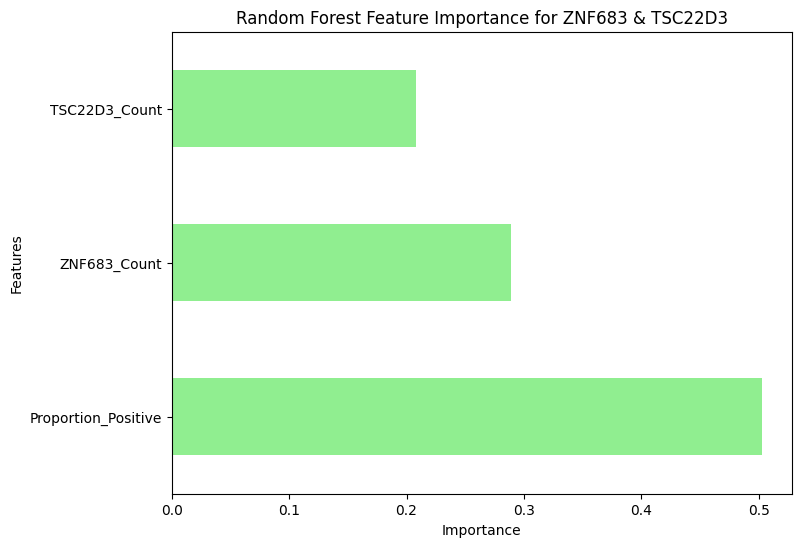


Classification Report for ZNF683 & TLE5:
              precision    recall  f1-score   support

          NR       0.33      0.33      0.33         3
      Non-NR       0.78      0.78      0.78         9

    accuracy                           0.67        12
   macro avg       0.56      0.56      0.56        12
weighted avg       0.67      0.67      0.67        12



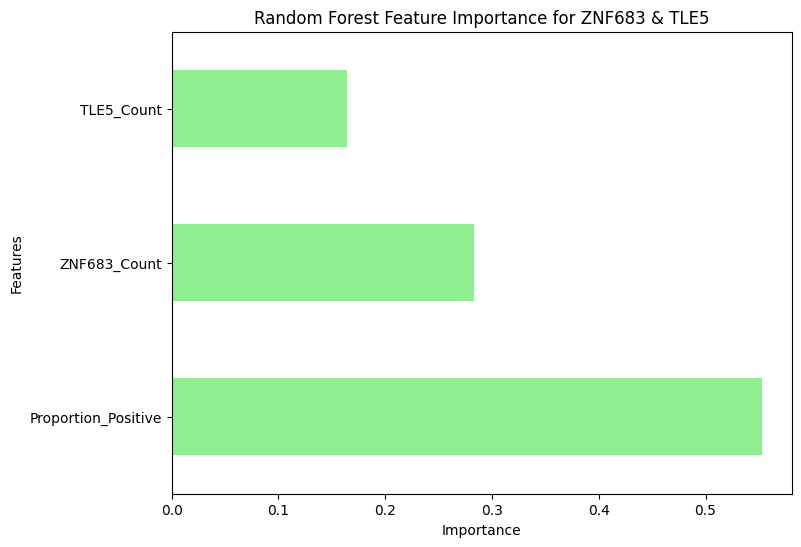


Classification Report for FCER1G & TSC22D3:
              precision    recall  f1-score   support

          NR       0.50      0.33      0.40         3
      Non-NR       0.80      0.89      0.84         9

    accuracy                           0.75        12
   macro avg       0.65      0.61      0.62        12
weighted avg       0.72      0.75      0.73        12



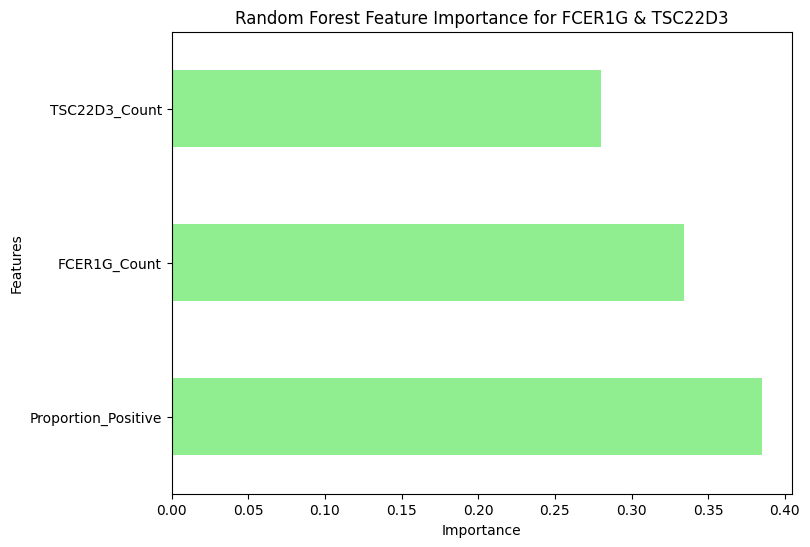


Classification Report for ZNF683 & MSN:
              precision    recall  f1-score   support

          NR       0.33      0.33      0.33         3
      Non-NR       0.78      0.78      0.78         9

    accuracy                           0.67        12
   macro avg       0.56      0.56      0.56        12
weighted avg       0.67      0.67      0.67        12



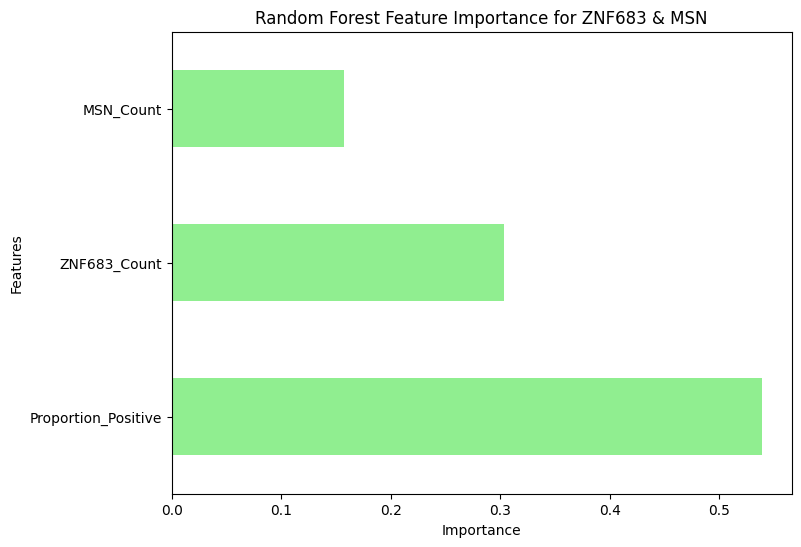


Classification Report for ZNF683 & CLSPN:
              precision    recall  f1-score   support

          NR       0.50      0.67      0.57         3
      Non-NR       0.88      0.78      0.82         9

    accuracy                           0.75        12
   macro avg       0.69      0.72      0.70        12
weighted avg       0.78      0.75      0.76        12



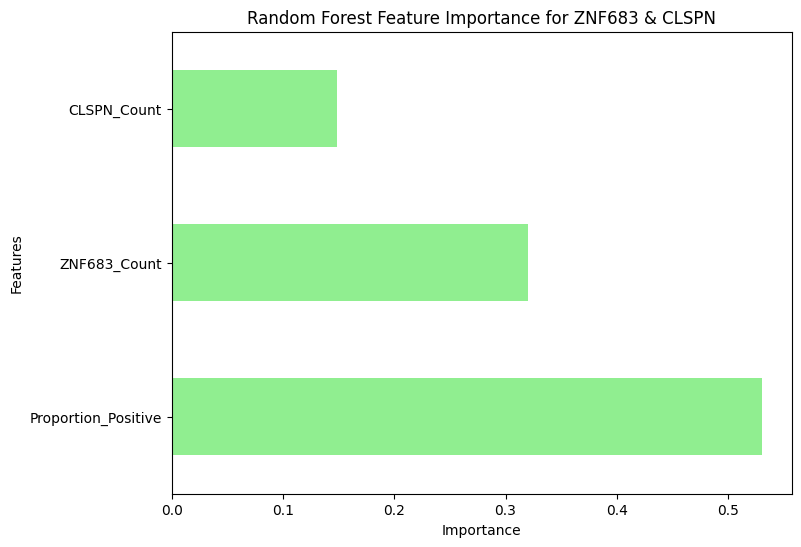


Classification Report for ZNF683 & TYMS:
              precision    recall  f1-score   support

          NR       0.50      0.67      0.57         3
      Non-NR       0.88      0.78      0.82         9

    accuracy                           0.75        12
   macro avg       0.69      0.72      0.70        12
weighted avg       0.78      0.75      0.76        12



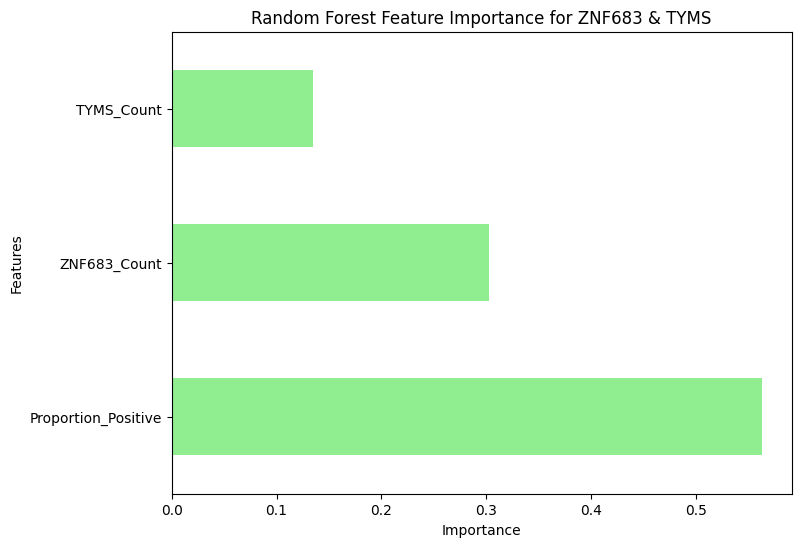


Classification Report for LFNG & TSC22D3:
              precision    recall  f1-score   support

          NR       0.50      0.33      0.40         3
      Non-NR       0.80      0.89      0.84         9

    accuracy                           0.75        12
   macro avg       0.65      0.61      0.62        12
weighted avg       0.72      0.75      0.73        12



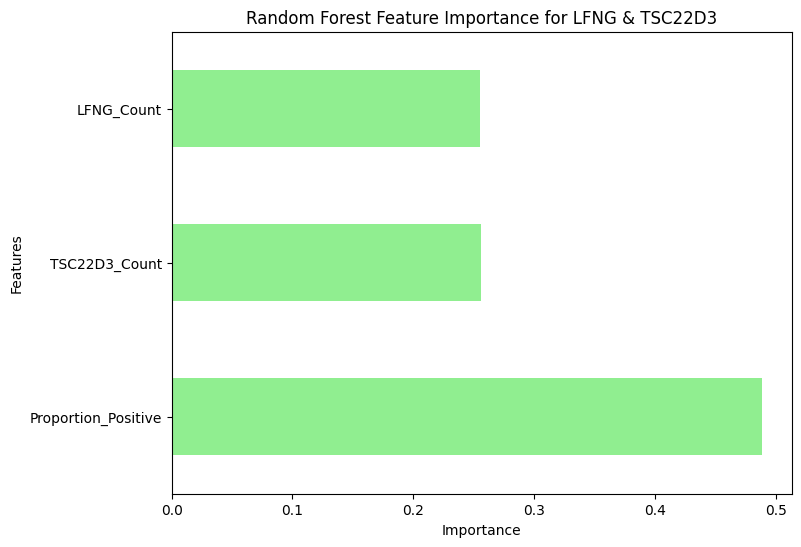


Classification Report for ZNF683 & PLP2:
              precision    recall  f1-score   support

          NR       0.33      0.33      0.33         3
      Non-NR       0.78      0.78      0.78         9

    accuracy                           0.67        12
   macro avg       0.56      0.56      0.56        12
weighted avg       0.67      0.67      0.67        12



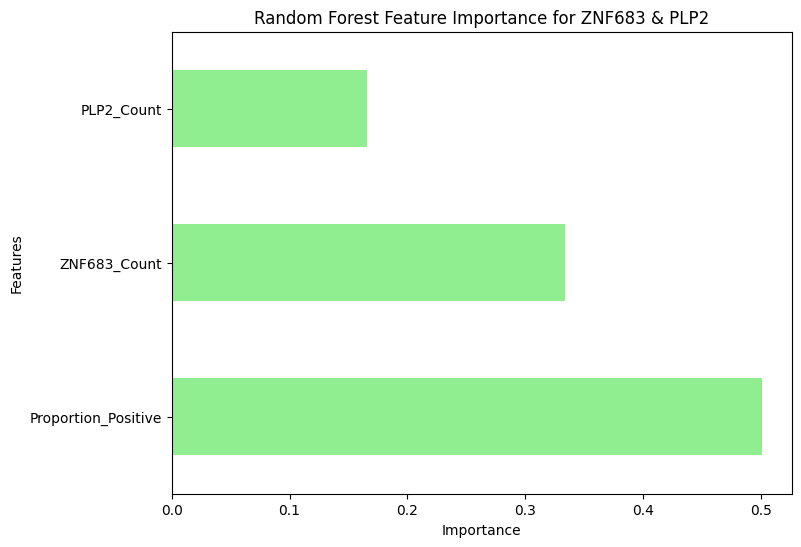


Classification Report for FCER1G & MAF:
              precision    recall  f1-score   support

          NR       0.50      0.33      0.40         3
      Non-NR       0.80      0.89      0.84         9

    accuracy                           0.75        12
   macro avg       0.65      0.61      0.62        12
weighted avg       0.72      0.75      0.73        12



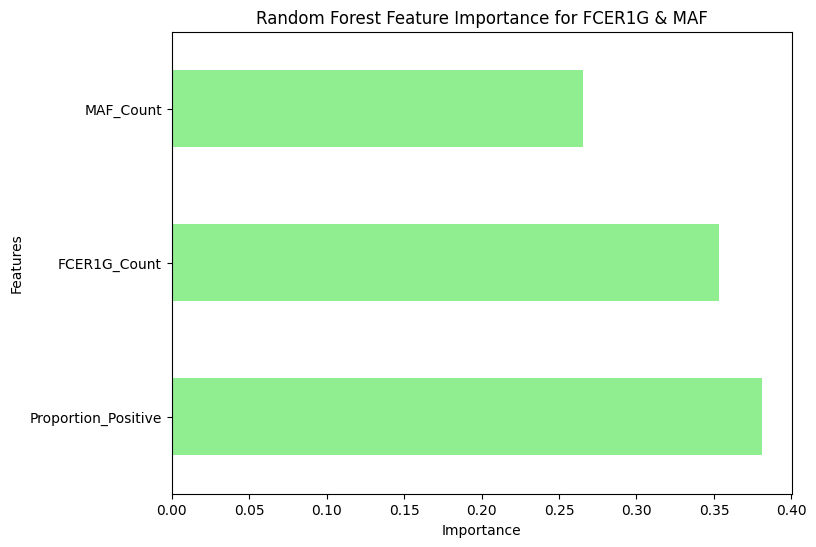

Random Forest evaluation complete. Results exported to '/home/emma/result/CART/CD4_gene_pairs_rf_evaluation_metrics.csv' and feature importance plots saved.


In [9]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import precision_score, recall_score, f1_score, classification_report
from sklearn.model_selection import train_test_split
import itertools

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Encode the 'response' labels
adata_CD4.obs['Response_Simplified'] = adata_CD4.obs['response'].replace({
    'Infusion': 'Non-NR',
    'CR': 'Non-NR',
    'NR': 'NR'
})

# Encode the simplified labels
le = LabelEncoder()
adata_CD4.obs['Response_Encoded'] = le.fit_transform(adata_CD4.obs['Response_Simplified'])

# Print the mapping of the encoded labels
response_mapping = dict(zip(le.classes_, le.transform(le.classes_)))
print("Response Label Mapping (Original Label -> Encoded Value):")
for label, encoded_value in response_mapping.items():
    print(f"{label} -> {encoded_value}")

# Add unique ID to each patient
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Define the pairs of genes of interest
gene_pairs = [
    ("JUND", "TSC22D3"),
    ("ZNF683", "TSC22D3"),
    ("ZNF683", "TLE5"),
    ("FCER1G", "TSC22D3"),
    ("ZNF683", "MSN"),
    ("ZNF683", "CLSPN"),
    ("ZNF683", "TYMS"),
    ("LFNG", "TSC22D3"),
    ("ZNF683", "PLP2"),
    ("FCER1G", "MAF")
]

# Prepare to store results for each gene pair
evaluation_results = []

# Iterate over all pairs of genes
for gene1, gene2 in gene_pairs:
    # Prepare a list to store the data for each gene pair
    model_data = []

    responses = adata_CD4.obs['Response_Encoded'].unique()
    for response in responses:
        resp_adata = adata_CD4[adata_CD4.obs['Response_Encoded'] == response]
        patients = resp_adata.obs['Unique_ID'].unique()
        
        # Calculate the proportion of cells expressing both genes for each patient
        for patient in patients:
            patient_data = resp_adata[resp_adata.obs['Unique_ID'] == patient]
            
            # Ensure the data is dense if needed
            gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
            gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
            both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
            proportion = np.sum(both_genes_expr) / patient_data.shape[0]
            gene1_count = np.sum(patient_data[:, gene1].X)
            gene2_count = np.sum(patient_data[:, gene2].X)

            # Append the data for analysis
            model_data.append({
                'Patient': patient,
                'Response_Encoded': response,
                'Proportion_Positive': proportion,
                f'{gene1}_Count': gene1_count,
                f'{gene2}_Count': gene2_count
            })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)

    # Select the features and the target variable
    X = model_df[['Proportion_Positive', f'{gene1}_Count', f'{gene2}_Count']]
    y = model_df['Response_Encoded']

    # Split the data into training and test sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

    # Train a Random Forest classifier
    rf = RandomForestClassifier(n_estimators=100, random_state=42)
    rf.fit(X_train, y_train)

    # Predict on the test set
    y_pred = rf.predict(X_test)

    # Calculate precision, recall, and F1-score
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    f1 = f1_score(y_test, y_pred, average='weighted')

    # Store the results
    evaluation_results.append({
        'Gene_Pair': f'{gene1} & {gene2}',
        'Precision': precision,
        'Recall': recall,
        'F1_Score': f1
    })

    # Print the classification report
    print(f"\nClassification Report for {gene1} & {gene2}:")
    print(classification_report(y_test, y_pred, target_names=le.classes_))

    # Get and plot feature importances
    feature_importances = pd.Series(rf.feature_importances_, index=X.columns).sort_values(ascending=False)

    plt.figure(figsize=(8, 6))
    feature_importances.plot(kind='barh', color='lightgreen')
    plt.xlabel('Importance')
    plt.ylabel('Features')
    plt.title(f'Random Forest Feature Importance for {gene1} & {gene2}')
    plt.savefig(f'/home/emma/result/CART/{gene1}_{gene2}_rf_feature_importance.png')
    plt.show()

# Convert the evaluation results to a DataFrame
evaluation_df = pd.DataFrame(evaluation_results)

# Save the results to a CSV file
evaluation_df.to_csv('/home/emma/result/CART/CD4_gene_pairs_rf_evaluation_metrics.csv', index=False)

print("Random Forest evaluation complete. Results exported to '/home/emma/result/CART/CD4_gene_pairs_rf_evaluation_metrics.csv' and feature importance plots saved.")


In [13]:
import scanpy as sc
import numpy as np
import pandas as pd
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.model_selection import train_test_split
import xgboost as xgb
import itertools

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Encode the 'response' labels
adata_CD4.obs['Response_Simplified'] = adata_CD4.obs['response'].replace({
    'Infusion': 'Non-NR',
    'CR': 'Non-NR',
    'NR': 'NR'
})

# Encode the simplified labels
le = LabelEncoder()
adata_CD4.obs['Response_Encoded'] = le.fit_transform(adata_CD4.obs['Response_Simplified'])

# Print the mapping of the encoded labels
response_mapping = dict(zip(le.classes_, le.transform(le.classes_)))
print("Response Label Mapping (Original Label -> Encoded Value):")
for label, encoded_value in response_mapping.items():
    print(f"{label} -> {encoded_value}")

# Add unique ID to each patient
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Define the list of gene pairs
gene_pairs = [
    ("JUND", "TSC22D3"), ("ZNF683", "TSC22D3"), ("ZNF683", "TLE5"),
    ("FCER1G", "TSC22D3"), ("ZNF683", "MSN"), ("ZNF683", "CLSPN"),
    ("ZNF683", "TYMS"), ("LFNG", "TSC22D3"), ("ZNF683", "PLP2"),
    ("FCER1G", "MAF"), ("ZNF683", "GINS2"), ("FCER1G", "TLE5"),
    ("ZNF683", "CTSW"), ("FCER1G", "MSN"), ("PECAM1", "TSC22D3"),
    ("FCER1G", "ZNF683"), ("ZNF683", "MATK"), ("FCER1G", "LFNG"),
    ("ZNF683", "RRM2"), ("JUND", "ZNF683"), ("FCER1G", "KLRK1"),
    ("FCER1G", "TYMS"), ("ZNF683", "LFNG"), ("ZNF683", "IFITM3"),
    ("FCER1G", "RRM2"), ("TSC22D3", "MSN"), ("FCER1G", "PLP2"),
    ("PECAM1", "KLRK1"), ("LFNG", "MSN"), ("FCER1G", "GINS2"),
    ("TLE5", "LFNG"), ("FCER1G", "JUND"), ("TSC22D3", "RRM2"),
    ("ZNF683", "MAF"), ("PECAM1", "MSN"), ("FCER1G", "CLSPN"),
    ("FCER1G", "CTSW"), ("KLRK1", "TSC22D3"), ("JUND", "MSN"),
    ("TSC22D3", "TYMS"), ("PECAM1", "LFNG"), ("PECAM1", "TLE5"),
    ("JUND", "TLE5"), ("KLRK1", "JUND"), ("PECAM1", "ZNF683"),
    ("PECAM1", "FCER1G"), ("JUND", "LFNG"), ("PECAM1", "JUND"),
    ("KLRK1", "ZNF683"), ("TSC22D3", "GINS2"), ("TSC22D3", "MAF"),
    ("KLRK1", "LFNG"), ("KLRK1", "IFITM3"), ("JUND", "CTSW"),
    ("PECAM1", "CTSW"), ("KLRK1", "TLE5"), ("TSC22D3", "PLP2"),
    ("TSC22D3", "IFITM3"), ("LFNG", "CTSW"), ("CD7", "ZNF683"),
    ("LFNG", "IFITM3"), ("LFNG", "MATK"), ("TSC22D3", "MATK"),
    ("TLE5", "MSN"), ("TSC22D3", "CLSPN"), ("TSC22D3", "CTSW")
]

# Prepare to store results for each gene pair
evaluation_results = []

# Define common XGBoost parameters
xgb_params = {
    'n_estimators': 100,
    'random_state': 42,
    'use_label_encoder': False,
    'eval_metric': 'logloss'
}

# Iterate over all pairs of genes
for gene1, gene2 in gene_pairs:
    # Prepare a list to store the data for each gene pair
    model_data = []

    responses = adata_CD4.obs['Response_Encoded'].unique()
    for response in responses:
        resp_adata = adata_CD4[adata_CD4.obs['Response_Encoded'] == response]
        patients = resp_adata.obs['Unique_ID'].unique()
        
        # Calculate the proportion of cells expressing both genes for each patient
        for patient in patients:
            patient_data = resp_adata[resp_adata.obs['Unique_ID'] == patient]
            
            # Ensure the data is dense if needed
            gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
            gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
            both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
            proportion = np.sum(both_genes_expr) / patient_data.shape[0]
            gene1_count = np.sum(patient_data[:, gene1].X)
            gene2_count = np.sum(patient_data[:, gene2].X)

            # Append the data for analysis
            model_data.append({
                'Patient': patient,
                'Response_Encoded': response,
                'Proportion_Positive': proportion,
                f'{gene1}_Count': gene1_count,
                f'{gene2}_Count': gene2_count
            })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)

    # Select the features and the target variable
    X = model_df[['Proportion_Positive', f'{gene1}_Count', f'{gene2}_Count']]
    y = model_df['Response_Encoded']

    # Split the data into training and test sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

    # Train an XGBoost classifier using the common parameters
    xgb_model = xgb.XGBClassifier(**xgb_params)
    xgb_model.fit(X_train, y_train)

    # Predict on the test set
    y_pred = xgb_model.predict(X_test)

    # Calculate accuracy, precision, recall, and F1-score
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    f1 = f1_score(y_test, y_pred, average='weighted')

    # Store the results
    evaluation_results.append({
        'Gene_Pair': f'{gene1} & {gene2}',
        'Accuracy': accuracy,
        'Precision': precision,
        'Recall': recall,
        'F1_Score': f1
    })

# Convert the evaluation results to a DataFrame
evaluation_df = pd.DataFrame(evaluation_results)

# Save the results to a CSV file
evaluation_df.to_csv('/home/emma/result/CART/CD4_gene_pairs_xgb_evaluation_metrics.csv', index=False)

print("XGBoost evaluation complete. Results exported to '/home/emma/result/CART/CD4_gene_pairs_xgb_evaluation_metrics.csv'.")


Response Label Mapping (Original Label -> Encoded Value):
NR -> 0
Non-NR -> 1


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.wa

XGBoost evaluation complete. Results exported to '/home/emma/result/CART/CD4_gene_pairs_xgb_evaluation_metrics.csv'.


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")


Response Label Mapping (Original Label -> Encoded Value):
NR -> 0
Non-NR -> 1

Classification Report for JUND & TSC22D3:
              precision    recall  f1-score   support

          NR       0.33      0.33      0.33         3
      Non-NR       0.78      0.78      0.78         9

    accuracy                           0.67        12
   macro avg       0.56      0.56      0.56        12
weighted avg       0.67      0.67      0.67        12



/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")


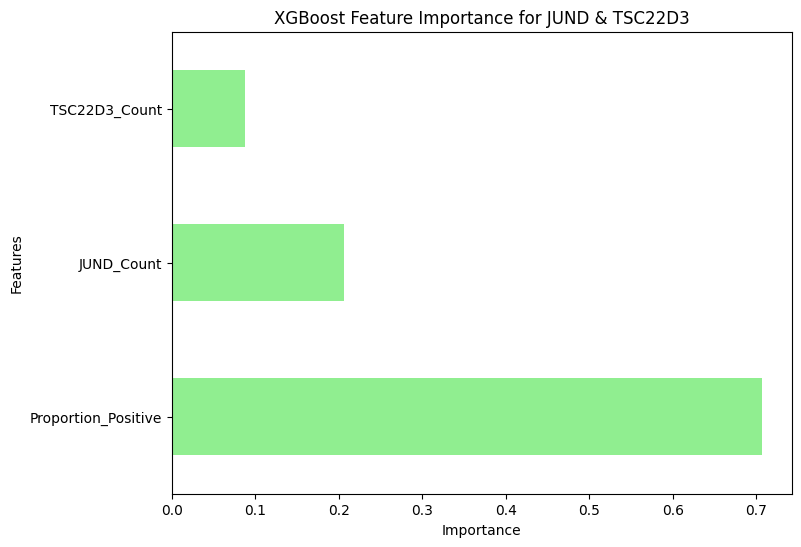

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")



Classification Report for ZNF683 & TSC22D3:
              precision    recall  f1-score   support

          NR       0.25      0.33      0.29         3
      Non-NR       0.75      0.67      0.71         9

    accuracy                           0.58        12
   macro avg       0.50      0.50      0.50        12
weighted avg       0.62      0.58      0.60        12



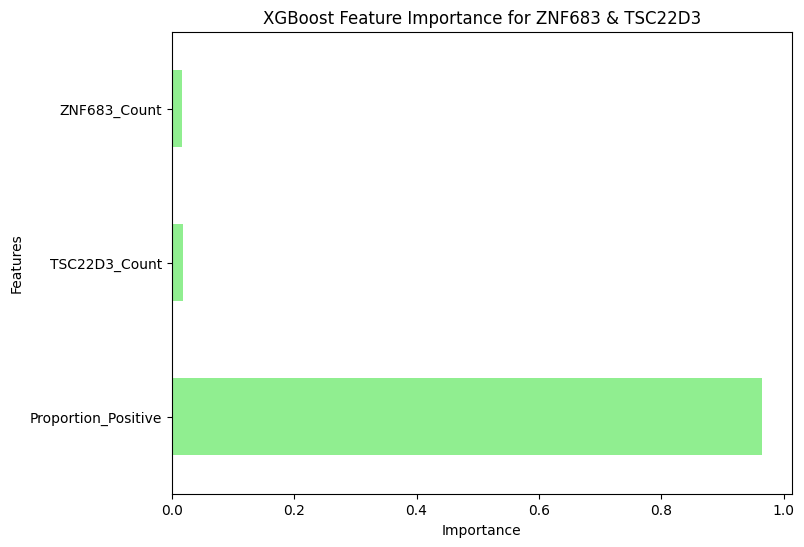


Classification Report for ZNF683 & TLE5:
              precision    recall  f1-score   support

          NR       0.50      0.67      0.57         3
      Non-NR       0.88      0.78      0.82         9

    accuracy                           0.75        12
   macro avg       0.69      0.72      0.70        12
weighted avg       0.78      0.75      0.76        12



/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")


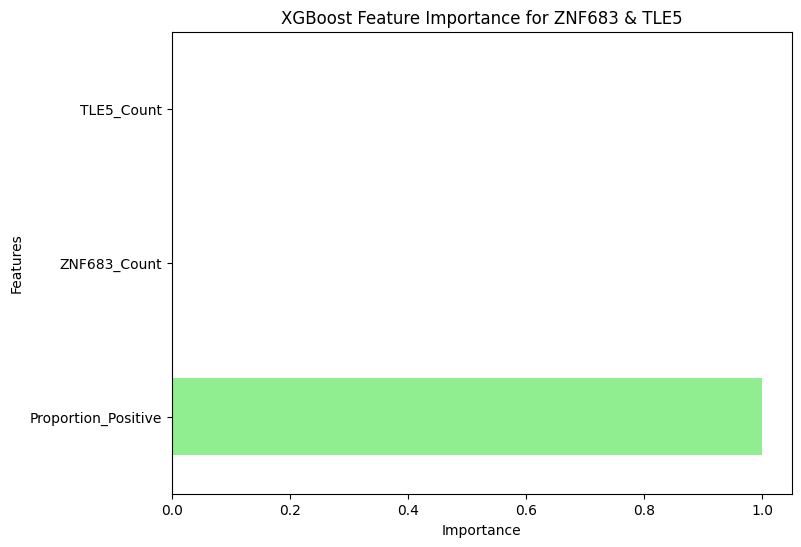

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")



Classification Report for FCER1G & TSC22D3:
              precision    recall  f1-score   support

          NR       1.00      0.33      0.50         3
      Non-NR       0.82      1.00      0.90         9

    accuracy                           0.83        12
   macro avg       0.91      0.67      0.70        12
weighted avg       0.86      0.83      0.80        12



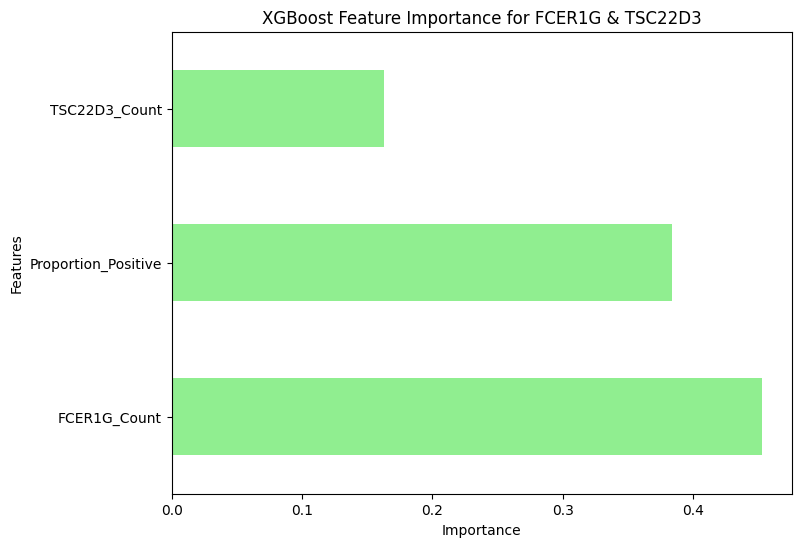


Classification Report for ZNF683 & MSN:
              precision    recall  f1-score   support

          NR       0.33      0.33      0.33         3
      Non-NR       0.78      0.78      0.78         9

    accuracy                           0.67        12
   macro avg       0.56      0.56      0.56        12
weighted avg       0.67      0.67      0.67        12



/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")


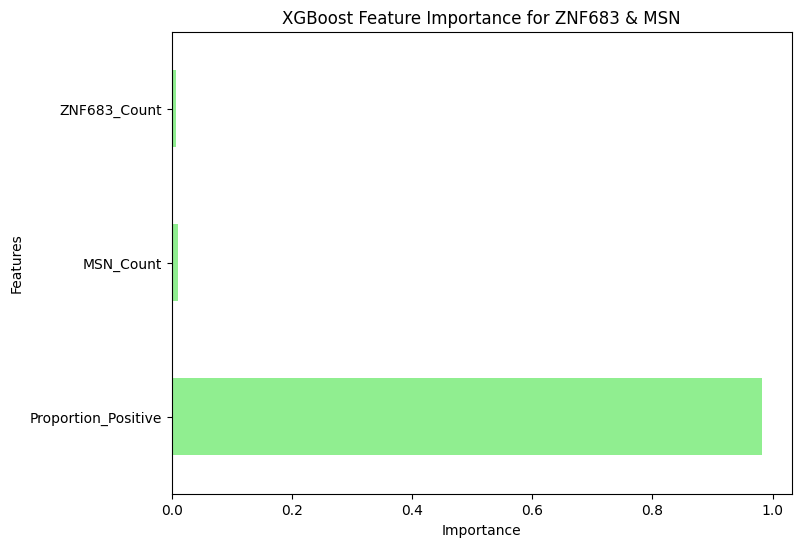


Classification Report for ZNF683 & CLSPN:
              precision    recall  f1-score   support

          NR       0.50      0.67      0.57         3
      Non-NR       0.88      0.78      0.82         9

    accuracy                           0.75        12
   macro avg       0.69      0.72      0.70        12
weighted avg       0.78      0.75      0.76        12



/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")


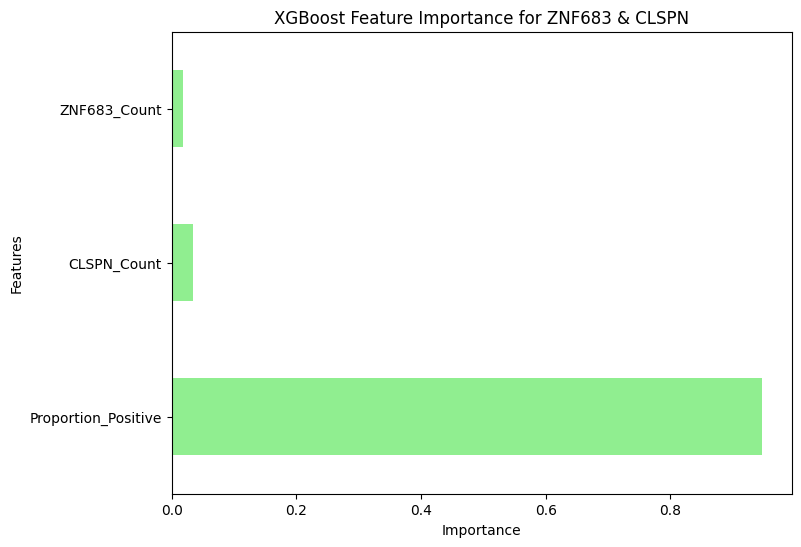


Classification Report for ZNF683 & TYMS:
              precision    recall  f1-score   support

          NR       0.50      0.67      0.57         3
      Non-NR       0.88      0.78      0.82         9

    accuracy                           0.75        12
   macro avg       0.69      0.72      0.70        12
weighted avg       0.78      0.75      0.76        12



/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")


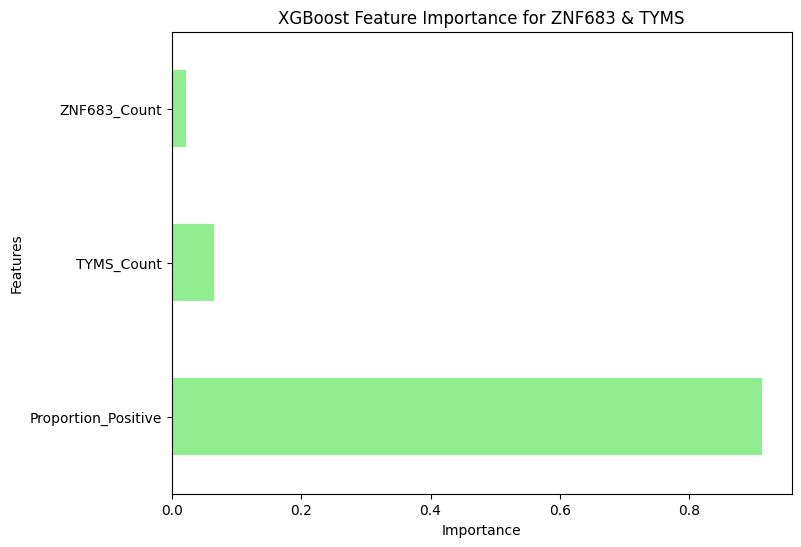


Classification Report for LFNG & TSC22D3:
              precision    recall  f1-score   support

          NR       0.50      0.67      0.57         3
      Non-NR       0.88      0.78      0.82         9

    accuracy                           0.75        12
   macro avg       0.69      0.72      0.70        12
weighted avg       0.78      0.75      0.76        12



/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")


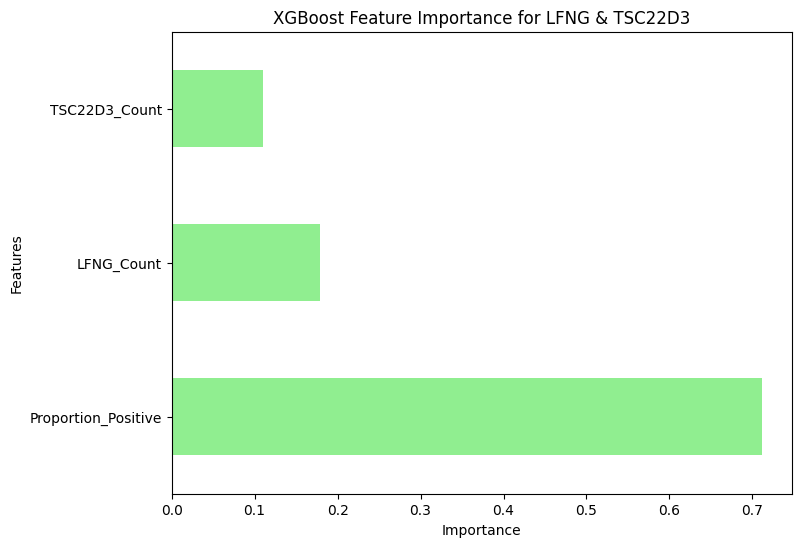


Classification Report for ZNF683 & PLP2:
              precision    recall  f1-score   support

          NR       0.33      0.33      0.33         3
      Non-NR       0.78      0.78      0.78         9

    accuracy                           0.67        12
   macro avg       0.56      0.56      0.56        12
weighted avg       0.67      0.67      0.67        12



/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")


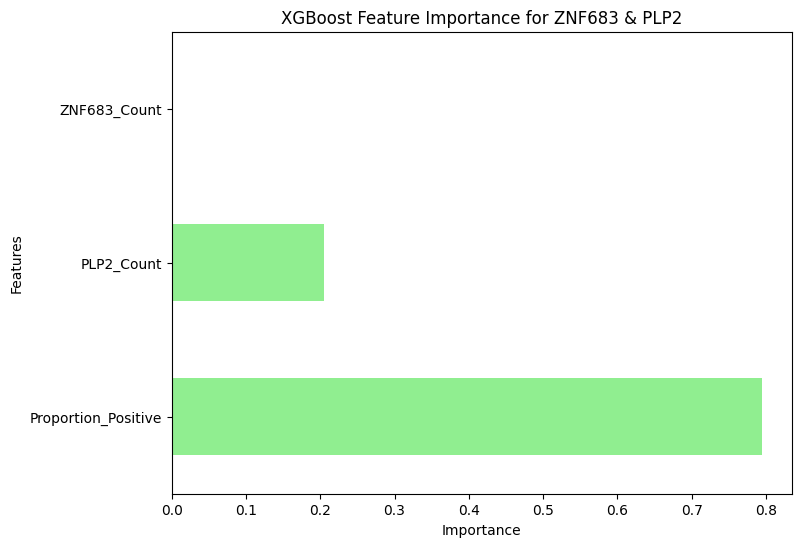


Classification Report for FCER1G & MAF:
              precision    recall  f1-score   support

          NR       0.50      0.33      0.40         3
      Non-NR       0.80      0.89      0.84         9

    accuracy                           0.75        12
   macro avg       0.65      0.61      0.62        12
weighted avg       0.72      0.75      0.73        12



/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/xgboost/sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")


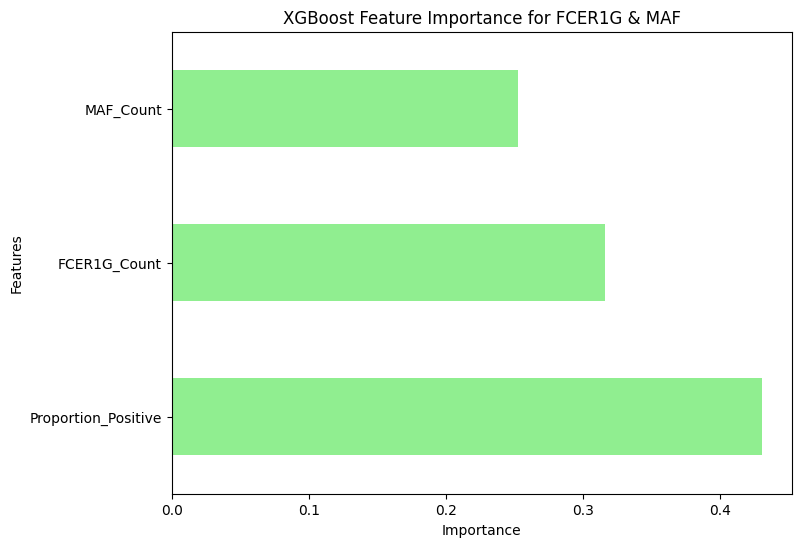

XGBoost evaluation complete. Results exported to '/home/emma/result/CART/CD4_gene_pairs_xgb_evaluation_metrics.csv' and feature importance plots saved.


In [11]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import precision_score, recall_score, f1_score, classification_report
from sklearn.model_selection import train_test_split
import xgboost as xgb
import itertools

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Encode the 'response' labels
adata_CD4.obs['Response_Simplified'] = adata_CD4.obs['response'].replace({
    'Infusion': 'Non-NR',
    'CR': 'Non-NR',
    'NR': 'NR'
})

# Encode the simplified labels
le = LabelEncoder()
adata_CD4.obs['Response_Encoded'] = le.fit_transform(adata_CD4.obs['Response_Simplified'])

# Print the mapping of the encoded labels
response_mapping = dict(zip(le.classes_, le.transform(le.classes_)))
print("Response Label Mapping (Original Label -> Encoded Value):")
for label, encoded_value in response_mapping.items():
    print(f"{label} -> {encoded_value}")

# Add unique ID to each patient
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Define the pairs of genes of interest
gene_pairs = [
    ("JUND", "TSC22D3"),
    ("ZNF683", "TSC22D3"),
    ("ZNF683", "TLE5"),
    ("FCER1G", "TSC22D3"),
    ("ZNF683", "MSN"),
    ("ZNF683", "CLSPN"),
    ("ZNF683", "TYMS"),
    ("LFNG", "TSC22D3"),
    ("ZNF683", "PLP2"),
    ("FCER1G", "MAF")
]

# Prepare to store results for each gene pair
evaluation_results = []

# Iterate over all pairs of genes
for gene1, gene2 in gene_pairs:
    # Prepare a list to store the data for each gene pair
    model_data = []

    responses = adata_CD4.obs['Response_Encoded'].unique()
    for response in responses:
        resp_adata = adata_CD4[adata_CD4.obs['Response_Encoded'] == response]
        patients = resp_adata.obs['Unique_ID'].unique()
        
        # Calculate the proportion of cells expressing both genes for each patient
        for patient in patients:
            patient_data = resp_adata[resp_adata.obs['Unique_ID'] == patient]
            
            # Ensure the data is dense if needed
            gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
            gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
            both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
            proportion = np.sum(both_genes_expr) / patient_data.shape[0]
            gene1_count = np.sum(patient_data[:, gene1].X)
            gene2_count = np.sum(patient_data[:, gene2].X)

            # Append the data for analysis
            model_data.append({
                'Patient': patient,
                'Response_Encoded': response,
                'Proportion_Positive': proportion,
                f'{gene1}_Count': gene1_count,
                f'{gene2}_Count': gene2_count
            })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)

    # Select the features and the target variable
    X = model_df[['Proportion_Positive', f'{gene1}_Count', f'{gene2}_Count']]
    y = model_df['Response_Encoded']

    # Split the data into training and test sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

    # Train an XGBoost classifier
    xgb_model = xgb.XGBClassifier(n_estimators=100, random_state=42, use_label_encoder=False, eval_metric='logloss')
    xgb_model.fit(X_train, y_train)

    # Predict on the test set
    y_pred = xgb_model.predict(X_test)

    # Calculate precision, recall, and F1-score
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    f1 = f1_score(y_test, y_pred, average='weighted')

    # Store the results
    evaluation_results.append({
        'Gene_Pair': f'{gene1} & {gene2}',
        'Precision': precision,
        'Recall': recall,
        'F1_Score': f1
    })

    # Print the classification report
    print(f"\nClassification Report for {gene1} & {gene2}:")
    print(classification_report(y_test, y_pred, target_names=le.classes_))

    # Get and plot feature importances
    feature_importances = pd.Series(xgb_model.feature_importances_, index=X.columns).sort_values(ascending=False)

    plt.figure(figsize=(8, 6))
    feature_importances.plot(kind='barh', color='lightgreen')
    plt.xlabel('Importance')
    plt.ylabel('Features')
    plt.title(f'XGBoost Feature Importance for {gene1} & {gene2}')
    plt.savefig(f'/home/emma/result/CART/{gene1}_{gene2}_xgb_feature_importance.png')
    plt.show()

# Convert the evaluation results to a DataFrame
evaluation_df = pd.DataFrame(evaluation_results)

# Save the results to a CSV file
evaluation_df.to_csv('/home/emma/result/CART/CD4_gene_pairs_xgb_evaluation_metrics.csv', index=False)

print("XGBoost evaluation complete. Results exported to '/home/emma/result/CART/CD4_gene_pairs_xgb_evaluation_metrics.csv' and feature importance plots saved.")


In [2]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
import scikit_posthocs as sp
import itertools

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Encode the 'response' labels
le = LabelEncoder()
adata_CD4.obs['Response_Encoded'] = le.fit_transform(adata_CD4.obs['response'])

# Print the mapping of the encoded labels
response_mapping = dict(zip(le.classes_, le.transform(le.classes_)))
print("Response Label Mapping (Original Label -> Encoded Value):")
for label, encoded_value in response_mapping.items():
    print(f"{label} -> {encoded_value}")

# Add unique ID to each patient
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Define the pairs of genes of interest
gene_pairs = [
    ("FCER1G", "ZNF683"),
    ("FCER1G", "LFNG"),
    ("PECAM1", "LFNG")
]

# Prepare to store results in a single DataFrame
all_results = []

# Iterate over all pairs of genes
for gene1, gene2 in gene_pairs:
    # Prepare a list to store the data for each gene pair
    model_data = []

    responses = adata_CD4.obs['Response_Encoded'].unique()
    for response in responses:
        resp_adata = adata_CD4[adata_CD4.obs['Response_Encoded'] == response]
        patients = resp_adata.obs['Unique_ID'].unique()
        
        # Calculate the proportion of cells expressing both genes for each patient
        for patient in patients:
            patient_data = resp_adata[resp_adata.obs['Unique_ID'] == patient]
            
            # Ensure the data is dense if needed
            gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
            gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
            both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
            proportion = np.sum(both_genes_expr) / patient_data.shape[0]
            gene1_count = np.sum(patient_data[:, gene1].X)
            gene2_count = np.sum(patient_data[:, gene2].X)

            # Append the data for analysis
            model_data.append({
                'Patient': patient,
                'Response_Encoded': response,
                'Proportion_Positive': proportion,
                f'{gene1}_Count': gene1_count,
                f'{gene2}_Count': gene2_count
            })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)

    # Normalize the variables using Z-scores
    model_df['Proportion_Positive_Z'] = zscore(model_df['Proportion_Positive'])
    model_df[f'{gene1}_Count_Z'] = zscore(model_df[f'{gene1}_Count'])
    model_df[f'{gene2}_Count_Z'] = zscore(model_df[f'{gene2}_Count'])

    # Perform Dunn's Post-Hoc Test for each pairwise comparison and collect results
    for variable in ['Proportion_Positive_Z', f'{gene1}_Count_Z', f'{gene2}_Count_Z']:
        dunn_results = sp.posthoc_dunn(
            model_df,
            val_col=variable,
            group_col='Response_Encoded',
            p_adjust='bonferroni'
        )
        all_results.append({
            'Gene_Pair': f'{gene1} & {gene2}',
            'Variable': variable,
            'CR vs NR': dunn_results.loc[response_mapping['CR'], response_mapping['NR']],
            'Infusion vs CR': dunn_results.loc[response_mapping['Infusion'], response_mapping['CR']],
            'Infusion vs NR': dunn_results.loc[response_mapping['Infusion'], response_mapping['NR']]
        })

# Convert the collected results to a single DataFrame
results_df = pd.DataFrame(all_results)

# Save the combined results to a single CSV file
results_df.to_csv('/home/emma/result/CART/CD4_gene_pairs_dunn_results_adjusted.csv', index=False)

print("Analysis complete. Results exported to '/home/emma/result/CART/CD4_gene_pairs_dunn_results_adjusted.csv'.")

Response Label Mapping (Original Label -> Encoded Value):
CR -> 0
Infusion -> 1
NR -> 2
Analysis complete. Results exported to '/home/emma/result/CART/CD4_gene_pairs_dunn_results_adjusted.csv'.


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


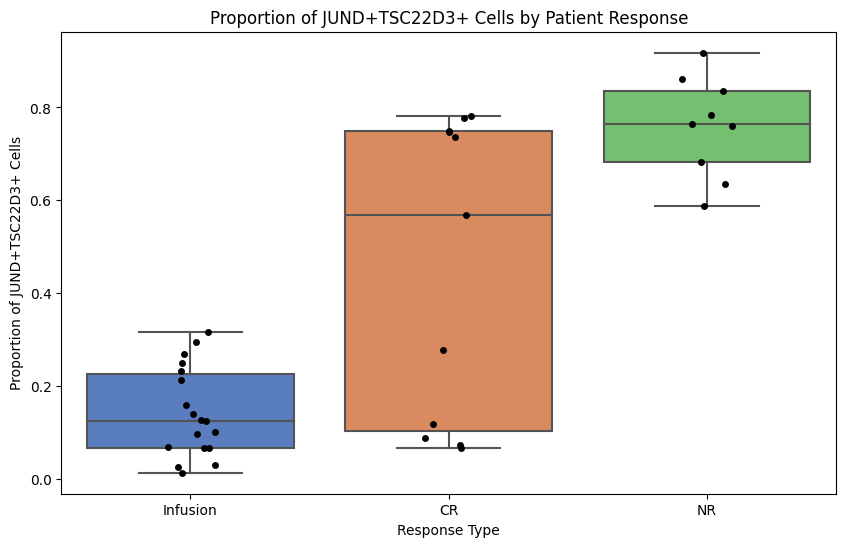

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


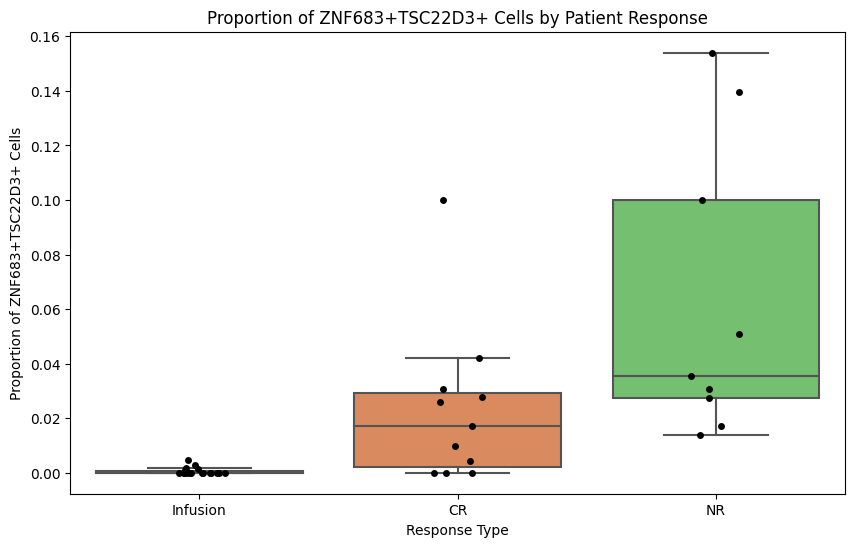

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


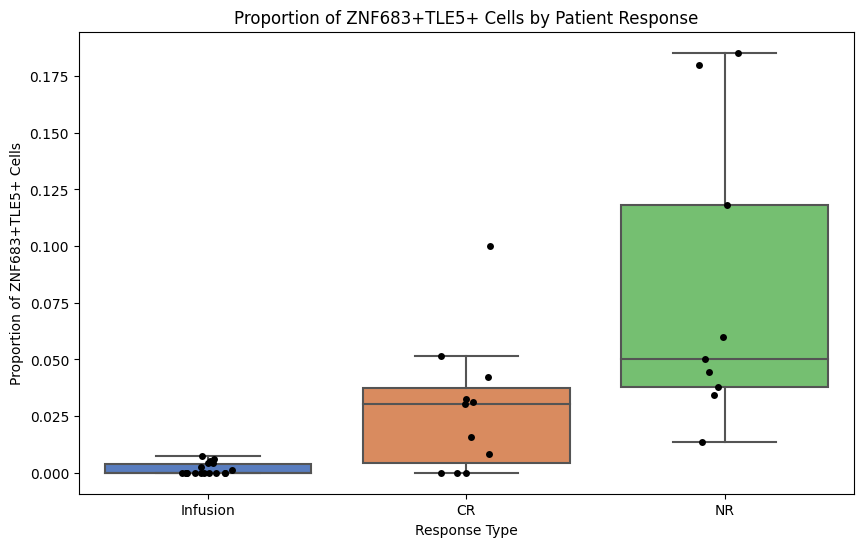

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


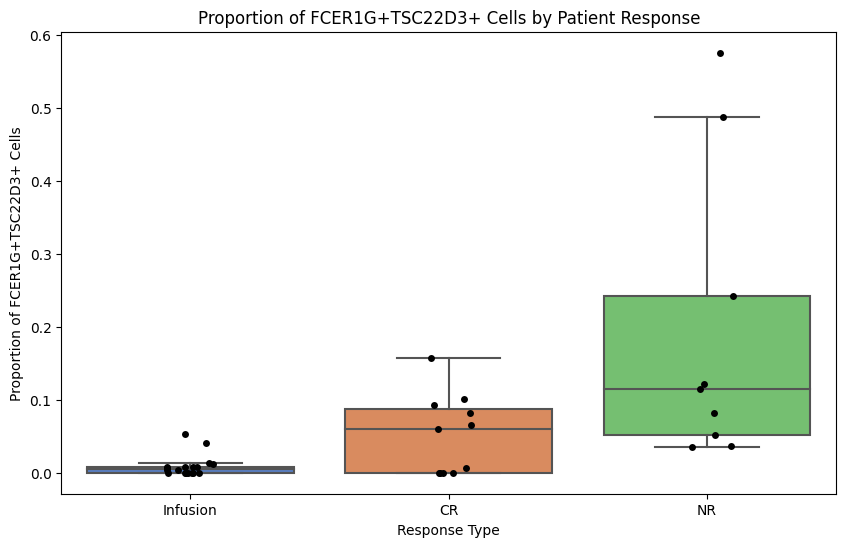

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


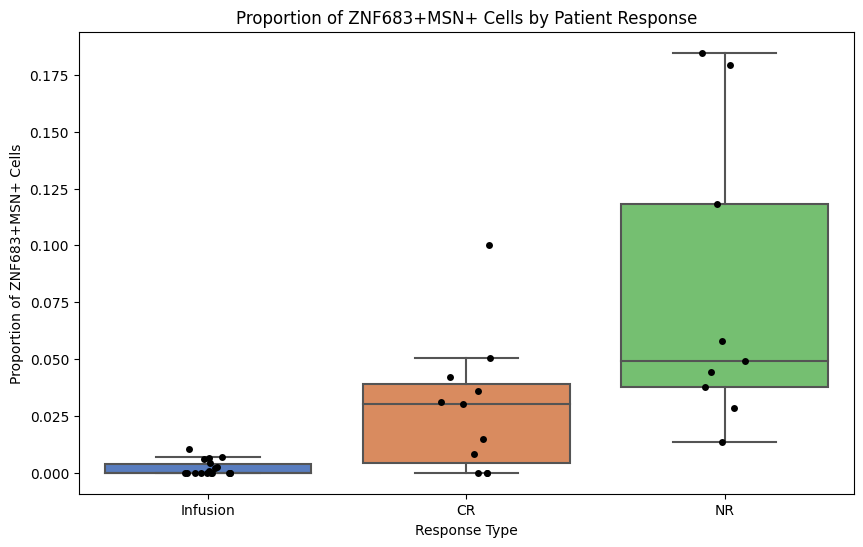

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


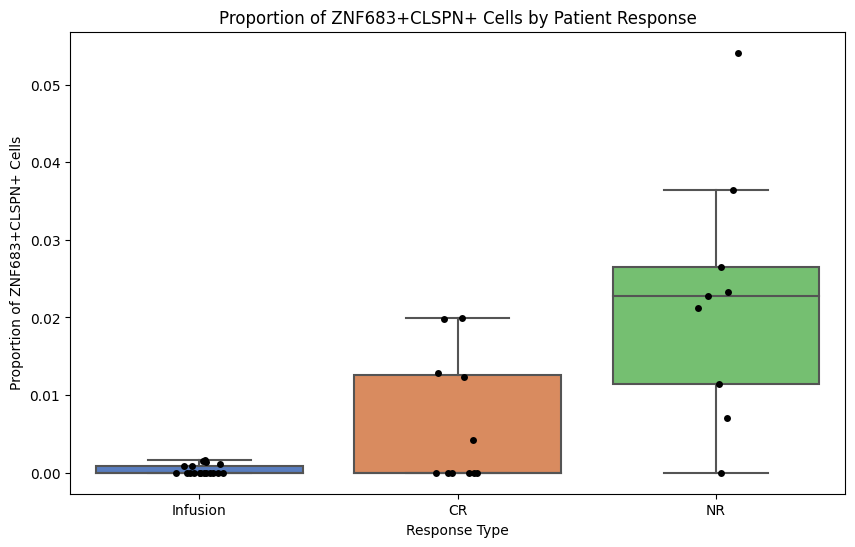

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


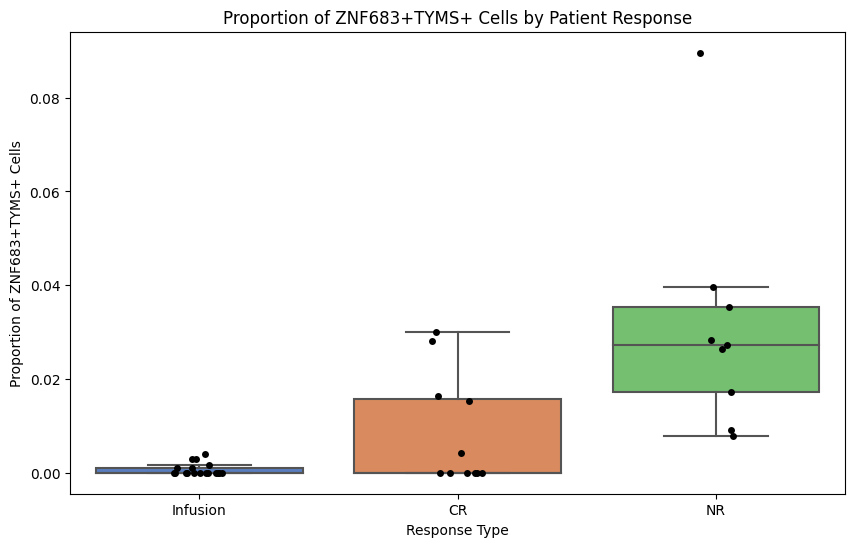

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


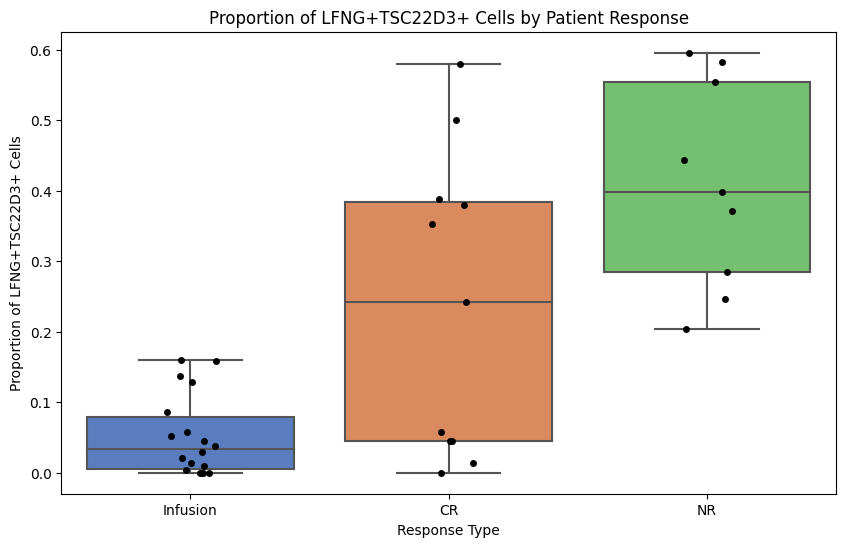

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


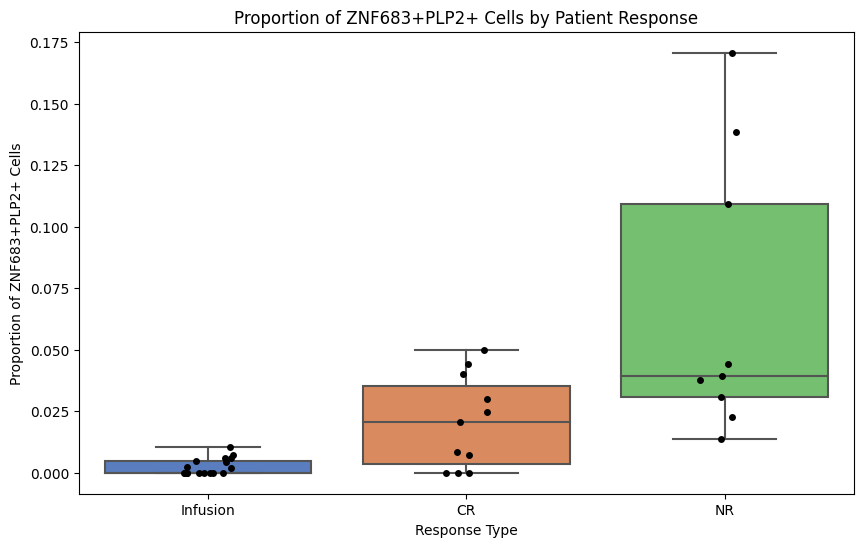

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


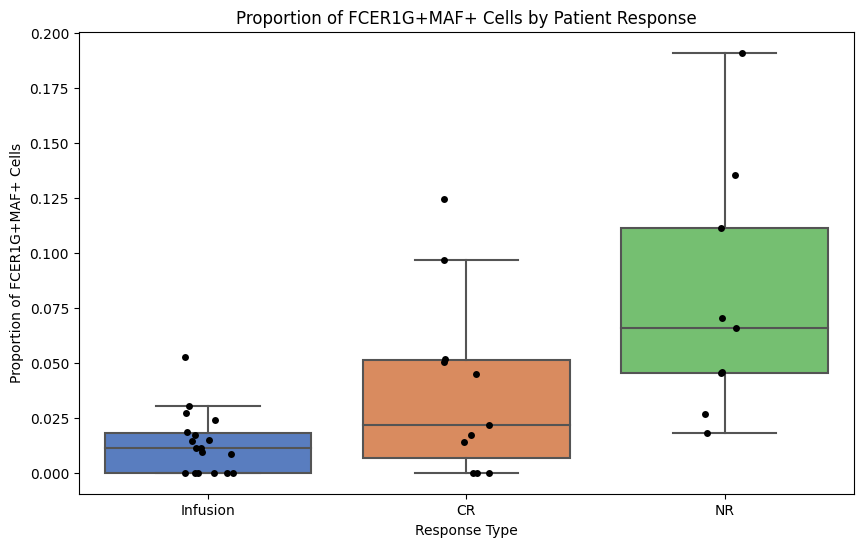

In [2]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Define the pairs of genes of interest
gene_pairs = [
    ("JUND", "TSC22D3"),
    ("ZNF683", "TSC22D3"),
    ("ZNF683", "TLE5"),
    ("FCER1G", "TSC22D3"),
    ("ZNF683", "MSN"),
    ("ZNF683", "CLSPN"),
    ("ZNF683", "TYMS"),
    ("LFNG", "TSC22D3"),
    ("ZNF683", "PLP2"),
    ("FCER1G", "MAF")
]

# Add unique ID to each patient
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Function to calculate proportion and plot
def plot_proportion(gene1, gene2):
    results = []
    
    # Calculate the proportion of cells expressing both genes for each patient
    for patient in adata_CD4.obs['Unique_ID'].unique():
        patient_data = adata_CD4[adata_CD4.obs['Unique_ID'] == patient]
        
        # Extract gene expression
        gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
        gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
        
        # Calculate proportion of cells expressing both genes
        both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
        proportion = np.sum(both_genes_expr) / patient_data.shape[0]
        
        # Append results
        results.append({
            'Patient': patient,
            'Response': str(patient_data.obs['response'].values[0]),
            f'Proportion_{gene1}_{gene2}_Positive': proportion,
        })

    # Convert the results list to a DataFrame
    results_df = pd.DataFrame(results)

    # Encode the 'Response' variable as numeric categories
    label_encoder = LabelEncoder()
    results_df['Response_Coded'] = label_encoder.fit_transform(results_df['Response'])

    # Visualize the proportion of double-positive cells by response type
    plt.figure(figsize=(10, 6))
    sns.boxplot(data=results_df, x='Response', y=f'Proportion_{gene1}_{gene2}_Positive', palette='muted', showfliers=False)
    sns.stripplot(data=results_df, x='Response', y=f'Proportion_{gene1}_{gene2}_Positive', color='black', jitter=True, size=5)
    plt.xlabel('Response Type')
    plt.ylabel(f'Proportion of {gene1}+{gene2}+ Cells')
    plt.title(f'Proportion of {gene1}+{gene2}+ Cells by Patient Response')
    plt.show()

# Plot each gene pair
for gene1, gene2 in gene_pairs:
    plot_proportion(gene1, gene2)


In [ ]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from statsmodels.discrete.discrete_model import MNLogit
from sklearn.preprocessing import LabelEncoder
from scipy.sparse import issparse

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Define the genes of interest
genes_up = ["ZNF683", "MSN"]

# Prepare to store results
results = []

# Add unique ID to each patient
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Calculate the proportion of cells expressing both genes for each patient
for patient in adata_CD4.obs['Unique_ID'].unique():
    patient_data = adata_CD4[adata_CD4.obs['Unique_ID'] == patient]
    
    # Extract gene expression
    gene1_expr = patient_data[:, genes_up[0]].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, genes_up[0]].X > 0
    gene2_expr = patient_data[:, genes_up[1]].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, genes_up[1]].X > 0
    
    # Calculate proportion of cells expressing both genes
    both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
    proportion = np.sum(both_genes_expr) / patient_data.shape[0]
    
    # Sum of gene counts
    gene1_count = np.sum(patient_data[:, genes_up[0]].X)
    gene2_count = np.sum(patient_data[:, genes_up[1]].X)
    
    # Convert NumPy arrays to plain Python types, otherwise it would show non-hashable numpy array
    proportion = float(proportion) 

    
    # Append results
    results.append({
        'Patient': patient,
        'Response': str(patient_data.obs['response'].values[0]),  # Convert to string to avoid issues with hashing
        f'Proportion_{genes_up[0]}_{genes_up[1]}_Positive': proportion,
        f'{genes_up[0]}_Count': gene1_count,
        f'{genes_up[1]}_Count': gene2_count
    })

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Encode the 'Response' variable as numeric categories
label_encoder = LabelEncoder()
results_df['Response_Coded'] = label_encoder.fit_transform(results_df['Response'])

# Visualize the proportion of double-positive cells by response type
plt.figure(figsize=(10, 6))
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
sns.boxplot(data=results_df, x='Response', y=f'Proportion_{genes_up[0]}_{genes_up[1]}_Positive', palette='muted', showfliers=False)
sns.stripplot(data=results_df, x='Response', y=f'Proportion_{genes_up[0]}_{genes_up[1]}_Positive', color='black', jitter=True, size=5)
plt.xlabel('Response Type')
plt.ylabel(f'Proportion of {genes_up[0]}+{genes_up[1]}+ Cells')
plt.title(f'Proportion of {genes_up[0]}+{genes_up[1]}+ Cells by Patient Response')
plt.show()



Analyzing Gene Pair: ZNF683 - TLE5

PERMANOVA for Proportion_Positive: Pseudo-F = 15.3291, p-value = 0.0010

PERMANOVA for ZNF683_Count: Pseudo-F = 12.6905, p-value = 0.0010

PERMANOVA for TLE5_Count: Pseudo-F = 40.2086, p-value = 0.0010

Random Forest Feature Importances:
TLE5_Count             0.398374
ZNF683_Count           0.302915
Proportion_Positive    0.298711
dtype: float64

Dunn’s test for Proportion_Positive:
          0         1         2
0  1.000000  0.030740  0.134209
1  0.030740  1.000000  0.000012
2  0.134209  0.000012  1.000000

Dunn’s test for ZNF683_Count:
          0         1         2
0  1.000000  0.040555  0.175285
1  0.040555  1.000000  0.000033
2  0.175285  0.000033  1.000000

Spearman Correlation for Gene Pair: ZNF683 - TLE5
Spearman correlation between Proportion_Positive and ZNF683_Count: rho = 0.96, p-value = 0.0000
Spearman correlation between Proportion_Positive and TLE5_Count: rho = 0.63, p-value = 0.0000
Spearman correlation between ZNF683_Count and TL

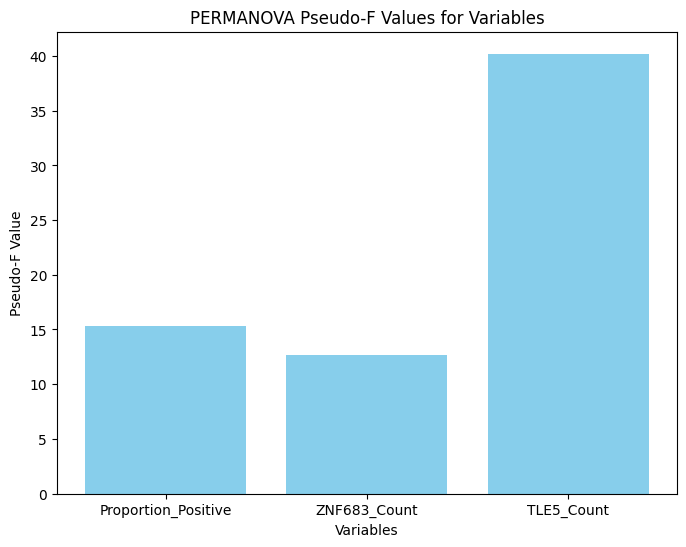

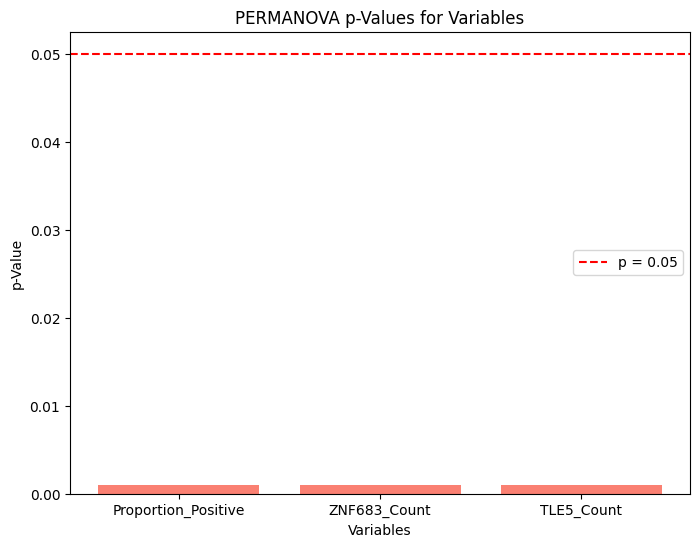

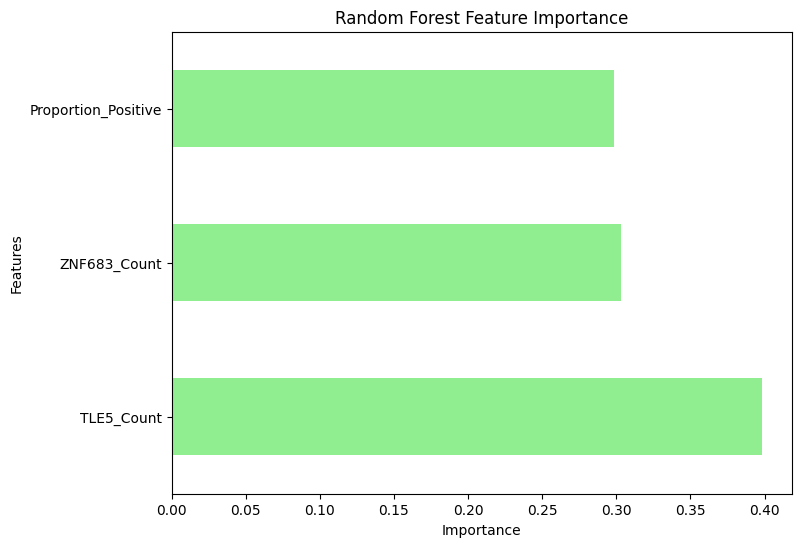

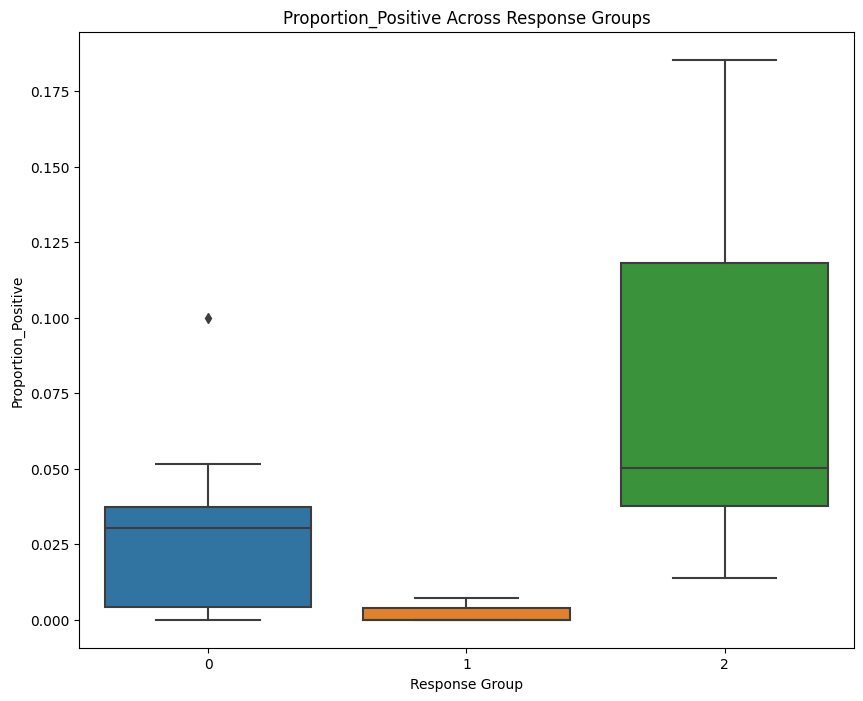

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


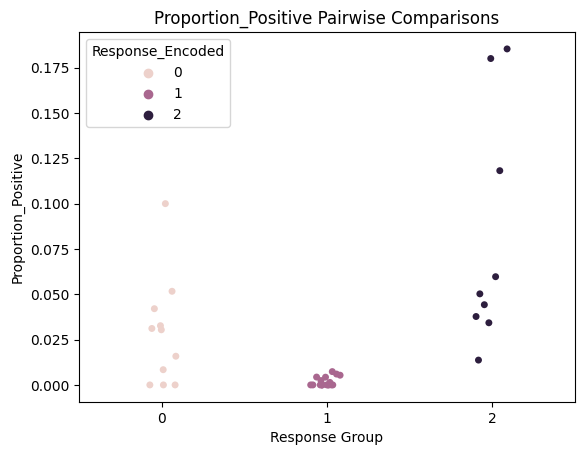

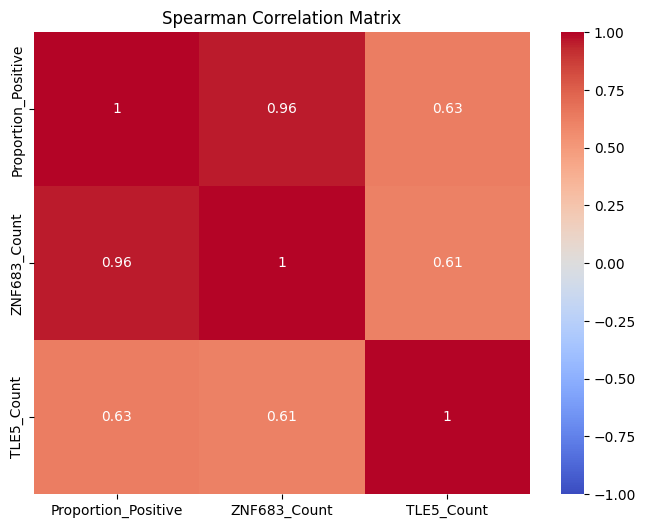

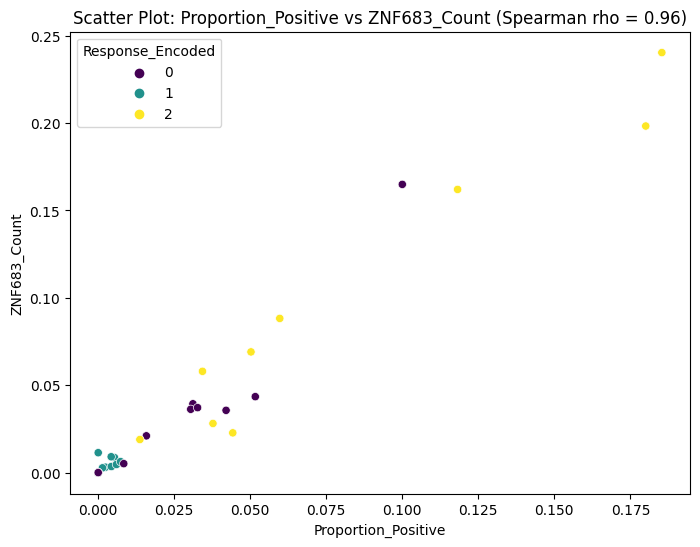

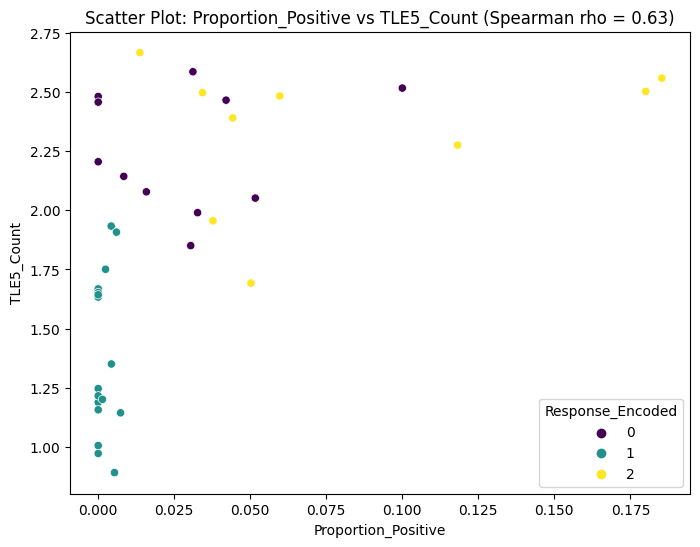

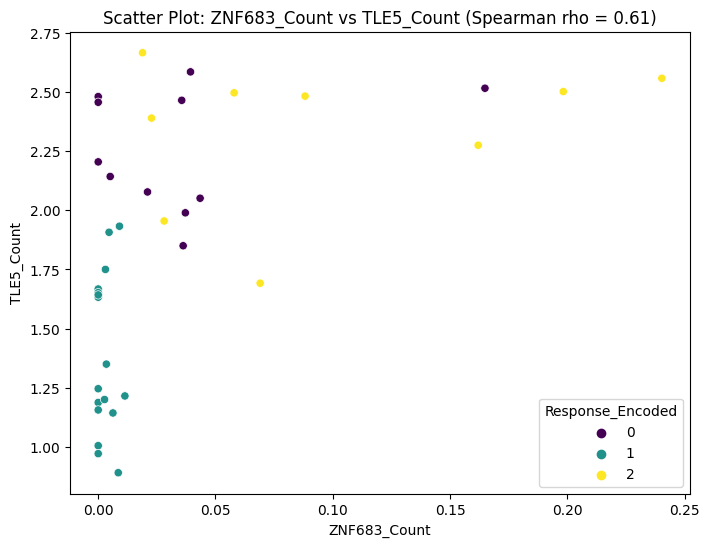

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import itertools
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from scipy.spatial.distance import pdist, squareform
from skbio.stats.distance import DistanceMatrix
from skbio.stats.distance import permanova
from sklearn.ensemble import RandomForestClassifier
import scikit_posthocs as sp
from scipy.stats import spearmanr
import matplotlib.pyplot as plt
import seaborn as sns

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Encode the 'response' labels
le = LabelEncoder()
adata_CD4.obs['Response_Encoded'] = le.fit_transform(adata_CD4.obs['response'])

# Add a suffix to the patient IDs to make them unique
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Example for Gene Pair: JUND - TLE5
gene1, gene2 = "ZNF683", "TLE5"

# Prepare the data for the gene pair
model_data = []

responses = adata_CD4.obs['response'].unique()
for response in responses:
    resp_adata = adata_CD4[adata_CD4.obs['response'] == response]
    patients = resp_adata.obs['Unique_ID'].unique()
    
    # Calculate the proportion of cells expressing both genes for each patient
    for patient in patients:
        patient_data = resp_adata[resp_adata.obs['Unique_ID'] == patient]
        gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
        gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
        both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
        proportion = np.sum(both_genes_expr) / patient_data.shape[0]
        gene1_count = np.mean(patient_data[:, gene1].X)
        gene2_count = np.mean(patient_data[:, gene2].X)

        # Append the data for analysis
        model_data.append({
            'Patient': patient,
            'Response_Encoded': patient_data.obs['Response_Encoded'].values[0], 
            'Proportion_Positive': proportion,
            f'{gene1}_Count': gene1_count,
            f'{gene2}_Count': gene2_count
        })

# Convert the model_data list to a DataFrame
model_df = pd.DataFrame(model_data)

# Define a function to perform PERMANOVA on a single variable
def perform_permanova(model_df, variable, group_labels, permutations=999):
    dist_matrix = squareform(pdist(model_df[[variable]], metric='euclidean'))
    distance_matrix = DistanceMatrix(dist_matrix, ids=model_df.index.to_list())
    result = permanova(distance_matrix, model_df[group_labels], permutations=permutations)
    return result

# Step 1: Individual PERMANOVA
print(f"\nAnalyzing Gene Pair: {gene1} - {gene2}")
variables = ['Proportion_Positive', f'{gene1}_Count', f'{gene2}_Count']

results = []
for var in variables:
    result = perform_permanova(model_df, var, 'Response_Encoded')
    results.append(result)
    print(f"\nPERMANOVA for {var}: Pseudo-F = {result['test statistic']:.4f}, p-value = {result['p-value']:.4f}")

# Step 2: Random Forest Feature Importance
X = model_df[['Proportion_Positive', f'{gene1}_Count', f'{gene2}_Count']]
y = model_df['Response_Encoded']
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X, y)
importances = rf.feature_importances_
feature_importances = pd.Series(importances, index=X.columns).sort_values(ascending=False)
print("\nRandom Forest Feature Importances:")
print(feature_importances)

# Step 3: Dunn’s Post-Hoc Test for Significant Variables
significant_vars = ['Proportion_Positive', f'{gene1}_Count']

for var in significant_vars:
    dunn_results = sp.posthoc_dunn(
        model_df, val_col=var, group_col='Response_Encoded', p_adjust='bonferroni'
    )
    print(f"\nDunn’s test for {var}:")
    print(dunn_results)

# Step 4: Spearman's Correlation
pairs = [
    ('Proportion_Positive', f'{gene1}_Count'),
    ('Proportion_Positive', f'{gene2}_Count'),
    (f'{gene1}_Count', f'{gene2}_Count')
]

print(f"\nSpearman Correlation for Gene Pair: {gene1} - {gene2}")
for var1, var2 in pairs:
    rho, p_val = spearmanr(model_df[var1], model_df[var2])
    print(f"Spearman correlation between {var1} and {var2}: rho = {rho:.2f}, p-value = {p_val:.4f}")

# Visualization
# 1. Plotting Pseudo-F statistic
pseudo_F_values = [result['test statistic'] for result in results]
p_values = [result['p-value'] for result in results]

plt.figure(figsize=(8, 6))
plt.bar(variables, pseudo_F_values, color='skyblue')
plt.xlabel('Variables')
plt.ylabel('Pseudo-F Value')
plt.title('PERMANOVA Pseudo-F Values for Variables')
plt.show()

# 2. Plotting p-values
plt.figure(figsize=(8, 6))
plt.bar(variables, p_values, color='salmon')
plt.axhline(y=0.05, color='r', linestyle='--', label='p = 0.05')
plt.xlabel('Variables')
plt.ylabel('p-Value')
plt.title('PERMANOVA p-Values for Variables')
plt.legend()
plt.show()

# 3. Random Forest Feature Importance
feature_importances.plot(kind='barh', color='lightgreen', figsize=(8, 6))
plt.xlabel('Importance')
plt.ylabel('Features')
plt.title('Random Forest Feature Importance')
plt.show()

# 4. Boxplot for a variable (e.g., 'Proportion_Positive')
plt.figure(figsize=(10, 8))
sns.boxplot(x='Response_Encoded', y='Proportion_Positive', data=model_df)
plt.title('Proportion_Positive Across Response Groups')
plt.xlabel('Response Group')
plt.ylabel('Proportion_Positive')
plt.show()

# 5. Strip plot for pairwise comparisons
sns.stripplot(x='Response_Encoded', y='Proportion_Positive', data=model_df, jitter=True, hue='Response_Encoded')
plt.title('Proportion_Positive Pairwise Comparisons')
plt.xlabel('Response Group')
plt.ylabel('Proportion_Positive')
plt.show()

# 6. Heatmap for Spearman Correlation
correlation_matrix = model_df[['Proportion_Positive', f'{gene1}_Count', f'{gene2}_Count']].corr(method='spearman')
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Spearman Correlation Matrix')
plt.show()

# 7. Scatter plots with Spearman's rho displayed
for var1, var2 in pairs:
    plt.figure(figsize=(8, 6))
    sns.scatterplot(x=model_df[var1], y=model_df[var2], hue=model_df['Response_Encoded'], palette='viridis')
    rho, _ = spearmanr(model_df[var1], model_df[var2])
    plt.title(f'Scatter Plot: {var1} vs {var2} (Spearman rho = {rho:.2f})')
    plt.xlabel(var1)
    plt.ylabel(var2)
    plt.show()

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


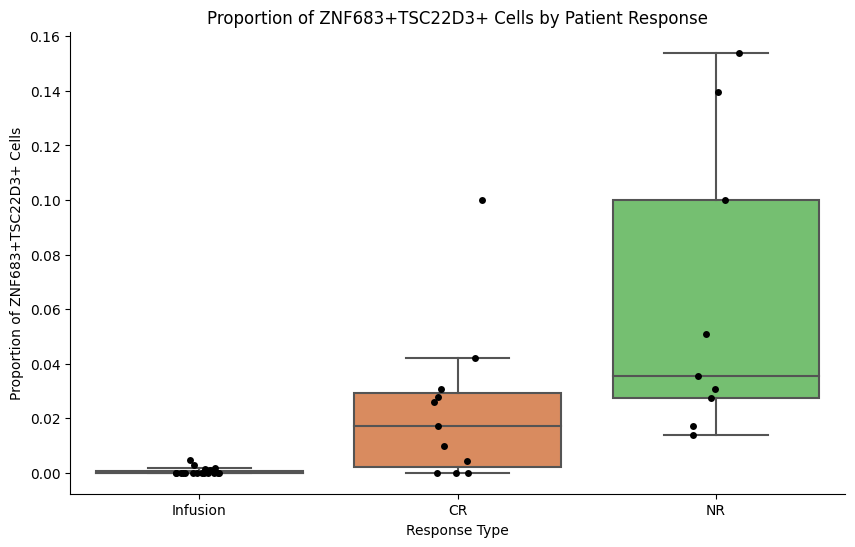

In [3]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from statsmodels.discrete.discrete_model import MNLogit
from sklearn.preprocessing import LabelEncoder
from scipy.sparse import issparse

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Define the genes of interest
genes_up = ["ZNF683", "TSC22D3"]

# Prepare to store results
results = []

# Add unique ID to each patient
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Calculate the proportion of cells expressing both genes for each patient
for patient in adata_CD4.obs['Unique_ID'].unique():
    patient_data = adata_CD4[adata_CD4.obs['Unique_ID'] == patient]
    
    # Extract gene expression
    gene1_expr = patient_data[:, genes_up[0]].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, genes_up[0]].X > 0
    gene2_expr = patient_data[:, genes_up[1]].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, genes_up[1]].X > 0
    
    # Calculate proportion of cells expressing both genes
    both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
    proportion = np.sum(both_genes_expr) / patient_data.shape[0]
    
    # Sum of gene counts
    gene1_count = np.sum(patient_data[:, genes_up[0]].X)
    gene2_count = np.sum(patient_data[:, genes_up[1]].X)
    
    # Convert NumPy arrays to plain Python types, otherwise it would show non-hashable numpy array
    proportion = float(proportion) 

    
    # Append results
    results.append({
        'Patient': patient,
        'Response': str(patient_data.obs['response'].values[0]),  # Convert to string to avoid issues with hashing
        f'Proportion_{genes_up[0]}_{genes_up[1]}_Positive': proportion,
        f'{genes_up[0]}_Count': gene1_count,
        f'{genes_up[1]}_Count': gene2_count
    })

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Encode the 'Response' variable as numeric categories
label_encoder = LabelEncoder()
results_df['Response_Coded'] = label_encoder.fit_transform(results_df['Response'])

# Visualize the proportion of double-positive cells by response type
plt.figure(figsize=(10, 6))
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
sns.boxplot(data=results_df, x='Response', y=f'Proportion_{genes_up[0]}_{genes_up[1]}_Positive', palette='muted', showfliers=False)
sns.stripplot(data=results_df, x='Response', y=f'Proportion_{genes_up[0]}_{genes_up[1]}_Positive', color='black', jitter=True, size=5)
plt.xlabel('Response Type')
plt.ylabel(f'Proportion of {genes_up[0]}+{genes_up[1]}+ Cells')
plt.title(f'Proportion of {genes_up[0]}+{genes_up[1]}+ Cells by Patient Response')
plt.show()

In [1]:
#pairwise comparison: CR vs NR, Infusion vs CR, Infusion vs NR
import scanpy as sc
import numpy as np
import pandas as pd
import itertools
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from scipy.spatial.distance import pdist, squareform
from skbio.stats.distance import DistanceMatrix
from skbio.stats.distance import permanova

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Encode the 'response' labels
le = LabelEncoder()
adata_CD4.obs['Response_Encoded'] = le.fit_transform(adata_CD4.obs['response'])

# Add a suffix to the patient IDs to make them unique
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Define gene list
genes = [
    "PECAM1", "CD7", "FCER1G", "KLRB1",                             # Immune System and Cell Surface Markers
    "JUND", "ZNF683", "TLE5", "LFNG", "TSC22D3", "MAF",             # Transcription Factors and Gene Regulation
    "MTRNR2L12", "RRM2", "TYMS", "GINS2",                           # Mitochondrial and Cellular Metabolism
    "MATK",                                                         # Signal Transduction and Kinases
    "IFITM3",                                                       # Antiviral Response
    "PLP2", "CLSPN", "MSN", "CTSW"                                         # Cellular Structure and Adhesion
]

# Prepare to store results
results = []

# Iterate over all pairs of genes
for gene1, gene2 in itertools.combinations(genes, 2):
    # Prepare a list to store the data for the PERMANOVA analysis
    model_data = []

    responses = adata_CD4.obs['response'].unique()
    for response in responses:
        resp_adata = adata_CD4[adata_CD4.obs['response'] == response]
        patients = resp_adata.obs['Unique_ID'].unique()
        
        # Calculate the proportion of cells expressing both genes for each patient
        for patient in patients:
            patient_data = resp_adata[resp_adata.obs['Unique_ID'] == patient]
            # Ensure the data is dense if needed
            gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
            gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
            both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
            proportion = np.sum(both_genes_expr) / patient_data.shape[0]
            gene1_count = np.mean(patient_data[:, gene1].X)
            gene2_count = np.mean(patient_data[:, gene2].X)

            # Append the data for PERMANOVA analysis
            model_data.append({
                'Patient': patient,
                'Response_Encoded': patient_data.obs['Response_Encoded'].values[0], 
                'Proportion_Positive': proportion,
                f'{gene1}_Count': gene1_count,
                f'{gene2}_Count': gene2_count
            })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)

    # Calculate the distance matrix for the three variables combined
    dist_matrix = squareform(pdist(model_df[[f'{gene1}_Count', f'{gene2}_Count', 'Proportion_Positive']], metric='euclidean'))
    
    # Prepare unique IDs for each sample
    ids = model_df.index.to_list()

    # Convert the distance matrix into a skbio DistanceMatrix object
    dist_matrix = DistanceMatrix(dist_matrix, ids=ids)

    # Perform PERMANOVA for each pairwise comparison
    # Perform PERMANOVA for each pairwise comparison and retrieve additional statistics
    result_CR_NR = permanova(dist_matrix, model_df['Response_Encoded'].isin([0, 1]), permutations=999)
    result_Infusion_CR = permanova(dist_matrix, model_df['Response_Encoded'].isin([1, 2]), permutations=999)
    result_Infusion_NR = permanova(dist_matrix, model_df['Response_Encoded'].isin([0, 2]), permutations=999)

    p_val_CR_NR = result_CR_NR['p-value']
    p_val_Infusion_CR = result_Infusion_CR['p-value']
    p_val_Infusion_NR = result_Infusion_NR['p-value']
    Var_p = p_val_CR_NR + p_val_Infusion_NR - p_val_Infusion_CR

    pseudo_F_CR_NR = result_CR_NR['test statistic']
    pseudo_F_Infusion_CR = result_Infusion_CR['test statistic']
    pseudo_F_Infusion_NR = result_Infusion_NR['test statistic']
    Var_F = pseudo_F_CR_NR + pseudo_F_Infusion_NR - pseudo_F_Infusion_CR
    

    # Apply criteria: Significant for CR vs NR and Infusion vs CR, but not Infusion vs NR
    if p_val_CR_NR < 0.05 and p_val_Infusion_CR > 0.05 and p_val_Infusion_NR < 0.05:
        results.append({
            'Gene1': gene1,
            'Gene2': gene2,
            'Pseudo-F CR vs NR': pseudo_F_CR_NR,
            'P-value CR vs NR': p_val_CR_NR,
            'Pseudo-F Infusion vs CR': pseudo_F_Infusion_CR,
            'P-value Infusion vs CR': p_val_Infusion_CR,
            'Pseudo-F Infusion vs NR': pseudo_F_Infusion_NR,
            'P-value Infusion vs NR': p_val_Infusion_NR,
            'Variance F': Var_F,
            'Variance p': Var_p
        })

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results).sort_values('Variance F', ascending=False)


# Export the results to an Excel file
results_df.to_excel('/home/emma/result/CART/CD4_figure3_gene_pair_permanova_results_sorted.xlsx', index=False)

print("Analysis complete. Results exported to '/home/emma/result/CART/CD4_figure3_gene_pair_permanova_results.xlsx'.")


Analysis complete. Results exported to '/home/emma/result/CART/CD4_figure3_gene_pair_permanova_results.xlsx'.


In [17]:
#normalize with z-score
import scanpy as sc
import numpy as np
import pandas as pd
import itertools
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from scipy.spatial.distance import pdist, squareform
from skbio.stats.distance import DistanceMatrix
from skbio.stats.distance import permanova
from scipy.stats import zscore

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Encode the 'response' labels
le = LabelEncoder()
adata_CD4.obs['Response_Encoded'] = le.fit_transform(adata_CD4.obs['response'])

# Add a suffix to the patient IDs to make them unique
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Define gene list
genes = [
    "PECAM1", "CD7", "FCER1G", "KLRB1",                             # Immune System and Cell Surface Markers
    "JUND", "ZNF683", "TLE5", "LFNG", "TSC22D3", "MAF",             # Transcription Factors and Gene Regulation
    "MTRNR2L12", "RRM2", "TYMS", "GINS2",                           # Mitochondrial and Cellular Metabolism
    "MATK",                                                         # Signal Transduction and Kinases
    "IFITM3",                                                       # Antiviral Response
    "PLP2", "CLSPN", "MSN", "CTSW"                                  # Cellular Structure and Adhesion
]

# Prepare to store results
results = []

# Iterate over all pairs of genes
for gene1, gene2 in itertools.combinations(genes, 2):
    # Prepare a list to store the data for the PERMANOVA analysis
    model_data = []

    responses = adata_CD4.obs['response'].unique()
    for response in responses:
        resp_adata = adata_CD4[adata_CD4.obs['response'] == response]
        patients = resp_adata.obs['Unique_ID'].unique()
        
        # Calculate the proportion of cells expressing both genes for each patient
        for patient in patients:
            patient_data = resp_adata[resp_adata.obs['Unique_ID'] == patient]
            # Ensure the data is dense if needed
            gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
            gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
            both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
            proportion = np.sum(both_genes_expr) / patient_data.shape[0]
            gene1_count = np.mean(patient_data[:, gene1].X)
            gene2_count = np.mean(patient_data[:, gene2].X)

            # Append the data for PERMANOVA analysis
            model_data.append({
                'Patient': patient,
                'Response_Encoded': patient_data.obs['Response_Encoded'].values[0], 
                'Proportion_Positive': proportion,
                f'{gene1}_Count': gene1_count,
                f'{gene2}_Count': gene2_count
            })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)

    # Calculate the distance matrix for the three variables combined
    dist_matrix = squareform(pdist(model_df[[f'{gene1}_Count', f'{gene2}_Count', 'Proportion_Positive']], metric='euclidean'))
    
    # Prepare unique IDs for each sample
    ids = model_df.index.to_list()

    # Convert the distance matrix into a skbio DistanceMatrix object
    dist_matrix = DistanceMatrix(dist_matrix, ids=ids)

    # Perform PERMANOVA for each pairwise comparison and retrieve additional statistics
    result_CR_NR = permanova(dist_matrix, model_df['Response_Encoded'].isin([0, 1]), permutations=999)
    result_Infusion_CR = permanova(dist_matrix, model_df['Response_Encoded'].isin([1, 2]), permutations=999)
    result_Infusion_NR = permanova(dist_matrix, model_df['Response_Encoded'].isin([0, 2]), permutations=999)

    p_val_CR_NR = result_CR_NR['p-value']
    p_val_Infusion_CR = result_Infusion_CR['p-value']
    p_val_Infusion_NR = result_Infusion_NR['p-value']
    Var_p = p_val_CR_NR + p_val_Infusion_NR - p_val_Infusion_CR

    pseudo_F_CR_NR = result_CR_NR['test statistic']
    pseudo_F_Infusion_CR = result_Infusion_CR['test statistic']
    pseudo_F_Infusion_NR = result_Infusion_NR['test statistic']
    Var_F = pseudo_F_CR_NR + pseudo_F_Infusion_NR - pseudo_F_Infusion_CR
    

    # Apply criteria: Significant for CR vs NR and Infusion vs CR, but not Infusion vs NR
    if p_val_CR_NR < 0.05 and p_val_Infusion_CR > 0.05 and p_val_Infusion_NR < 0.05:
        results.append({
            'Gene1': gene1,
            'Gene2': gene2,
            'Pseudo-F CR vs NR': pseudo_F_CR_NR,
            'P-value CR vs NR': p_val_CR_NR,
            'Pseudo-F Infusion vs CR': pseudo_F_Infusion_CR,
            'P-value Infusion vs CR': p_val_Infusion_CR,
            'Pseudo-F Infusion vs NR': pseudo_F_Infusion_NR,
            'P-value Infusion vs NR': p_val_Infusion_NR,
            'Variance F': Var_F,
            'Variance p': Var_p
        })

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Calculate Z-scores for Variance F and Variance p
results_df['Z_Var_F'] = zscore(results_df['Variance F'])
results_df['Z_Var_P'] = zscore(results_df['Variance p'])

# Combine Z-scores into a single score
results_df['Z_Score'] = results_df['Z_Var_F'] - results_df['Z_Var_P']

# Rank the pairs by the Z_Score
ranked_pairs = results_df.sort_values(by='Z_Score', ascending=False)

# Export the ranked results to an Excel file
ranked_pairs.to_excel('/home/emma/result/CART/CD4_figure3_gene_pair_permanova_results_ranked_by_z_score.xlsx', index=False)

print("Analysis complete. Results exported to '/home/emma/result/CART/CD4_figure3_gene_pair_permanova_results_ranked_by_z_score.xlsx'.")

Analysis complete. Results exported to '/home/emma/result/CART/CD4_figure3_gene_pair_permanova_results_ranked_by_z_score.xlsx'.


In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import itertools
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from scipy.spatial.distance import pdist, squareform
from skbio.stats.distance import DistanceMatrix
from skbio.stats.distance import permanova
from scipy.stats import zscore

# Load log-transformed dataset for proportions
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Load combat-corrected dataset for gene counts
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_combat_CD4 = adata_combat[adata_combat.obs['cell_type'] == 'CD4'].copy()

# Encode the 'response' labels
le = LabelEncoder()
adata_CD4.obs['Response_Encoded'] = le.fit_transform(adata_CD4.obs['response'])
adata_combat_CD4.obs['Response_Encoded'] = le.fit_transform(adata_combat_CD4.obs['response'])

# Add a suffix to the patient IDs to make them unique
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)
adata_combat_CD4.obs['Unique_ID'] = adata_combat_CD4.obs['barcode'].astype(str) + '-' + adata_combat_CD4.obs['timepoint'].astype(str)

# Define gene list
genes = [
    "PECAM1", "CD7", "FCER1G", "KLRK1",                             # Immune System and Cell Surface Markers
    "JUND", "ZNF683", "TLE5", "LFNG", "TSC22D3", "MAF",             # Transcription Factors and Gene Regulation
    "MTRNR2L12", "RRM2", "TYMS", "GINS2",                           # Mitochondrial and Cellular Metabolism
    "MATK",                                                         # Signal Transduction and Kinases
    "IFITM3",                                                       # Antiviral Response
    "PLP2", "CLSPN", "MSN", "CTSW"                                  # Cellular Structure and Adhesion
]

# Prepare to store results
results = []

# Iterate over all pairs of genes
for gene1, gene2 in itertools.combinations(genes, 2):
    # Prepare a list to store the data for the PERMANOVA analysis
    model_data = []

    responses = adata_CD4.obs['response'].unique()
    for response in responses:
        resp_adata = adata_CD4[adata_CD4.obs['response'] == response]
        resp_adata_combat = adata_combat_CD4[adata_combat_CD4.obs['response'] == response]
        patients = resp_adata.obs['Unique_ID'].unique()
        
        # Calculate the proportion of cells expressing both genes for each patient
        for patient in patients:
            patient_data = resp_adata[resp_adata.obs['Unique_ID'] == patient]
            patient_data_combat = resp_adata_combat[resp_adata_combat.obs['Unique_ID'] == patient]
            
            # Ensure the data is dense if needed
            gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
            gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
            both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
            proportion = np.sum(both_genes_expr) / patient_data.shape[0]
            gene1_count = np.sum(patient_data_combat[:, gene1].X)
            gene2_count = np.sum(patient_data_combat[:, gene2].X)

            # Append the data for PERMANOVA analysis
            model_data.append({
                'Patient': patient,
                'Response_Encoded': patient_data.obs['Response_Encoded'].values[0], 
                'Proportion_Positive': proportion,
                f'{gene1}_Count': gene1_count,
                f'{gene2}_Count': gene2_count
            })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)

    # Normalize the variables using Z-scores
    model_df['Proportion_Positive_Z'] = zscore(model_df['Proportion_Positive'])
    model_df[f'{gene1}_Count_Z'] = zscore(model_df[f'{gene1}_Count'])
    model_df[f'{gene2}_Count_Z'] = zscore(model_df[f'{gene2}_Count'])

    # Calculate the distance matrix for the three normalized variables
    dist_matrix = squareform(pdist(model_df[[f'{gene1}_Count_Z', f'{gene2}_Count_Z', 'Proportion_Positive_Z']], metric='euclidean'))
    
    # Prepare unique IDs for each sample
    ids = model_df.index.to_list()

    # Convert the distance matrix into a skbio DistanceMatrix object
    dist_matrix = DistanceMatrix(dist_matrix, ids=ids)

    # Perform PERMANOVA for each pairwise comparison and retrieve additional statistics
    result_CR_NR = permanova(dist_matrix, model_df['Response_Encoded'].isin([0, 1]), permutations=999)
    result_Infusion_CR = permanova(dist_matrix, model_df['Response_Encoded'].isin([1, 2]), permutations=999)
    result_Infusion_NR = permanova(dist_matrix, model_df['Response_Encoded'].isin([0, 2]), permutations=999)

    p_val_CR_NR = result_CR_NR['p-value']
    p_val_Infusion_CR = result_Infusion_CR['p-value']
    p_val_Infusion_NR = result_Infusion_NR['p-value']
    Var_p = p_val_CR_NR + p_val_Infusion_NR - p_val_Infusion_CR

    pseudo_F_CR_NR = result_CR_NR['test statistic']
    pseudo_F_Infusion_CR = result_Infusion_CR['test statistic']
    pseudo_F_Infusion_NR = result_Infusion_NR['test statistic']
    Var_F = pseudo_F_CR_NR + pseudo_F_Infusion_NR - pseudo_F_Infusion_CR

    # Apply criteria: Significant for CR vs NR and Infusion vs CR, but not Infusion vs NR
    if p_val_CR_NR < 0.05 and p_val_Infusion_CR > 0.05 and p_val_Infusion_NR < 0.05:
        results.append({
            'Gene1': gene1,
            'Gene2': gene2,
            'Pseudo-F CR vs NR': pseudo_F_CR_NR,
            'P-value CR vs NR': p_val_CR_NR,
            'Pseudo-F Infusion vs CR': pseudo_F_Infusion_CR,
            'P-value Infusion vs CR': p_val_Infusion_CR,
            'Pseudo-F Infusion vs NR': pseudo_F_Infusion_NR,
            'P-value Infusion vs NR': p_val_Infusion_NR,
            'Variance F': Var_F,
            'Variance p': Var_p
        })

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Calculate Z-scores for Variance F and Variance p
results_df['Z_Var_F'] = zscore(results_df['Variance F'])
results_df['Z_Var_P'] = zscore(results_df['Variance p'])

# Combine Z-scores into a single score
results_df['Z_Score'] = results_df['Z_Var_F'] - results_df['Z_Var_P']

# Rank the pairs by the Z_Score
ranked_pairs = results_df.sort_values(by='Z_Score', ascending=False)

# Export the ranked results to an Excel file
ranked_pairs.to_excel('/home/emma/result/CART/CD4_figure3_gene_pair_permanova_results_ranked_by_z_score_combat.xlsx', index=False)

print("Analysis complete. Results exported to '/home/emma/result/CART/CD4_figure3_gene_pair_permanova_results_ranked_by_z_score_combat.xlsx'.")

TypeError: loop of ufunc does not support argument 0 of type numpy.float64 which has no callable sqrt method

In [4]:
import scanpy as sc
import numpy as np
import pandas as pd
import itertools
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from scipy.spatial.distance import pdist, squareform
from skbio.stats.distance import DistanceMatrix
from skbio.stats.distance import permanova
from scipy.stats import zscore

# Load log-transformed dataset for proportions and gene counts
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Encode the 'response' labels
le = LabelEncoder()
adata_CD4.obs['Response_Encoded'] = le.fit_transform(adata_CD4.obs['response'])

# Add a suffix to the patient IDs to make them unique
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Define gene list
genes = [
    "PECAM1", "CD7", "FCER1G", "KLRK1",                             # Immune System and Cell Surface Markers
    "JUND", "ZNF683", "TLE5", "LFNG", "TSC22D3", "MAF",             # Transcription Factors and Gene Regulation
    "MTRNR2L12", "RRM2", "TYMS", "GINS2",                           # Mitochondrial and Cellular Metabolism
    "MATK",                                                         # Signal Transduction and Kinases
    "IFITM3",                                                       # Antiviral Response
    "PLP2", "CLSPN", "MSN", "CTSW"                                  # Cellular Structure and Adhesion
]

# Prepare to store results
results = []

# Iterate over all pairs of genes
for gene1, gene2 in itertools.combinations(genes, 2):
    # Prepare a list to store the data for the PERMANOVA analysis
    model_data = []

    responses = adata_CD4.obs['response'].unique()
    for response in responses:
        resp_adata = adata_CD4[adata_CD4.obs['response'] == response]
        patients = resp_adata.obs['Unique_ID'].unique()
        
        # Calculate the proportion of cells expressing both genes for each patient
        for patient in patients:
            patient_data = resp_adata[resp_adata.obs['Unique_ID'] == patient]
            
            # Ensure the data is dense if needed
            gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
            gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
            both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
            proportion = np.sum(both_genes_expr) / patient_data.shape[0]
            gene1_count = np.sum(patient_data[:, gene1].X)
            gene2_count = np.sum(patient_data[:, gene2].X)

            # Append the data for PERMANOVA analysis
            model_data.append({
                'Patient': patient,
                'Response_Encoded': patient_data.obs['Response_Encoded'].values[0], 
                'Proportion_Positive': proportion,
                f'{gene1}_Count': gene1_count,
                f'{gene2}_Count': gene2_count
            })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)

    # Normalize the variables using Z-scores
    model_df['Proportion_Positive_Z'] = zscore(model_df['Proportion_Positive'])
    model_df[f'{gene1}_Count_Z'] = zscore(model_df[f'{gene1}_Count'])
    model_df[f'{gene2}_Count_Z'] = zscore(model_df[f'{gene2}_Count'])

    # Calculate the distance matrix for the three normalized variables
    dist_matrix = squareform(pdist(model_df[[f'{gene1}_Count_Z', f'{gene2}_Count_Z', 'Proportion_Positive_Z']], metric='euclidean'))
    
    # Prepare unique IDs for each sample
    ids = model_df.index.to_list()

    # Convert the distance matrix into a skbio DistanceMatrix object
    dist_matrix = DistanceMatrix(dist_matrix, ids=ids)

    # Perform PERMANOVA for each pairwise comparison and retrieve additional statistics
    result_CR_NR = permanova(dist_matrix, model_df['Response_Encoded'].isin([0, 1]), permutations=999)
    result_Infusion_CR = permanova(dist_matrix, model_df['Response_Encoded'].isin([1, 2]), permutations=999)
    result_Infusion_NR = permanova(dist_matrix, model_df['Response_Encoded'].isin([0, 2]), permutations=999)

    p_val_CR_NR = result_CR_NR['p-value']
    p_val_Infusion_CR = result_Infusion_CR['p-value']
    p_val_Infusion_NR = result_Infusion_NR['p-value']
    Var_p = p_val_CR_NR + p_val_Infusion_NR - p_val_Infusion_CR

    pseudo_F_CR_NR = result_CR_NR['test statistic']
    pseudo_F_Infusion_CR = result_Infusion_CR['test statistic']
    pseudo_F_Infusion_NR = result_Infusion_NR['test statistic']
    Var_F = pseudo_F_CR_NR + pseudo_F_Infusion_NR - pseudo_F_Infusion_CR

    # Apply criteria: Significant for CR vs NR and Infusion vs CR, but not Infusion vs NR
    if p_val_CR_NR < 0.05 and p_val_Infusion_CR > 0.05 and p_val_Infusion_NR < 0.05:
        results.append({
            'Gene1': gene1,
            'Gene2': gene2,
            'Pseudo-F CR vs NR': pseudo_F_CR_NR,
            'P-value CR vs NR': p_val_CR_NR,
            'Pseudo-F Infusion vs CR': pseudo_F_Infusion_CR,
            'P-value Infusion vs CR': p_val_Infusion_CR,
            'Pseudo-F Infusion vs NR': pseudo_F_Infusion_NR,
            'P-value Infusion vs NR': p_val_Infusion_NR,
            'Variance F': Var_F,
            'Variance p': Var_p
        })

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Calculate Z-scores for Variance F and Variance p
results_df['Z_Var_F'] = zscore(results_df['Variance F'])
results_df['Z_Var_P'] = zscore(results_df['Variance p'])

# Combine Z-scores into a single score
results_df['Z_Score'] = results_df['Z_Var_F'] - results_df['Z_Var_P']

# Rank the pairs by the Z_Score
ranked_pairs = results_df.sort_values(by='Z_Score', ascending=False)

# Export the ranked results to an Excel file
ranked_pairs.to_excel('/home/emma/result/CART/CD4_figure3_gene_pair_permanova_results_ranked_by_z_score_log.xlsx', index=False)

print("Analysis complete. Results exported to '/home/emma/result/CART/CD4_figure3_gene_pair_permanova_results_ranked_by_z_score_log.xlsx'.")


Analysis complete. Results exported to '/home/emma/result/CART/CD4_figure3_gene_pair_permanova_results_ranked_by_z_score_log.xlsx'.


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


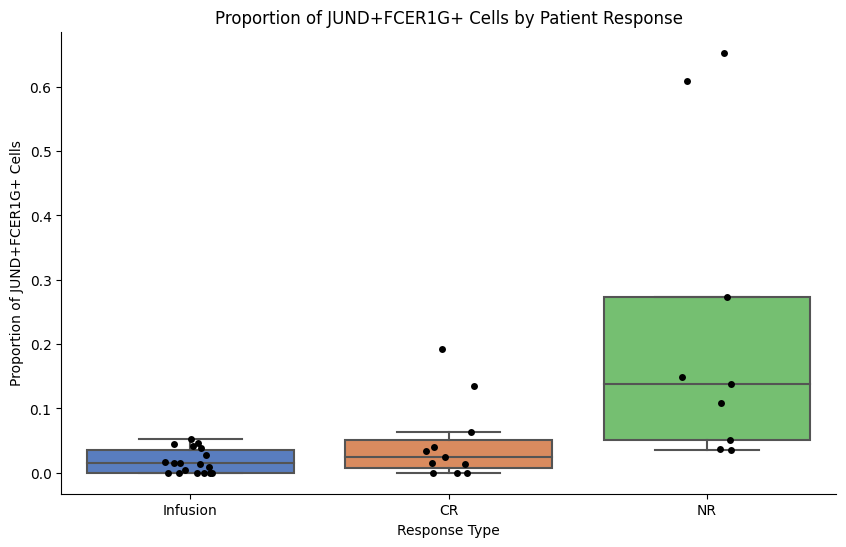

In [12]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from statsmodels.discrete.discrete_model import MNLogit
from sklearn.preprocessing import LabelEncoder
from scipy.sparse import issparse

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Define the genes of interest
genes_up = ["JUND", "FCER1G"]

# Prepare to store results
results = []

# Add unique ID to each patient
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Calculate the proportion of cells expressing both genes for each patient
for patient in adata_CD4.obs['Unique_ID'].unique():
    patient_data = adata_CD4[adata_CD4.obs['Unique_ID'] == patient]
    
    # Extract gene expression
    gene1_expr = patient_data[:, genes_up[0]].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, genes_up[0]].X > 0
    gene2_expr = patient_data[:, genes_up[1]].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, genes_up[1]].X > 0
    
    # Calculate proportion of cells expressing both genes
    both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
    proportion = np.sum(both_genes_expr) / patient_data.shape[0]
    
    # Sum of gene counts
    gene1_count = np.sum(patient_data[:, genes_up[0]].X)
    gene2_count = np.sum(patient_data[:, genes_up[1]].X)
    
    # Convert NumPy arrays to plain Python types, otherwise it would show non-hashable numpy array
    proportion = float(proportion) 

    
    # Append results
    results.append({
        'Patient': patient,
        'Response': str(patient_data.obs['response'].values[0]),  # Convert to string to avoid issues with hashing
        f'Proportion_{genes_up[0]}_{genes_up[1]}_Positive': proportion,
        f'{genes_up[0]}_Count': gene1_count,
        f'{genes_up[1]}_Count': gene2_count
    })

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Encode the 'Response' variable as numeric categories
label_encoder = LabelEncoder()
results_df['Response_Coded'] = label_encoder.fit_transform(results_df['Response'])

# Visualize the proportion of double-positive cells by response type
plt.figure(figsize=(10, 6))
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
sns.boxplot(data=results_df, x='Response', y=f'Proportion_{genes_up[0]}_{genes_up[1]}_Positive', palette='muted', showfliers=False)
sns.stripplot(data=results_df, x='Response', y=f'Proportion_{genes_up[0]}_{genes_up[1]}_Positive', color='black', jitter=True, size=5)
plt.xlabel('Response Type')
plt.ylabel(f'Proportion of {genes_up[0]}+{genes_up[1]}+ Cells')
plt.title(f'Proportion of {genes_up[0]}+{genes_up[1]}+ Cells by Patient Response')
plt.show()

In [7]:
import scanpy as sc
import numpy as np
import pandas as pd
import itertools
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from scipy.spatial.distance import pdist, squareform
from skbio.stats.distance import DistanceMatrix
from skbio.stats.distance import permanova
from scipy.stats import zscore

# Load log-transformed dataset for proportions
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Load combat-corrected dataset for gene counts
adata_combat = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_combat_CD4 = adata_combat[adata_combat.obs['cell_type'] == 'CD4'].copy()

# Encode the 'response' labels
le = LabelEncoder()
adata_CD4.obs['Response_Encoded'] = le.fit_transform(adata_CD4.obs['response'])
adata_combat_CD4.obs['Response_Encoded'] = le.fit_transform(adata_combat_CD4.obs['response'])

# Add a suffix to the patient IDs to make them unique
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)
adata_combat_CD4.obs['Unique_ID'] = adata_combat_CD4.obs['barcode'].astype(str) + '-' + adata_combat_CD4.obs['timepoint'].astype(str)

# Define gene list
genes = [
    "PECAM1", "CD7", "FCER1G", "KLRK1",                             # Immune System and Cell Surface Markers
    "JUND", "ZNF683", "TLE5", "LFNG", "TSC22D3", "MAF",             # Transcription Factors and Gene Regulation
    "MTRNR2L12", "RRM2", "TYMS", "GINS2",                           # Mitochondrial and Cellular Metabolism
    "MATK",                                                         # Signal Transduction and Kinases
    "IFITM3",                                                       # Antiviral Response
    "PLP2", "CLSPN", "MSN", "CTSW"                                  # Cellular Structure and Adhesion
]

# Prepare to store results
results = []

# Iterate over all pairs of genes
for gene1, gene2 in itertools.combinations(genes, 2):
    # Prepare a list to store the data for the PERMANOVA analysis
    model_data = []

    responses = adata_CD4.obs['response'].unique()
    for response in responses:
        resp_adata = adata_CD4[adata_CD4.obs['response'] == response]
        resp_adata_combat = adata_combat_CD4[adata_combat_CD4.obs['response'] == response]
        patients = resp_adata.obs['Unique_ID'].unique()
        
        # Calculate the proportion of cells expressing both genes for each patient
        for patient in patients:
            patient_data = resp_adata[resp_adata.obs['Unique_ID'] == patient]
            patient_data_combat = resp_adata_combat[resp_adata_combat.obs['Unique_ID'] == patient]
            
            # Ensure the data is dense if needed
            gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
            gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
            both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
            proportion = np.sum(both_genes_expr) / patient_data.shape[0]
            gene1_count = np.mean(patient_data_combat[:, gene1].X)
            gene2_count = np.mean(patient_data_combat[:, gene2].X)
            print(proportion, gene1_count, gene2_count)

            # Append the data for PERMANOVA analysis
            model_data.append({
                'Patient': patient,
                'Response_Encoded': patient_data.obs['Response_Encoded'].values[0], 
                'Proportion_Positive': proportion,
                f'{gene1}_Count': gene1_count,
                f'{gene2}_Count': gene2_count
            })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)

    # Calculate the distance matrix for the three variables without normalization
    dist_matrix = squareform(pdist(model_df[[f'{gene1}_Count', f'{gene2}_Count', 'Proportion_Positive']], metric='euclidean'))
    
    # Prepare unique IDs for each sample
    ids = model_df.index.to_list()

    # Convert the distance matrix into a skbio DistanceMatrix object
    dist_matrix = DistanceMatrix(dist_matrix, ids=ids)

    # Perform PERMANOVA for each pairwise comparison and retrieve additional statistics
    result_CR_NR = permanova(dist_matrix, model_df['Response_Encoded'].isin([0, 1]), permutations=999)
    result_Infusion_CR = permanova(dist_matrix, model_df['Response_Encoded'].isin([1, 2]), permutations=999)
    result_Infusion_NR = permanova(dist_matrix, model_df['Response_Encoded'].isin([0, 2]), permutations=999)

    p_val_CR_NR = result_CR_NR['p-value']
    p_val_Infusion_CR = result_Infusion_CR['p-value']
    p_val_Infusion_NR = result_Infusion_NR['p-value']
    Var_p = p_val_CR_NR + p_val_Infusion_NR - p_val_Infusion_CR

    pseudo_F_CR_NR = result_CR_NR['test statistic']
    pseudo_F_Infusion_CR = result_Infusion_CR['test statistic']
    pseudo_F_Infusion_NR = result_Infusion_NR['test statistic']
    Var_F = pseudo_F_CR_NR + pseudo_F_Infusion_NR - pseudo_F_Infusion_CR

    # Apply criteria: Significant for CR vs NR and Infusion vs CR, but not Infusion vs NR
    if p_val_CR_NR < 0.05 and p_val_Infusion_CR > 0.05 and p_val_Infusion_NR < 0.05:
        results.append({
            'Gene1': gene1,
            'Gene2': gene2,
            'Pseudo-F CR vs NR': pseudo_F_CR_NR,
            'P-value CR vs NR': p_val_CR_NR,
            'Pseudo-F Infusion vs CR': pseudo_F_Infusion_CR,
            'P-value Infusion vs CR': p_val_Infusion_CR,
            'Pseudo-F Infusion vs NR': pseudo_F_Infusion_NR,
            'P-value Infusion vs NR': p_val_Infusion_NR,
            'Variance F': Var_F,
            'Variance p': Var_p
        })

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Calculate Z-scores for Variance F and Variance p
results_df['Z_Var_F'] = zscore(results_df['Variance F'])
results_df['Z_Var_P'] = zscore(results_df['Variance p'])

# Combine Z-scores into a single score
results_df['Z_Score'] = results_df['Z_Var_F'] - results_df['Z_Var_P']

# Rank the pairs by the Z_Score
ranked_pairs = results_df.sort_values(by='Z_Score', ascending=False)

# Export the ranked results to an Excel file
ranked_pairs.to_excel('/home/emma/result/CART/CD4_figure3_gene_pair_permanova_results_ranked_by_z_score_combat_allpositive.xlsx', index=False)

print("Analysis complete. Results exported to '/home/emma/result/CART/CD4_figure3_gene_pair_permanova_results_ranked_by_z_score_log.xlsx'.")

0.03842716711349419 0.13010884023446292 1.2174803510406313
0.0 0.07123993148710749 0.9511483413378763
0.0 0.10721968146291076 1.2864354859697724
0.024390243902439025 0.17332082781025132 0.9269454574859372
0.018433179723502304 0.07643459960310214 1.2717629411647717
0.10526315789473684 0.26206751599920974 1.784685841175718
0.025210084033613446 0.13902446796287576 1.218157895857194
0.01849217638691323 0.1393047087591505 1.2658720381514321
0.1 0.3545981136633162 1.515746695130334
0.05174488567990373 0.08633722451174557 1.1493283703658321
0.018957345971563982 0.048586309143453514 1.1018406023420282
0.1299638989169675 0.15854301443765956 1.1980716014669173
0.010834236186348862 0.12080385720721898 1.022443236857217
0.010526315789473684 -0.013440487432679657 0.5898033607804534
0.08224907063197026 0.044194974444411124 1.2804443005245891
0.10944527736131934 0.04680356258628921 1.259001383785497
0.015151515151515152 0.11839439641219283 1.1848313551244765
0.008979591836734694 0.09177176861079946 0

ValueError: Unsupported dtype object

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


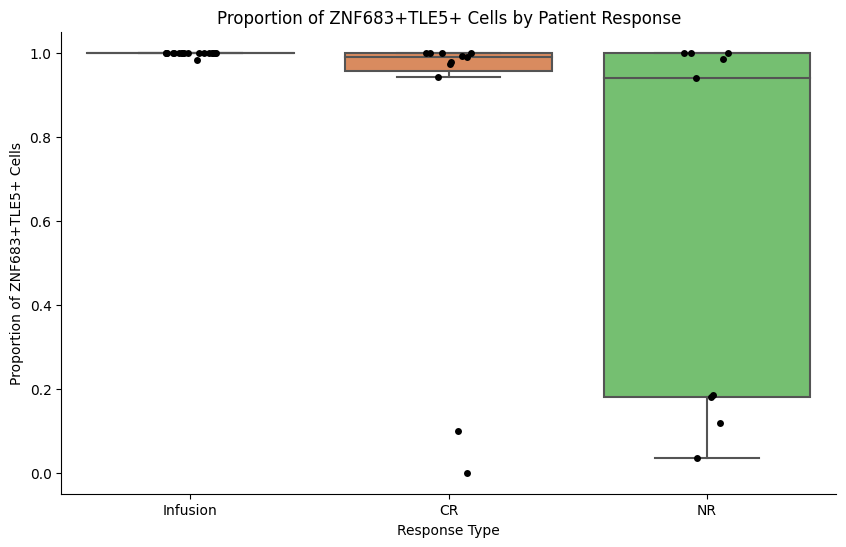

In [6]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from statsmodels.discrete.discrete_model import MNLogit
from sklearn.preprocessing import LabelEncoder
from scipy.sparse import issparse

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Define the genes of interest
genes_up = ["ZNF683", "TLE5"]

# Prepare to store results
results = []

# Add unique ID to each patient
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Calculate the proportion of cells expressing both genes for each patient
for patient in adata_CD4.obs['Unique_ID'].unique():
    patient_data = adata_CD4[adata_CD4.obs['Unique_ID'] == patient]
    
    # Extract gene expression
    gene1_expr = patient_data[:, genes_up[0]].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, genes_up[0]].X > 0
    gene2_expr = patient_data[:, genes_up[1]].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, genes_up[1]].X > 0
    
    # Calculate proportion of cells expressing both genes
    both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
    proportion = np.sum(both_genes_expr) / patient_data.shape[0]
    
    # Sum of gene counts
    gene1_count = np.sum(patient_data[:, genes_up[0]].X)
    gene2_count = np.sum(patient_data[:, genes_up[1]].X)
    
    # Convert NumPy arrays to plain Python types, otherwise it would show non-hashable numpy array
    proportion = float(proportion) 

    
    # Append results
    results.append({
        'Patient': patient,
        'Response': str(patient_data.obs['response'].values[0]),  # Convert to string to avoid issues with hashing
        f'Proportion_{genes_up[0]}_{genes_up[1]}_Positive': proportion,
        f'{genes_up[0]}_Count': gene1_count,
        f'{genes_up[1]}_Count': gene2_count
    })

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Encode the 'Response' variable as numeric categories
label_encoder = LabelEncoder()
results_df['Response_Coded'] = label_encoder.fit_transform(results_df['Response'])

# Visualize the proportion of double-positive cells by response type
plt.figure(figsize=(10, 6))
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
sns.boxplot(data=results_df, x='Response', y=f'Proportion_{genes_up[0]}_{genes_up[1]}_Positive', palette='muted', showfliers=False)
sns.stripplot(data=results_df, x='Response', y=f'Proportion_{genes_up[0]}_{genes_up[1]}_Positive', color='black', jitter=True, size=5)
plt.xlabel('Response Type')
plt.ylabel(f'Proportion of {genes_up[0]}+{genes_up[1]}+ Cells')
plt.title(f'Proportion of {genes_up[0]}+{genes_up[1]}+ Cells by Patient Response')
plt.show()

In [18]:
pip install scikit-posthocs

  Obtaining dependency information for scikit-posthocs from https://files.pythonhosted.org/packages/7e/8f/a4d9542ea371be2a71abd4100e646cfc957d20871c4bc571b5f1d5d662c1/scikit_posthocs-0.9.0-py3-none-any.whl.metadata
Note: you may need to restart the kernel to use updated packages.


In [15]:
import scanpy as sc
import numpy as np
import pandas as pd
import itertools
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from scipy.spatial.distance import pdist, squareform
from skbio.stats.distance import DistanceMatrix
from skbio.stats.distance import permanova
from sklearn.ensemble import RandomForestClassifier
import scikit_posthocs as sp
from scipy.stats import spearmanr

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Encode the 'response' labels
le = LabelEncoder()
adata_CD4.obs['Response_Encoded'] = le.fit_transform(adata_CD4.obs['response'])

# Add a suffix to the patient IDs to make them unique
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Example for Gene Pair: JUND - TLE5
gene1, gene2 = "ZNF683", "MSN"

# Prepare the data for the gene pair
model_data = []

responses = adata_CD4.obs['response'].unique()
for response in responses:
    resp_adata = adata_CD4[adata_CD4.obs['response'] == response]
    patients = resp_adata.obs['Unique_ID'].unique()
    
    # Calculate the proportion of cells expressing both genes for each patient
    for patient in patients:
        patient_data = resp_adata[resp_adata.obs['Unique_ID'] == patient]
        gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
        gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
        both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
        proportion = np.sum(both_genes_expr) / patient_data.shape[0]
        gene1_count = np.mean(patient_data[:, gene1].X)
        gene2_count = np.mean(patient_data[:, gene2].X)

        # Append the data for analysis
        model_data.append({
            'Patient': patient,
            'Response_Encoded': patient_data.obs['Response_Encoded'].values[0], 
            'Proportion_Positive': proportion,
            f'{gene1}_Count': gene1_count,
            f'{gene2}_Count': gene2_count
        })

# Convert the model_data list to a DataFrame
model_df = pd.DataFrame(model_data)

# Define a function to perform PERMANOVA on a single variable
def perform_permanova(model_df, variable, group_labels, permutations=999):
    dist_matrix = squareform(pdist(model_df[[variable]], metric='euclidean'))
    distance_matrix = DistanceMatrix(dist_matrix, ids=model_df.index.to_list())
    result = permanova(distance_matrix, model_df[group_labels], permutations=permutations)
    return result

# Step 1: Individual PERMANOVA
print(f"\nAnalyzing Gene Pair: {gene1} - {gene2}")
variables = ['Proportion_Positive', f'{gene1}_Count', f'{gene2}_Count']

for var in variables:
    result = perform_permanova(model_df, var, 'Response_Encoded')
    print(f"\nPERMANOVA for {var}: Pseudo-F = {result['test statistic']:.4f}, p-value = {result['p-value']:.4f}")

# Step 2: Random Forest Feature Importance
X = model_df[['Proportion_Positive', f'{gene1}_Count', f'{gene2}_Count']]
y = model_df['Response_Encoded']
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X, y)
importances = rf.feature_importances_
feature_importances = pd.Series(importances, index=X.columns).sort_values(ascending=False)
print("\nRandom Forest Feature Importances:")
print(feature_importances)

# Step 3: Dunn’s Post-Hoc Test for Significant Variables
significant_vars = ['Proportion_Positive', f'{gene1}_Count']

for var in significant_vars:
    dunn_results = sp.posthoc_dunn(
        model_df, val_col=var, group_col='Response_Encoded', p_adjust='bonferroni'
    )
    print(f"\nDunn’s test for {var}:")
    print(dunn_results)

# Step 4: Spearman's Correlation
pairs = [
    ('Proportion_Positive', f'{gene1}_Count'),
    ('Proportion_Positive', f'{gene2}_Count'),
    (f'{gene1}_Count', f'{gene2}_Count')
]

print(f"\nSpearman Correlation for Gene Pair: {gene1} - {gene2}")
for var1, var2 in pairs:
    rho, p_val = spearmanr(model_df[var1], model_df[var2])
    print(f"Spearman correlation between {var1} and {var2}: rho = {rho:.2f}, p-value = {p_val:.4f}")


Analyzing Gene Pair: ZNF683 - MSN

PERMANOVA for Proportion_Positive: Pseudo-F = 14.5348, p-value = 0.0010

PERMANOVA for ZNF683_Count: Pseudo-F = 12.6905, p-value = 0.0010

PERMANOVA for MSN_Count: Pseudo-F = 21.5140, p-value = 0.0010

Random Forest Feature Importances:
MSN_Count              0.408435
ZNF683_Count           0.300241
Proportion_Positive    0.291324
dtype: float64

Dunn’s test for Proportion_Positive:
          0         1         2
0  1.000000  0.034061  0.164839
1  0.034061  1.000000  0.000022
2  0.164839  0.000022  1.000000

Dunn’s test for ZNF683_Count:
          0         1         2
0  1.000000  0.040555  0.175285
1  0.040555  1.000000  0.000033
2  0.175285  0.000033  1.000000

Spearman Correlation for Gene Pair: ZNF683 - MSN
Spearman correlation between Proportion_Positive and ZNF683_Count: rho = 0.98, p-value = 0.0000
Spearman correlation between Proportion_Positive and MSN_Count: rho = 0.76, p-value = 0.0000
Spearman correlation between ZNF683_Count and MSN_Co


Analyzing Gene Pair: ZNF683 - TLE5

PERMANOVA for Proportion_Positive: Pseudo-F = 15.3291, p-value = 0.0010

PERMANOVA for ZNF683_Count: Pseudo-F = 12.6905, p-value = 0.0010

PERMANOVA for TLE5_Count: Pseudo-F = 40.2086, p-value = 0.0010

Random Forest Feature Importances:
TLE5_Count             0.398374
ZNF683_Count           0.302915
Proportion_Positive    0.298711
dtype: float64

Dunn’s test for Proportion_Positive:
          0         1         2
0  1.000000  0.030740  0.134209
1  0.030740  1.000000  0.000012
2  0.134209  0.000012  1.000000

Dunn’s test for ZNF683_Count:
          0         1         2
0  1.000000  0.040555  0.175285
1  0.040555  1.000000  0.000033
2  0.175285  0.000033  1.000000

Spearman Correlation for Gene Pair: ZNF683 - TLE5
Spearman correlation between Proportion_Positive and ZNF683_Count: rho = 0.96, p-value = 0.0000
Spearman correlation between Proportion_Positive and TLE5_Count: rho = 0.63, p-value = 0.0000
Spearman correlation between ZNF683_Count and TL

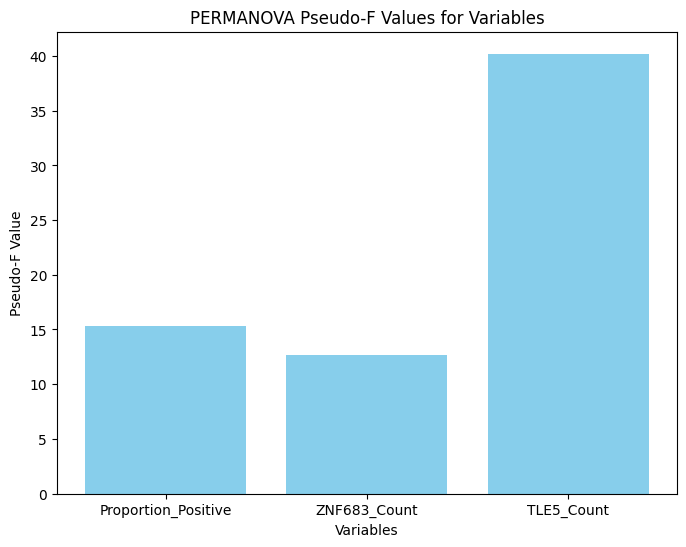

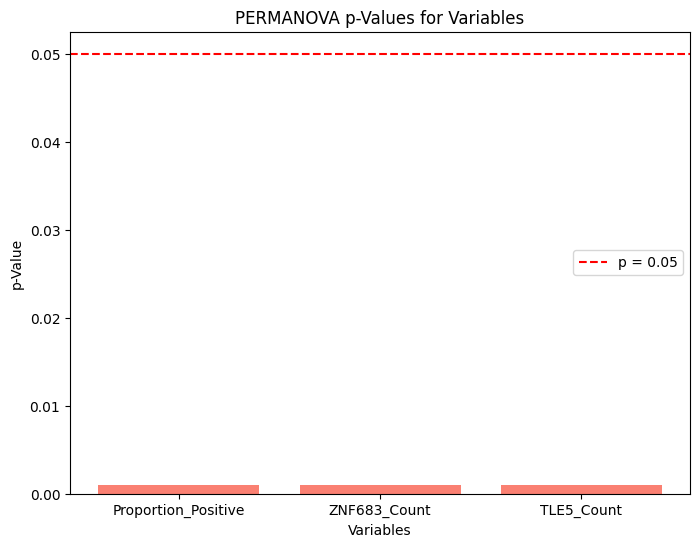

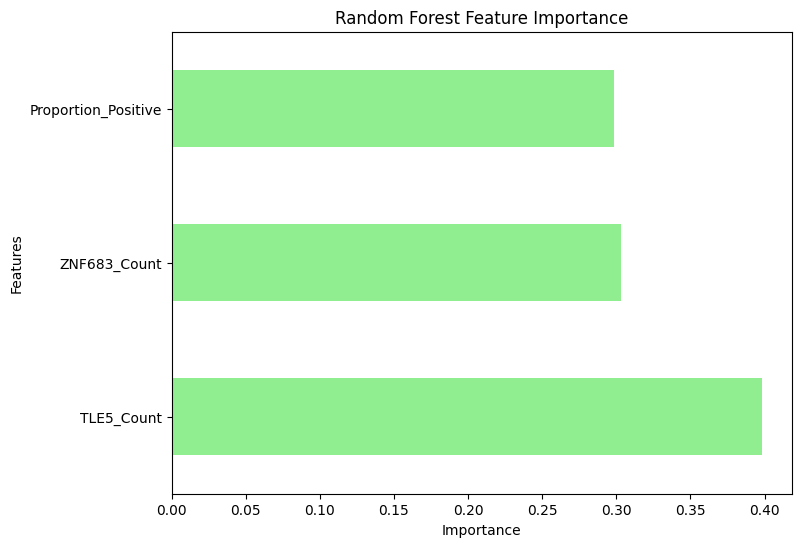

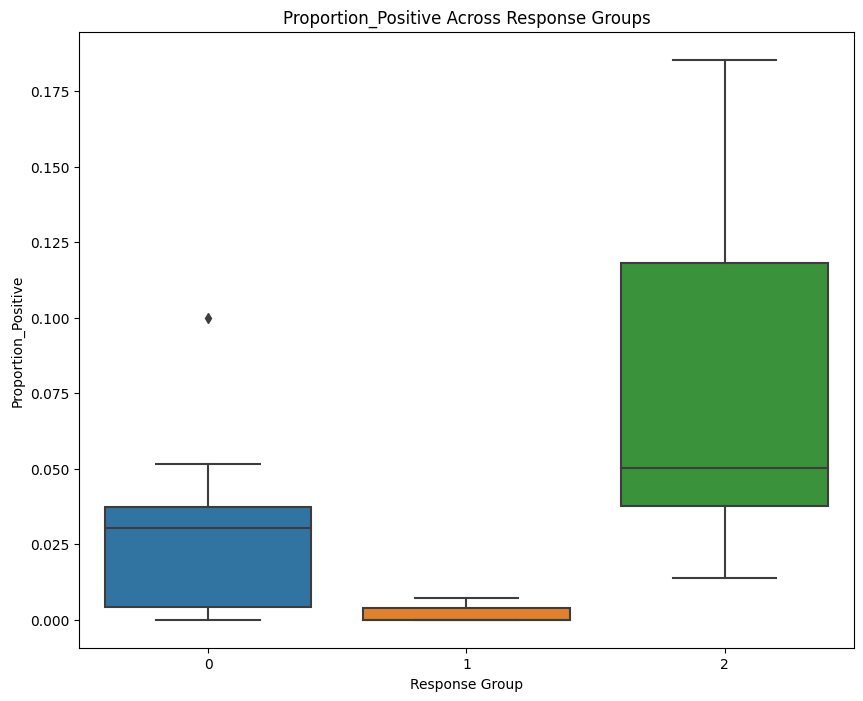

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


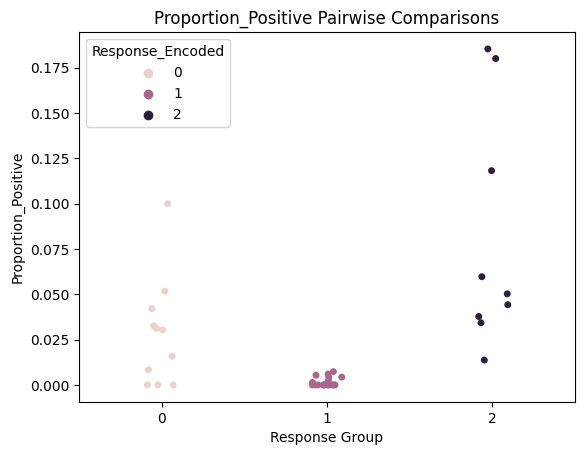

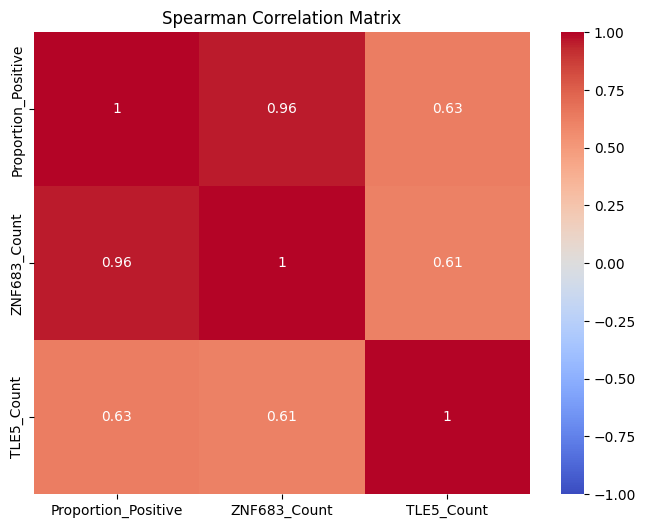

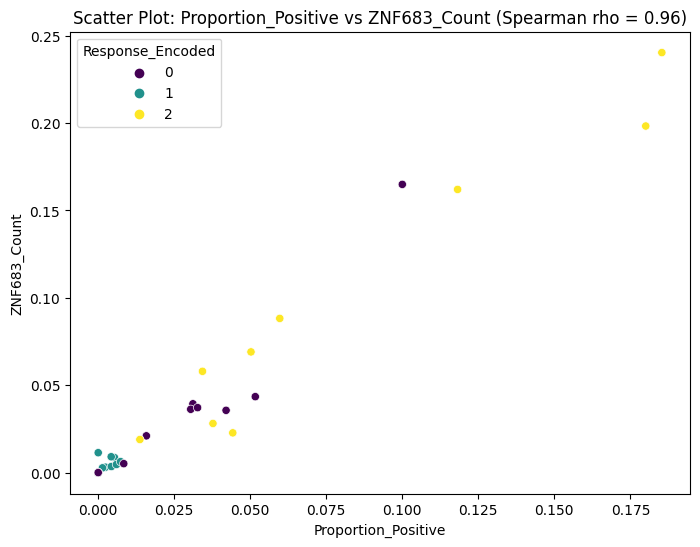

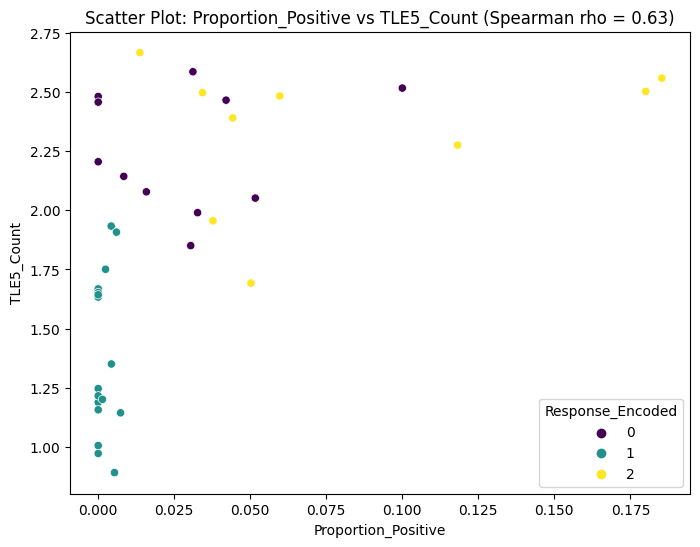

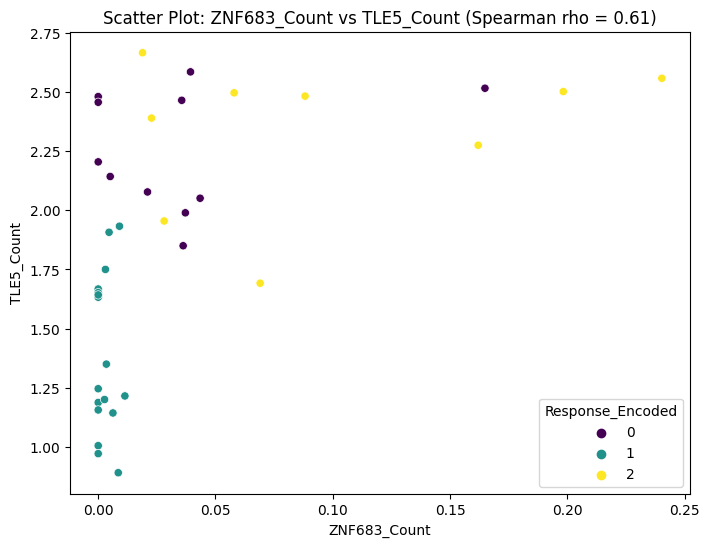

In [7]:
import scanpy as sc
import numpy as np
import pandas as pd
import itertools
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from scipy.spatial.distance import pdist, squareform
from skbio.stats.distance import DistanceMatrix
from skbio.stats.distance import permanova
from sklearn.ensemble import RandomForestClassifier
import scikit_posthocs as sp
from scipy.stats import spearmanr
import matplotlib.pyplot as plt
import seaborn as sns

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Encode the 'response' labels
le = LabelEncoder()
adata_CD4.obs['Response_Encoded'] = le.fit_transform(adata_CD4.obs['response'])

# Add a suffix to the patient IDs to make them unique
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Example for Gene Pair: JUND - TLE5
gene1, gene2 = "ZNF683", "TLE5"

# Prepare the data for the gene pair
model_data = []

responses = adata_CD4.obs['response'].unique()
for response in responses:
    resp_adata = adata_CD4[adata_CD4.obs['response'] == response]
    patients = resp_adata.obs['Unique_ID'].unique()
    
    # Calculate the proportion of cells expressing both genes for each patient
    for patient in patients:
        patient_data = resp_adata[resp_adata.obs['Unique_ID'] == patient]
        gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
        gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
        both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
        proportion = np.sum(both_genes_expr) / patient_data.shape[0]
        gene1_count = np.mean(patient_data[:, gene1].X)
        gene2_count = np.mean(patient_data[:, gene2].X)

        # Append the data for analysis
        model_data.append({
            'Patient': patient,
            'Response_Encoded': patient_data.obs['Response_Encoded'].values[0], 
            'Proportion_Positive': proportion,
            f'{gene1}_Count': gene1_count,
            f'{gene2}_Count': gene2_count
        })

# Convert the model_data list to a DataFrame
model_df = pd.DataFrame(model_data)

# Define a function to perform PERMANOVA on a single variable
def perform_permanova(model_df, variable, group_labels, permutations=999):
    dist_matrix = squareform(pdist(model_df[[variable]], metric='euclidean'))
    distance_matrix = DistanceMatrix(dist_matrix, ids=model_df.index.to_list())
    result = permanova(distance_matrix, model_df[group_labels], permutations=permutations)
    return result

# Step 1: Individual PERMANOVA
print(f"\nAnalyzing Gene Pair: {gene1} - {gene2}")
variables = ['Proportion_Positive', f'{gene1}_Count', f'{gene2}_Count']

results = []
for var in variables:
    result = perform_permanova(model_df, var, 'Response_Encoded')
    results.append(result)
    print(f"\nPERMANOVA for {var}: Pseudo-F = {result['test statistic']:.4f}, p-value = {result['p-value']:.4f}")

# Step 2: Random Forest Feature Importance
X = model_df[['Proportion_Positive', f'{gene1}_Count', f'{gene2}_Count']]
y = model_df['Response_Encoded']
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X, y)
importances = rf.feature_importances_
feature_importances = pd.Series(importances, index=X.columns).sort_values(ascending=False)
print("\nRandom Forest Feature Importances:")
print(feature_importances)

# Step 3: Dunn’s Post-Hoc Test for Significant Variables
significant_vars = ['Proportion_Positive', f'{gene1}_Count']

for var in significant_vars:
    dunn_results = sp.posthoc_dunn(
        model_df, val_col=var, group_col='Response_Encoded', p_adjust='bonferroni'
    )
    print(f"\nDunn’s test for {var}:")
    print(dunn_results)

# Step 4: Spearman's Correlation
pairs = [
    ('Proportion_Positive', f'{gene1}_Count'),
    ('Proportion_Positive', f'{gene2}_Count'),
    (f'{gene1}_Count', f'{gene2}_Count')
]

print(f"\nSpearman Correlation for Gene Pair: {gene1} - {gene2}")
for var1, var2 in pairs:
    rho, p_val = spearmanr(model_df[var1], model_df[var2])
    print(f"Spearman correlation between {var1} and {var2}: rho = {rho:.2f}, p-value = {p_val:.4f}")

# Visualization
# 1. Plotting Pseudo-F statistic
pseudo_F_values = [result['test statistic'] for result in results]
p_values = [result['p-value'] for result in results]

plt.figure(figsize=(8, 6))
plt.bar(variables, pseudo_F_values, color='skyblue')
plt.xlabel('Variables')
plt.ylabel('Pseudo-F Value')
plt.title('PERMANOVA Pseudo-F Values for Variables')
plt.show()

# 2. Plotting p-values
plt.figure(figsize=(8, 6))
plt.bar(variables, p_values, color='salmon')
plt.axhline(y=0.05, color='r', linestyle='--', label='p = 0.05')
plt.xlabel('Variables')
plt.ylabel('p-Value')
plt.title('PERMANOVA p-Values for Variables')
plt.legend()
plt.show()

# 3. Random Forest Feature Importance
feature_importances.plot(kind='barh', color='lightgreen', figsize=(8, 6))
plt.xlabel('Importance')
plt.ylabel('Features')
plt.title('Random Forest Feature Importance')
plt.show()

# 4. Boxplot for a variable (e.g., 'Proportion_Positive')
plt.figure(figsize=(10, 8))
sns.boxplot(x='Response_Encoded', y='Proportion_Positive', data=model_df)
plt.title('Proportion_Positive Across Response Groups')
plt.xlabel('Response Group')
plt.ylabel('Proportion_Positive')
plt.show()

# 5. Strip plot for pairwise comparisons
sns.stripplot(x='Response_Encoded', y='Proportion_Positive', data=model_df, jitter=True, hue='Response_Encoded')
plt.title('Proportion_Positive Pairwise Comparisons')
plt.xlabel('Response Group')
plt.ylabel('Proportion_Positive')
plt.show()

# 6. Heatmap for Spearman Correlation
correlation_matrix = model_df[['Proportion_Positive', f'{gene1}_Count', f'{gene2}_Count']].corr(method='spearman')
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Spearman Correlation Matrix')
plt.show()

# 7. Scatter plots with Spearman's rho displayed
for var1, var2 in pairs:
    plt.figure(figsize=(8, 6))
    sns.scatterplot(x=model_df[var1], y=model_df[var2], hue=model_df['Response_Encoded'], palette='viridis')
    rho, _ = spearmanr(model_df[var1], model_df[var2])
    plt.title(f'Scatter Plot: {var1} vs {var2} (Spearman rho = {rho:.2f})')
    plt.xlabel(var1)
    plt.ylabel(var2)
    plt.show()


In [ ]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from statsmodels.discrete.discrete_model import MNLogit
from sklearn.preprocessing import LabelEncoder
from scipy.sparse import issparse

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Define the genes of interest
genes_up = ["TSC22D3", "JUND"]

# Prepare to store results
results = []

# Add unique ID to each patient
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Calculate the proportion of cells expressing both genes for each patient
for patient in adata_CD4.obs['Unique_ID'].unique():
    patient_data = adata_CD4[adata_CD4.obs['Unique_ID'] == patient]
    
    # Extract gene expression
    gene1_expr = patient_data[:, genes_up[0]].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, genes_up[0]].X > 0
    gene2_expr = patient_data[:, genes_up[1]].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, genes_up[1]].X > 0
    
    # Calculate proportion of cells expressing both genes
    both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
    proportion = np.sum(both_genes_expr) / patient_data.shape[0]
    
    # Sum of gene counts
    gene1_count = np.sum(patient_data[:, genes_up[0]].X)
    gene2_count = np.sum(patient_data[:, genes_up[1]].X)
    
    # Convert NumPy arrays to plain Python types, otherwise it would show non-hashable numpy array
    proportion = float(proportion) 

    
    # Append results
    results.append({
        'Patient': patient,
        'Response': str(patient_data.obs['response'].values[0]),  # Convert to string to avoid issues with hashing
        f'Proportion_{genes_up[0]}_{genes_up[1]}_Positive': proportion,
        f'{genes_up[0]}_Count': gene1_count,
        f'{genes_up[1]}_Count': gene2_count
    })

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Encode the 'Response' variable as numeric categories
label_encoder = LabelEncoder()
results_df['Response_Coded'] = label_encoder.fit_transform(results_df['Response'])

# Visualize the proportion of double-positive cells by response type
plt.figure(figsize=(10, 6))
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
sns.boxplot(data=results_df, x='Response', y=f'Proportion_{genes_up[0]}_{genes_up[1]}_Positive', palette='muted', showfliers=False)
sns.stripplot(data=results_df, x='Response', y=f'Proportion_{genes_up[0]}_{genes_up[1]}_Positive', color='black', jitter=True, size=5)
plt.xlabel('Response Type')
plt.ylabel(f'Proportion of {genes_up[0]}+{genes_up[1]}+ Cells')
plt.title(f'Proportion of {genes_up[0]}+{genes_up[1]}+ Cells by Patient Response')
plt.show()

In [53]:
import scanpy as sc
import numpy as np
import pandas as pd
import itertools
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from scipy.spatial.distance import pdist, squareform
from skbio.stats.distance import DistanceMatrix
from skbio.stats.distance import permanova

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Encode the 'response' labels
le = LabelEncoder()
adata_CD4.obs['Response_Encoded'] = le.fit_transform(adata_CD4.obs['response'])

# Add a suffix to the patient IDs to make them unique
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Define gene list
genes = [
    "PECAM1", "CD7", "FCER1G", "KLRB1",                             # Immune System and Cell Surface Markers
    "JUND", "ZNF683", "TLE5", "LFNG", "TSC22D3", "MAF",             # Transcription Factors and Gene Regulation
    "MTRNR2L12", "RRM2", "TYMS", "GINS2",                           # Mitochondrial and Cellular Metabolism
    "MATK",                                                         # Signal Transduction and Kinases
    "IFITM3",                                                       # Antiviral Response
    "PLP2", "CLSPN", "CTSW"                                         # Cellular Structure and Adhesion
]

# Prepare to store results
results = []

# Iterate over all pairs of genes
for gene1, gene2 in itertools.combinations(genes, 2):
    # Prepare a list to store the data for the PERMANOVA analysis
    model_data = []

    responses = adata_CD4.obs['response'].unique()
    for response in responses:
        resp_adata = adata_CD4[adata_CD4.obs['response'] == response]
        patients = resp_adata.obs['Unique_ID'].unique()
        
        # Calculate the proportion of cells expressing both genes for each patient
        for patient in patients:
            patient_data = resp_adata[resp_adata.obs['Unique_ID'] == patient]
            # Ensure the data is dense if needed
            gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
            gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
            both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
            proportion = np.sum(both_genes_expr) / patient_data.shape[0]
            gene1_count = np.mean(patient_data[:, gene1].X)
            gene2_count = np.mean(patient_data[:, gene2].X)

            # Append the data for PERMANOVA analysis
            model_data.append({
                'Patient': patient,
                'Response_Encoded': patient_data.obs['Response_Encoded'].values[0], 
                'Proportion_Positive': proportion,
                f'{gene1}_Count': gene1_count,
                f'{gene2}_Count': gene2_count
            })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)

    # Calculate the distance matrix for the three variables combined
    dist_matrix = squareform(pdist(model_df[[f'{gene1}_Count', f'{gene2}_Count', 'Proportion_Positive']], metric='euclidean'))
    
    # Prepare unique IDs for each sample
    ids = model_df.index.to_list()

    # Convert the distance matrix into a skbio DistanceMatrix object
    dist_matrix = DistanceMatrix(dist_matrix, ids=ids)

    # Perform PERMANOVA for each pairwise comparison and retrieve additional statistics
    result_CR_NR = permanova(dist_matrix, model_df['Response_Encoded'].isin([0, 1]), permutations=999)
    result_Infusion_CR = permanova(dist_matrix, model_df['Response_Encoded'].isin([1, 2]), permutations=999)
    result_Infusion_NR = permanova(dist_matrix, model_df['Response_Encoded'].isin([0, 2]), permutations=999)

    p_val_CR_NR = result_CR_NR['p-value']
    p_val_Infusion_CR = result_Infusion_CR['p-value']
    p_val_Infusion_NR = result_Infusion_NR['p-value']

    pseudo_F_CR_NR = result_CR_NR['test statistic']
    pseudo_F_Infusion_CR = result_Infusion_CR['test statistic']
    pseudo_F_Infusion_NR = result_Infusion_NR['test statistic']

    R2_CR_NR = result_CR_NR['r-value']
    R2_Infusion_CR = result_Infusion_CR['r-value']
    R2_Infusion_NR = result_Infusion_NR['r-value']

    # Apply criteria: Significant for CR vs NR and Infusion vs CR, but not Infusion vs NR
    if p_val_CR_NR < 0.05 and p_val_Infusion_CR < 0.05 and p_val_Infusion_NR > 0.05:
        results.append({
            'Gene1': gene1,
            'Gene2': gene2,
            'Pseudo-F CR vs NR': pseudo_F_CR_NR,
            'R² CR vs NR': R2_CR_NR,
            'P-value CR vs NR': p_val_CR_NR,
            'Pseudo-F Infusion vs CR': pseudo_F_Infusion_CR,
            'R² Infusion vs CR': R2_Infusion_CR,
            'P-value Infusion vs CR': p_val_Infusion_CR,
            'Pseudo-F Infusion vs NR': pseudo_F_Infusion_NR,
            'R² Infusion vs NR': R2_Infusion_NR,
            'P-value Infusion vs NR': p_val_Infusion_NR  
        })

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Export the results to an Excel file
results_df.to_excel('/home/emma/result/CART/CD4_figure3_gene_pair_permanova_results_with_statistics.xlsx', index=False)

print("Analysis complete. Results exported to '/home/emma/result/CART/CD4_figure3_gene_pair_permanova_results_with_statistics.xlsx'.")


KeyError: 'r-value'

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


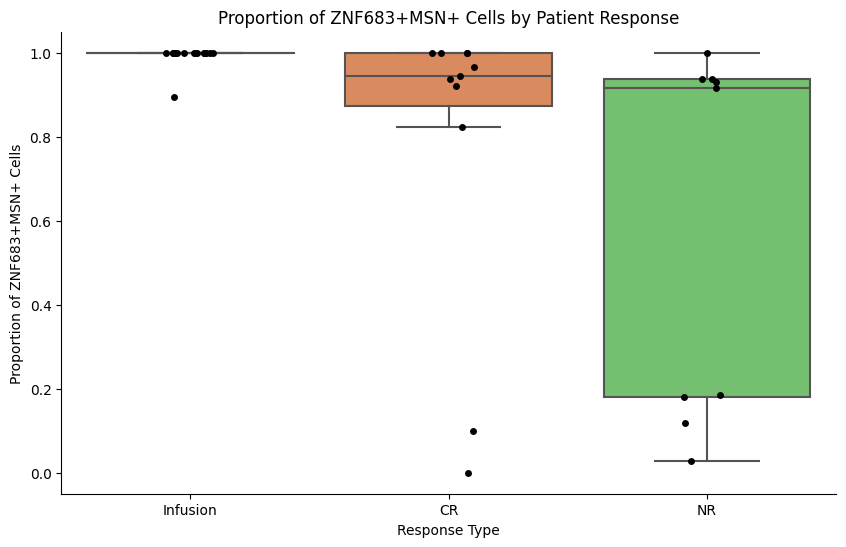

In [11]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from statsmodels.discrete.discrete_model import MNLogit
from sklearn.preprocessing import LabelEncoder
from scipy.sparse import issparse

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Define the genes of interest
genes_up = ["ZNF683", "MSN"]

# Prepare to store results
results = []

# Add unique ID to each patient
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Calculate the proportion of cells expressing both genes for each patient
for patient in adata_CD4.obs['Unique_ID'].unique():
    patient_data = adata_CD4[adata_CD4.obs['Unique_ID'] == patient]
    
    # Extract gene expression
    gene1_expr = patient_data[:, genes_up[0]].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, genes_up[0]].X > 0
    gene2_expr = patient_data[:, genes_up[1]].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, genes_up[1]].X > 0
    
    # Calculate proportion of cells expressing both genes
    both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
    proportion = np.sum(both_genes_expr) / patient_data.shape[0]
    
    # Sum of gene counts
    gene1_count = np.sum(patient_data[:, genes_up[0]].X)
    gene2_count = np.sum(patient_data[:, genes_up[1]].X)
    
    # Convert NumPy arrays to plain Python types, otherwise it would show non-hashable numpy array
    proportion = float(proportion) 

    
    # Append results
    results.append({
        'Patient': patient,
        'Response': str(patient_data.obs['response'].values[0]),  # Convert to string to avoid issues with hashing
        f'Proportion_{genes_up[0]}_{genes_up[1]}_Positive': proportion,
        f'{genes_up[0]}_Count': gene1_count,
        f'{genes_up[1]}_Count': gene2_count
    })

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Encode the 'Response' variable as numeric categories
label_encoder = LabelEncoder()
results_df['Response_Coded'] = label_encoder.fit_transform(results_df['Response'])

# Visualize the proportion of double-positive cells by response type
plt.figure(figsize=(10, 6))
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
sns.boxplot(data=results_df, x='Response', y=f'Proportion_{genes_up[0]}_{genes_up[1]}_Positive', palette='muted', showfliers=False)
sns.stripplot(data=results_df, x='Response', y=f'Proportion_{genes_up[0]}_{genes_up[1]}_Positive', color='black', jitter=True, size=5)
plt.xlabel('Response Type')
plt.ylabel(f'Proportion of {genes_up[0]}+{genes_up[1]}+ Cells')
plt.title(f'Proportion of {genes_up[0]}+{genes_up[1]}+ Cells by Patient Response')
plt.show()


In [32]:
import scanpy as sc
import numpy as np
import pandas as pd
import itertools
from scipy.sparse import issparse
from sklearn.preprocessing import LabelEncoder
from scipy.spatial.distance import pdist, squareform
from skbio.stats.distance import DistanceMatrix
from skbio.stats.distance import permanova

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Encode the 'response' labels
le = LabelEncoder()
adata_CD4.obs['Response_Encoded'] = le.fit_transform(adata_CD4.obs['response'])

# Add a suffix to the patient IDs to make them unique
# Convert 'barcode' and 'timepoint' columns to strings before concatenating
adata_CD4.obs['Unique_ID'] = adata_CD4.obs['barcode'].astype(str) + '-' + adata_CD4.obs['timepoint'].astype(str)

# Define gene list
genes = [
    "PECAM1", "CD7", "FCER1G", "KLRB1",                             # Immune System and Cell Surface Markers
    "JUND", "ZNF683", "TLE5", "LFNG", "TSC22D3", "MAF",             # Transcription Factors and Gene Regulation
    "MTRNR2L12", "RRM2", "TYMS", "GINS2",                           # Mitochondrial and Cellular Metabolism
    "MATK",                                                         # Signal Transduction and Kinases
    "IFITM3",                                                       # Antiviral Response
    "PLP2", "CLSPN", "CTSW"                                         # Cellular Structure and Adhesion
]

# Prepare to store results
results = []

# Iterate over all pairs of genes
for gene1, gene2 in itertools.combinations(genes, 2):
    # Prepare the data for PERMANOVA
    gene_data = model_df[[f'{gene1}_Count', f'{gene2}_Count', 'Proportion_Positive', 'Response_Encoded']]

    # Calculate the distance matrix for the three variables combined
    dist_matrix = squareform(pdist(gene_data[[f'{gene1}_Count', f'{gene2}_Count', 'Proportion_Positive']], metric='euclidean'))

    # Prepare unique IDs for each sample
    ids = gene_data.index.to_list()

    # Convert the distance matrix into a skbio DistanceMatrix object
    dist_matrix = DistanceMatrix(dist_matrix, ids=ids)

    # Perform PERMANOVA for each pairwise comparison
    p_val_CR_NR = permanova(dist_matrix, gene_data['Response_Encoded'].isin([0, 1]), permutations=999)['p-value']
    p_val_Infusion_CR = permanova(dist_matrix, gene_data['Response_Encoded'].isin([1, 2]), permutations=999)['p-value']
    p_val_Infusion_NR = permanova(dist_matrix, gene_data['Response_Encoded'].isin([0, 2]), permutations=999)['p-value']

    # Apply criteria: Significant for CR vs NR and Infusion vs CR, but not Infusion vs NR
    if p_val_CR_NR < 0.05 and p_val_Infusion_CR < 0.05 and p_val_Infusion_NR > 0.05:
        results.append({
            'Gene1': gene1,
            'Gene2': gene2,
            'P-value CR vs NR': p_val_CR_NR,
            'P-value Infusion vs CR': p_val_Infusion_CR,
            'P-value Infusion vs NR': p_val_Infusion_NR
        })

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Export the results to an Excel file
results_df.to_excel('/home/emma/result/CART/CD4_figure3_gene_pair_permanova_results.xlsx', index=False)

print("Analysis complete. Results exported to '/home/emma/result/CART/CD4_figure3_gene_pair_permanova_results.xlsx'.")


KeyError: "['PECAM1_Count', 'CD7_Count'] not in index"

In [25]:
import scanpy as sc
import numpy as np
import pandas as pd
import itertools
from scipy.sparse import issparse
import statsmodels.api as sm
from statsmodels.formula.api import mixedlm

# Load your dataset
import scanpy as sc
import numpy as np
import pandas as pd
import itertools
from scipy.sparse import issparse
import statsmodels.api as sm
from statsmodels.formula.api import mixedlm
from sklearn.preprocessing import LabelEncoder

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Encode the 'response' labels
le = LabelEncoder()
adata_CD4.obs['Response_Encoded'] = le.fit_transform(adata_CD4.obs['response'])

# Define gene list
genes = [
    "PECAM1", "CD7", "FCER1G", "KLRB1",                             # Immune System and Cell Surface Markers
    "JUND", "ZNF683", "TLE5", "LFNG", "TSC22D3", "MAF",             # Transcription Factors and Gene Regulation
    "MTRNR2L12", "RRM2", "TYMS", "GINS2",                           # Mitochondrial and Cellular Metabolism
    "MATK",                                                         # Signal Transduction and Kinases
    "IFITM3",                                                       # Antiviral Response
    "PLP2", "CLSPN", "CTSW"                                         # Cellular Structure and Adhesion
]

# Prepare to store results
results = []

# Iterate over all pairs of genes
for gene1, gene2 in itertools.combinations(genes, 2):
    # Prepare a list to store the data for the model
    model_data = []

    responses = adata_CD4.obs['response'].unique()
    for response in responses:
        resp_adata = adata_CD4[adata_CD4.obs['response'] == response]
        patients = resp_adata.obs['barcode'].unique()
        
        # Calculate the proportion of cells expressing both genes for each patient
        for patient in patients:
            patient_data = resp_adata[resp_adata.obs['barcode'] == patient]
            # Ensure the data is dense if needed
            gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
            gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
            both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
            proportion = np.sum(both_genes_expr) / patient_data.shape[0]
            gene1_count = np.sum(patient_data[:, gene1].X)
            gene2_count = np.sum(patient_data[:, gene2].X)

            # Ensure that the 'Response_Encoded' is properly added to the model_data list
            model_data.append({
                'Patient': patient,
                'Response_Encoded': patient_data.obs['Response_Encoded'].values[0], 
                'Proportion_Positive': proportion,
                f'{gene1}_Count': gene1_count,
                f'{gene2}_Count': gene2_count
            })

    # Convert the model_data list to a DataFrame
    model_df = pd.DataFrame(model_data)

    # Check the first few rows to ensure 'Response_Encoded' exists
    print(model_df.head())

    # Fit a GLMM with both fixed and random effects
    formula = f'Response_Encoded ~ {gene1}_Count + {gene2}_Count + Proportion_Positive'
    model = mixedlm(formula, model_df, groups=model_df['Patient'], re_formula="~1")  # random intercept for each patient
    result = model.fit()
    print(result.summary())


    # Extract the p-values for the fixed effects
    p_values = result.pvalues
    print(p_values.index)  # Check the index to see the correct names

    # Identify significant results based on the specific criteria
    if p_values['Response[T.CR]'] < 0.05 and p_values['Response[T.Infusion]'] > 0.05 and p_values['Response[T.CR]'] < 0.05:
        results.append({
            'Gene1': gene1,
            'Gene2': gene2,
            'P-value CR vs NR': p_values['Response[T.CR]'],
            'P-value Infusion vs NR': p_values['Response[T.Infusion]'],
            'P-value Infusion vs CR': p_values['Response[T.CR]'],
            'Proportion Infusion Mean': model_df.loc[model_df['Response'] == 'Infusion', 'Proportion_Positive'].mean(),
            'Proportion CR Mean': model_df.loc[model_df['Response'] == 'CR', 'Proportion_Positive'].mean(),
            'Proportion NR Mean': model_df.loc[model_df['Response'] == 'NR', 'Proportion_Positive'].mean()
        })

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Export the results to an Excel file
results_df.to_excel('/home/emma/result/CART/CD4_figure3_gene_pair_infusion_vs_cr_vs_nr.xlsx', index=False)

print("Analysis complete. Results exported to '/home/emma/result/CART/CD4_figure3_gene_pair_infusion_vs_cr_vs_nr.xlsx'.")


    Patient  Response_Encoded  Proportion_Positive  PECAM1_Count    CD7_Count
0  Axi-R-01                 1             0.038427    135.913620  2481.344238
1  Axi-R-17                 1             0.000000      0.000000     6.278934
2  Axi-N-18                 1             0.000000      0.000000    44.464352
3  Axi-R-15                 1             0.024390      2.657024    22.558064
4  Axi-N-16                 1             0.018433      5.814222   253.113678
            Mixed Linear Model Regression Results
Model:            MixedLM Dependent Variable: Response_Encoded
No. Observations: 38      Method:             REML            
No. Groups:       28      Scale:              0.5287          
Min. group size:  1       Log-Likelihood:     -52.9463        
Max. group size:  2       Converged:          Yes             
Mean group size:  1.4                                         
--------------------------------------------------------------
                    Coef.  Std.Err.   z  

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


KeyError: 'Response[T.CR]'

In [10]:
import scanpy as sc
import numpy as np
import pandas as pd
import itertools
from scipy.stats import mannwhitneyu, kruskal
from statsmodels.stats.multitest import multipletests
from scipy.sparse import issparse

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Define gene list
genes_up = [
    "PECAM1", "CD7", "FCER1G", "KLRB1",                             # Immune System and Cell Surface Markers
    "JUND", "ZNF683", "TLE5", "LFNG", "TSC22D3", "MAF",             # Transcription Factors and Gene Regulation
    "MTRNR2L12", "RRM2", "TYMS", "GINS2",                           # Mitochondrial and Cellular Metabolism
    "MATK",                                                         # Signal Transduction and Kinases
    "IFITM3",                                                       # Antiviral Response
    "PLP2", "CLSPN", "CTSW"                                         # Cellular Structure and Adhesion
]

# Prepare to store results
results = []

# Iterate over all pairs of genes
for gene1, gene2 in itertools.combinations(genes_up, 2):
    proportions = {}
    
    responses = adata_CD4.obs['response'].unique()
    for response in responses:
        resp_adata = adata_CD4[adata_CD4.obs['response'] == response]
        patients = resp_adata.obs['barcode'].unique()
        # Calculate the proportion of cells expressing both genes for each patient
        for patient in patients:
            patient_data = resp_adata[resp_adata.obs['barcode'] == patient]
            # Ensure the data is dense if needed
            gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
            gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
            both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
            proportion = np.sum(both_genes_expr) / patient_data.shape[0]
            
            if response not in proportions:
                proportions[response] = []
            proportions[response].append(proportion)
        
    # Perform Kruskal-Wallis H-test to compare more than two groups
    group_proportions = [proportions[response] for response in proportions]
    kruskal_p = kruskal(*group_proportions).pvalue
    
    # Store results only if Kruskal-Wallis is significant
    if kruskal_p < 0.05:
        pairwise_p_values = []
        for response1, response2 in itertools.combinations(proportions.keys(), 2):
            u_stat, p_value = mannwhitneyu(proportions[response1], proportions[response2], alternative='two-sided')
            results.append({
                'Gene1': gene1,
                'Gene2': gene2,
                'Response1': response1,
                'Response2': response2,
                'Proportion1 Mean': np.mean(proportions[response1]),
                'Proportion2 Mean': np.mean(proportions[response2]),
                'Mann-Whitney U Stat': u_stat,
                'P-value': p_value
            })
            pairwise_p_values.append(p_value)
        
        # Apply Bonferroni correction only to the 3 pairwise tests for this gene pair
        corrected_p_values = multipletests(pairwise_p_values, method='bonferroni')[1]
        for i in range(3):
            results[-3+i]['Corrected P-value'] = corrected_p_values[i]

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Export the results to an Excel file
results_df.to_excel('/home/emma/result/CART/CD4_figure3_gene_pair_groupwise_response_mannwhitney_combat.xlsx', index=False)

print("Analysis complete. Results exported to '/home/emma/result/CART/CD4_figure3_gene_pair_groupwise_response_mannwhitney_combat.xlsx'.")


Analysis complete. Results exported to '/home/emma/result/CART/CD4_figure3_gene_pair_groupwise_response_mannwhitney_combat.xlsx'.


In [17]:
import scanpy as sc
import numpy as np
import pandas as pd
import itertools
from scipy.stats import mannwhitneyu
from statsmodels.stats.multitest import multipletests
from scipy.sparse import issparse

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Define gene list
genes_up = [
    "PECAM1", "CD7", "FCER1G", "KLRB1",                             # Immune System and Cell Surface Markers
    "JUND", "ZNF683", "TLE5", "LFNG", "TSC22D3", "MAF",             # Transcription Factors and Gene Regulation
    "MTRNR2L12", "RRM2", "TYMS", "GINS2",                           # Mitochondrial and Cellular Metabolism
    "MATK",                                                         # Signal Transduction and Kinases
    "IFITM3",                                                       # Antiviral Response
    "PLP2", "CLSPN", "CTSW"                                         # Cellular Structure and Adhesion
]

# Prepare to store results
results = []

# Iterate over all pairs of genes
for gene1, gene2 in itertools.combinations(genes_up, 2):
    proportions = {}
    
    responses = adata_CD4.obs['response'].unique()
    for response in responses:
        resp_adata = adata_CD4[adata_CD4.obs['response'] == response]
        patients = resp_adata.obs['barcode'].unique()
        # Calculate the proportion of cells expressing both genes for each patient
        for patient in patients:
            patient_data = resp_adata[resp_adata.obs['barcode'] == patient]
            # Ensure the data is dense if needed
            gene1_expr = patient_data[:, gene1].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
            gene2_expr = patient_data[:, gene2].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
            both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
            proportion = np.sum(both_genes_expr) / patient_data.shape[0]
            
            if response not in proportions:
                proportions[response] = []
            proportions[response].append(proportion)
        
    # Perform pairwise Mann-Whitney U tests for Infusion vs CR and Infusion vs NR
    u_stat_cr, p_value_cr = mannwhitneyu(proportions['Infusion'], proportions['CR'], alternative='two-sided')
    u_stat_nr, p_value_nr = mannwhitneyu(proportions['Infusion'], proportions['NR'], alternative='two-sided')
    
    # Apply Bonferroni correction to the p-values
    corrected_p_values = multipletests([p_value_cr, p_value_nr], method='bonferroni')[1]
    
    # Save only the pairs where Infusion vs CR is significant and Infusion vs NR is not
    if corrected_p_values[0] < 0.05 and corrected_p_values[1] >= 0.05:
        results.append({
            'Gene1': gene1,
            'Gene2': gene2,
            'P-value Infusion vs CR': corrected_p_values[0],
            'P-value Infusion vs NR': corrected_p_values[1],
            'Proportion Infusion Mean': np.mean(proportions['Infusion']),
            'Proportion CR Mean': np.mean(proportions['CR']),
            'Proportion NR Mean': np.mean(proportions['NR'])
        })

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Export the results to an Excel file
results_df.to_excel('/home/emma/result/CART/CD4_figure3_gene_pair_infusion_vs_cr_vs_nr.xlsx', index=False)

print("Analysis complete. Results exported to '/home/emma/result/CART/CD4_figure3_gene_pair_infusion_vs_cr_vs_nr.xlsx'.")

Analysis complete. Results exported to '/home/emma/result/CART/CD4_figure3_gene_pair_infusion_vs_cr_vs_nr.xlsx'.


               Patient  Response  Proportion_JUND_IFITM3_Positive
0             Axi-R-01  Infusion                         0.150134
1             Axi-R-17  Infusion                         0.266667
2             Axi-N-18  Infusion                         0.244444
3             Axi-R-15  Infusion                         0.219512
4             Axi-N-16  Infusion                         0.299539
5             Axi-R-13  Infusion                         0.368421
6             Axi-R-19  Infusion                         0.537815
7             Axi-N-10  Infusion                         0.385491
8             Axi-R-11  Infusion                         0.300000
9             Axi-N-09  Infusion                         0.430205
10            Axi-R-08  Infusion                         0.395735
11            Axi-N-07  Infusion                         0.386282
12            Axi-P-05  Infusion                         0.118093
13            Axi-R-04  Infusion                         0.063158
14        

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


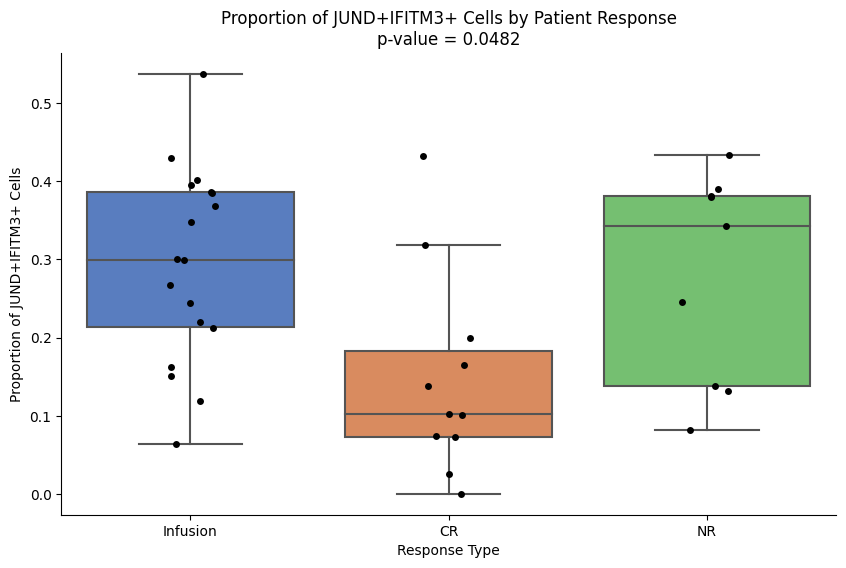

In [40]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import mannwhitneyu

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_log.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Define gene list
genes_up = [
    "PECAM1",  # Signal Transduction and Kinases
    "MAF"  # Cellular Structure and Adhesion
]	


# Prepare to store results
results = []

responses = adata_CD4.obs['response'].unique()
for response in responses:
    resp_adata = adata_CD4[adata_CD4.obs['response'] == response]
    patients = resp_adata.obs['barcode'].unique()
    # Calculate the proportion of cells expressing both genes for each patient
    for patient in patients:
        patient_data = resp_adata[resp_adata.obs['barcode'] == patient]
         # Ensure the data is dense if needed
        gene1_expr = patient_data[:, "JUND"].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene1].X > 0
        gene2_expr = patient_data[:, "TYMS"].X.toarray().flatten() > 0 if issparse(patient_data.X) else patient_data[:, gene2].X > 0
        both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
        proportion = np.sum(both_genes_expr) / patient_data.shape[0]
        
        results.append({
            'Patient': patient,
            'Response': response,
            'Proportion_JUND_IFITM3_Positive': proportion
        })

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Display the DataFrame
print(results_df)

# Statistical Analysis
responders = results_df[results_df['Response'] == 'CR']['Proportion_JUND_IFITM3_Positive']
non_responders = results_df[results_df['Response'] == 'NR']['Proportion_JUND_IFITM3_Positive']
stat, p_value = mannwhitneyu(responders, non_responders)
print(f"Proportion JUND+IFITM3+ cells: p-value = {p_value:.4f}")

# Plotting
plt.figure(figsize=(10, 6))
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
sns.boxplot(data=results_df, x='Response', y='Proportion_JUND_IFITM3_Positive', palette='muted', showfliers=False)
sns.stripplot(data=results_df, x='Response', y='Proportion_JUND_IFITM3_Positive', color='black', jitter=True, size=5)
plt.xlabel('Response Type')
plt.ylabel('Proportion of JUND+IFITM3+ Cells')
plt.title(f'Proportion of JUND+IFITM3+ Cells by Patient Response\np-value = {p_value:.4f}')
plt.show()


Optimization terminated successfully.
         Current function value: 0.541245
         Iterations 9
                          MNLogit Regression Results                          
Dep. Variable:         Response_Coded   No. Observations:                   28
Model:                        MNLogit   Df Residuals:                       20
Method:                           MLE   Df Model:                            6
Date:                Fri, 30 Aug 2024   Pseudo R-squ.:                  0.3982
Time:                        16:17:52   Log-Likelihood:                -15.155
converged:                       True   LL-Null:                       -25.181
Covariance Type:            nonrobust   LLR p-value:                  0.002711
               Response_Coded=1       coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
Intercept                           1.6330      1.238      1.319  

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


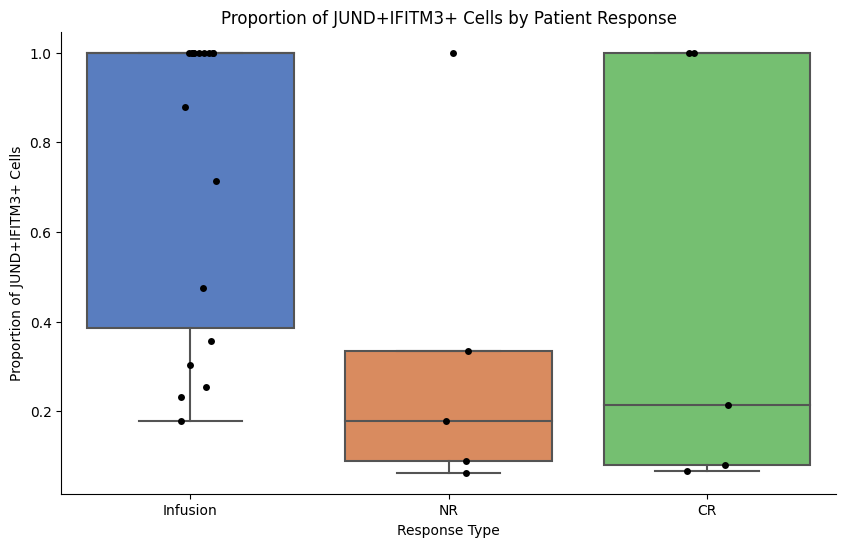

In [41]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from statsmodels.discrete.discrete_model import MNLogit
from sklearn.preprocessing import LabelEncoder

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Define gene list
genes_up = [
    "JUND",  # Signal Transduction and Kinases
    "IFITM3"  # Cellular Structure and Adhesion
]

# Prepare to store results
results = []

# Calculate the proportion of cells expressing both genes and the counts for each patient
for patient in adata_CD4.obs['barcode'].unique():
    patient_data = adata_CD4[adata_CD4.obs['barcode'] == patient]
    gene1_expr = (patient_data[:, "MTRNR2L12"].X > 0).flatten()  # Flatten to ensure scalar values
    gene2_expr = (patient_data[:, "MATK"].X > 0).flatten()  # Flatten to ensure scalar values
    both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
    proportion = np.sum(both_genes_expr) / patient_data.shape[0]
    
    gene1_count = np.sum(patient_data[:, "MTRNR2L12"].X)  # Ensure sum returns a scalar
    gene2_count = np.sum(patient_data[:, "MATK"].X)  # Ensure sum returns a scalar
    
    response = str(patient_data.obs['response'].iloc[0])  # Convert to string to ensure it's hashable
    results.append({
        'Patient': patient,
        'Response': response,  # Ensure that response is a string and hashable
        'Proportion_JUND_IFITM3_Positive': proportion,
        'JUND_Count': gene1_count.item() if isinstance(gene1_count, np.ndarray) else gene1_count,  # Ensure it's a scalar
        'IFITM3_Count': gene2_count.item() if isinstance(gene2_count, np.ndarray) else gene2_count  # Ensure it's a scalar
    })

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Encode the 'Response' variable as numeric categories
label_encoder = LabelEncoder()
results_df['Response_Coded'] = label_encoder.fit_transform(results_df['Response'])

# Fit the multinomial logistic regression model
formula = 'Response_Coded ~ JUND_Count + IFITM3_Count + Proportion_JUND_IFITM3_Positive'
model = MNLogit.from_formula(formula, data=results_df).fit()

# Print the summary of the model
print(model.summary())

# Visualizing the proportion by response
plt.figure(figsize=(10, 6))
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
sns.boxplot(data=results_df, x='Response', y='Proportion_JUND_IFITM3_Positive', palette='muted', showfliers=False)
sns.stripplot(data=results_df, x='Response', y='Proportion_JUND_IFITM3_Positive', color='black', jitter=True, size=5)
plt.xlabel('Response Type')
plt.ylabel('Proportion of JUND+IFITM3+ Cells')
plt.title('Proportion of JUND+IFITM3+ Cells by Patient Response')
plt.show()


                  Multivariate linear model
                                                             
-------------------------------------------------------------
       Intercept         Value  Num DF  Den DF F Value Pr > F
-------------------------------------------------------------
          Wilks' lambda  0.0722 3.0000 23.0000 98.5151 0.0000
         Pillai's trace  0.9278 3.0000 23.0000 98.5151 0.0000
 Hotelling-Lawley trace 12.8498 3.0000 23.0000 98.5151 0.0000
    Roy's greatest root 12.8498 3.0000 23.0000 98.5151 0.0000
-------------------------------------------------------------
                                                             
-------------------------------------------------------------
         Response        Value  Num DF  Den DF F Value Pr > F
-------------------------------------------------------------
           Wilks' lambda 0.5818 6.0000 46.0000  2.3847 0.0434
          Pillai's trace 0.4278 6.0000 48.0000  2.1767 0.0616
  Hotelling-Lawley trace 0

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


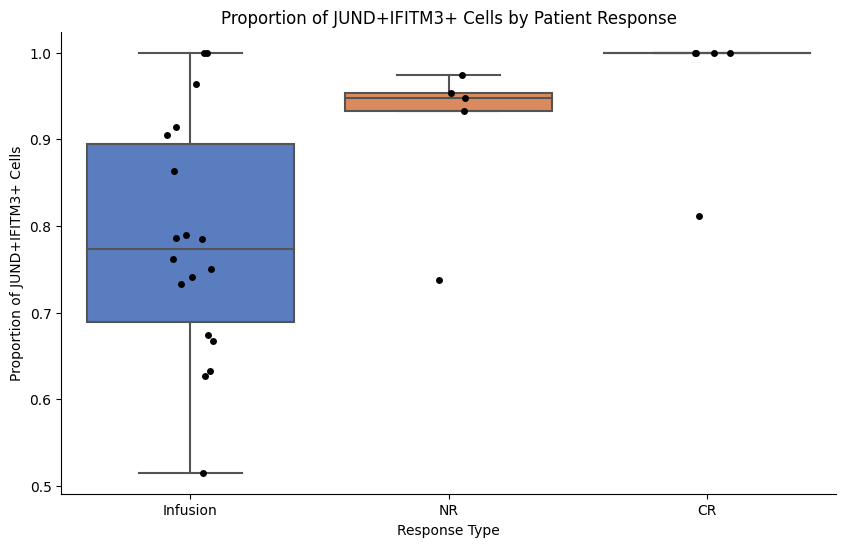

In [12]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from statsmodels.multivariate.manova import MANOVA

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Define gene list
genes_up = [
    "JUND",  # Signal Transduction and Kinases
    "IFITM3"  # Cellular Structure and Adhesion
]

# Prepare to store results
results = []

# Calculate the proportion of cells expressing both genes and the counts for each patient
for patient in adata_CD4.obs['barcode'].unique():
    patient_data = adata_CD4[adata_CD4.obs['barcode'] == patient]
    gene1_expr = (patient_data[:, "JUND"].X > 0).flatten()  # Flatten to ensure scalar values
    gene2_expr = (patient_data[:, "IFITM3"].X > 0).flatten()  # Flatten to ensure scalar values
    both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
    proportion = np.sum(both_genes_expr) / patient_data.shape[0]
    
    gene1_count = np.sum(patient_data[:, "JUND"].X)  # Ensure sum returns a scalar
    gene2_count = np.sum(patient_data[:, "IFITM3"].X)  # Ensure sum returns a scalar
    
    response = str(patient_data.obs['response'].iloc[0])  # Convert to string to ensure it's hashable
    results.append({
        'Patient': patient,
        'Response': response,  # Ensure that response is a string and hashable
        'Proportion_JUND_IFITM3_Positive': proportion,
        'JUND_Count': gene1_count.item() if isinstance(gene1_count, np.ndarray) else gene1_count,  # Ensure it's a scalar
        'IFITM3_Count': gene2_count.item() if isinstance(gene2_count, np.ndarray) else gene2_count  # Ensure it's a scalar
    })

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Fit the MANOVA model
manova = MANOVA.from_formula('JUND_Count + IFITM3_Count + Proportion_JUND_IFITM3_Positive ~ Response', data=results_df)
print(manova.mv_test())

# Visualizing the proportion by response
plt.figure(figsize=(10, 6))
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
sns.boxplot(data=results_df, x='Response', y='Proportion_JUND_IFITM3_Positive', palette='muted', showfliers=False)
sns.stripplot(data=results_df, x='Response', y='Proportion_JUND_IFITM3_Positive', color='black', jitter=True, size=5)
plt.xlabel('Response Type')
plt.ylabel('Proportion of JUND+IFITM3+ Cells')
plt.title('Proportion of JUND+IFITM3+ Cells by Patient Response')
plt.show()


ANOVA results for JUND_Count:
                sum_sq    df         F    PR(>F)
Response  5.514546e+06   2.0  1.483504  0.246136
Residual  4.646554e+07  25.0       NaN       NaN

ANOVA results for IFITM3_Count:
                sum_sq    df        F    PR(>F)
Response  4.685480e+06   2.0  1.97653  0.159613
Residual  2.963197e+07  25.0      NaN       NaN

ANOVA results for Proportion_JUND_IFITM3_Positive:
            sum_sq    df         F    PR(>F)
Response  0.155210   2.0  5.075529  0.014126
Residual  0.382251  25.0       NaN       NaN



/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


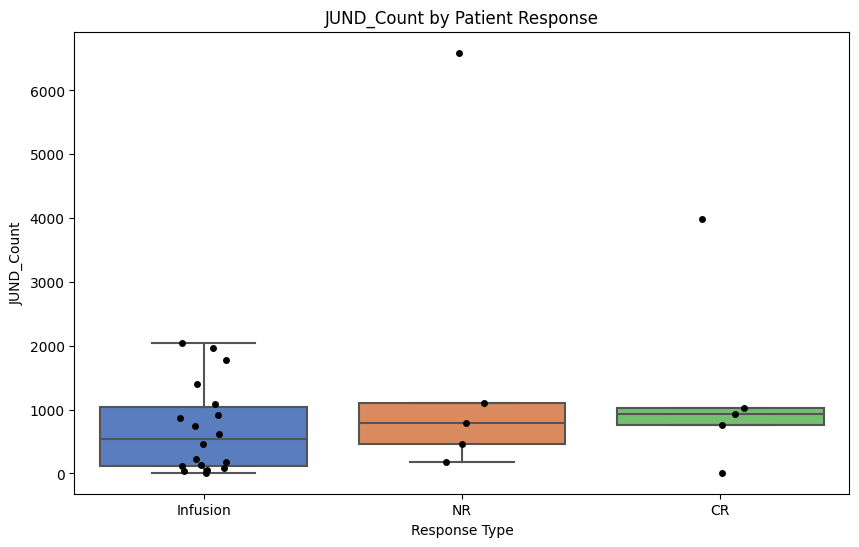

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


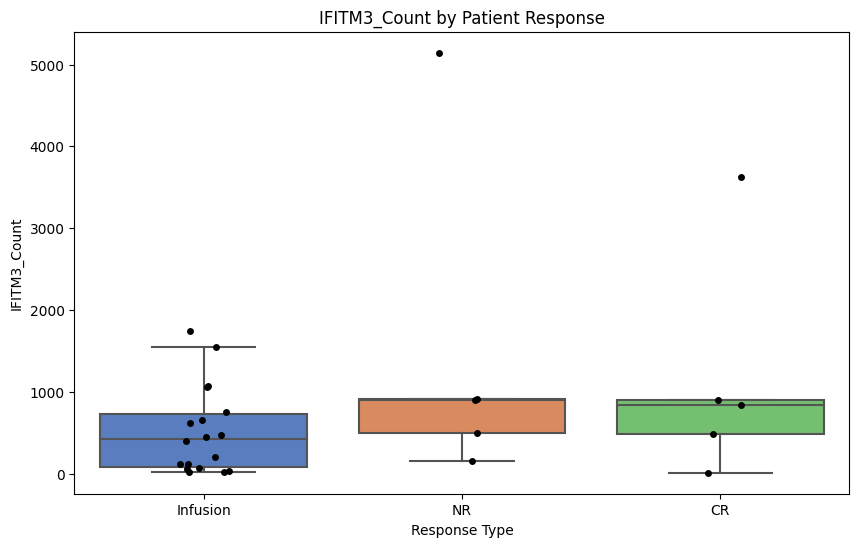

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


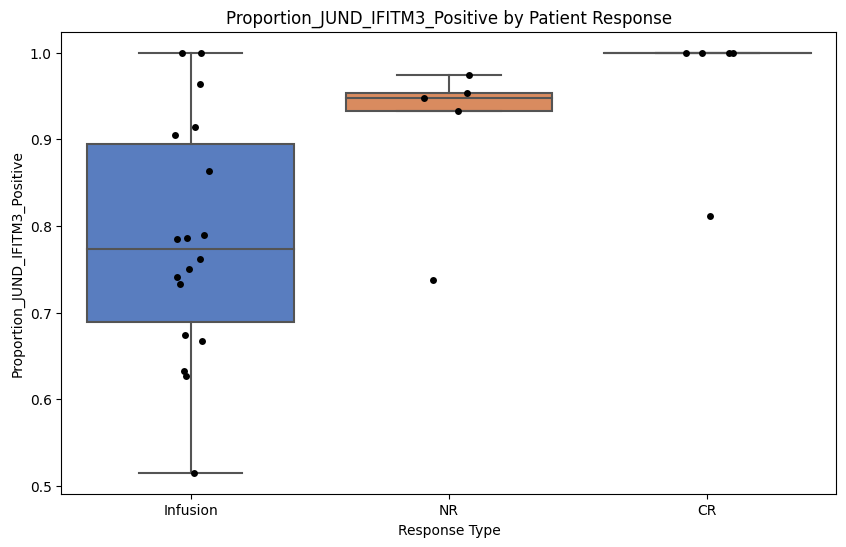

In [13]:
import statsmodels.api as sm
from statsmodels.formula.api import ols
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Perform ANOVA for each dependent variable
variables = ['JUND_Count', 'IFITM3_Count', 'Proportion_JUND_IFITM3_Positive']
anova_results = {}

for var in variables:
    model = ols(f'{var} ~ Response', data=results_df).fit()
    anova_table = sm.stats.anova_lm(model, typ=2)
    anova_results[var] = anova_table
    print(f"ANOVA results for {var}:\n{anova_table}\n")

# Visualize the dependent variables across response groups
for var in variables:
    plt.figure(figsize=(10, 6))
    sns.boxplot(data=results_df, x='Response', y=var, palette='muted', showfliers=False)
    sns.stripplot(data=results_df, x='Response', y=var, color='black', jitter=True, size=5)
    plt.xlabel('Response Type')
    plt.ylabel(var)
    plt.title(f'{var} by Patient Response')
    plt.show()


  Multiple Comparison of Means - Tukey HSD, FWER=0.05   
 group1   group2  meandiff p-adj   lower   upper  reject
--------------------------------------------------------
      CR Infusion  -0.1784 0.0225 -0.3341 -0.0227   True
      CR       NR  -0.0533 0.7764 -0.2481  0.1415  False
Infusion       NR   0.1251 0.1325 -0.0306  0.2808  False
--------------------------------------------------------


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


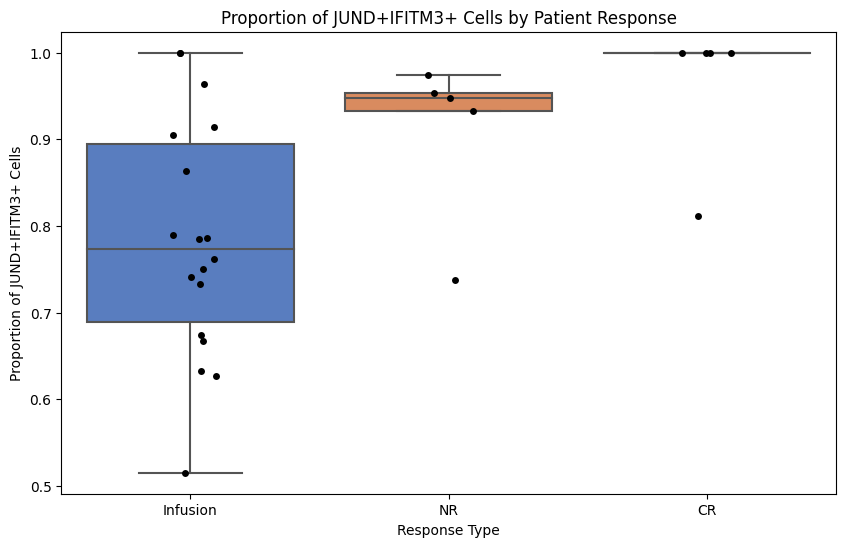

In [14]:
import statsmodels.stats.multicomp as multi

# Perform one-way ANOVA on the significant variable
anova_results = sm.stats.anova_lm(sm.OLS.from_formula('Proportion_JUND_IFITM3_Positive ~ Response', data=results_df).fit())

# Conduct Tukey's HSD post-hoc test
mc = multi.MultiComparison(results_df['Proportion_JUND_IFITM3_Positive'], results_df['Response'])
tukey_result = mc.tukeyhsd()

print(tukey_result)

import seaborn as sns
import matplotlib.pyplot as plt

# Visualizing Proportion_JUND_IFITM3_Positive across Response groups
plt.figure(figsize=(10, 6))
sns.boxplot(data=results_df, x='Response', y='Proportion_JUND_IFITM3_Positive', palette='muted', showfliers=False)
sns.stripplot(data=results_df, x='Response', y='Proportion_JUND_IFITM3_Positive', color='black', jitter=True, size=5)
plt.xlabel('Response Type')
plt.ylabel('Proportion of JUND+IFITM3+ Cells')
plt.title('Proportion of JUND+IFITM3+ Cells by Patient Response')
plt.show()



In [11]:
import scanpy as sc
import numpy as np
import pandas as pd
import itertools
from statsmodels.discrete.discrete_model import MNLogit
from sklearn.preprocessing import LabelEncoder

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Define gene list
genes_up = [
    "PECAM1", "CD7", "FCER1G", "KLRB1",                             # Immune System and Cell Surface Markers
    "JUND", "ZNF683", "TLE5", "LFNG", "TSC22D3", "MAF",             # Transcription Factors and Gene Regulation
    "MTRNR2L12", "RRM2", "TYMS", "GINS2",                           # Mitochondrial and Cellular Metabolism
    "MATK",                                                         # Signal Transduction and Kinases
    "IFITM3",                                                       # Antiviral Response
    "PLP2", "CLSPN", "CTSW"                                         # Cellular Structure and Adhesion
]

# Prepare to store results
significant_pairs = []

# Iterate over all pairs of genes
for gene1, gene2 in itertools.combinations(genes_up, 2):
    results = []
    
    # Calculate the proportion of cells expressing both genes and the counts for each patient
    for patient in adata_CD4.obs['barcode'].unique():
        patient_data = adata_CD4[adata_CD4.obs['barcode'] == patient]
        gene1_expr = (patient_data[:, gene1].X > 0).flatten()
        gene2_expr = (patient_data[:, gene2].X > 0).flatten()
        both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
        proportion = np.sum(both_genes_expr) / patient_data.shape[0]
        
        gene1_count = np.sum(patient_data[:, gene1].X)
        gene2_count = np.sum(patient_data[:, gene2].X)
        
        response = str(patient_data.obs['response'].iloc[0])
        results.append({
            'Patient': patient,
            'Response': response,
            'Proportion_Positive': proportion,
            f'{gene1}_Count': gene1_count,
            f'{gene2}_Count': gene2_count
        })
    
    # Convert the results list to a DataFrame
    results_df = pd.DataFrame(results)
    
    # Encode the 'Response' variable as numeric categories
    label_encoder = LabelEncoder()
    results_df['Response_Coded'] = label_encoder.fit_transform(results_df['Response'])
    
    # Fit the multinomial logistic regression model
    formula = f'Response_Coded ~ {gene1}_Count + {gene2}_Count + Proportion_Positive'
    model = MNLogit.from_formula(formula, data=results_df).fit(disp=0)  # Suppress model output
    
    # Check for significant p-values in the model summary
    p_values = model.pvalues.iloc[1:]  # Exclude the intercept
    if any(p_values < 0.05):
        significant_pairs.append({
            'Gene1': gene1,
            'Gene2': gene2,
            'P-values': p_values
        })

# Convert the significant pairs list to a DataFrame
significant_df = pd.DataFrame(significant_pairs)

# Print out the significant gene pairs
if not significant_df.empty:
    print("Significant gene pairs with p-value < 0.05:")
    print(significant_df)
else:
    print("No significant gene pairs found.")



PatsyError: Error interpreting categorical data: all items must be hashable
    Response_Coded ~ PECAM1_Count + CD7_Count + Proportion_Positive
                     ^^^^^^^^^^^^

In [ ]:
import scanpy as sc
import numpy as np
import pandas as pd
import itertools
from scipy.stats import mannwhitneyu, kruskal
from statsmodels.stats.multitest import multipletests

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD4_CD8A_highly_variable_combat.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Define gene list
all_genes = [
    "PECAM1", "CD7", "FCER1G", "KLRB1",                             # Immune System and Cell Surface Markers
    "JUND", "ZNF683", "TLE5", "LFNG", "TSC22D3", "MAF",             # Transcription Factors and Gene Regulation
    "MTRNR2L12", "RRM2", "TYMS", "GINS2",                           # Mitochondrial and Cellular Metabolism
    "MATK",                                                         # Signal Transduction and Kinases
    "IFITM3",                                                       # Antiviral Response
    "PLP2", "CLSPN", "CTSW"                                  # Cellular Structure and Adhesion
]

# Prepare to store results
results = []

# Iterate over all pairs of genes
for gene1, gene2 in itertools.combinations(all_genes, 2):
    proportions = {}
    
    # Calculate the proportion of cells expressing both genes for each patient
    for patient in adata_CD4.obs['barcode'].unique():
        patient_data = adata_CD4[adata_CD4.obs['barcode'] == patient]
        gene1_expr = patient_data[:, gene1].X > 0
        gene2_expr = patient_data[:, gene2].X > 0
        both_genes_expr = np.logical_and(gene1_expr, gene2_expr)
        proportion = np.sum(both_genes_expr) / patient_data.shape[0]
        
        response = patient_data.obs['response'].iloc[0]  # Assuming each patient has one response type
        if response not in proportions:
            proportions[response] = []
        proportions[response].append(proportion)
    
    # Perform Kruskal-Wallis H-test to compare more than two groups
    group_proportions = [proportions[response] for response in proportions]
    kruskal_p = kruskal(*group_proportions).pvalue
    
    # If Kruskal-Wallis is significant, perform pairwise Mann-Whitney U tests
    if kruskal_p < 0.05:
        for response1, response2 in itertools.combinations(proportions.keys(), 2):
            u_stat, p_value = mannwhitneyu(proportions[response1], proportions[response2], alternative='two-sided')
            results.append({
                'Gene1': gene1,
                'Gene2': gene2,
                'Response1': response1,
                'Response2': response2,
                'Proportion1 Mean': np.mean(proportions[response1]),
                'Proportion2 Mean': np.mean(proportions[response2]),
                'Mann-Whitney U Stat': u_stat,
                'P-value': p_value
            })
    
# Adjust p-values for multiple comparisons using Bonferroni correction
p_values = [result['P-value'] for result in results]
if p_values:  # Ensure there are p-values to correct
    corrected_p_values = multipletests(p_values, method='bonferroni')[1]
    for i, result in enumerate(results):
        result['Corrected P-value'] = corrected_p_values[i]
else:
    print("No p-values to correct. Skipping Bonferroni correction.")

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Export the results to an Excel file
results_df.to_excel('/home/emma/result/CART/CD4_figure3_gene_pair_groupwise_response_mannwhitney.xlsx', index=False)

print("Analysis complete. Results exported to '/home/emma/data/CART/CD4_figure3_gene_pair_groupwise_response_mannwhitney.xlsx'.")

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


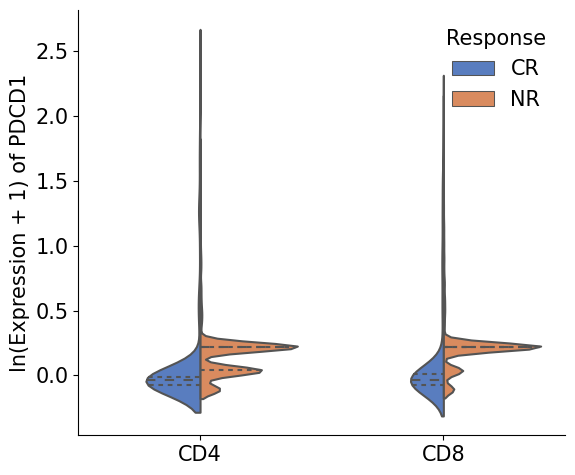

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


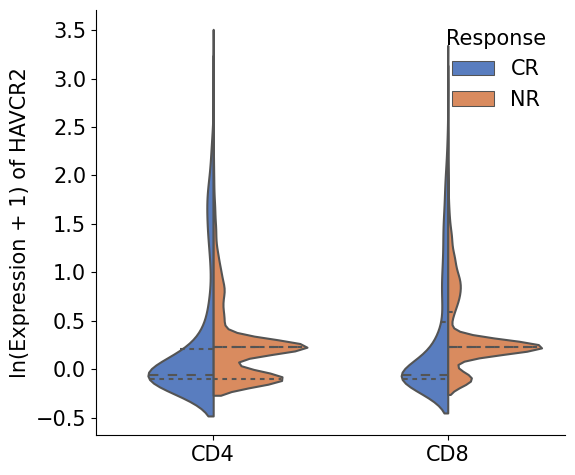

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


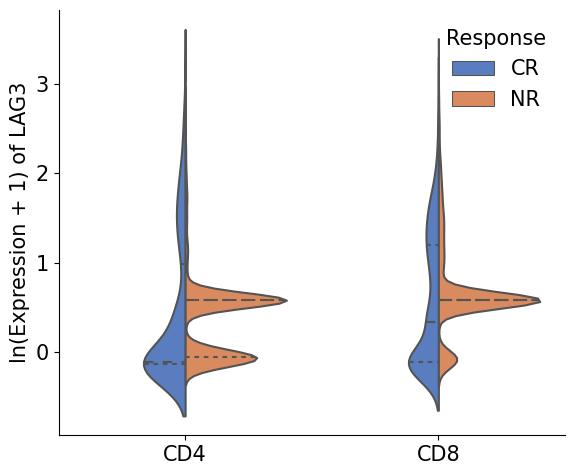

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


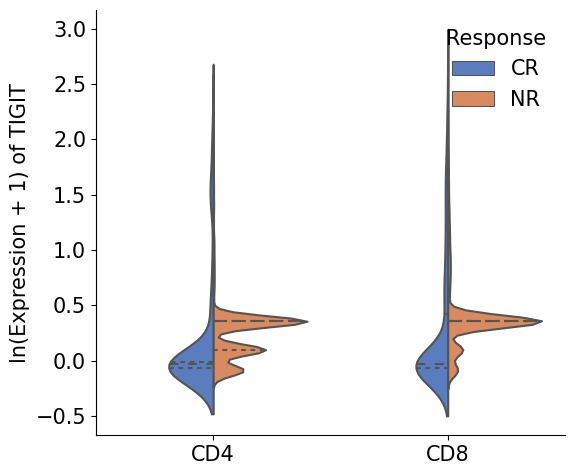

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


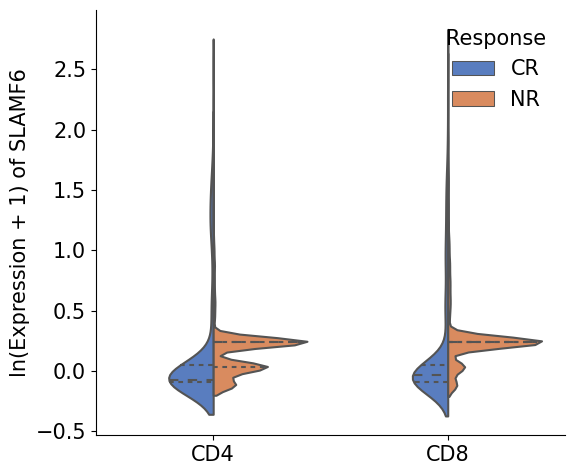

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


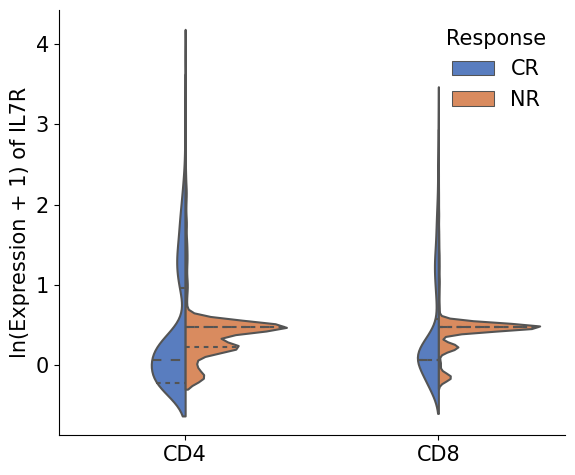

In [16]:
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt

# Load your dataset
#adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_D7sorted_CD4_CD8A_highly_variable_combat_CR_NR.h5ad')
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD4_CD8A_highly_variable_combat.h5ad')
adata_CD4 = adata[adata.obs['cell_type'] == 'CD4'].copy()

# Filter data based on your conditions
all_genes = [
    "PECAM1", "CD7", "FCER1G", "KLRB1",                             # Immune System and Cell Surface Markers
    "JUND", "ZNF683", "TLE5", "LFNG", "TSC22D3", "MAF",             # Transcription Factors and Gene Regulation
    "MTRNR2L12", "RRM2", "TYMS", "GINS2",                           # Mitochondrial and Cellular Metabolism
    "MATK",                                                         # Signal Transduction and Kinases
    "IFITM3",                                                       # Antiviral Response
    "PLP2", "CLSPN", "MSN", "CTSW"                                  # Cellular Structure and Adhesion
]


for genes in all_genes.pairwise():
    responses = adata.obs['response'].unique()
    for response in responses:
        filtered_adata = adata[adata.obs['response'] == response].copy()
        mask = filtered_adata.obs_vector('genes') > 0
        ratio = np.sum(mask) / filtered_adata.shape[0]


        # Plotting
        plt.figure(figsize=(6, 5))
        plt.rcParams.update({'font.size': 15})
        ax = sns.violinplot(data=df, x="cell_type", y=gene, hue="response", split=True, inner="quart", palette="muted")
        sns.despine()  # Remove the top and right spines
        plt.title(f'')
        plt.xlabel('')
        plt.ylabel(f'ln(Expression + 1) of {gene}')

        # Positioning the legend on the top left
        plt.legend(title='Response', frameon=False)
        plt.tight_layout()
        plt.savefig(f'/home/emma/result/CART/violinplot_all3_13_14_15/{gene}_clusters3_13_14_15_violinplot.png')
        plt.show()
    else:
        print(f"{gene} is not present in the variable names. Please check your adata object.")

In [17]:
import scanpy as sc
import pandas as pd
from scipy.stats import mannwhitneyu

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_D7sorted_CD4_CD8A_highly_variable_combat_CR_NR.h5ad')

# Apply your filters for relevant clusters
mask = adata.obs['leiden_0.9'].isin(['3', '13', '14', '15'])
adata = adata[mask].copy()

# List of genes to check
genes = ['PDCD1', 'HAVCR2', 'LAG3', 'TIGIT', 'SLAMF6', 'IL7R']

# Iterate over each gene in the list
for gene in genes:
    if gene in adata.var_names:
        # Convert to DataFrame for easier manipulation
        df = adata.to_df()
        df['cell_type'] = adata.obs['cell_type']
        df['response'] = adata.obs['response']

        # Separate the data by cell type and response for each gene
        cd4_nr = df[(df['cell_type'] == 'CD4') & (df['response'] == 'NR')][gene]
        cd4_cr = df[(df['cell_type'] == 'CD4') & (df['response'] == 'CR')][gene]
        cd8_nr = df[(df['cell_type'] == 'CD8') & (df['response'] == 'NR')][gene]
        cd8_cr = df[(df['cell_type'] == 'CD8') & (df['response'] == 'CR')][gene]

        # Perform Mann-Whitney U test for CD4 and CD8 T cells
        mwu_cd4 = mannwhitneyu(cd4_nr, cd4_cr, alternative='two-sided')
        mwu_cd8 = mannwhitneyu(cd8_nr, cd8_cr, alternative='two-sided')

        print(f"Mann-Whitney U test for CD4 T cells (NR vs. CR) on {gene}: U = {mwu_cd4.statistic}, p-value = {mwu_cd4.pvalue}")
        print(f"Mann-Whitney U test for CD8 T cells (NR vs. CR) on {gene}: U = {mwu_cd8.statistic}, p-value = {mwu_cd8.pvalue}")
    else:
        print(f"{gene} is not present in the variable names. Please check your adata object.")

Mann-Whitney U test for CD4 T cells (NR vs. CR) on PDCD1: U = 1551406.0, p-value = 3.5098259259672507e-125
Mann-Whitney U test for CD8 T cells (NR vs. CR) on PDCD1: U = 2920583.0, p-value = 1.6259302101768312e-155
Mann-Whitney U test for CD4 T cells (NR vs. CR) on HAVCR2: U = 1161346.0, p-value = 2.5013232470057116e-14
Mann-Whitney U test for CD8 T cells (NR vs. CR) on HAVCR2: U = 2531841.0, p-value = 4.374076576220207e-52
Mann-Whitney U test for CD4 T cells (NR vs. CR) on LAG3: U = 1233437.0, p-value = 7.656645072180966e-27
Mann-Whitney U test for CD8 T cells (NR vs. CR) on LAG3: U = 2269282.0, p-value = 5.2542452853730486e-20
Mann-Whitney U test for CD4 T cells (NR vs. CR) on TIGIT: U = 1373005.0, p-value = 5.340796828556375e-61
Mann-Whitney U test for CD8 T cells (NR vs. CR) on TIGIT: U = 2673975.0, p-value = 5.502708296915208e-88
Mann-Whitney U test for CD4 T cells (NR vs. CR) on SLAMF6: U = 1337295.0, p-value = 8.707058249041202e-51
Mann-Whitney U test for CD8 T cells (NR vs. CR) 

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


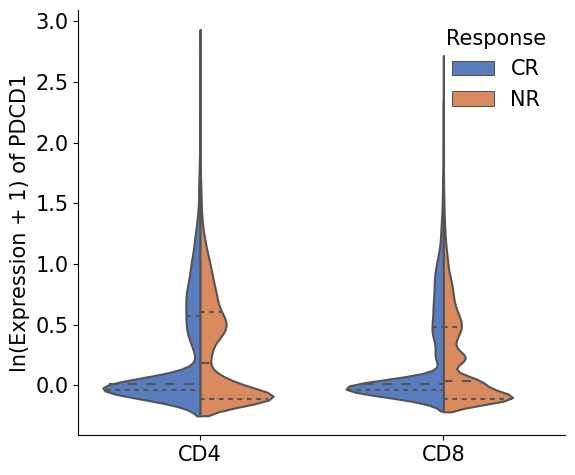

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


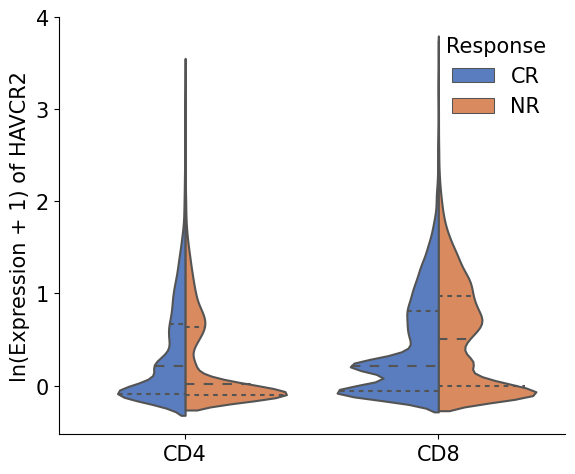

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


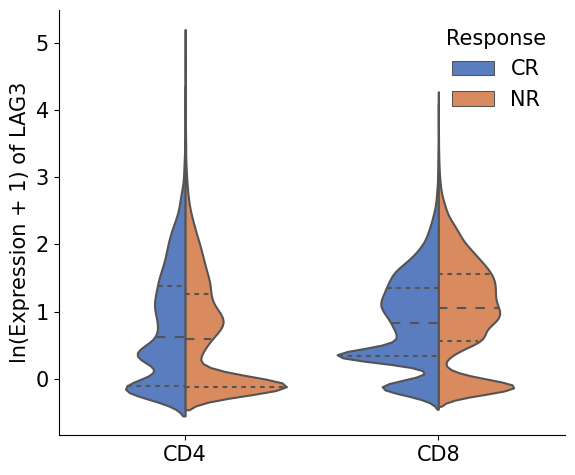

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


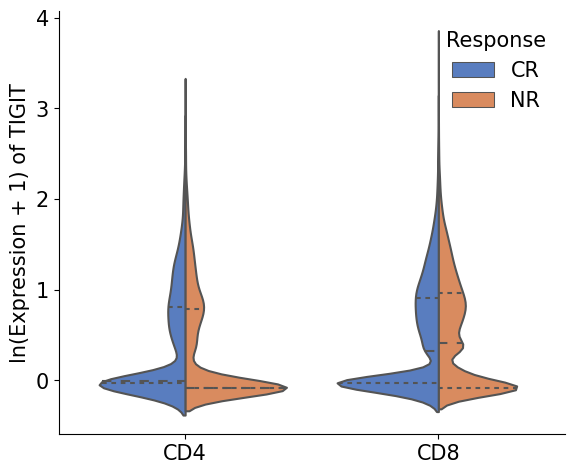

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


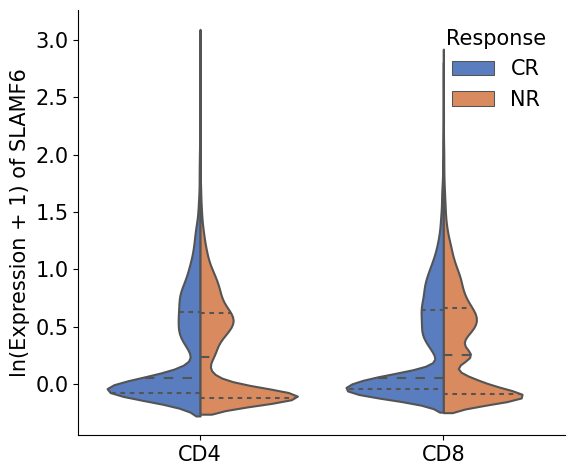

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


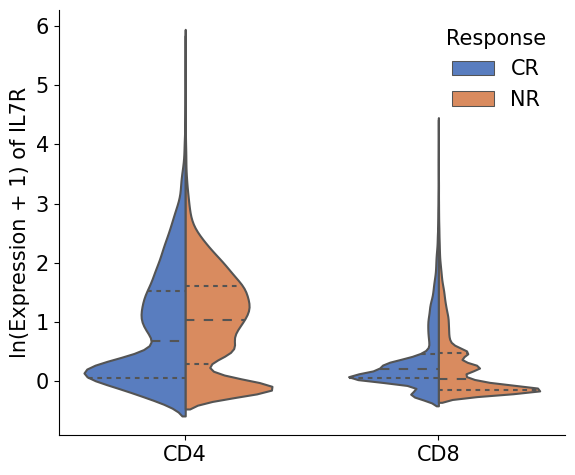

In [18]:
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_D7sorted_CD4_CD8A_highly_variable_combat_CR_NR.h5ad')

# Filter data based on your conditions
#mask = adata.obs['leiden_0.9'].isin(['3', '13', '14', '15']) | ((adata.obs['leiden_0.9'].isin(['1', '5', '10', '11'])) & (adata.obs['cell_type'] == 'CD8'))
mask = adata.obs['leiden_0.9'].isin(['3', '13', '14', '15'])
adata = adata[~mask].copy()

genes = ['PDCD1', 'HAVCR2', 'LAG3', 'TIGIT', 'SLAMF6', 'IL7R']  # Ensure variable names are correct and consistent
# Iterate over each gene in the list
for gene in genes:
    if gene in adata.var_names:
        # Convert to DataFrame for plotting
        df = adata.to_df()

        # Adding metadata from adata.obs
        df['cell_type'] = adata.obs['cell_type']
        df['response'] = adata.obs['response']

        # Plotting
        plt.figure(figsize=(6, 5))
        plt.rcParams.update({'font.size': 15})
        ax = sns.violinplot(data=df, x="cell_type", y=gene, hue="response", split=True, inner="quart", palette="muted")
        sns.despine()  # Remove the top and right spines
        plt.title(f'')
        plt.xlabel('')
        plt.ylabel(f'ln(Expression + 1) of {gene}')

        # Positioning the legend on the top left
        plt.legend(title='Response', frameon=False)
        plt.tight_layout()
        plt.savefig(f'/home/emma/result/CART/violinplot_all3_13_14_15/{gene}_rest_clusters_violinplot.png')
        plt.show()
    else:
        print(f"{gene} is not present in the variable names. Please check your adata object.")

In [19]:
import scanpy as sc
import pandas as pd
from scipy.stats import mannwhitneyu

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_D7sorted_CD4_CD8A_highly_variable_combat_CR_NR.h5ad')

# Apply your filters for relevant clusters
mask = adata.obs['leiden_0.9'].isin(['3', '13', '14', '15'])
adata = adata[~mask].copy()

# List of genes to check
genes = ['PDCD1', 'HAVCR2', 'LAG3', 'TIGIT', 'SLAMF6', 'IL7R']

# Iterate over each gene in the list
for gene in genes:
    if gene in adata.var_names:
        # Convert to DataFrame for easier manipulation
        df = adata.to_df()
        df['cell_type'] = adata.obs['cell_type']
        df['response'] = adata.obs['response']

        # Separate the data by cell type and response for each gene
        cd4_nr = df[(df['cell_type'] == 'CD4') & (df['response'] == 'NR')][gene]
        cd4_cr = df[(df['cell_type'] == 'CD4') & (df['response'] == 'CR')][gene]
        cd8_nr = df[(df['cell_type'] == 'CD8') & (df['response'] == 'NR')][gene]
        cd8_cr = df[(df['cell_type'] == 'CD8') & (df['response'] == 'CR')][gene]

        # Perform Mann-Whitney U test for CD4 and CD8 T cells
        mwu_cd4 = mannwhitneyu(cd4_nr, cd4_cr, alternative='two-sided')
        mwu_cd8 = mannwhitneyu(cd8_nr, cd8_cr, alternative='two-sided')

        print(f"Mann-Whitney U test for CD4 T cells (NR vs. CR) on {gene}: U = {mwu_cd4.statistic}, p-value = {mwu_cd4.pvalue}")
        print(f"Mann-Whitney U test for CD8 T cells (NR vs. CR) on {gene}: U = {mwu_cd8.statistic}, p-value = {mwu_cd8.pvalue}")
    else:
        print(f"{gene} is not present in the variable names. Please check your adata object.")


Mann-Whitney U test for CD4 T cells (NR vs. CR) on PDCD1: U = 21727517.0, p-value = 1.941544769801867e-06
Mann-Whitney U test for CD8 T cells (NR vs. CR) on PDCD1: U = 115492154.0, p-value = 2.2115481397069676e-13
Mann-Whitney U test for CD4 T cells (NR vs. CR) on HAVCR2: U = 18069631.0, p-value = 2.5742357622688018e-95
Mann-Whitney U test for CD8 T cells (NR vs. CR) on HAVCR2: U = 128781021.0, p-value = 5.027514636417175e-21
Mann-Whitney U test for CD4 T cells (NR vs. CR) on LAG3: U = 21793920.0, p-value = 7.850175509848641e-06
Mann-Whitney U test for CD8 T cells (NR vs. CR) on LAG3: U = 138209438.0, p-value = 2.3074731547533963e-100
Mann-Whitney U test for CD4 T cells (NR vs. CR) on TIGIT: U = 18165743.0, p-value = 1.2718002070391494e-91
Mann-Whitney U test for CD8 T cells (NR vs. CR) on TIGIT: U = 121246073.0, p-value = 0.9365009716119875
Mann-Whitney U test for CD4 T cells (NR vs. CR) on SLAMF6: U = 19677369.0, p-value = 2.1943107184273237e-42
Mann-Whitney U test for CD8 T cells (N

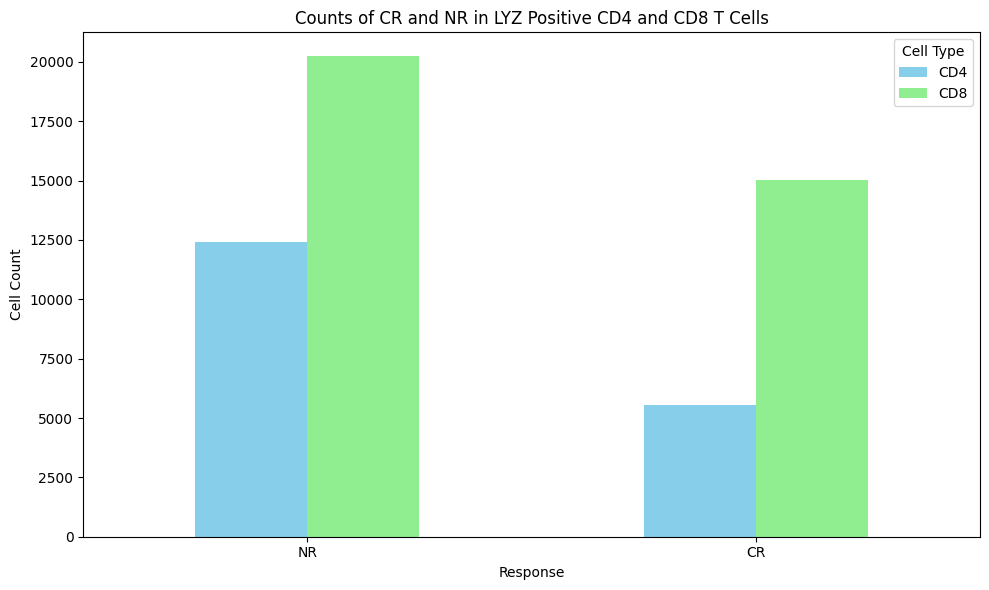

ModuleNotFoundError: No module named 'ace_tools'

In [2]:
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_D7sorted_CD4_CD8A_highly_variable_combat_CR_NR.h5ad')

# Filter for LYZ-positive cells
lyz_positive = adata[:, adata.var_names.isin(['LYZ'])].X > 0
lyz_positive_cells = adata[lyz_positive]

# Create a DataFrame for easier manipulation
df = pd.DataFrame({
    'cell_type': lyz_positive_cells.obs['cell_type'],
    'response': lyz_positive_cells.obs['response']
})

# Filter for CD4 and CD8 T cells
cd4_cells = df[df['cell_type'] == 'CD4']
cd8_cells = df[df['cell_type'] == 'CD8']

# Count the number of CR and NR cells in CD4 and CD8 T cell populations
cd4_counts = cd4_cells['response'].value_counts()
cd8_counts = cd8_cells['response'].value_counts()

# Create a summary DataFrame
summary_df = pd.DataFrame({
    'CD4': cd4_counts,
    'CD8': cd8_counts
}).fillna(0).astype(int)

# Plot the counts as a bar graph
summary_df.plot(kind='bar', figsize=(10, 6), color=['skyblue', 'lightgreen'])
plt.title('Counts of CR and NR in LYZ Positive CD4 and CD8 T Cells')
plt.xlabel('Response')
plt.ylabel('Cell Count')
plt.xticks(rotation=0)
plt.legend(title='Cell Type')
plt.tight_layout()
plt.savefig('/home/emma/result/CART/LYZ_positive_CD4_CD8_CR_NR_counts.png')
plt.show()

# Display the summary
import ace_tools as tools; tools.display_dataframe_to_user(name="LYZ Positive CD4 and CD8 T cells - CR and NR Counts", dataframe=summary_df)

print(summary_df)


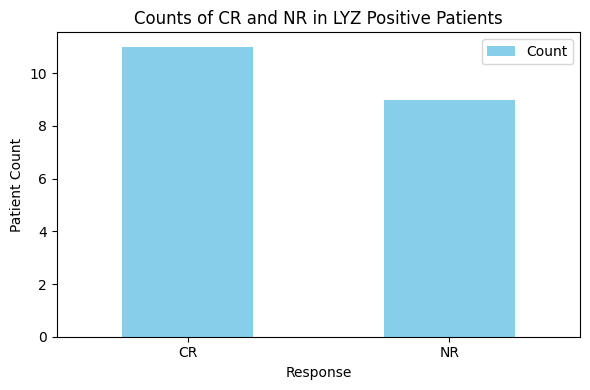

ModuleNotFoundError: No module named 'ace_tools'

In [4]:
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_D7sorted_CD4_CD8A_highly_variable_combat_CR_NR.h5ad')

# Filter for LYZ-positive cells
lyz_positive = adata[:, adata.var_names.isin(['LYZ'])].X > 0
lyz_positive_cells = adata[lyz_positive]

# Create a DataFrame for easier manipulation
df = pd.DataFrame({
    'barcode': lyz_positive_cells.obs['barcode'],
    'response': lyz_positive_cells.obs['response']
})

# Count the number of unique CR and NR patients in LYZ-positive cells
response_counts = df.drop_duplicates('barcode')['response'].value_counts()

# Create a summary DataFrame
summary_df = pd.DataFrame({
    'Count': response_counts
}).fillna(0).astype(int)

# Plot the counts as a bar graph
summary_df.plot(kind='bar', figsize=(6, 4), color=['skyblue', 'lightgreen'])
plt.title('Counts of CR and NR in LYZ Positive Patients')
plt.xlabel('Response')
plt.ylabel('Patient Count')
plt.xticks(rotation=0)
plt.tight_layout()
plt.savefig('/home/emma/result/CART/LYZ_positive_patient_CR_NR_counts.png')
plt.show()

# Display the summary
import ace_tools as tools; tools.display_dataframe_to_user(name="LYZ Positive Patients - CR and NR Counts", dataframe=summary_df)

print(summary_df)


/tmp/ipykernel_2535613/1053494334.py:19: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_group = df.groupby('barcode')


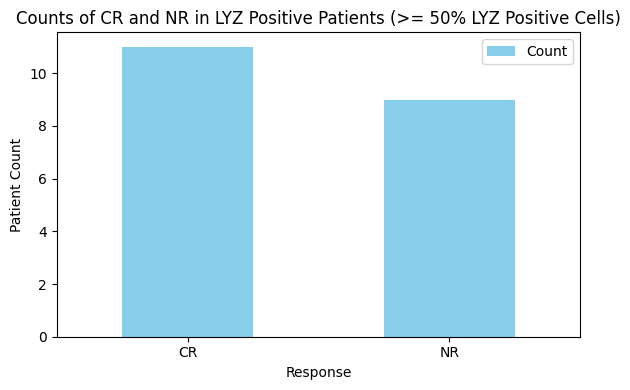

ModuleNotFoundError: No module named 'ace_tools'

In [2]:
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_D7sorted_CD4_CD8A_highly_variable_combat_CR_NR.h5ad')

# Determine LYZ-positive cells
lyz_positive = adata[:, adata.var_names.isin(['LYZ'])].X > 0

# Add LYZ-positive information to adata.obs
adata.obs['lyz_positive'] = lyz_positive

# Create a DataFrame for easier manipulation
df = adata.obs[['barcode', 'response', 'lyz_positive']]

# Calculate the percentage of LYZ-positive cells for each patient
patient_group = df.groupby('barcode')
percent_lyz_positive = patient_group['lyz_positive'].mean() * 100

# Determine which patients have at least 50% LYZ-positive cells
lyz_positive_patients = percent_lyz_positive[percent_lyz_positive >= 50].index

# Filter the original DataFrame for LYZ-positive patients
lyz_positive_df = df[df['barcode'].isin(lyz_positive_patients)]

# Count the number of unique CR and NR patients in LYZ-positive cells
response_counts = lyz_positive_df.drop_duplicates('barcode')['response'].value_counts()

# Create a summary DataFrame
summary_df = pd.DataFrame({
    'Count': response_counts
}).fillna(0).astype(int)

# Plot the counts as a bar graph
summary_df.plot(kind='bar', figsize=(6, 4), color=['skyblue', 'lightgreen'])
plt.title('Counts of CR and NR in LYZ Positive Patients (>= 50% LYZ Positive Cells)')
plt.xlabel('Response')
plt.ylabel('Patient Count')
plt.xticks(rotation=0)
plt.tight_layout()
plt.savefig('/home/emma/result/CART/LYZ_positive_patient_CR_NR_counts.png')
plt.show()

# Display the summary
import ace_tools as tools; tools.display_dataframe_to_user(name="LYZ Positive Patients - CR and NR Counts", dataframe=summary_df)

print(summary_df)

/tmp/ipykernel_2536115/2377581712.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_lyz_total = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minico

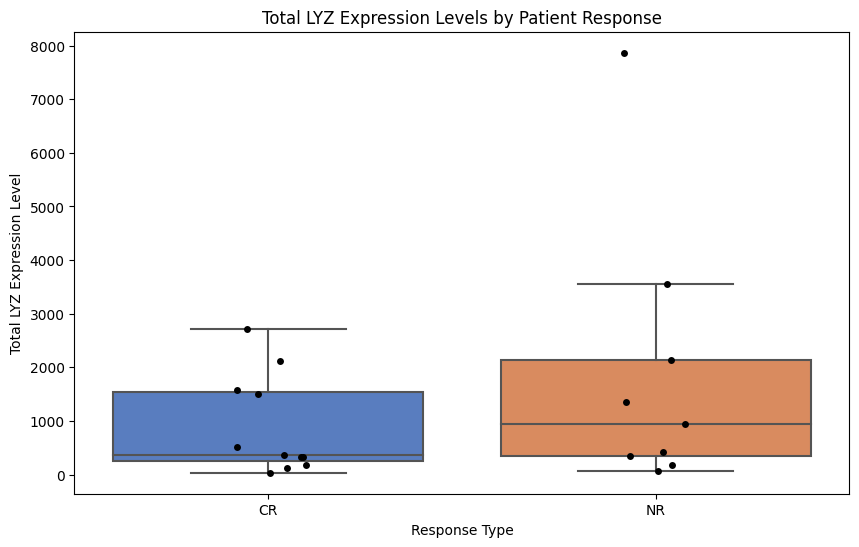

In [3]:
import scanpy as sc
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_D7sorted_CD4_CD8A_highly_variable_combat_CR_NR.h5ad')

# Get the LYZ expression data
adata.obs['LYZ_expression'] = adata[:, 'LYZ'].X.toarray().flatten()  # Adjust if using a sparse matrix

# Create a DataFrame with patient IDs, their response, and LYZ expression
df = adata.obs[['barcode', 'response', 'LYZ_expression']]

# Group by patient ID and calculate total LYZ expression
patient_lyz_total = df.groupby('barcode').agg({
    'response': 'first',  # Assuming response is the same for all entries of the same patient
    'LYZ_expression': 'sum'
}).reset_index()

# Plotting
plt.figure(figsize=(10, 6))
sns.boxplot(data=patient_lyz_total, x='response', y='LYZ_expression', palette='muted', showfliers=False)
sns.stripplot(data=patient_lyz_total, x='response', y='LYZ_expression', color='black', jitter=True, size=5)
plt.title('Total LYZ Expression Levels by Patient Response')
plt.xlabel('Response Type')
plt.ylabel('Total LYZ Expression Level')
plt.savefig('/home/emma/result/CART/total_LYZ_expression_by_patient_boxplot.png')
plt.show()



/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


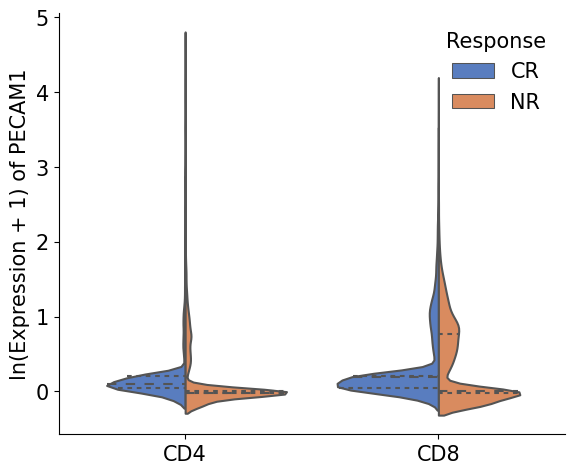

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


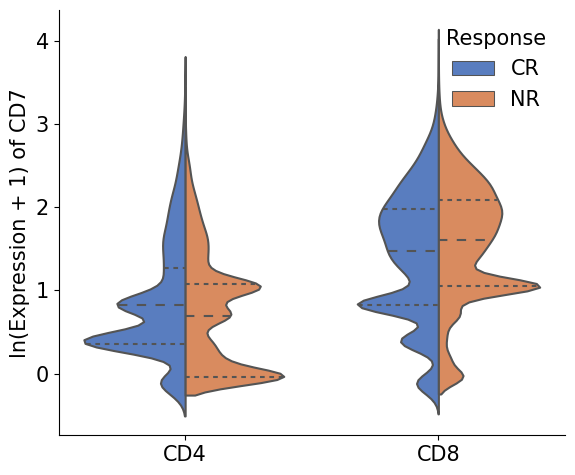

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


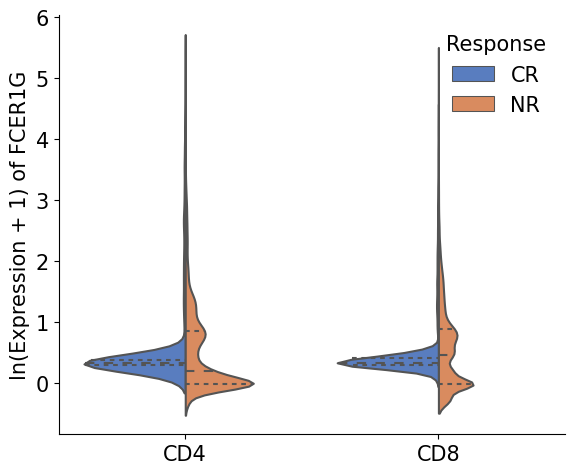

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


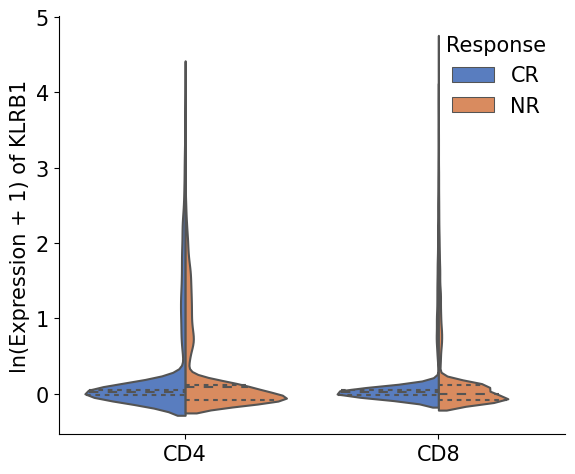

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


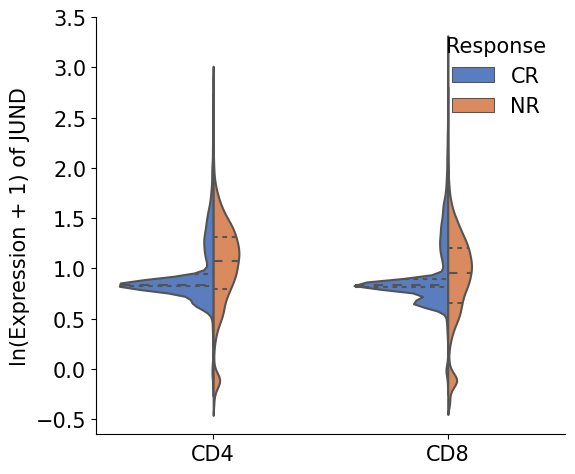

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


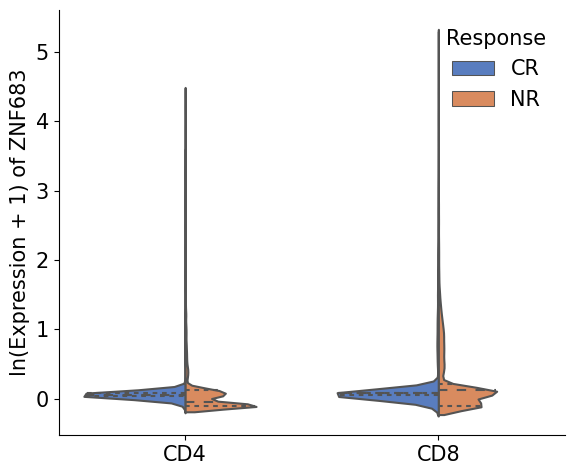

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


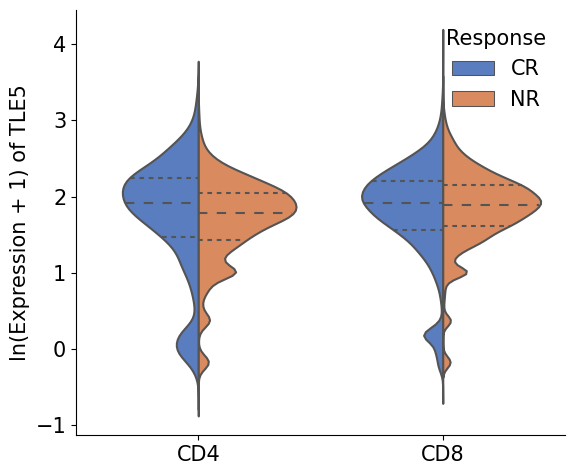

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


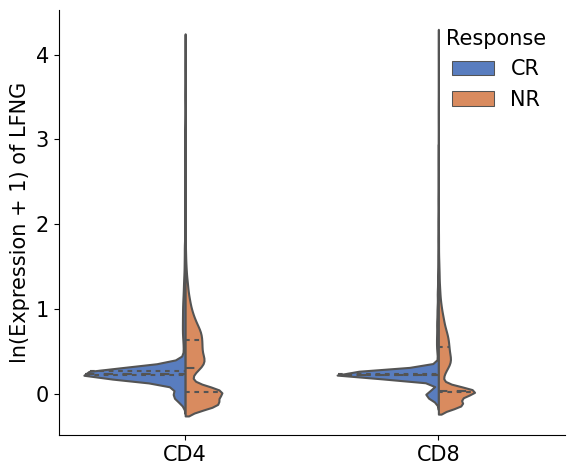

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


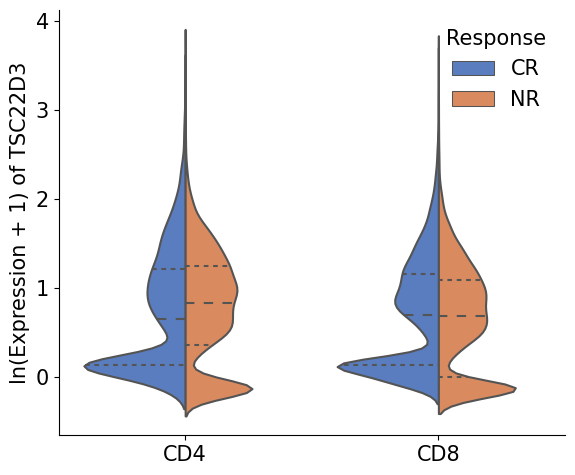

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


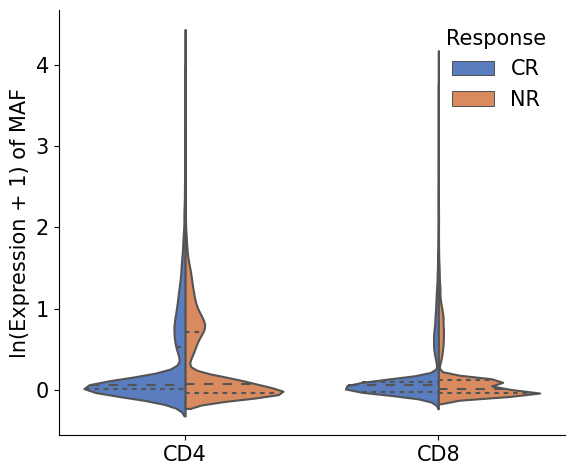

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


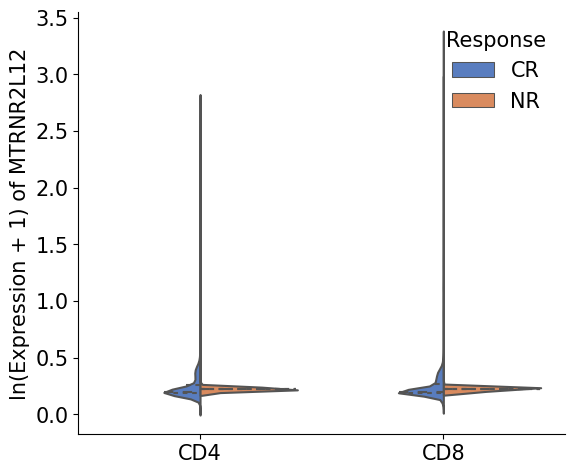

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


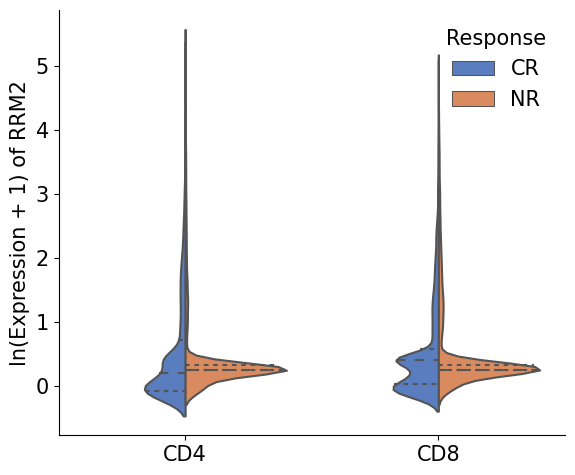

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


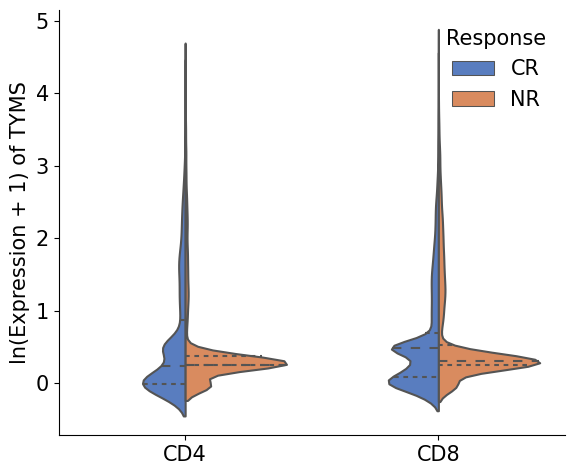

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


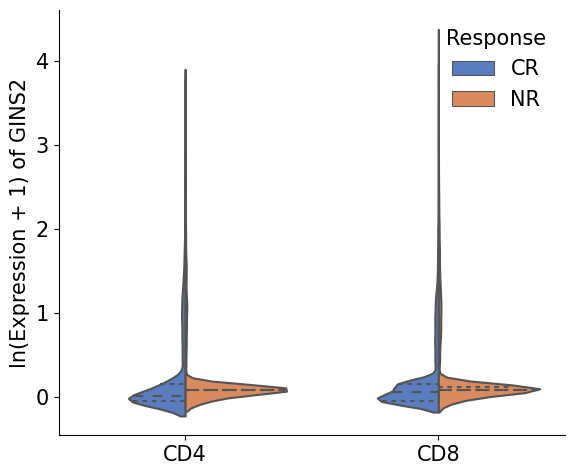

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


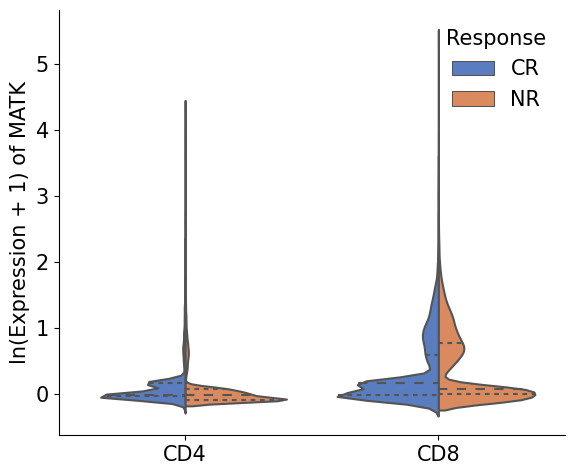

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


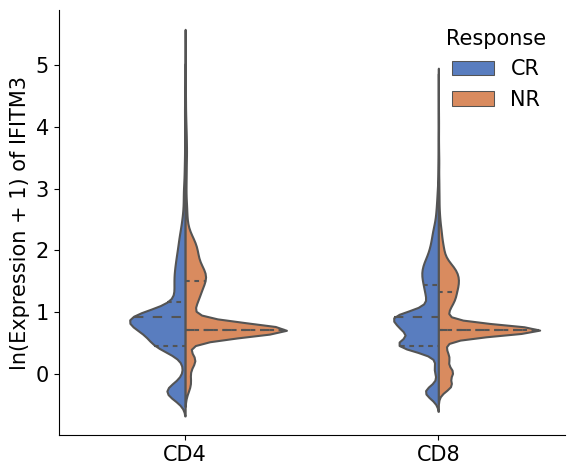

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


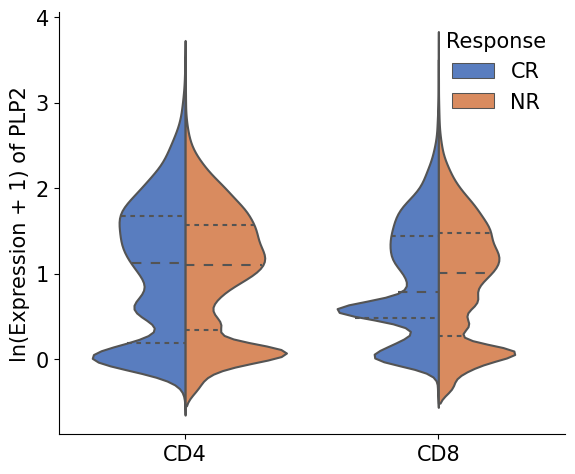

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


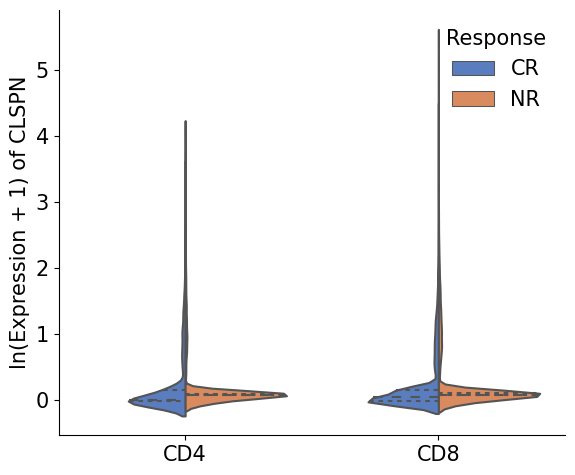

MSN is not present in the variable names. Please check your adata object.


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


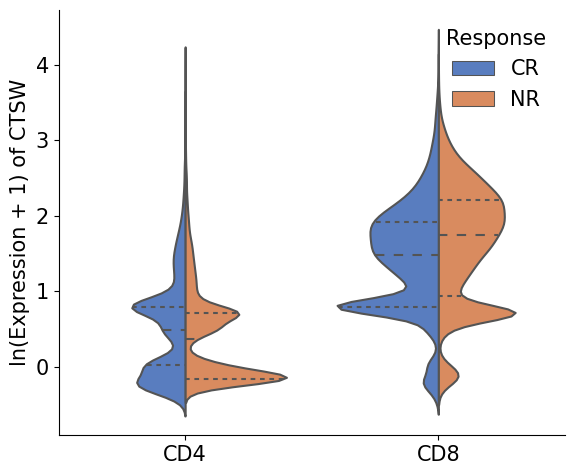

In [4]:
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_D7sorted_CD4_CD8A_highly_variable_combat_CR_NR.h5ad')

# Filter data based on your conditions
#mask = adata.obs['leiden_0.9'].isin(['3', '13', '14', '15']) | ((adata.obs['leiden_0.9'].isin(['1', '5', '10', '11'])) & (adata.obs['cell_type'] == 'CD8'))
##mask = adata.obs['leiden_0.9'].isin(['3', '13', '14', '15'])
#adata = adata[mask].copy()

genes = [
    "PECAM1", "CD7", "FCER1G", "KLRB1",                             # Immune System and Cell Surface Markers
    "JUND", "ZNF683", "TLE5", "LFNG", "TSC22D3", "MAF",             # Transcription Factors and Gene Regulation
    "MTRNR2L12", "RRM2", "TYMS", "GINS2",                           # Mitochondrial and Cellular Metabolism
    "MATK",                                                         # Signal Transduction and Kinases
    "IFITM3",                                                       # Antiviral Response
    "PLP2", "CLSPN", "MSN", "CTSW"                                  # Cellular Structure and Adhesion
]  # Ensure variable names are correct and consistent
# Iterate over each gene in the list
for gene in genes:
    if gene in adata.var_names:
        # Convert to DataFrame for plotting
        df = adata.to_df()

        # Adding metadata from adata.obs
        df['cell_type'] = adata.obs['cell_type']
        df['response'] = adata.obs['response']

        # Plotting
        plt.figure(figsize=(6, 5))
        plt.rcParams.update({'font.size': 15})
        ax = sns.violinplot(data=df, x="cell_type", y=gene, hue="response", split=True, inner="quart", palette="muted")
        sns.despine()  # Remove the top and right spines
        plt.title(f'')
        plt.xlabel('')
        plt.ylabel(f'ln(Expression + 1) of {gene}')

        # Positioning the legend on the top left
        plt.legend(title='Response', frameon=False)
        plt.tight_layout()
        plt.savefig(f'/home/emma/result/CART/violinplot_all3_13_14_15/{gene}_clusters3_13_14_15_violinplot.png')
        plt.show()
    else:
        print(f"{gene} is not present in the variable names. Please check your adata object.")

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


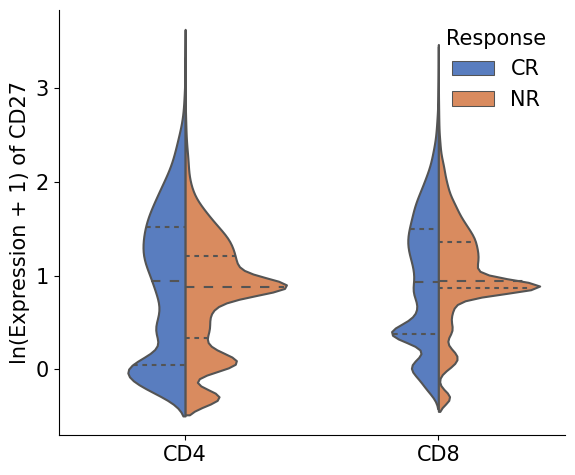

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


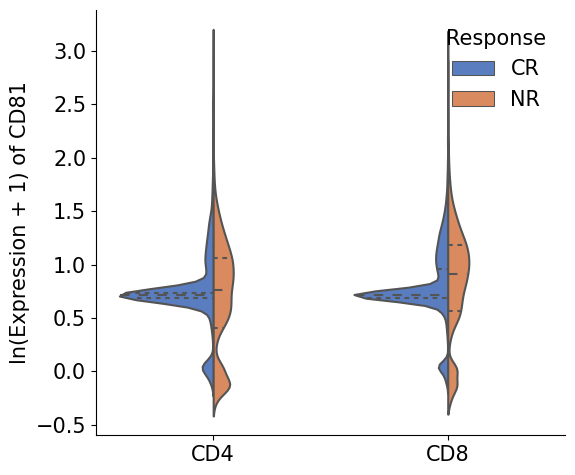

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


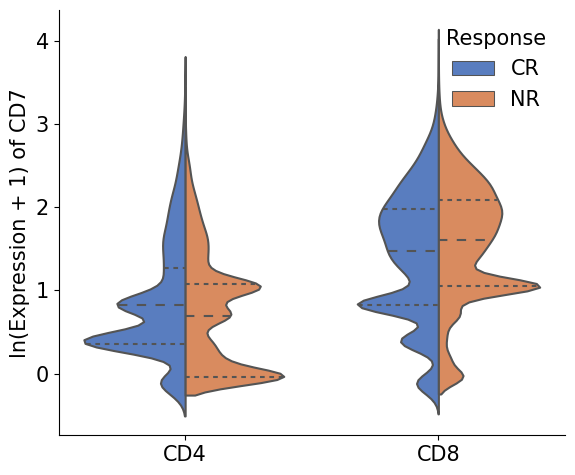

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


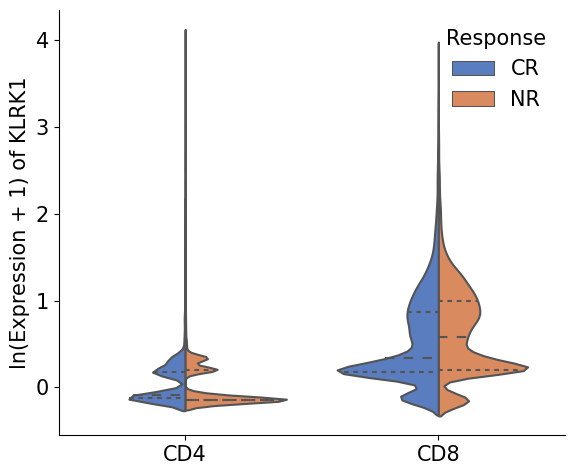

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


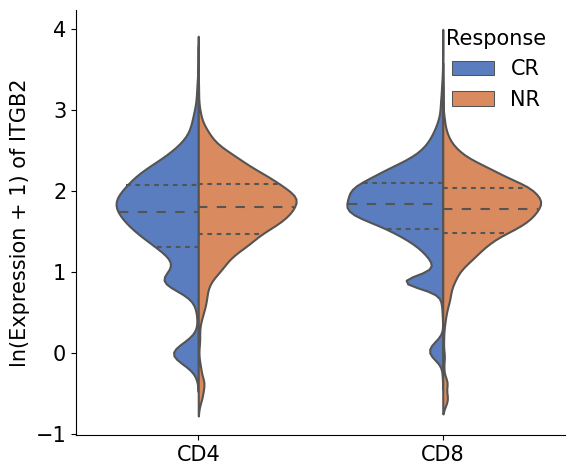

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


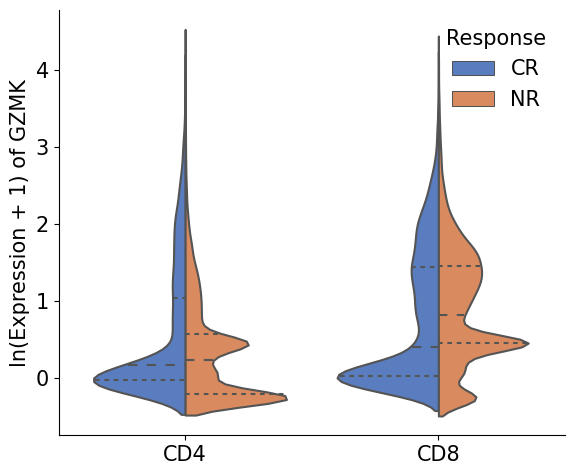

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


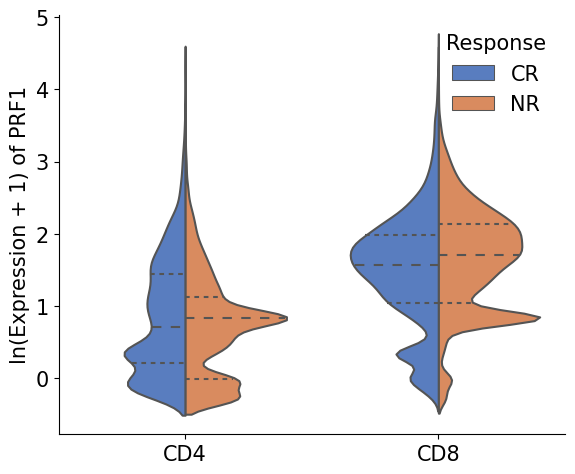

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


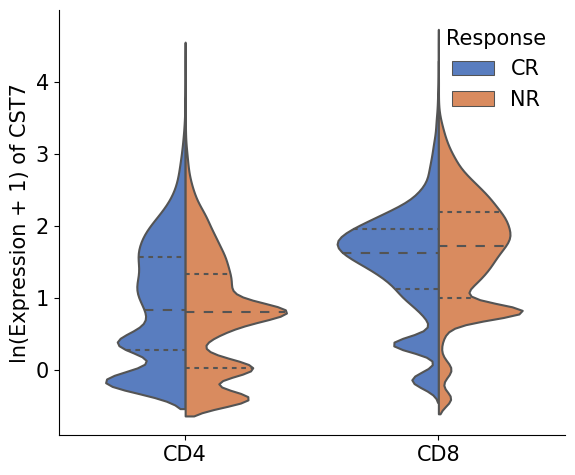

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


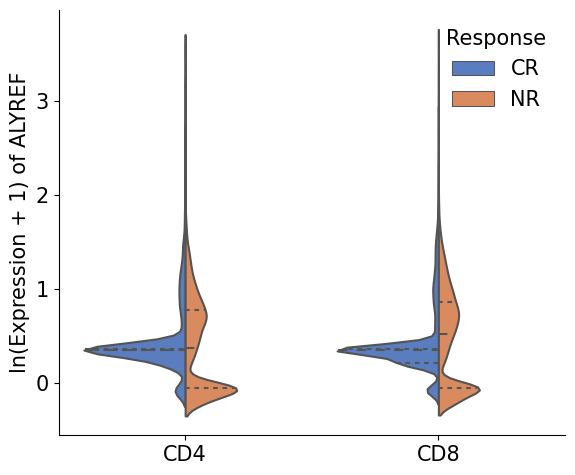

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


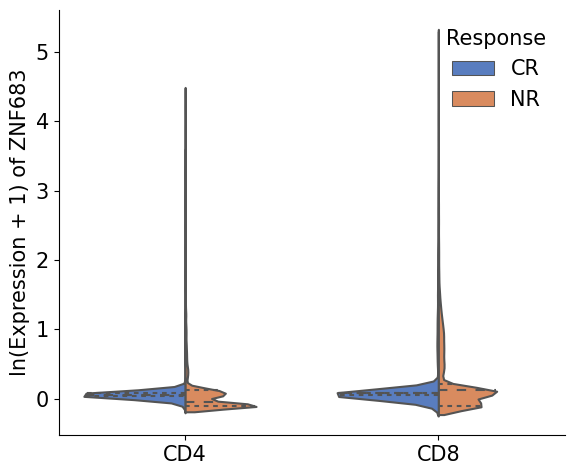

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


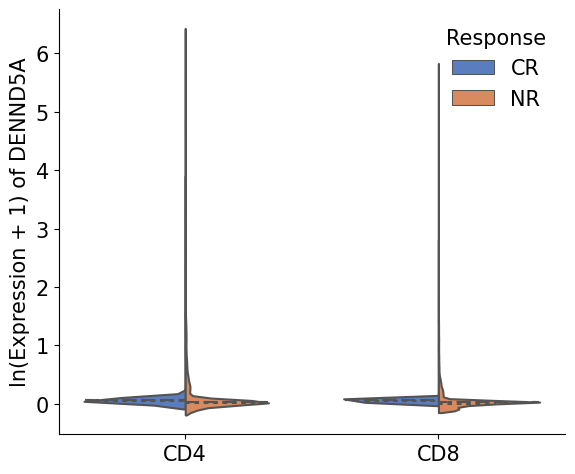

ARL4C is not present in the variable names. Please check your adata object.


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


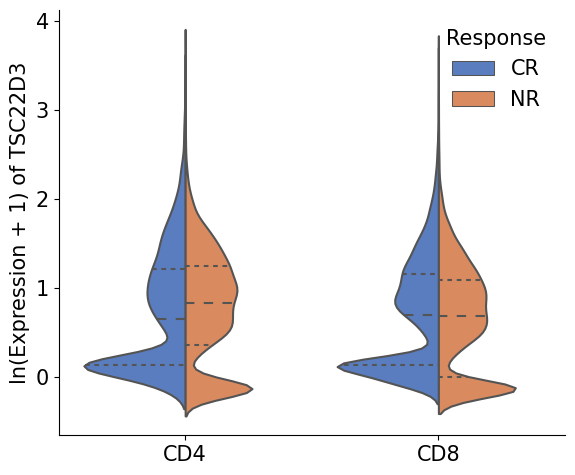

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


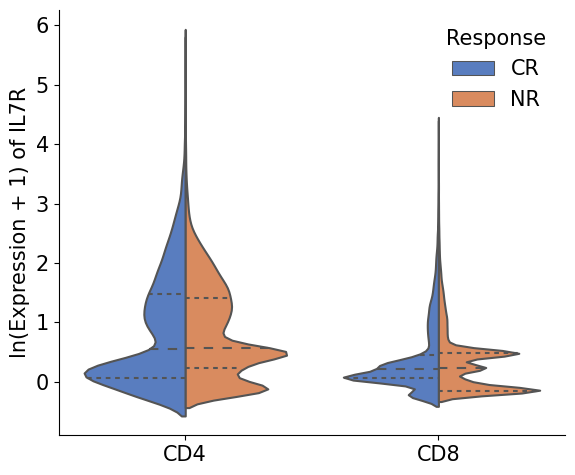

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


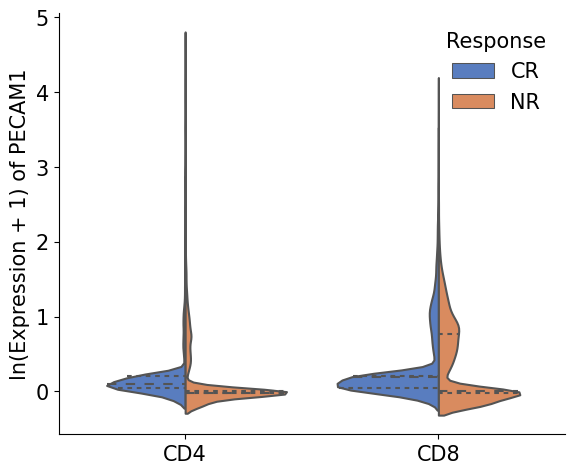

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


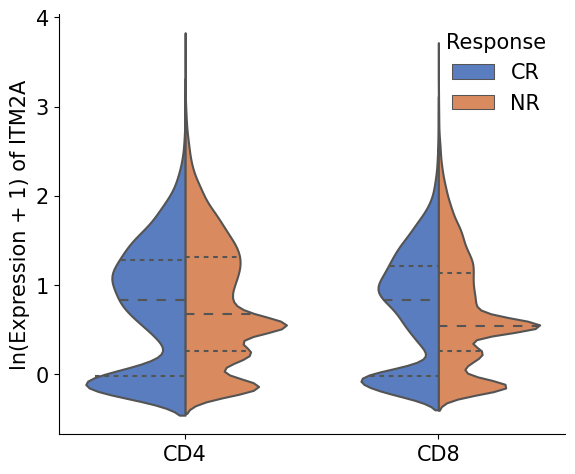

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


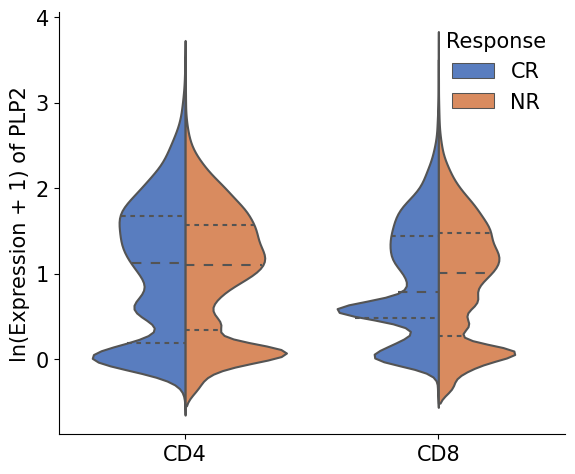

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


TMEM123 is not present in the variable names. Please check your adata object.


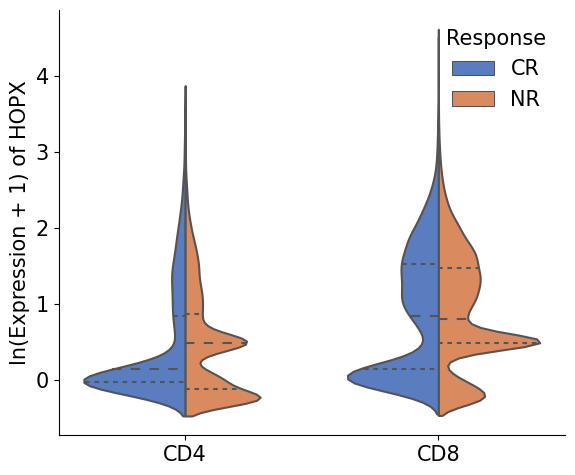

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


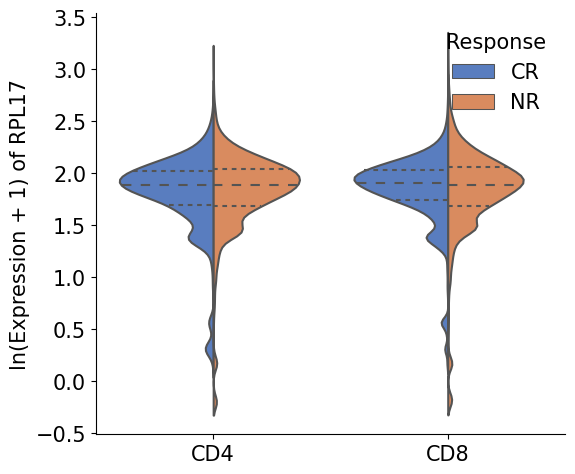

In [5]:
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_D7sorted_CD4_CD8A_highly_variable_combat_CR_NR.h5ad')

# Filter data based on your conditions
#mask = adata.obs['leiden_0.9'].isin(['3', '13', '14', '15']) | ((adata.obs['leiden_0.9'].isin(['1', '5', '10', '11'])) & (adata.obs['cell_type'] == 'CD8'))
##mask = adata.obs['leiden_0.9'].isin(['3', '13', '14', '15'])
#adata = adata[mask].copy()

genes = [
    "CD27", "CD81", "CD7", "KLRK1", "ITGB2",                          # Immune System and Cell Surface Markers
    "GZMK", "PRF1", "CST7",                                           # Cytotoxicity and Immune Response
    "ALYREF", "ZNF683",                                               # Transcription Factors and Gene Regulation
    "DENND5A", "ARL4C", "TSC22D3",                                    # Signal Transduction and Kinases
    "IL7R",                                                           # Cytokine Receptors
    "PECAM1", "ITM2A", "PLP2", "TMEM123", "HOPX", "RPL17"             # Cellular Structure and Metabolism
]
  # Ensure variable names are correct and consistent
# Iterate over each gene in the list
for gene in genes:
    if gene in adata.var_names:
        # Convert to DataFrame for plotting
        df = adata.to_df()

        # Adding metadata from adata.obs
        df['cell_type'] = adata.obs['cell_type']
        df['response'] = adata.obs['response']

        # Plotting
        plt.figure(figsize=(6, 5))
        plt.rcParams.update({'font.size': 15})
        ax = sns.violinplot(data=df, x="cell_type", y=gene, hue="response", split=True, inner="quart", palette="muted")
        sns.despine()  # Remove the top and right spines
        plt.title(f'')
        plt.xlabel('')
        plt.ylabel(f'ln(Expression + 1) of {gene}')

        # Positioning the legend on the top left
        plt.legend(title='Response', frameon=False)
        plt.tight_layout()
        plt.savefig(f'/home/emma/result/CART/violinplot_all3_13_14_15/{gene}_clusters3_13_14_15_violinplot.png')
        plt.show()
    else:
        print(f"{gene} is not present in the variable names. Please check your adata object.")

/tmp/ipykernel_3166425/3627766515.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


PECAM1: p-value = 0.1965


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


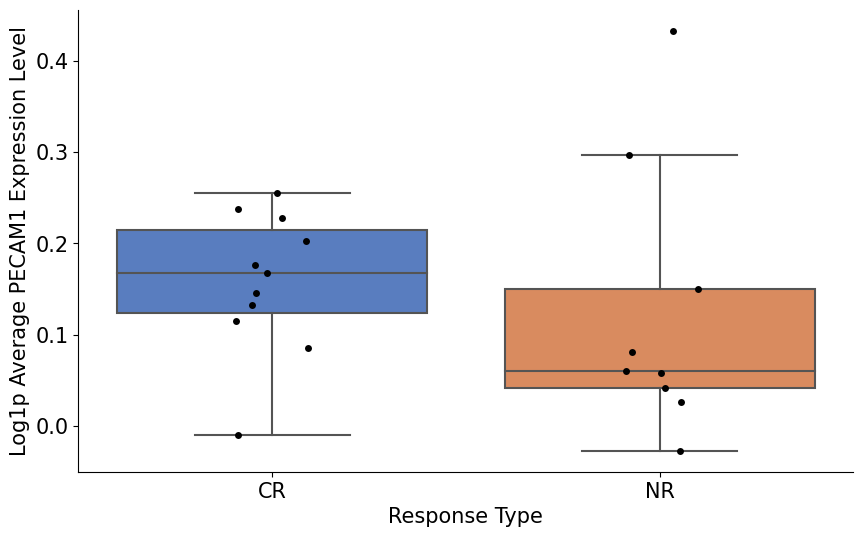

CD7: p-value = 0.0682


/tmp/ipykernel_3166425/3627766515.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicon

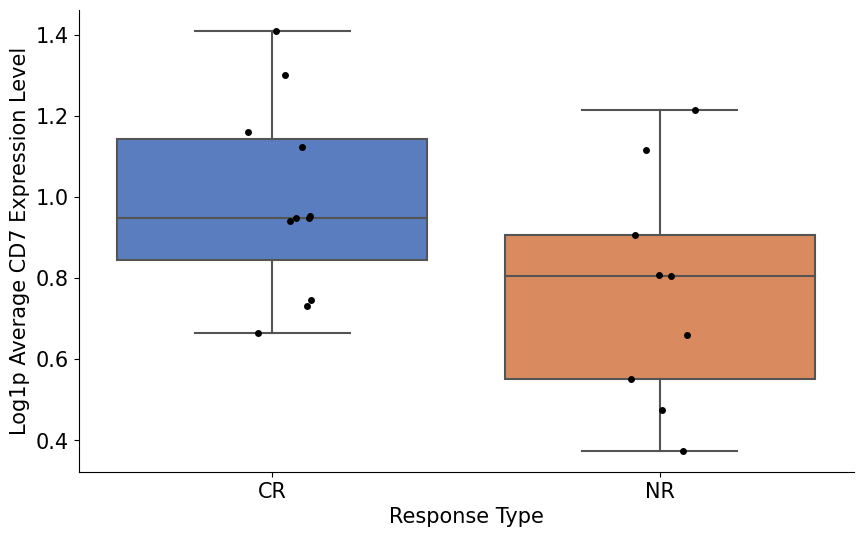

/tmp/ipykernel_3166425/3627766515.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({


FCER1G: p-value = 0.7040


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


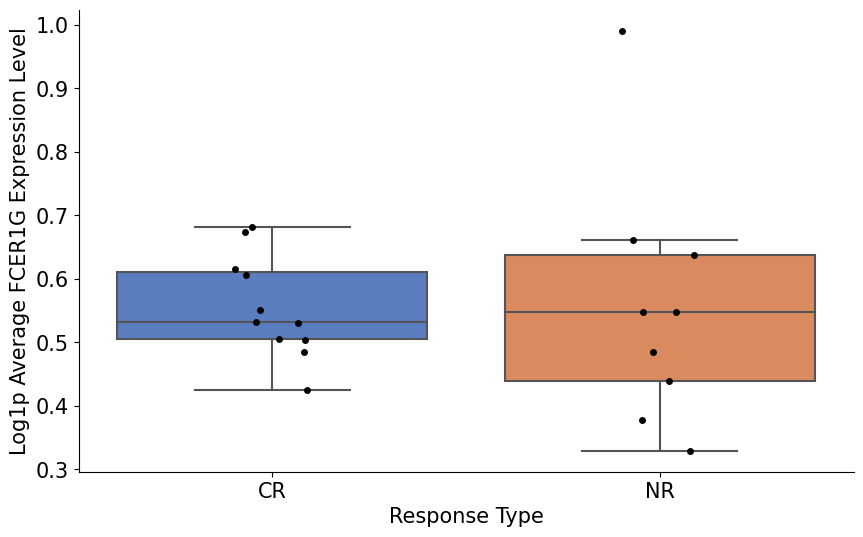

/tmp/ipykernel_3166425/3627766515.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicon

KLRB1: p-value = 0.4033


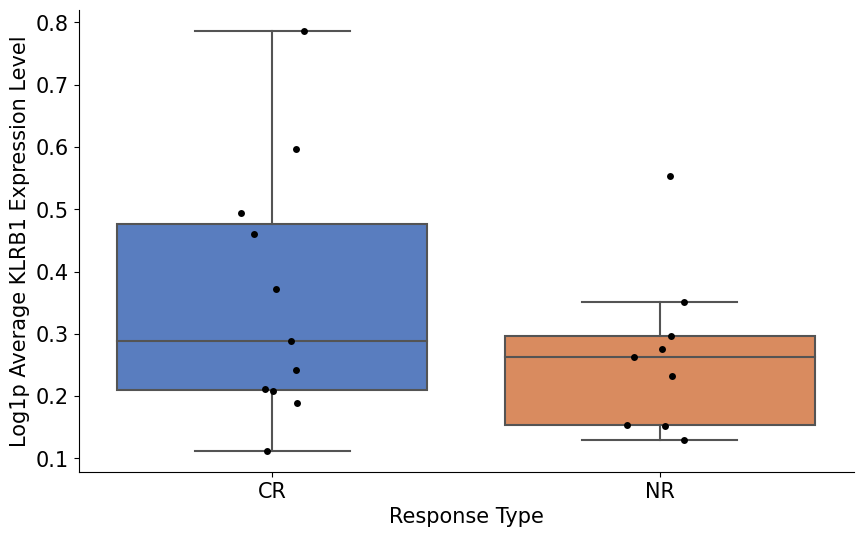

/tmp/ipykernel_3166425/3627766515.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicon

JUND: p-value = 0.0682


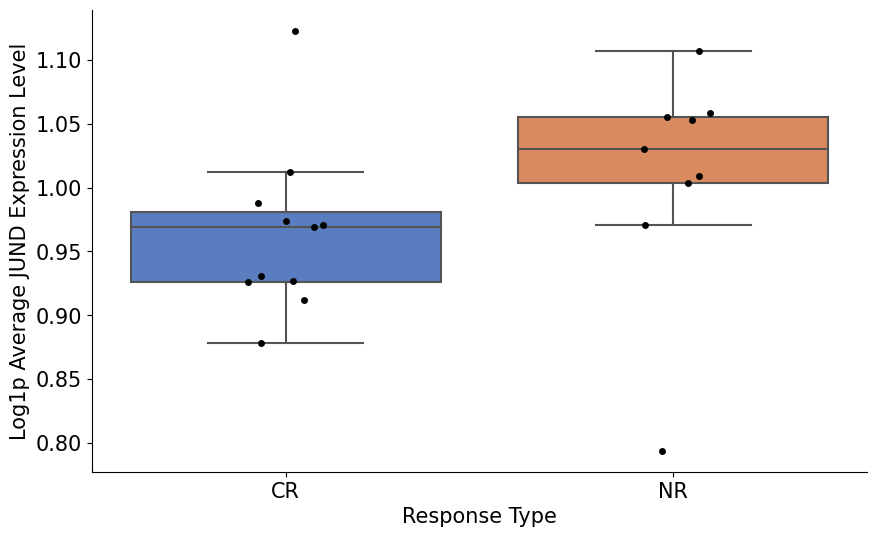

/tmp/ipykernel_3166425/3627766515.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicon

ZNF683: p-value = 0.6485


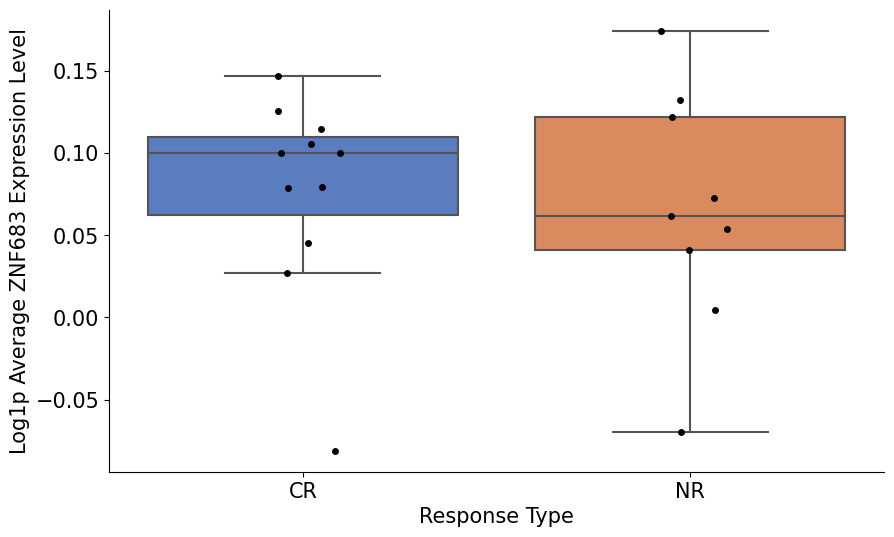

/tmp/ipykernel_3166425/3627766515.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicon

TLE5: p-value = 0.6485


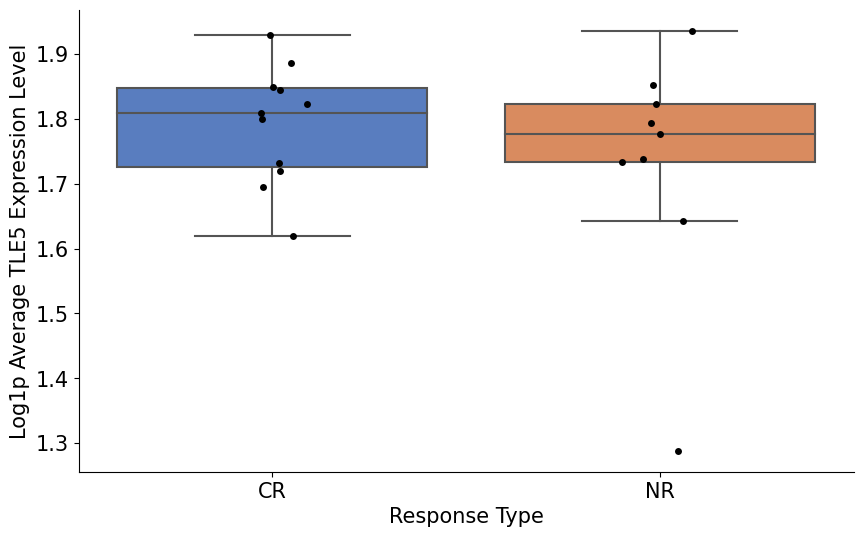

/tmp/ipykernel_3166425/3627766515.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicon

LFNG: p-value = 0.7612


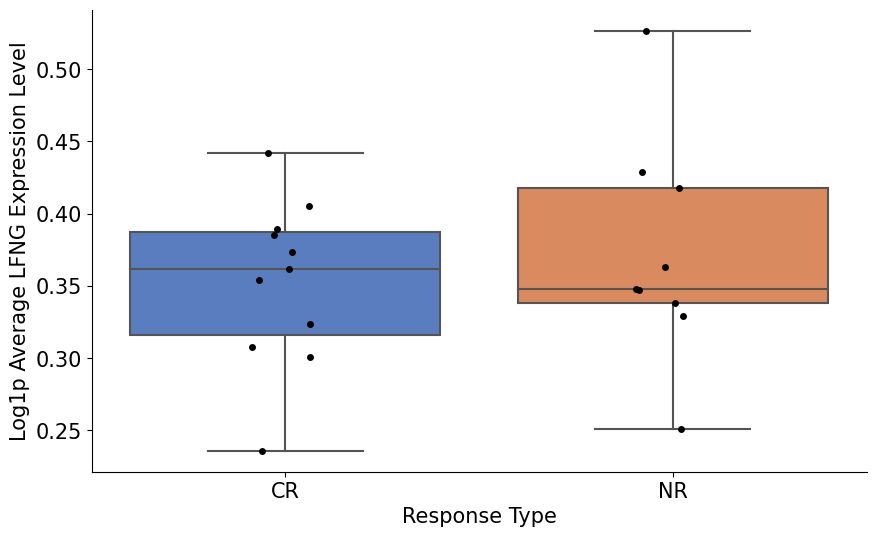

/tmp/ipykernel_3166425/3627766515.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicon

TSC22D3: p-value = 0.7040


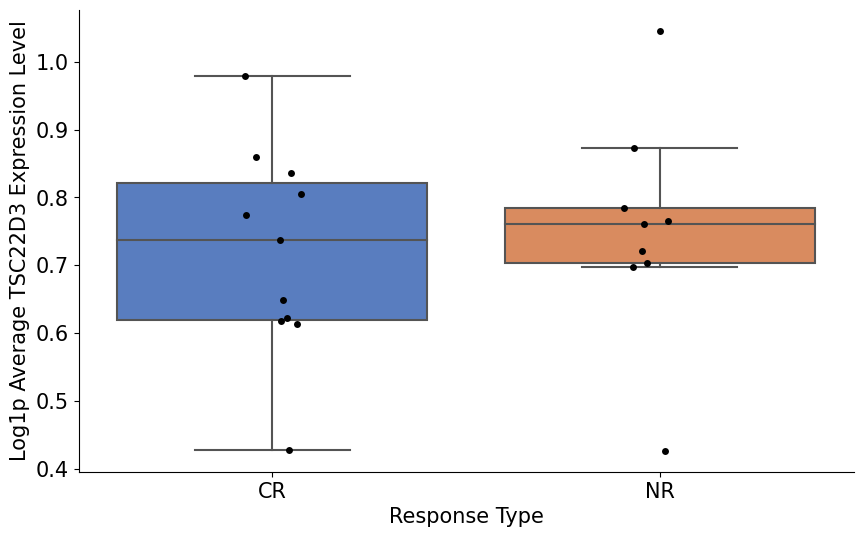

/tmp/ipykernel_3166425/3627766515.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicon

MAF: p-value = 0.5949


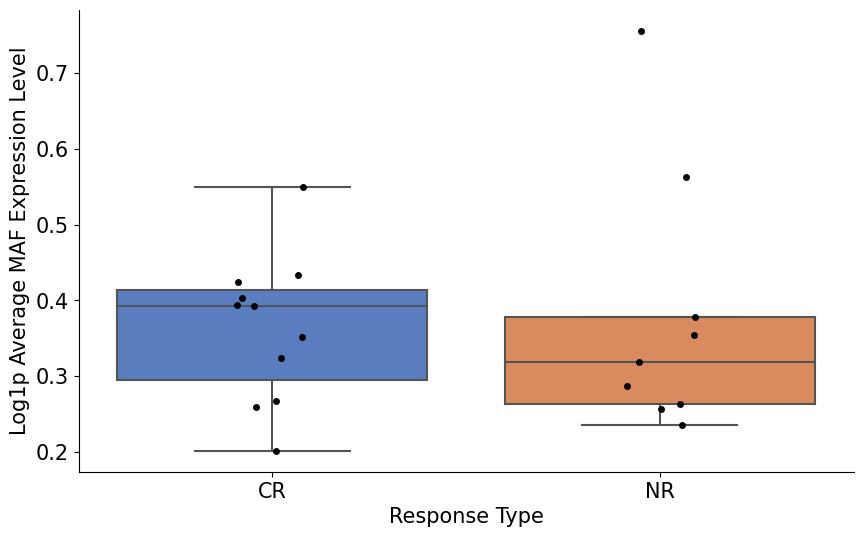

/tmp/ipykernel_3166425/3627766515.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicon

MTRNR2L12: p-value = 0.1489


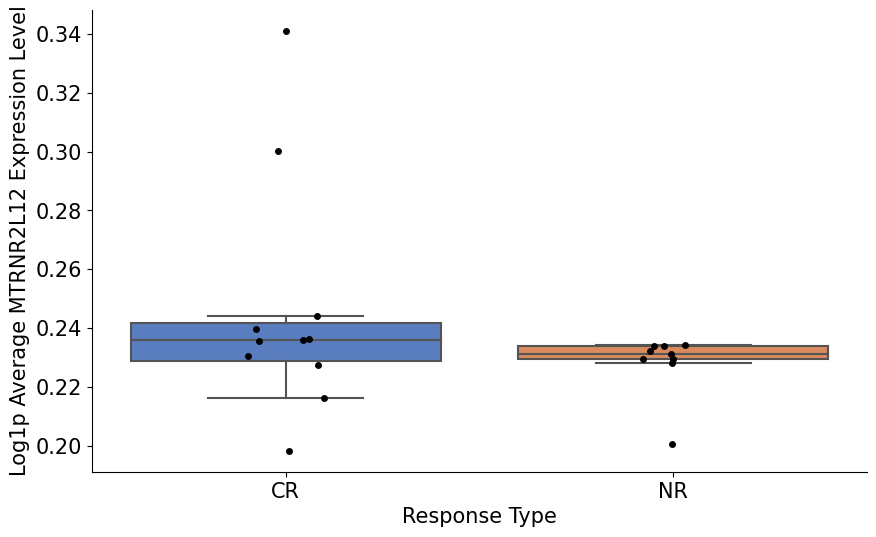

/tmp/ipykernel_3166425/3627766515.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicon

RRM2: p-value = 0.1106


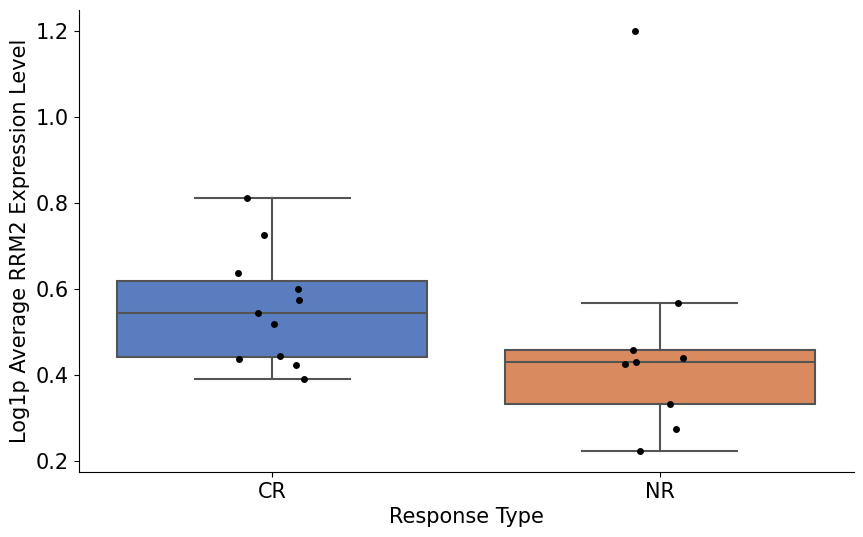

/tmp/ipykernel_3166425/3627766515.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicon

TYMS: p-value = 0.1106


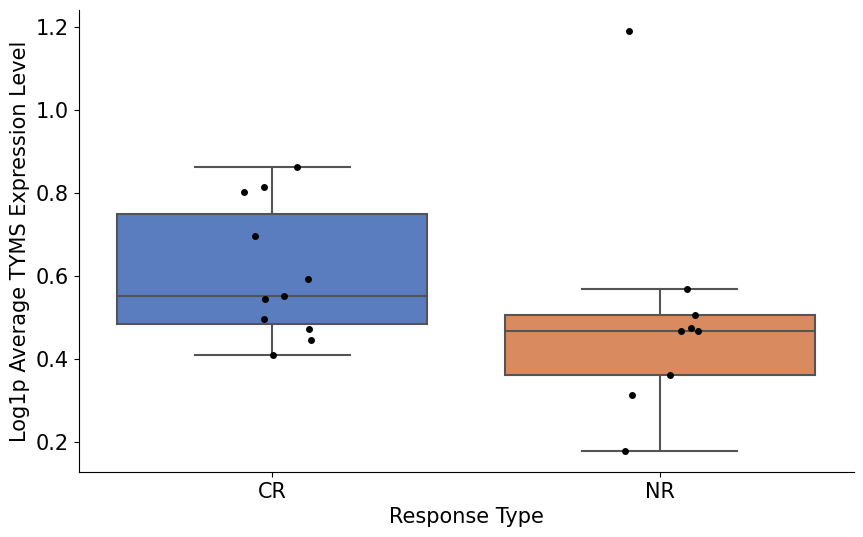

/tmp/ipykernel_3166425/3627766515.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicon

GINS2: p-value = 0.1489


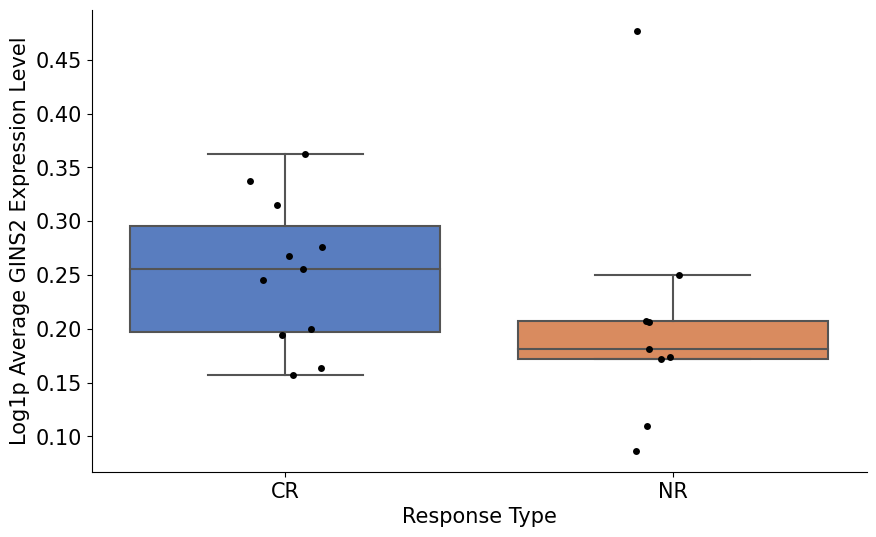

/tmp/ipykernel_3166425/3627766515.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicon

MATK: p-value = 0.0946


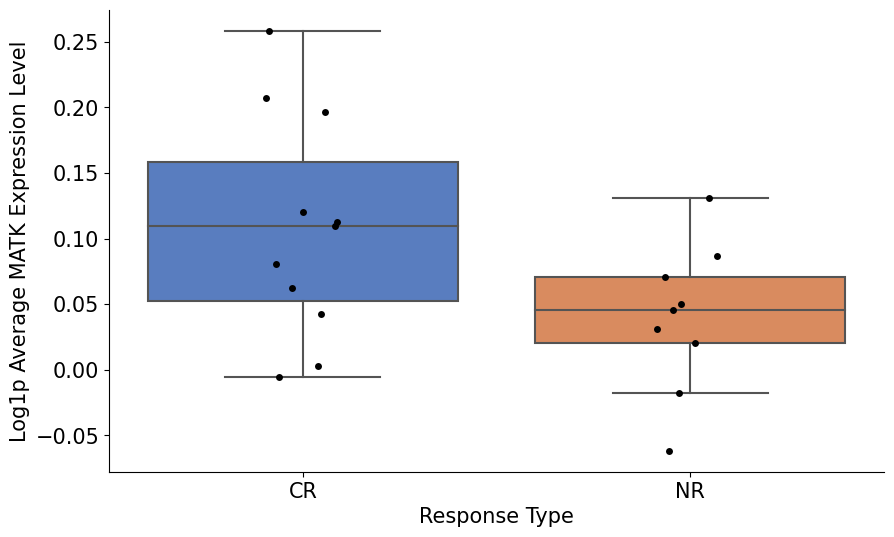

/tmp/ipykernel_3166425/3627766515.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicon

IFITM3: p-value = 0.6485


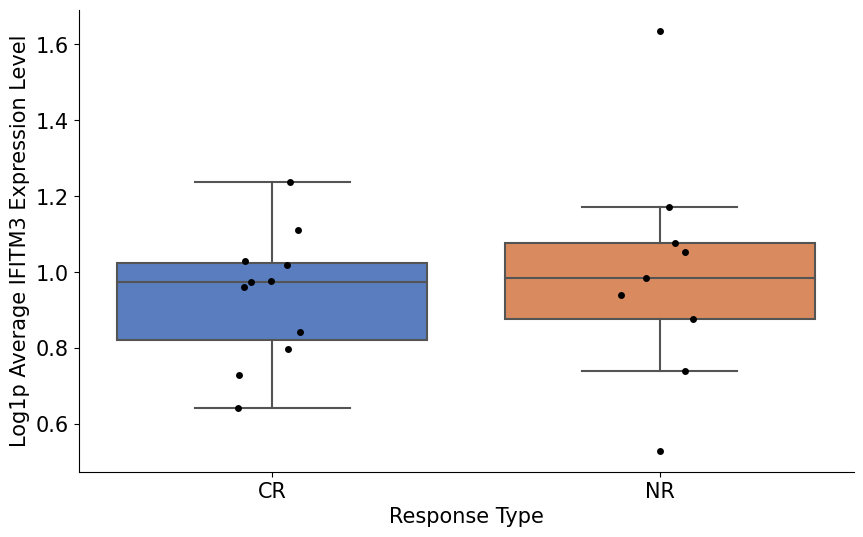

/tmp/ipykernel_3166425/3627766515.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicon

PLP2: p-value = 0.6485


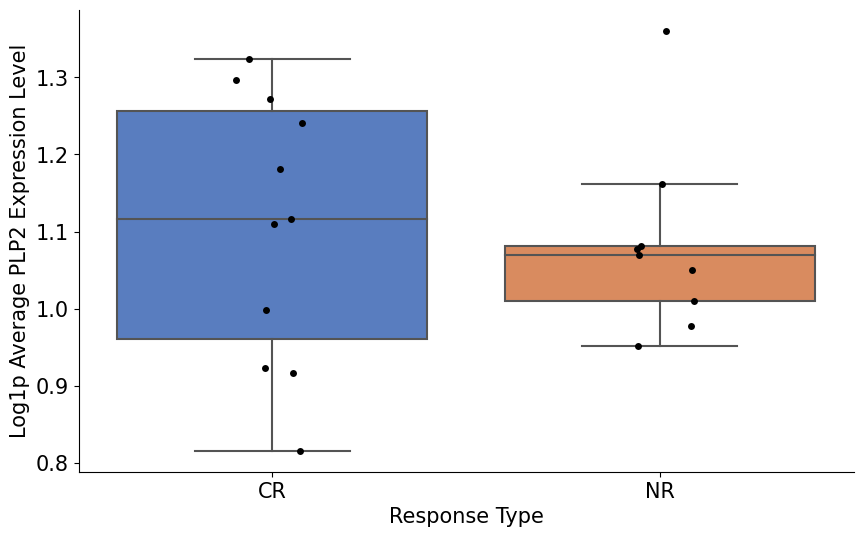

/tmp/ipykernel_3166425/3627766515.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicon

CLSPN: p-value = 0.0334


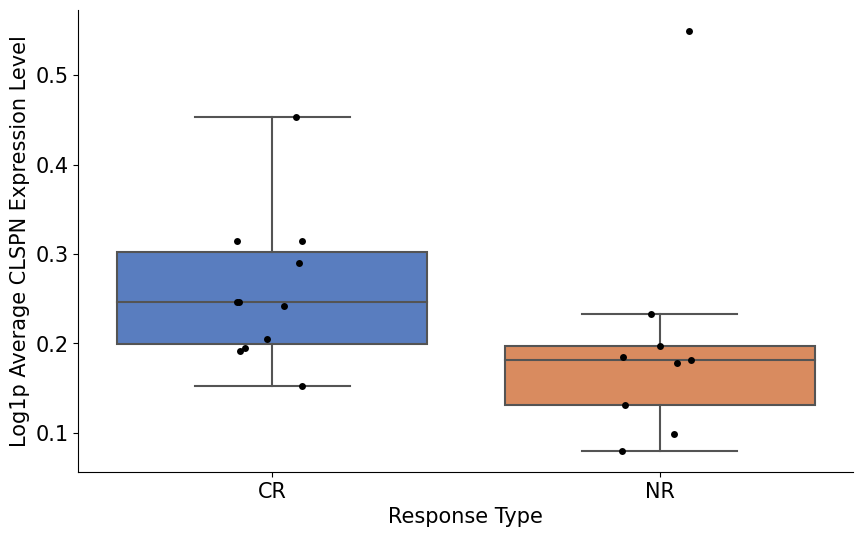

/tmp/ipykernel_3166425/3627766515.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicon

CTSW: p-value = 0.3619


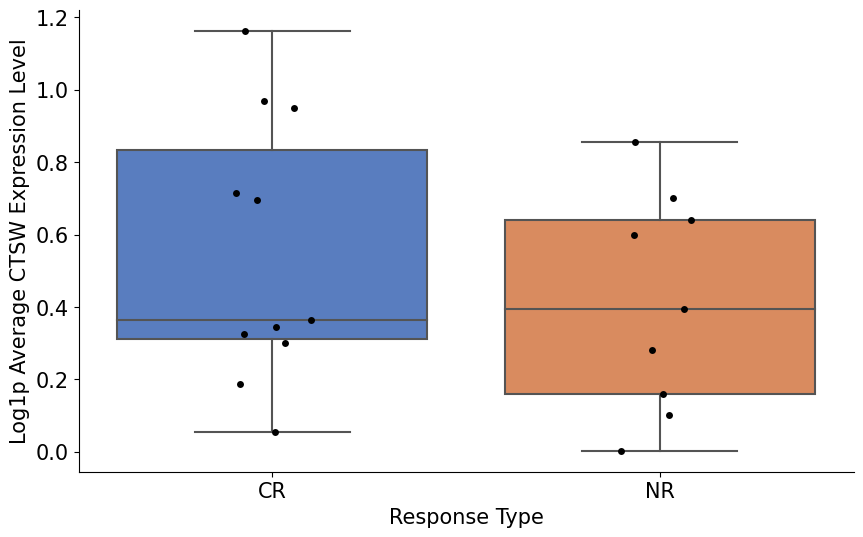

In [16]:
import scanpy as sc
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import mannwhitneyu

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_D7sorted_CD4_CD8A_highly_variable_combat_CR_NR.h5ad')
adata = adata[adata.obs['cell_type'] == 'CD4'].copy()

# List of genes to check
all_genes = [
    "PECAM1", "CD7", "FCER1G", "KLRB1",                             # Immune System and Cell Surface Markers
    "JUND", "ZNF683", "TLE5", "LFNG", "TSC22D3", "MAF",             # Transcription Factors and Gene Regulation
    "MTRNR2L12", "RRM2", "TYMS", "GINS2",                           # Mitochondrial and Cellular Metabolism
    "MATK",                                                         # Signal Transduction and Kinases
    "IFITM3",                                                       # Antiviral Response
    "PLP2", "CLSPN", "MSN", "CTSW"                                  # Cellular Structure and Adhesion
]

# Iterate through each gene and plot its expression
for gene in all_genes:
    if gene in adata.var_names:
        # Get the gene expression data
        adata.obs[f'{gene}_expression'] = adata[:, gene].X.toarray().flatten()  # Adjust if using a sparse matrix
        
        # Create a DataFrame with patient IDs, their response, and gene expression
        df = adata.obs[['barcode', 'response', f'{gene}_expression']]
        
        # Group by patient ID and calculate average gene expression
        patient_gene_avg = df.groupby('barcode').agg({
            'response': 'first',  # Assuming response is the same for all entries of the same patient
            f'{gene}_expression': 'mean'
        }).reset_index()

        # Calculate p-value using Mann-Whitney U test
        responders = patient_gene_avg[patient_gene_avg['response'] == 'CR'][f'{gene}_expression']
        non_responders = patient_gene_avg[patient_gene_avg['response'] == 'NR'][f'{gene}_expression']
        stat, p_value = mannwhitneyu(responders, non_responders)
        print(f"{gene}: p-value = {p_value:.4f}")
        # Plotting
        plt.figure(figsize=(10, 6))
        ax = plt.gca()
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        sns.boxplot(data=patient_gene_avg, x='response', y=f'{gene}_expression', palette='muted', showfliers=False)
        sns.stripplot(data=patient_gene_avg, x='response', y=f'{gene}_expression', color='black', jitter=True, size=5)
        plt.xlabel('Response Type')
        plt.ylabel(f'Log1p Average {gene} Expression Level')
        #plt.title(f'Log1p Average {gene} Expression Levels by Patient Response\np-value = {p_value:.4f}')
        plt.show()


/tmp/ipykernel_3166425/650804808.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({


CD27: p-value = 0.5949


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


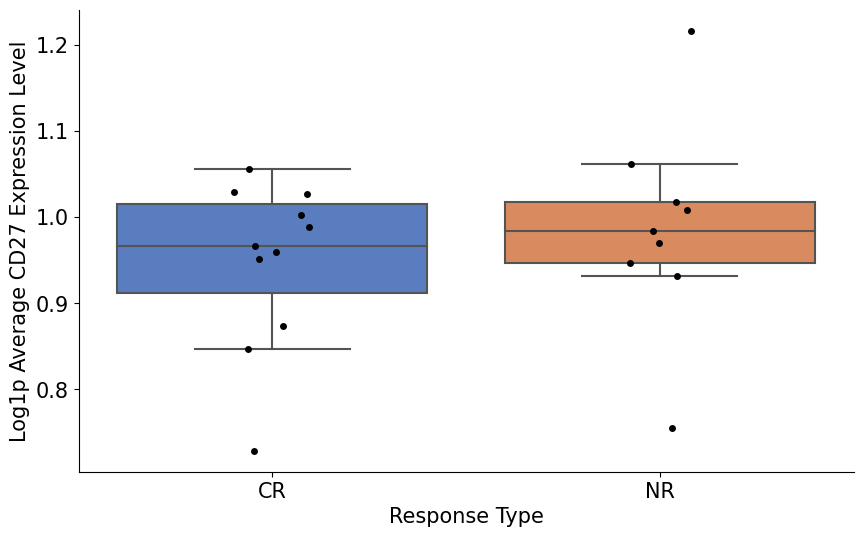

/tmp/ipykernel_3166425/650804808.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicond

CD81: p-value = 0.0122


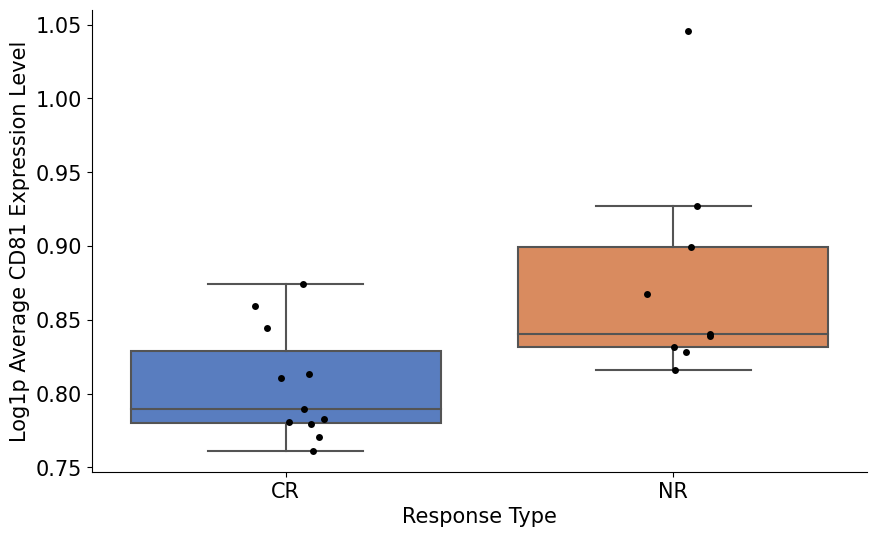

CD7: p-value = 0.0334


/tmp/ipykernel_3166425/650804808.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicond

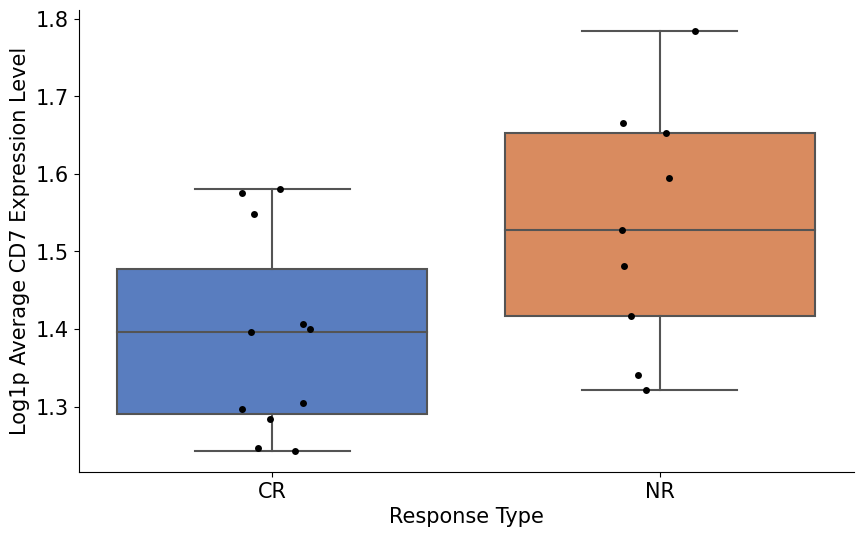

/tmp/ipykernel_3166425/650804808.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({


KLRK1: p-value = 0.4033


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


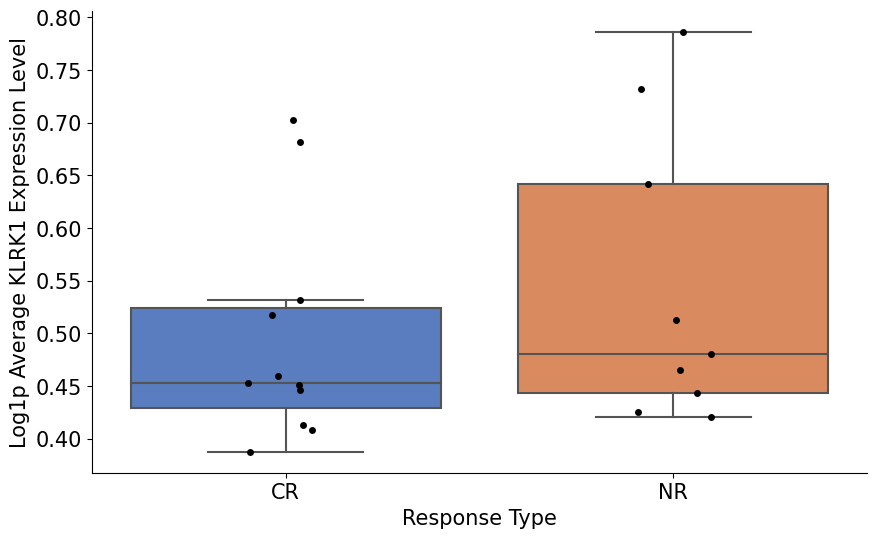

/tmp/ipykernel_3166425/650804808.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


ITGB2: p-value = 0.8197


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


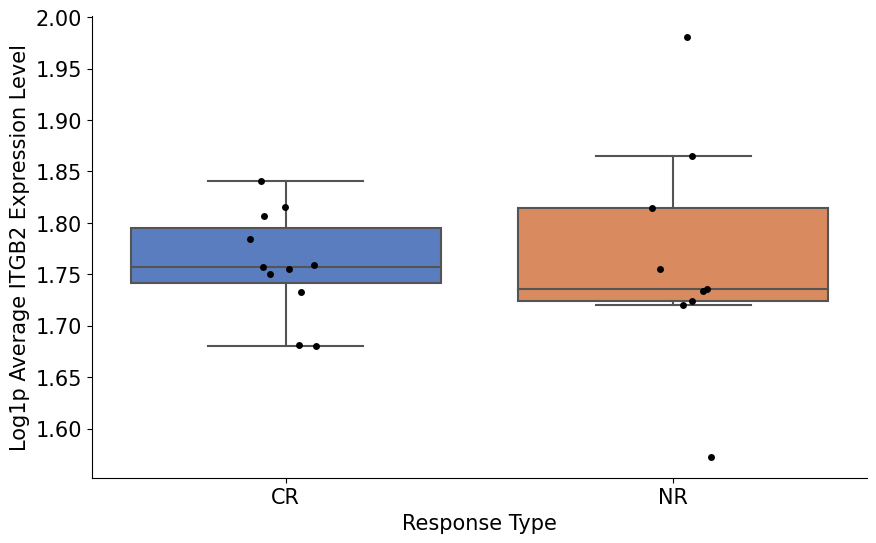

GZMK: p-value = 0.0482


/tmp/ipykernel_3166425/650804808.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicond

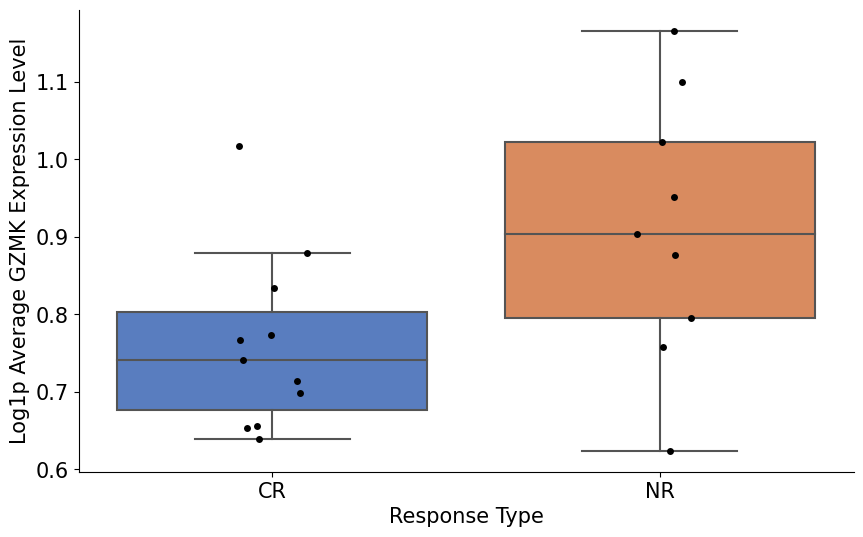

PRF1: p-value = 0.0276


/tmp/ipykernel_3166425/650804808.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicond

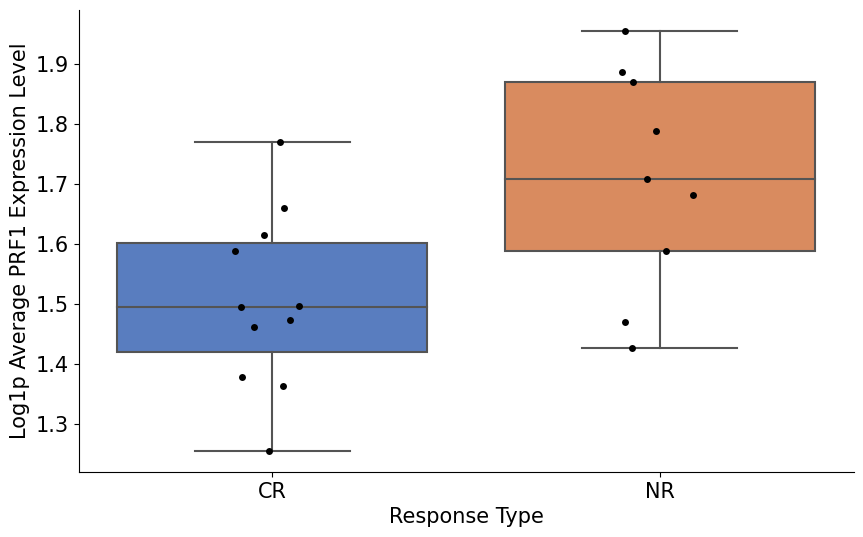

/tmp/ipykernel_3166425/650804808.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


CST7: p-value = 0.0334


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


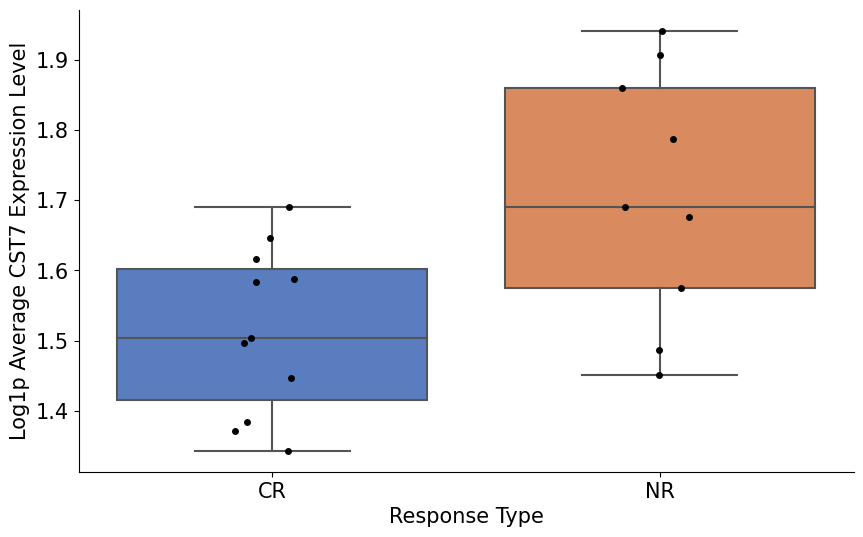

/tmp/ipykernel_3166425/650804808.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({


ALYREF: p-value = 0.0682

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


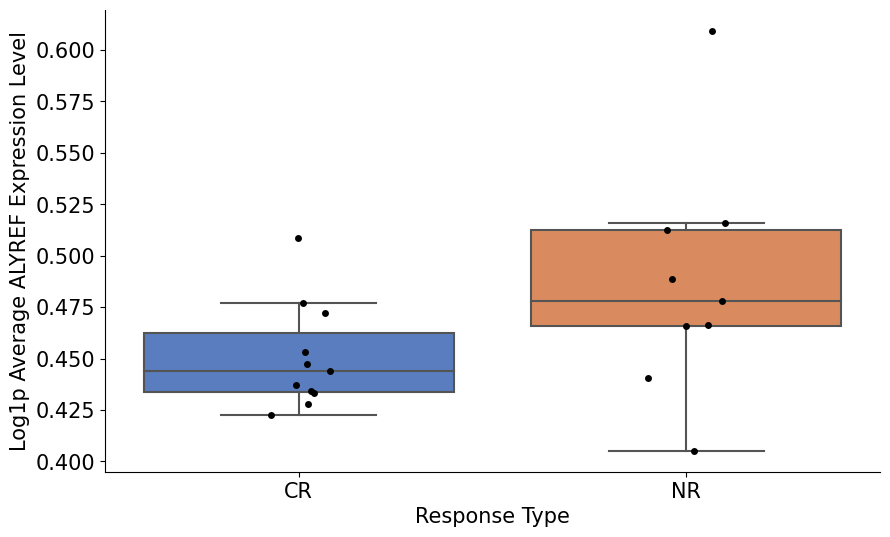

ZNF683: p-value = 0.2545


/tmp/ipykernel_3166425/650804808.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicond

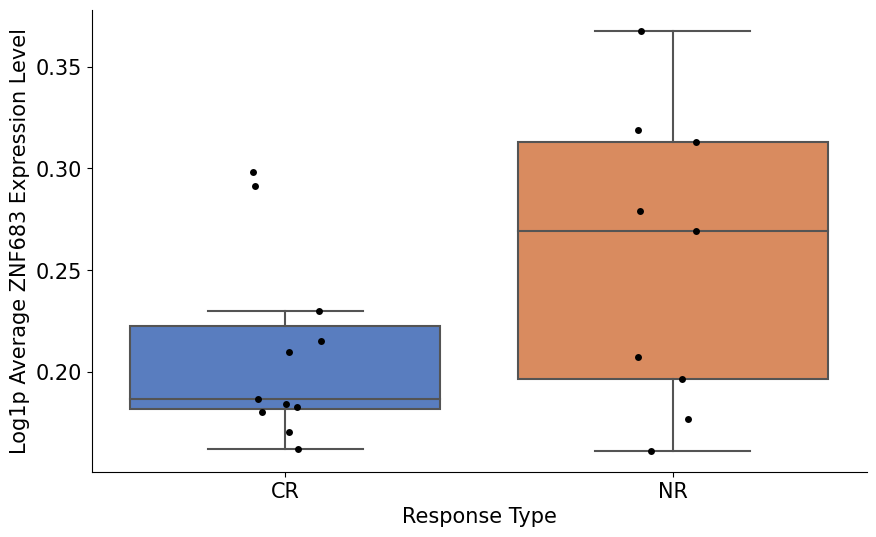

/tmp/ipykernel_3166425/650804808.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({


DENND5A: p-value = 0.0575


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


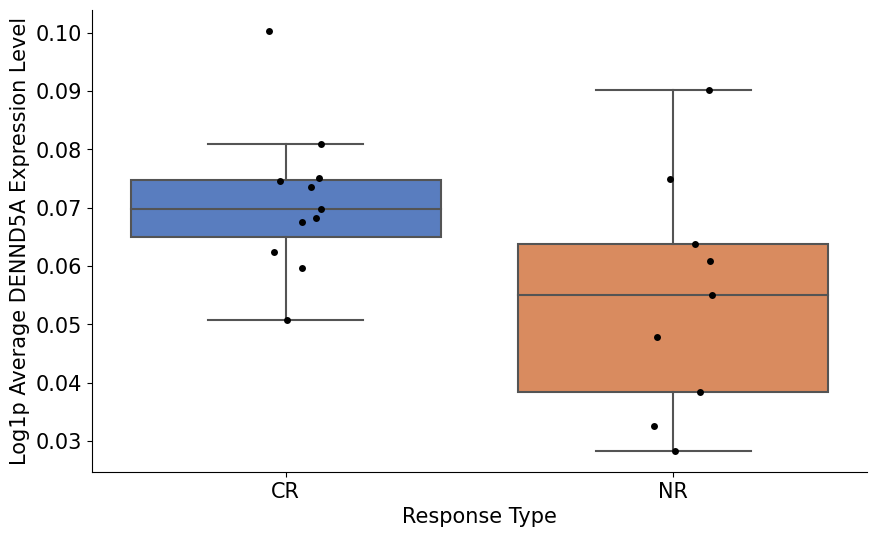

/tmp/ipykernel_3166425/650804808.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


TSC22D3: p-value = 0.2241


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


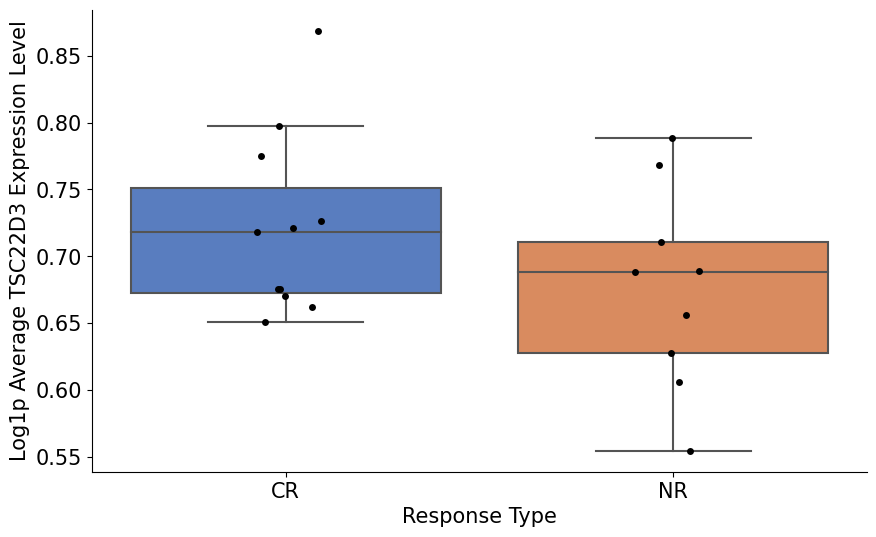

/tmp/ipykernel_3166425/650804808.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({


IL7R: p-value = 0.0402

/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


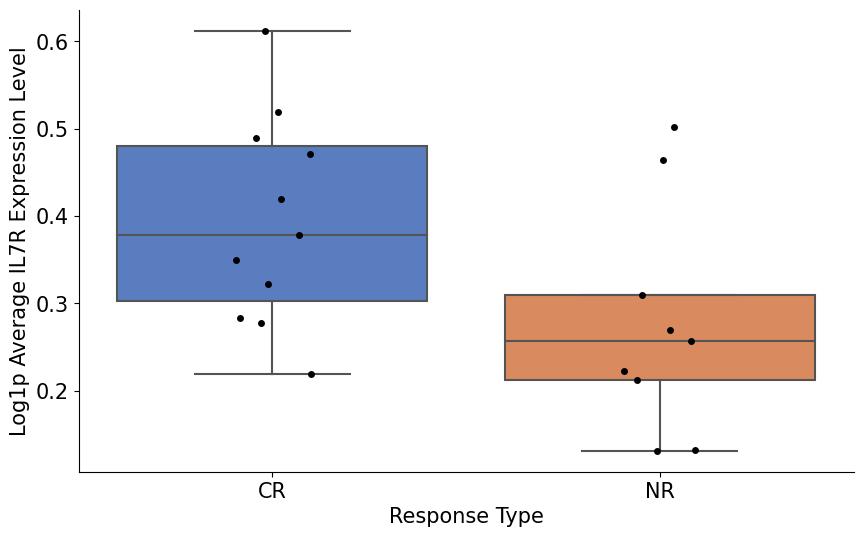

/tmp/ipykernel_3166425/650804808.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({


PECAM1: p-value = 0.1965


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


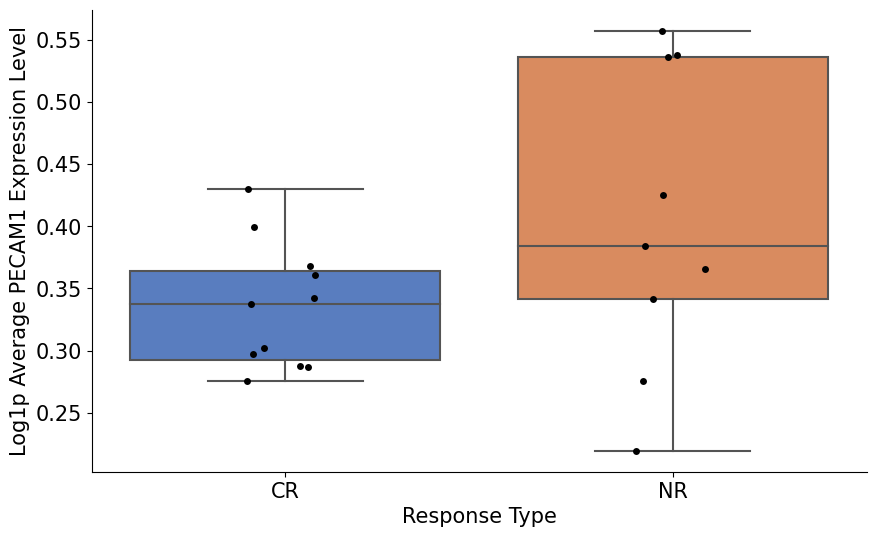

ITM2A: p-value = 0.0806


/tmp/ipykernel_3166425/650804808.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicond

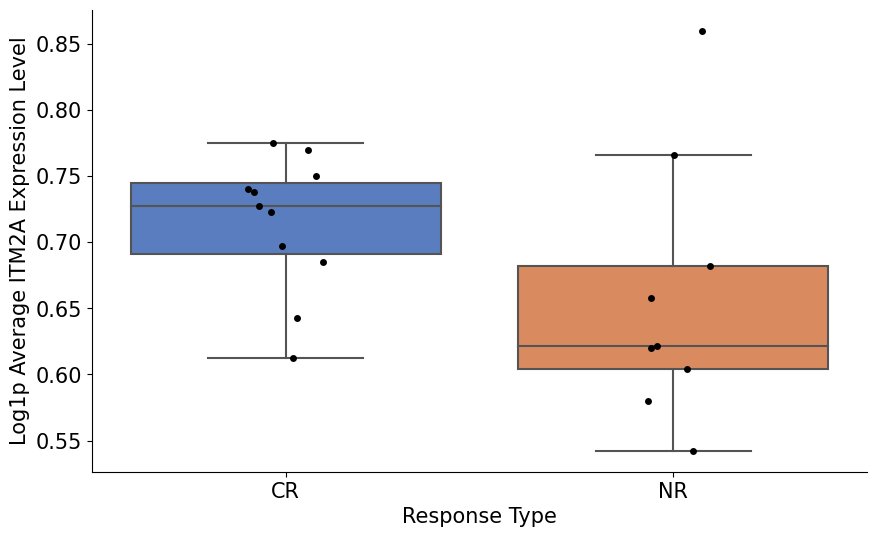

/tmp/ipykernel_3166425/650804808.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


PLP2: p-value = 0.4474


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


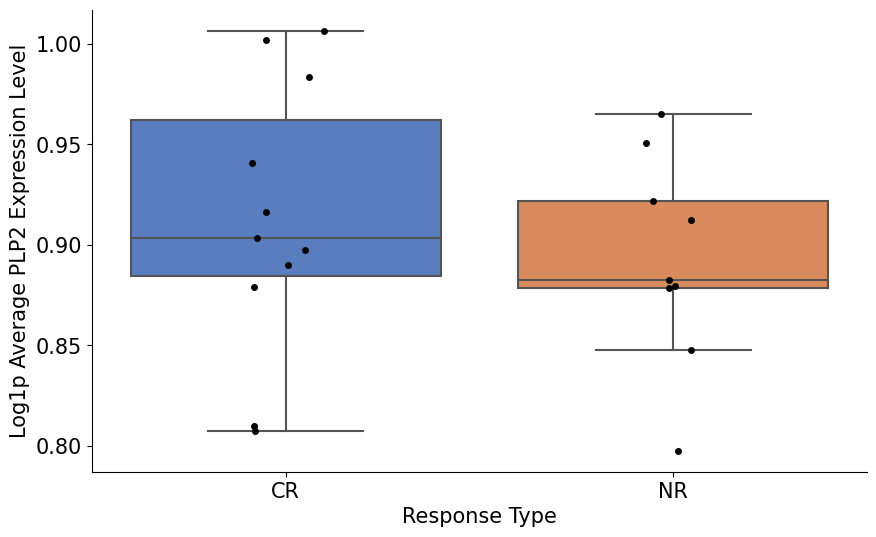

/tmp/ipykernel_3166425/650804808.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({


HOPX: p-value = 0.2545


/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


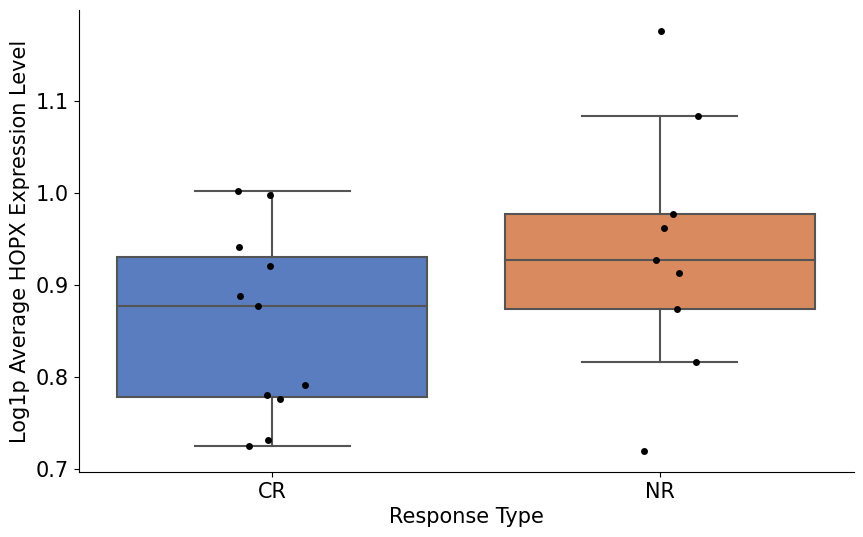

/tmp/ipykernel_3166425/650804808.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_gene_avg = df.groupby('barcode').agg({
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/home/emma/miniconda3/envs/serverGPU/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/emma/minicond

RPL17: p-value = 0.6485


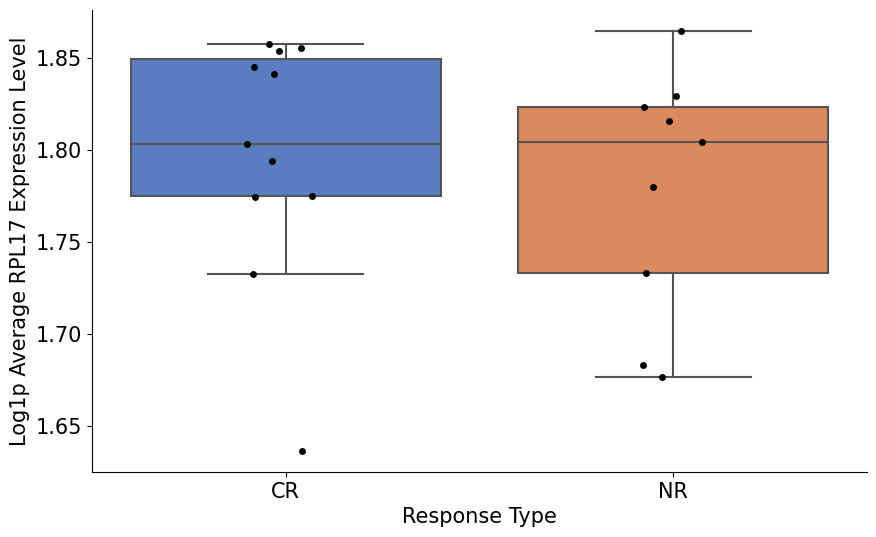

In [17]:
import scanpy as sc
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load your dataset
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_D7sorted_CD4_CD8A_highly_variable_combat_CR_NR.h5ad')
adata = adata[adata.obs['cell_type'] == 'CD8'].copy()
# List of genes to check
all_genes = [
    "CD27", "CD81", "CD7", "KLRK1", "ITGB2",                          # Immune System and Cell Surface Markers
    "GZMK", "PRF1", "CST7",                                           # Cytotoxicity and Immune Response
    "ALYREF", "ZNF683",                                               # Transcription Factors and Gene Regulation
    "DENND5A", "ARL4C", "TSC22D3",                                    # Signal Transduction and Kinases
    "IL7R",                                                           # Cytokine Receptors
    "PECAM1", "ITM2A", "PLP2", "TMEM123", "HOPX", "RPL17"             # Cellular Structure and Metabolism
]

# Iterate through each gene and plot its expression
# Iterate through each gene and plot its expression
for gene in all_genes:
    if gene in adata.var_names:
        # Get the gene expression data
        adata.obs[f'{gene}_expression'] = adata[:, gene].X.toarray().flatten()  # Adjust if using a sparse matrix
        
        # Create a DataFrame with patient IDs, their response, and gene expression
        df = adata.obs[['barcode', 'response', f'{gene}_expression']]
        
        # Group by patient ID and calculate average gene expression
        patient_gene_avg = df.groupby('barcode').agg({
            'response': 'first',  # Assuming response is the same for all entries of the same patient
            f'{gene}_expression': 'mean'
        }).reset_index()

        # Calculate p-value using Mann-Whitney U test
        responders = patient_gene_avg[patient_gene_avg['response'] == 'CR'][f'{gene}_expression']
        non_responders = patient_gene_avg[patient_gene_avg['response'] == 'NR'][f'{gene}_expression']
        stat, p_value = mannwhitneyu(responders, non_responders)
        print(f"{gene}: p-value = {p_value:.4f}")
        # Plotting
        plt.figure(figsize=(10, 6))
        ax = plt.gca()
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        sns.boxplot(data=patient_gene_avg, x='response', y=f'{gene}_expression', palette='muted', showfliers=False)
        sns.stripplot(data=patient_gene_avg, x='response', y=f'{gene}_expression', color='black', jitter=True, size=5)
        plt.xlabel('Response Type')
        plt.ylabel(f'Log1p Average {gene} Expression Level')
        #plt.title(f'Log1p Average {gene} Expression Levels by Patient Response\np-value = {p_value:.4f}')
        plt.show()


In [ ]:
import numpy as np
import scanpy as sc
import pandas as pd
import seaborn as sns

# Load the AnnData object
adata = sc.read_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat.h5ad')

# Filter for Stanford organization
adata = adata[adata.obs['organization'] == 'Stanford']
print(f"Number of Stanford cells: {adata.shape[0]}")

# Load TCR metadata
tcr_meta = pd.read_csv('/home/emma/data/CART/TCR seq/concatenated_TCR_seq.csv')

# Truncate barcodes to first 16 characters
tcr_meta['short_barcode'] = tcr_meta['barcode'].str[:16]
adata.obs['short_barcode'] = adata.obs_names.str[:16]

# Set the index of adata.obs for faster access
adata.obs.set_index('short_barcode', inplace=True)

# Iterate over TCR metadata and update adata.obs
for idx, row in tcr_meta.iterrows():
    short_barcode = row['short_barcode']
    if short_barcode in adata.obs.index:
        adata.obs.at[short_barcode, 'tcr_clonotype'] = row['raw_clonotype_id']
        adata.obs.at[short_barcode, 'cdr3_length'] = row['cdr3_length']
        adata.obs.at[short_barcode, 'v_gene'] = row['v_gene']
        adata.obs.at[short_barcode, 'j_gene'] = row['j_gene']
        adata.obs.at[short_barcode, 'productive'] = row['productive']

# Reset index if needed
adata.obs.reset_index(drop=True, inplace=True)

# Save the updated AnnData object
adata.write_h5ad('/home/emma/data/CART/Harvard_Stanford_infusion_D7sorted_CD3E_CD4_CD8A_highly_variable_combat_stanford_tcr.h5ad')

print("TCR metadata successfully merged and AnnData object saved.")
